## Adversarial AI Vaccine

#### Written by gyu young Lee    2021.10.11

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn import datasets
from sklearn.model_selection import train_test_split

import tensorflow as tf
import matplotlib

In [2]:
mnist = tf.keras.datasets.mnist
(train_images, train_labels), (test_images, test_labels) = mnist.load_data()

In [3]:
## 이미지 데이터는 픽셀마다 0~255 사이의 값을 가짐.
## [데이터표준화] 255로 나누어 0~1 사이로 맞추는 것이 유리함.
train_images = train_images / 255
test_images = test_images / 255

In [4]:
# -- 각 설정값 --
img_size = 28  # 이미지 크기와 폭
n_mid = 30  # 은닉층 뉴런 수
n_out = 10
eta = 0.001  # 학습률
epochs = 20 
batch_size = 32
interval = 5  # 경과 시간 표시 간격

In [5]:
# -- 전결합층의 부모 클래스 --
class BaseLayer:
    def update(self, eta):
        self.w -= eta * self.grad_w
        self.b -= eta * self.grad_b

# -- 은닉층 --
class MiddleLayer(BaseLayer):
    def __init__(self, n_upper, n):
        self.w = np.random.randn(n_upper, n) * np.sqrt(2/n_upper)
        self.b = np.zeros(n)

    def forward(self, x):
        self.x = x
        self.u = np.dot(x, self.w) + self.b
        self.y = np.where(self.u <= 0, 0, self.u) # ReLU
    
    def backward(self, grad_y):
        delta = grad_y * np.where(self.u <= 0, 0, 1)  # ReLU 미분

        self.grad_w = np.dot(self.x.T, delta)
        self.grad_b = np.sum(delta, axis=0)
        self.grad_x = np.dot(delta, self.w.T) 

# -- 출력층 --
class OutputLayer(BaseLayer):
    def __init__(self, n_upper, n):
        self.w = np.random.randn(n_upper, n) / np.sqrt(n_upper)  # 자비에르 초기화 기반의 초깃값
        self.b = np.zeros(n)

    def forward(self, x):
        self.x = x
        u = np.dot(x, self.w) + self.b
        # amended by gylee 2021-07-10
        #self.y = np.exp(u)/np.sum(np.exp(u), axis=1, keepdims=True)  # softmax 함수
        self.y = np.exp(u-np.max(u))/np.sum(np.exp(u-np.max(u)), axis=1, keepdims=True)  # softmax 함수
        #self.y = np.clip(np.exp(u-np.max(u)), 1e-10, None)/np.clip(np.sum(np.exp(u-np.max(u)), axis=1, keepdims=True), 1e-10, None)  # softmax 함수

    def backward(self, t):
        delta = self.y - t
                
        self.grad_w = np.dot(self.x.T, delta)
        self.grad_b = np.sum(delta, axis=0)
        self.grad_x = np.dot(delta, self.w.T)

# -- 각층의 초기화 --
layers = [MiddleLayer(img_size*img_size, n_mid), OutputLayer(n_mid, n_out)]

# -- 순전파 --
def forward_propagation(x):
    for layer in layers:
        layer.forward(x)
        x = layer.y
    return x

# -- 역전파 --
def backpropagation(t):
    grad_y = t
    for layer in reversed(layers):
        layer.backward(grad_y)
        grad_y = layer.grad_x
    return grad_y

# -- 파라미터 갱신 --
def update_params():
    for layer in layers:
        layer.update(eta)

# -- 오차 측정 --
def get_error(x, t):
    y = forward_propagation(x)
    return -np.sum(t*np.log(y+1e-7)) / len(y)  # 교차엔트로피 오차

# -- 정답률 측정 --
def get_accuracy(x, t):
    y = forward_propagation(x)
    total = len(y)
    hit = np.sum(np.argmax(y, axis=1) == np.argmax(t, axis=1))
    miss = total-hit
    acc = hit / total
    return total, hit, miss, acc

In [6]:
# -- 은닉층 --
class MiddleLayer_Ad(BaseLayer):
    def __init__(self, n_upper, n):
        self.w = np.random.randn(n_upper, n) * np.sqrt(2/n_upper)
        self.b = np.zeros(n)
   
    def backward(self, layer, grad_y):
        delta = grad_y * np.where(layer.u <= 0, 0, 1)  # ReLU 미분

        self.grad_w = np.dot(layer.x.T, delta)
        self.grad_b = np.sum(delta, axis=0)
        self.grad_x = np.dot(delta, layer.w.T)       

# -- 출력층 --
class OutputLayer_Ad(BaseLayer):
    def __init__(self, n_upper, n):
        self.w = np.random.randn(n_upper, n) / np.sqrt(n_upper)  # 자비에르 초기화 기반의 초깃값
        self.b = np.zeros(n)

    def backward(self, layer, t):
        delta = layer.y - t
        self.grad_w = np.dot(layer.x.T, delta)
        self.grad_b = np.sum(delta, axis=0)
        self.grad_x = np.dot(delta, layer.w.T)
        
# -- 각층의 초기화 --
layers_ad = [MiddleLayer_Ad(img_size*img_size, n_mid),
          OutputLayer_Ad(n_mid, n_out)]

# -- 역전파 --
def backpropagation_ad(t):
    grad_y = t
    for layer, layer_ad in zip(reversed(layers), reversed(layers_ad)):
        layer_ad.backward(layer, grad_y)
        grad_y = layer_ad.grad_x
    return grad_y

# -- 파라미터 갱신 --
def update_params_ad():
    for layer in layers_ad:
        layer.update(eta)

In [7]:
def input_derivative(x, y):  
    # 예측값을 구한다.
    forward_propagation(x)
         
    # 역전파
    grad_y = backpropagation_ad(y)

    # 파라미터 갱신
    update_params_ad()
                  
    # Return derivatives WRT to input
    return grad_y

In [8]:
def adversarial(n, steps, eta):
    """
    n : integer
        our goal label (just an int, the function transforms it into a one-hot vector)
    steps : integer
        number of steps for gradient descent
    eta : float
        step size for gradient descent
    """
    # Set the goal output
    goal = np.zeros((1, 10))
    goal[0, n] = 1

    # Create a random image to initialize gradient descent with
    x = np.random.normal(.5, .3, (1, 784))

    # Gradient descent on the input
    for i in range(steps):
        # Calculate the derivative
        d = input_derivative(x, goal)
        
        # The GD update on x
        x -= eta * d
        
    return x

# Wrapper function
def generate(n):
    """
    n : integer
        goal label (not a one hot vector)
    """
    a = adversarial(n, 1000, 1)
    prediction = forward_propagation(a)
    x = np.round(prediction, 2)
    
    print('Network Output: \n' + str(x) + '\n')
    print('Network Prediction: ' + str(np.argmax(x)) + '\n')
    
    print('Adversarial Example: ')
    plt.imshow(a.reshape(28,28), cmap='Greys')

In [9]:
# generate(9)

In [10]:
def sneaky_adversarial(n, x_target, steps, eta, lam=.05):
    """
    net : network object
        neural network instance to use
    n : integer
        our goal label (just an int, the function transforms it into a one-hot vector)
    x_target : numpy vector
        our goal image for the adversarial example
    steps : integer
        number of steps for gradient descent
    eta : float
        step size for gradient descent
    lam : float
        lambda, our regularization parameter. Default is .05
    """
    
    # Set the goal output
    goal = np.zeros((1, 10))
    goal[0, n] = 1

    # Create a random image to initialize gradient descent with
    x = np.random.normal(.5, .3, (1, 784))

    # Gradient descent on the input
    for i in range(steps):
        # Calculate the derivative
        d = input_derivative(x,goal)
        
        # The GD update on x, with an added penalty to the cost function
        # ONLY CHANGE IS RIGHT HERE!!!
        x_target = x_target.reshape(1,784)
        x -= eta * (d + lam * (x - x_target))

    return x

# Wrapper function
def sneaky_generate(n, m):
    """
    n: int 0-9, the target number to match. 머신러닝 네트워크로 하여금 판정하게 하고 싶은 숫자
    m: index of example image to use (from the test set). 만들고자 하는 숫자의 모습
    """
    
    # Find random instance of m in test set
    idx = np.random.randint(0, len(test_labels))
    while test_labels[idx] != m:
        idx += 1
    
    a = sneaky_adversarial(n, test_images[idx], 100, 1)  
    prediction = forward_propagation(a)
    x = np.round(prediction, 2)
    
    print('\nWhat we want our adversarial example to look like: ')
    plt.imshow(test_images[idx].reshape((28,28)), cmap='Greys')
    plt.show()
    
    print('\n')
    
    print('Adversarial Example: ')
    
    plt.imshow(a.reshape(28,28), cmap='Greys')
    plt.show()
    
    print('Network Prediction: ' + str(np.argmax(x)) + '\n')
    print('Network Output: \n' + str(x) + '\n')
    
    return a

In [11]:
# sneaky_generate(target label, target digit)
#adv_ex = sneaky_generate(7, 6)

In [12]:
# Wrapper function
def sneaky_generate_all():
    # ML MNIST dataset 불러오기
    saved_npz = np.load("./mnist.npz")
    x_train = saved_npz ['x_train']
    x_test = saved_npz ['x_test']
    t_train = saved_npz ['t_train']
    t_test = saved_npz ['t_test']    
    
    adv_x_train = x_train
    adv_x_test = x_test
    adv_t_train = t_train
    adv_t_test = t_test
    
    # Generate Adv sample for x_train
    n=0
    for i in range(len(train_labels)) :
        n+=1
        if(n==train_labels[i]): n+=1
        if(n>=10) : n=0    
        a = sneaky_adversarial(n, train_images[i], 100, 1)
        print('Adv sample for x_train : ' + str(i) + '\n')        
        adv_x_train[i, :] = a 

    # Generate Adv sample for x_test
    n=0
    for i in range(len(test_labels)) :
        n+=1
        if(n==test_labels[i]): n+=1
        if(n>=10) : n=0            
        a = sneaky_adversarial(n, test_images[i], 100, 1)
        print('Adv sample for x_test : ' + str(i) + '\n')        
        adv_x_test[i, :] = a 
        
    # -- numpy arrary 데이터 저장 --
    np.savez("./adv_mnist.npz", adv_x_train=adv_x_train, adv_x_test=adv_x_test, adv_t_train=adv_t_train, adv_t_test=adv_t_test)
    
    return a

In [13]:
#sneaky_generate_all()

In [14]:
def Training(x_train, x_test, t_train, t_test):
    # -- 오차 기록 --
    error_record_train = []
    error_record_test = []

    n_batch = len(x_train) // batch_size  # 1에포크당 배치 개수
    for i in range(epochs):
        # -- 학습 -- 
        index_random = np.arange(len(x_train))
        np.random.shuffle(index_random)  # 인덱스 임의 섞기
        
        for j in range(n_batch):        
            # 미니배치 생성
            mb_index = index_random[j*batch_size : (j+1)*batch_size]
            x_mb = x_train[mb_index, :]
            t_mb = t_train[mb_index, :]

            # 순전파와 역전파
            forward_propagation(x_mb)
            backpropagation(t_mb)

            # 파라미터 갱신
            update_params()

        # -- 오차 측정 및 기록 --  
        error_train = get_error(x_train, t_train)
        error_record_train.append(error_train)
        error_test = get_error(x_test, t_test)
        error_record_test.append(error_test)

        # -- 경과 표시 -- 
        if i%interval == 0:
            print("Epoch:" + str(i+1) + "/" + str(epochs),
                  "Error_train: " + str(error_train),
                  "Error_test: " + str(error_test))
            
    return error_record_train, error_record_test

In [15]:
def ShowGraph_ErrorRecord(error_record_train, error_record_test):
    # -- 오차 추이를 그래프로 표시 - -- 
    plt.plot(range(1, len(error_record_train)+1), error_record_train, label="Train")
    plt.plot(range(1, len(error_record_test)+1), error_record_test, label="Test")
    plt.legend()

    plt.xlabel("Epochs")
    plt.ylabel("Error")
    plt.show()    

In [16]:
def Print_Accuracy(x_train, x_test, t_train, t_test):
    # -- - 정답률 측정 -- 
    total, hit, miss, acc = get_accuracy(x_train, t_train)
    print(f'Result of Training Data : (total){total}, (hit){hit}, (miss){miss}, (accuracy){acc*100}%')

    total, hit, miss, acc = get_accuracy(x_test, t_test)
    print(f'Result of Test Data : (total){total}, (hit){hit}, (miss){miss}, (accuracy){acc*100}%')

In [17]:
def Report_model_miss(x, t):
    hit = 0
    miss = 0
    nCnt = 0
    misses = []
    
    y = forward_propagation(x)               
    for i in range(len(y)):
      if np.argmax(y[i]) == np.argmax(t[i]):
        hit += 1
      else:
        miss += 1
        miss_item = [i, y[i], t[i]]
        misses.append(miss_item)
    
    #score = hit/len(x)*100        
    #print(f'Score is {score}')
    #print(f'The number of miss: {miss}')
    
    for i in range(len(misses)):
      print(f'[{misses[i][0]}] (예측값){np.argmax(misses[i][1])} (실제값){np.argmax(misses[i][2])}')
      #print(f'(예측값-상세){misses[i][1]}')

      digit_image = x[misses[i][0]].reshape(28, 28)
      plt.imshow(digit_image, cmap=matplotlib.cm.binary, interpolation="nearest")
      #plt.imshow(digit_image)
      #plt.colorbar()
      plt.axis("off")
      plt.show()

In [18]:
# Adversarial Training 실시 전 성능 측정 : 정상샘플에 대한 성능측정
def ML_Training():
    # -- numpy arrary 데이터 불러오기 --
    saved_npz = np.load("./mnist.npz")
    x_train = saved_npz ['x_train']
    x_test = saved_npz ['x_test']
    t_train = saved_npz ['t_train']
    t_test = saved_npz ['t_test']
       
    error_record_train, error_record_test = Training(x_train, x_test, t_train, t_test)
    ShowGraph_ErrorRecord(error_record_train, error_record_test)
       
    print("정상샘플로 측정한 성능결과 (정상샘플 학습완료 후): ")
    Print_Accuracy(x_train, x_test, t_train, t_test)
    Report_model_miss(x_test, t_test)

In [19]:
def Report_Performance():
    # -- numpy arrary 데이터 불러오기 --
    saved_npz = np.load("./mnist.npz")
    x_train = saved_npz ['x_train']
    x_test = saved_npz ['x_test']
    t_train = saved_npz ['t_train']
    t_test = saved_npz ['t_test']
    
    # Adversarial MNIST dataset 불러오기
    adv_saved_npz = np.load("./adv_mnist.npz")
    adv_x_train = adv_saved_npz ['adv_x_train']
    adv_x_test = adv_saved_npz ['adv_x_test']
    adv_t_train = adv_saved_npz ['adv_t_train']
    adv_t_test = adv_saved_npz ['adv_t_test']     
           
    print("정상샘플로 측정한 성능결과 : ")
    Print_Accuracy(x_train, x_test, t_train, t_test)
    #Report_model_miss(x_test, t_test)
    
    print("적대적샘플로 측정한 성능결과 : ")
    Print_Accuracy(adv_x_train, adv_x_test, adv_t_train, adv_t_test)
    Report_model_miss(adv_x_test, adv_t_test)        

Epoch:1/20 Error_train: 0.3261559385841407 Error_test: 0.31675998770540975
Epoch:6/20 Error_train: 0.1574025066060748 Error_test: 0.16429318808490717
Epoch:11/20 Error_train: 0.11193999793799315 Error_test: 0.13239341044162647
Epoch:16/20 Error_train: 0.08970171494225107 Error_test: 0.11647215985120654


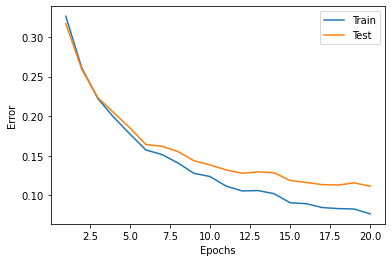

정상샘플로 측정한 성능결과 (정상샘플 학습완료 후): 
Result of Training Data : (total)60000, (hit)58703, (miss)1297, (accuracy)97.83833333333334%
Result of Test Data : (total)10000, (hit)9664, (miss)336, (accuracy)96.64%
[149] (예측값)9 (실제값)2


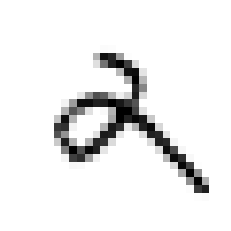

[241] (예측값)8 (실제값)9


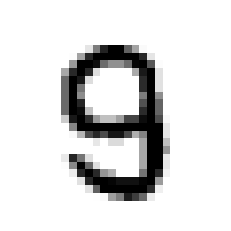

[247] (예측값)6 (실제값)4


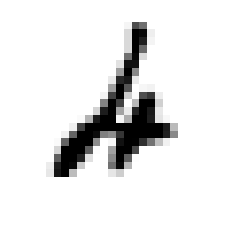

[259] (예측값)5 (실제값)6


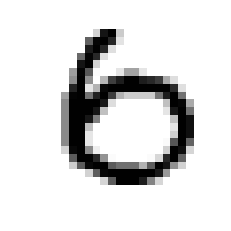

[313] (예측값)5 (실제값)3


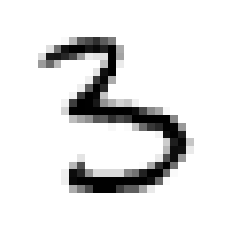

[321] (예측값)7 (실제값)2


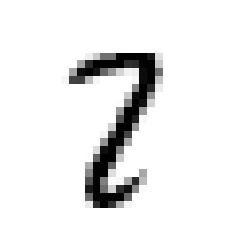

[358] (예측값)9 (실제값)7


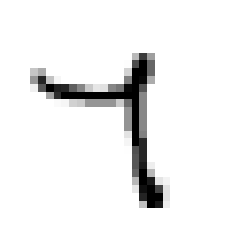

[381] (예측값)7 (실제값)3


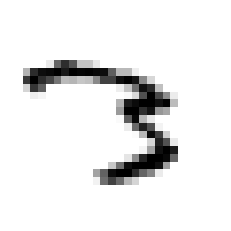

[445] (예측값)0 (실제값)6


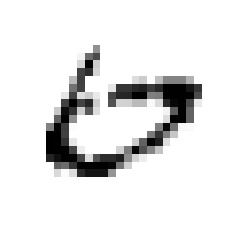

[449] (예측값)5 (실제값)3


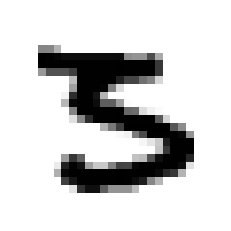

[495] (예측값)2 (실제값)8


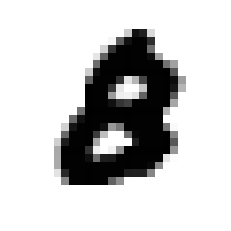

[619] (예측값)8 (실제값)1


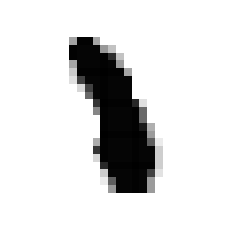

[646] (예측값)6 (실제값)2


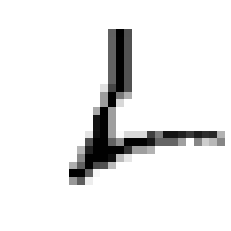

[659] (예측값)8 (실제값)2


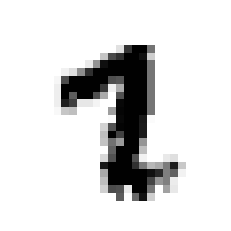

[684] (예측값)2 (실제값)7


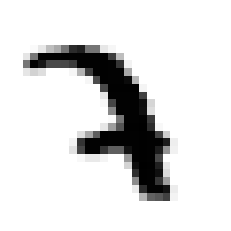

[691] (예측값)4 (실제값)8


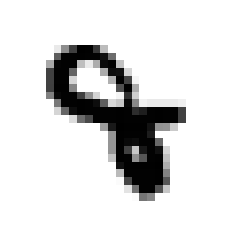

[694] (예측값)8 (실제값)5


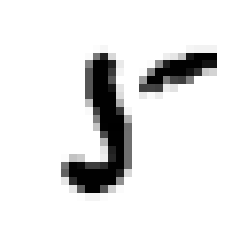

[707] (예측값)9 (실제값)4


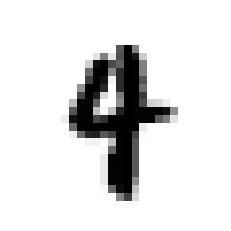

[720] (예측값)8 (실제값)5


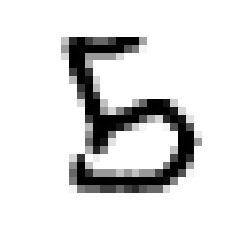

[740] (예측값)9 (실제값)4


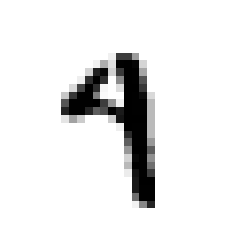

[786] (예측값)5 (실제값)6


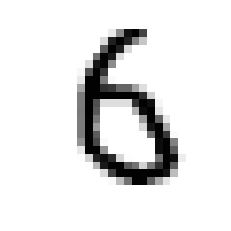

[813] (예측값)8 (실제값)9


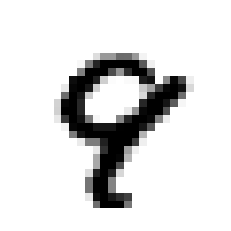

[844] (예측값)7 (실제값)8


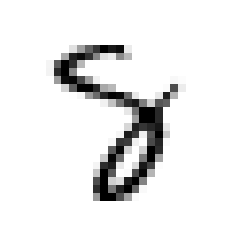

[846] (예측값)9 (실제값)7


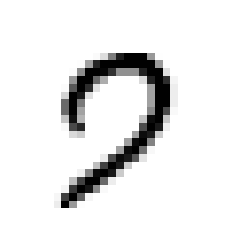

[874] (예측값)4 (실제값)9


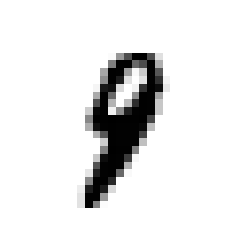

[882] (예측값)7 (실제값)9


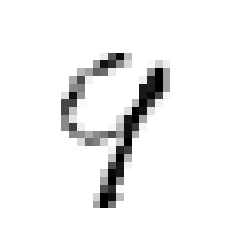

[924] (예측값)7 (실제값)2


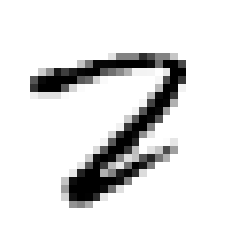

[938] (예측값)5 (실제값)3


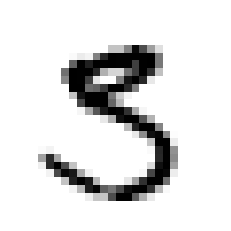

[956] (예측값)2 (실제값)1


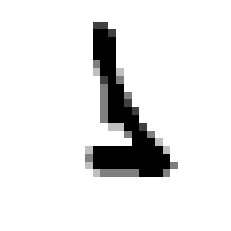

[965] (예측값)0 (실제값)6


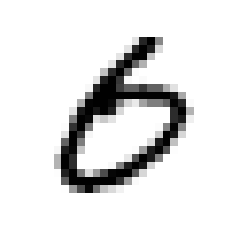

[995] (예측값)0 (실제값)2


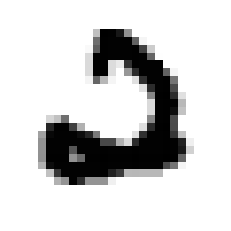

[1003] (예측값)3 (실제값)5


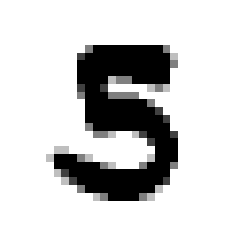

[1014] (예측값)5 (실제값)6


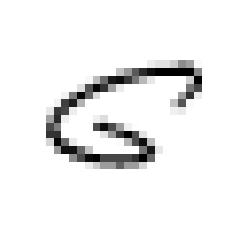

[1039] (예측값)2 (실제값)7


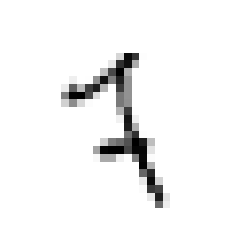

[1044] (예측값)8 (실제값)6


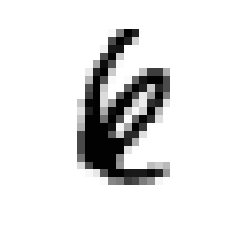

[1112] (예측값)6 (실제값)4


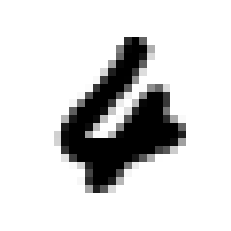

[1128] (예측값)7 (실제값)3


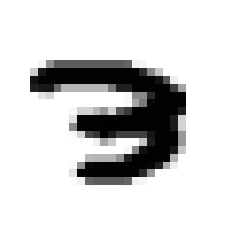

[1181] (예측값)1 (실제값)6


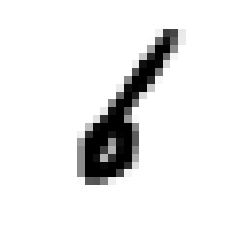

[1182] (예측값)8 (실제값)6


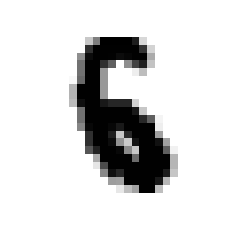

[1191] (예측값)7 (실제값)0


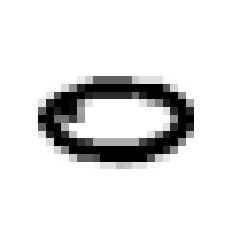

[1192] (예측값)4 (실제값)9


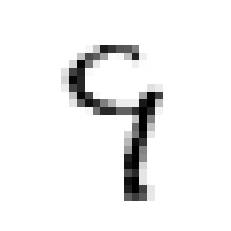

[1194] (예측값)8 (실제값)7


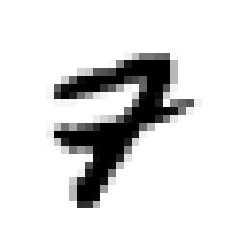

[1198] (예측값)4 (실제값)8


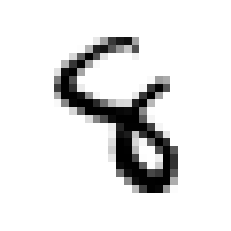

[1224] (예측값)6 (실제값)2


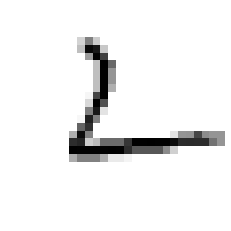

[1226] (예측값)2 (실제값)7


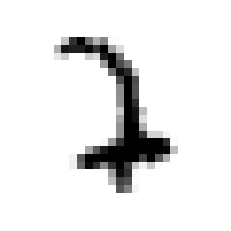

[1232] (예측값)4 (실제값)9


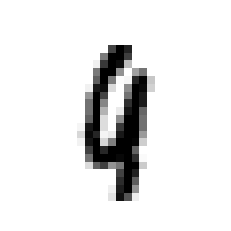

[1242] (예측값)9 (실제값)4


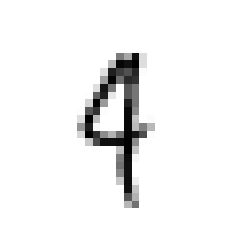

[1247] (예측값)3 (실제값)9


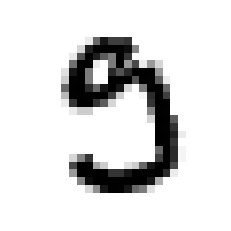

[1260] (예측값)1 (실제값)7


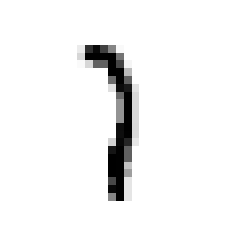

[1283] (예측값)2 (실제값)7


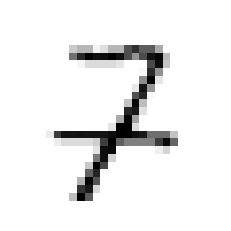

[1319] (예측값)3 (실제값)8


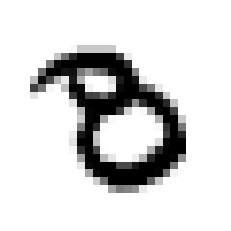

[1325] (예측값)6 (실제값)8


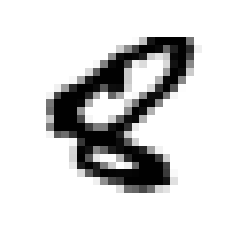

[1326] (예측값)2 (실제값)7


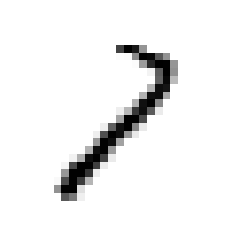

[1328] (예측값)9 (실제값)7


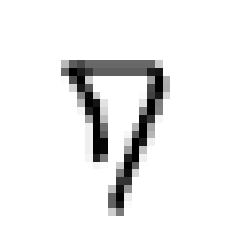

[1337] (예측값)6 (실제값)2


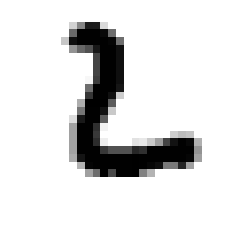

[1364] (예측값)2 (실제값)8


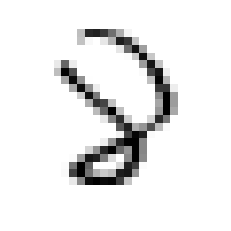

[1378] (예측값)6 (실제값)5


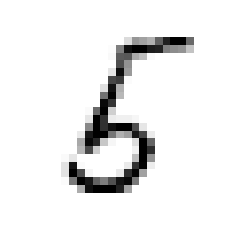

[1393] (예측값)3 (실제값)5


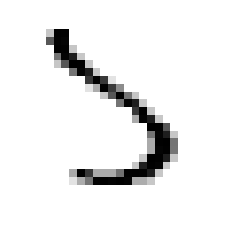

[1494] (예측값)0 (실제값)7


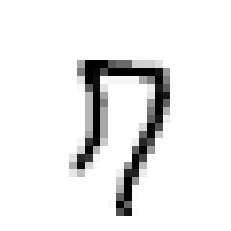

[1500] (예측값)1 (실제값)7


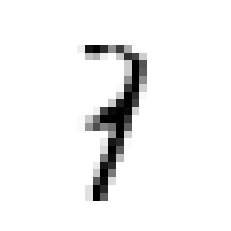

[1522] (예측값)9 (실제값)7


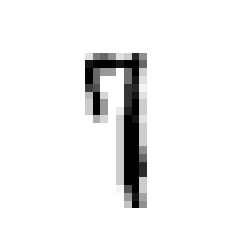

[1530] (예측값)7 (실제값)8


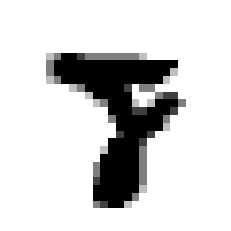

[1549] (예측값)6 (실제값)4


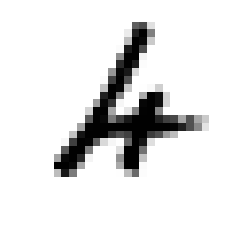

[1553] (예측값)3 (실제값)9


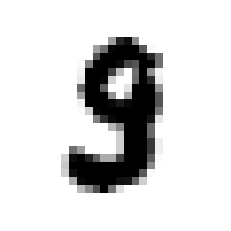

[1569] (예측값)7 (실제값)6


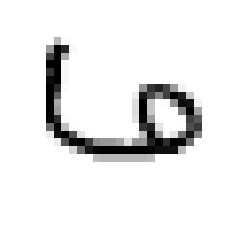

[1587] (예측값)5 (실제값)6


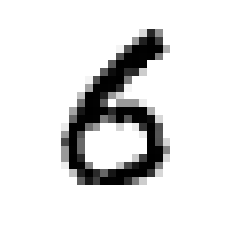

[1609] (예측값)6 (실제값)2


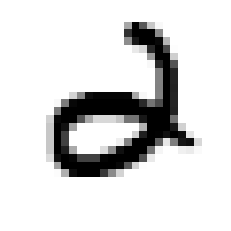

[1621] (예측값)6 (실제값)0


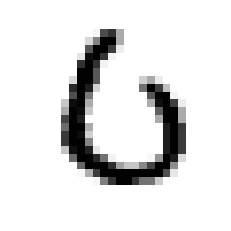

[1671] (예측값)3 (실제값)7


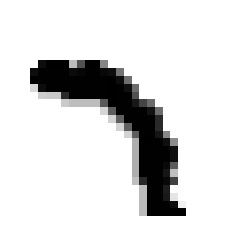

[1681] (예측값)7 (실제값)3


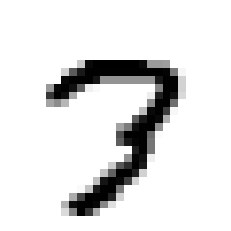

[1709] (예측값)3 (실제값)9


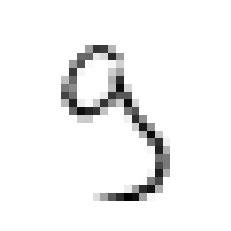

[1717] (예측값)0 (실제값)8


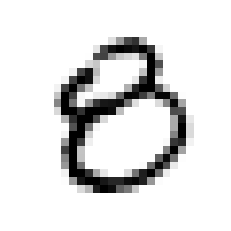

[1737] (예측값)1 (실제값)5


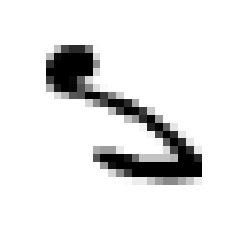

[1754] (예측값)2 (실제값)7


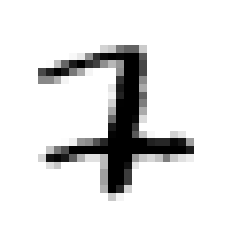

[1773] (예측값)6 (실제값)1


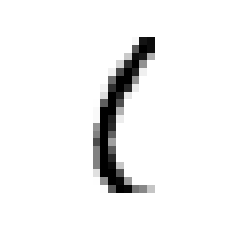

[1790] (예측값)7 (실제값)2


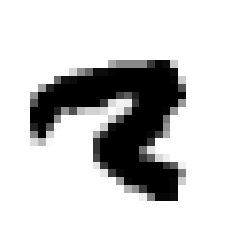

[1819] (예측값)5 (실제값)6


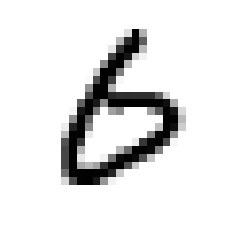

[1828] (예측값)7 (실제값)3


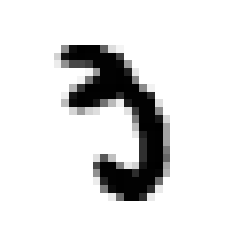

[1878] (예측값)3 (실제값)8


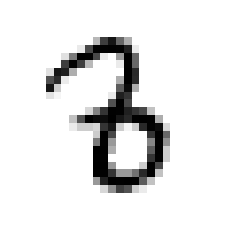

[1901] (예측값)4 (실제값)9


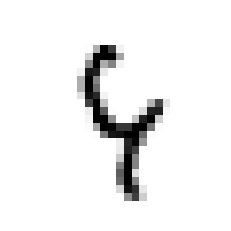

[1938] (예측값)6 (실제값)4


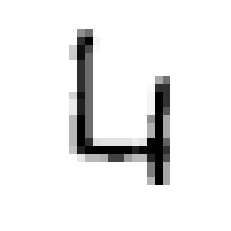

[1941] (예측값)8 (실제값)7


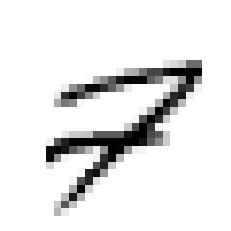

[1952] (예측값)3 (실제값)9


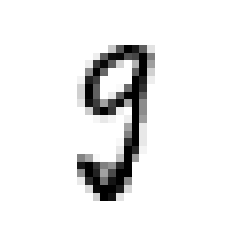

[1984] (예측값)0 (실제값)2


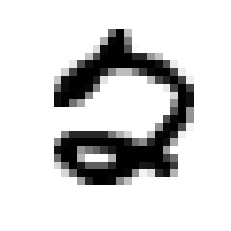

[2016] (예측값)2 (실제값)7


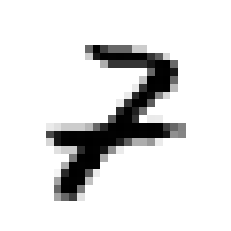

[2024] (예측값)9 (실제값)7


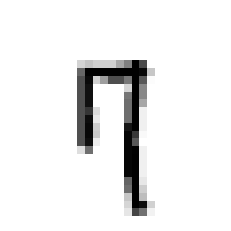

[2035] (예측값)3 (실제값)5


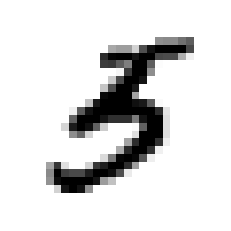

[2040] (예측값)4 (실제값)5


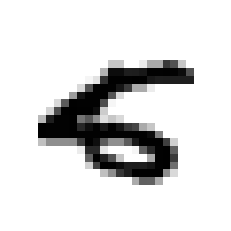

[2043] (예측값)8 (실제값)4


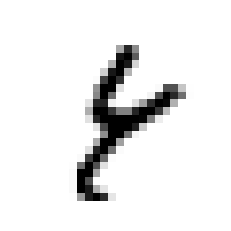

[2044] (예측값)7 (실제값)2


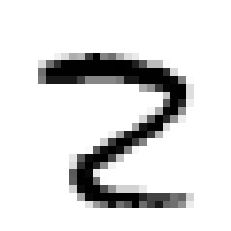

[2052] (예측값)4 (실제값)8


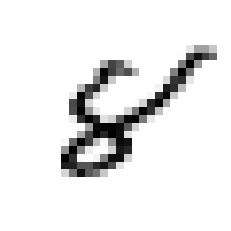

[2053] (예측값)9 (실제값)4


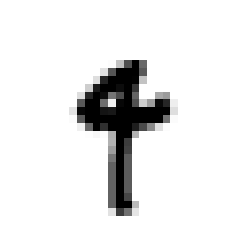

[2098] (예측값)0 (실제값)2


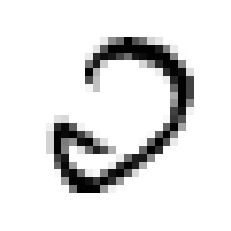

[2109] (예측값)7 (실제값)3


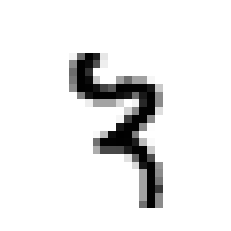

[2118] (예측값)0 (실제값)6


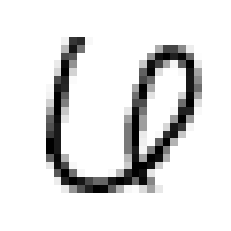

[2129] (예측값)2 (실제값)9


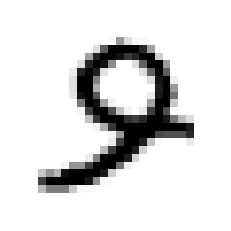

[2130] (예측값)9 (실제값)4


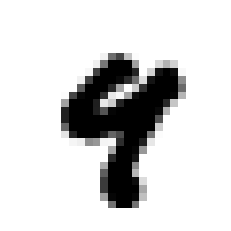

[2135] (예측값)1 (실제값)6


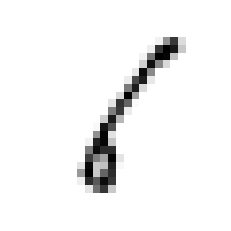

[2182] (예측값)2 (실제값)1


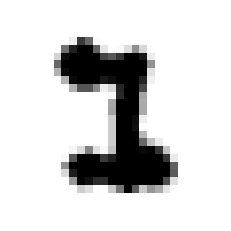

[2186] (예측값)3 (실제값)2


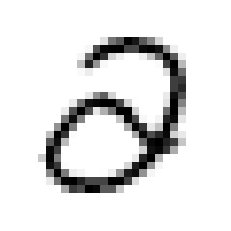

[2189] (예측값)1 (실제값)9


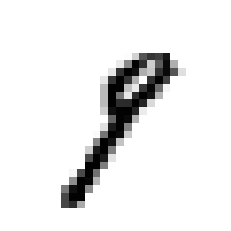

[2224] (예측값)8 (실제값)5


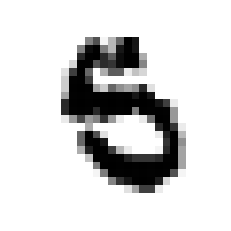

[2266] (예측값)2 (실제값)1


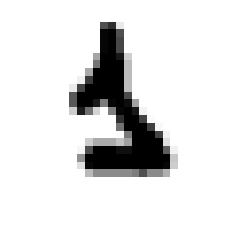

[2272] (예측값)0 (실제값)8


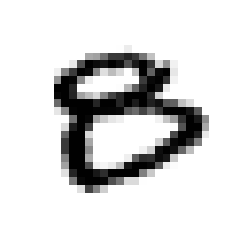

[2293] (예측값)6 (실제값)9


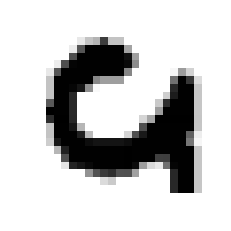

[2299] (예측값)7 (실제값)2


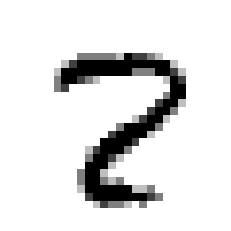

[2308] (예측값)5 (실제값)3


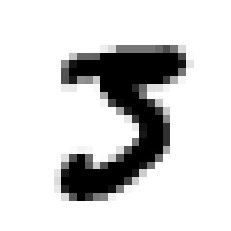

[2369] (예측값)9 (실제값)5


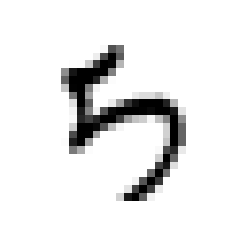

[2387] (예측값)1 (실제값)9


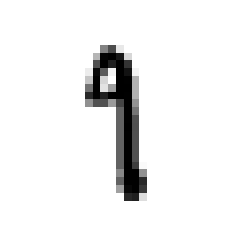

[2395] (예측값)3 (실제값)8


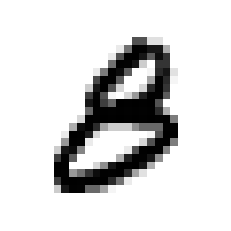

[2406] (예측값)8 (실제값)9


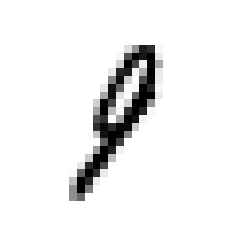

[2414] (예측값)4 (실제값)9


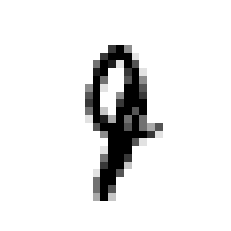

[2422] (예측값)4 (실제값)6


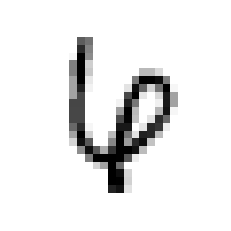

[2425] (예측값)3 (실제값)8


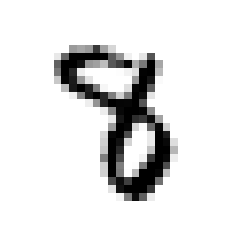

[2433] (예측값)1 (실제값)2


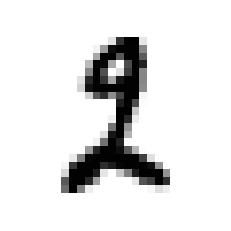

[2462] (예측값)0 (실제값)2


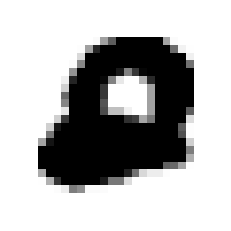

[2488] (예측값)6 (실제값)2


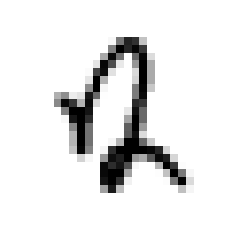

[2514] (예측값)9 (실제값)4


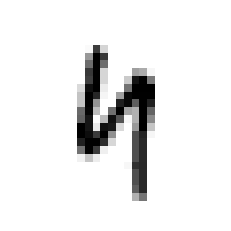

[2573] (예측값)8 (실제값)5


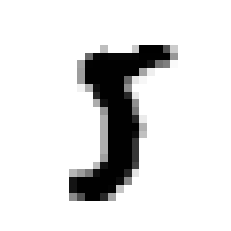

[2582] (예측값)7 (실제값)9


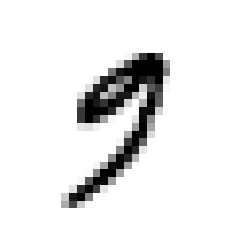

[2607] (예측값)2 (실제값)7


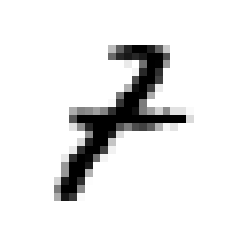

[2648] (예측값)0 (실제값)9


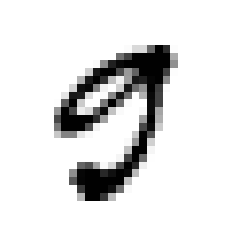

[2654] (예측값)1 (실제값)6


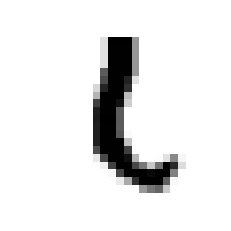

[2810] (예측값)3 (실제값)5


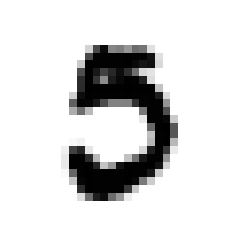

[2863] (예측값)4 (실제값)9


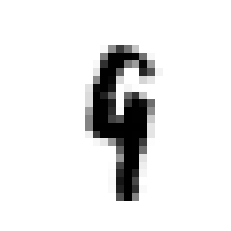

[2877] (예측값)7 (실제값)4


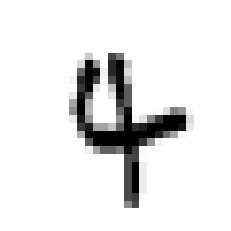

[2896] (예측값)0 (실제값)8


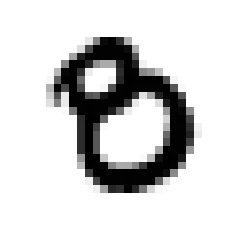

[2907] (예측값)9 (실제값)4


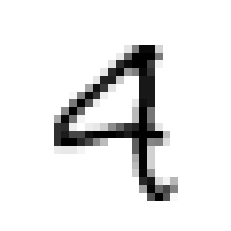

[2915] (예측값)3 (실제값)7


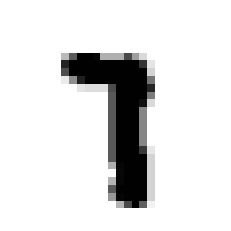

[2927] (예측값)2 (실제값)3


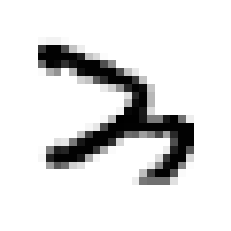

[2939] (예측값)7 (실제값)9


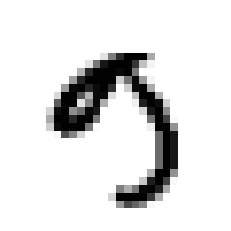

[2953] (예측값)5 (실제값)3


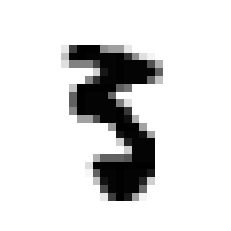

[2961] (예측값)2 (실제값)7


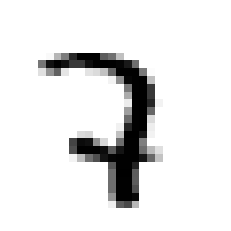

[2970] (예측값)3 (실제값)5


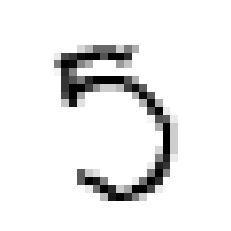

[2995] (예측값)8 (실제값)6


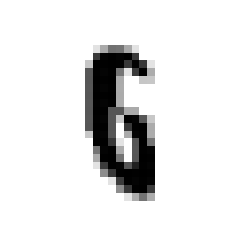

[3005] (예측값)1 (실제값)9


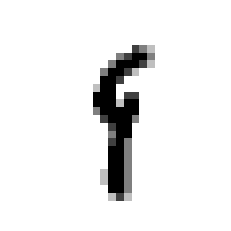

[3030] (예측값)8 (실제값)6


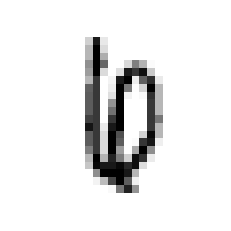

[3073] (예측값)2 (실제값)1


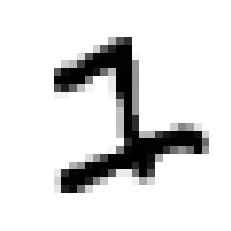

[3114] (예측값)6 (실제값)4


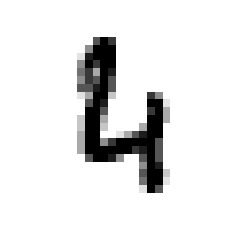

[3117] (예측값)9 (실제값)5


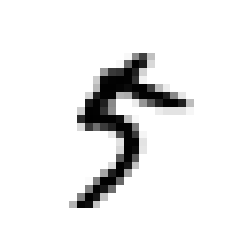

[3130] (예측값)0 (실제값)6


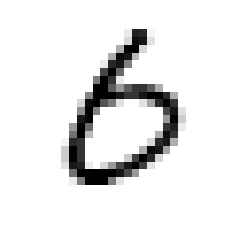

[3240] (예측값)8 (실제값)9


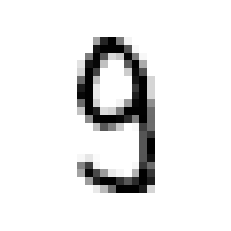

[3376] (예측값)9 (실제값)7


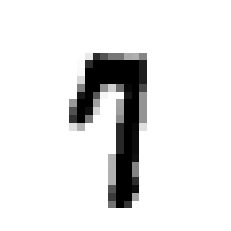

[3384] (예측값)6 (실제값)2


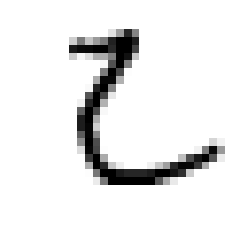

[3422] (예측값)0 (실제값)6


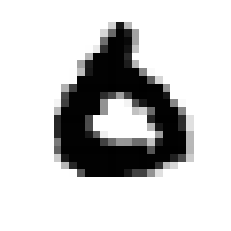

[3451] (예측값)9 (실제값)7


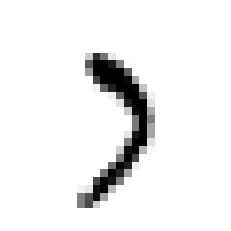

[3474] (예측값)1 (실제값)2


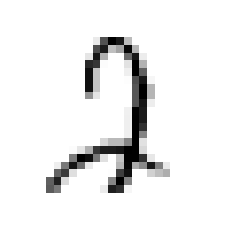

[3490] (예측값)8 (실제값)4


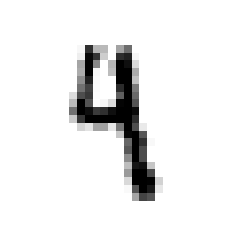

[3503] (예측값)1 (실제값)9


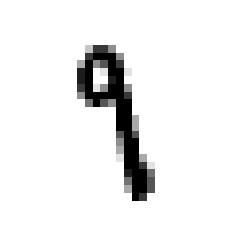

[3520] (예측값)4 (실제값)6


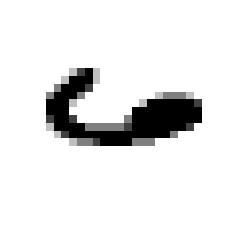

[3549] (예측값)2 (실제값)3


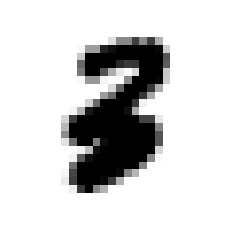

[3558] (예측값)0 (실제값)5


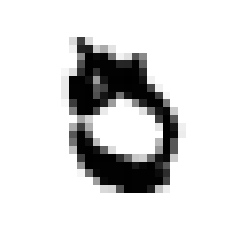

[3559] (예측값)5 (실제값)8


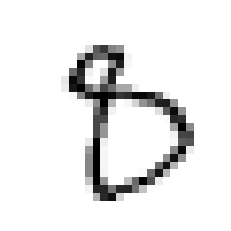

[3567] (예측값)5 (실제값)8


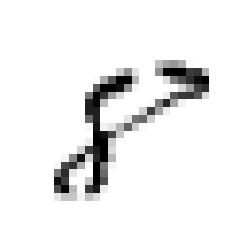

[3597] (예측값)3 (실제값)9


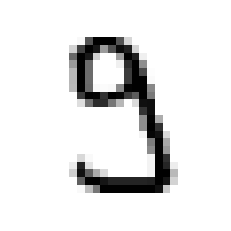

[3618] (예측값)7 (실제값)9


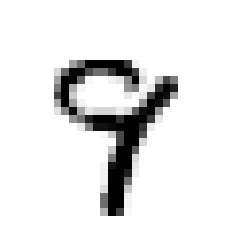

[3681] (예측값)3 (실제값)2


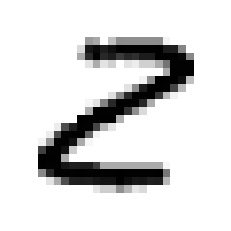

[3702] (예측값)4 (실제값)5


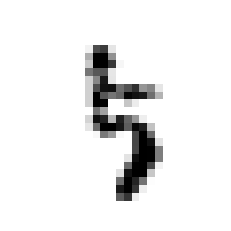

[3757] (예측값)3 (실제값)8


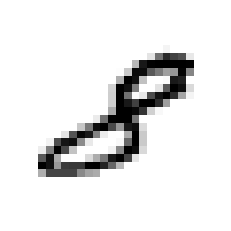

[3767] (예측값)3 (실제값)7


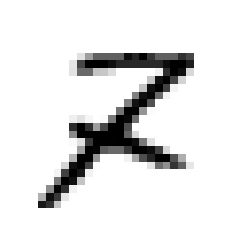

[3776] (예측값)8 (실제값)5


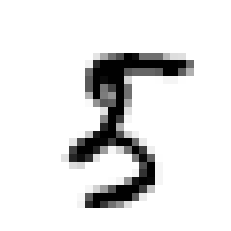

[3780] (예측값)6 (실제값)4


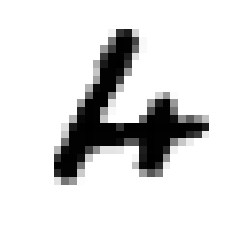

[3808] (예측값)3 (실제값)7


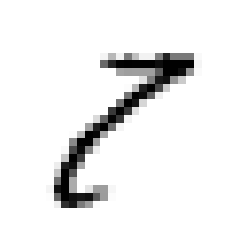

[3811] (예측값)3 (실제값)2


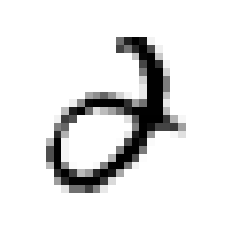

[3818] (예측값)6 (실제값)0


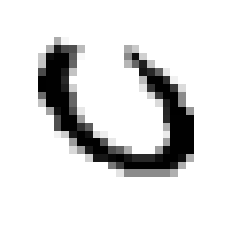

[3853] (예측값)2 (실제값)6


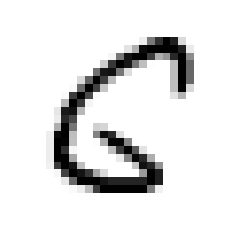

[3869] (예측값)4 (실제값)9


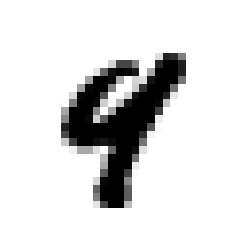

[3906] (예측값)2 (실제값)1


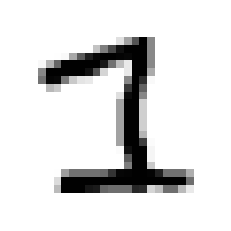

[3926] (예측값)8 (실제값)9


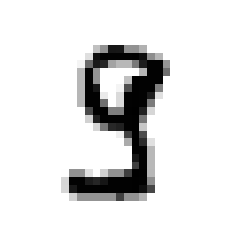

[3941] (예측값)6 (실제값)4


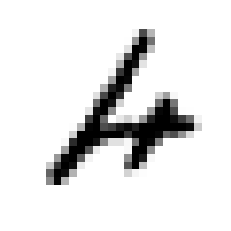

[3943] (예측값)5 (실제값)3


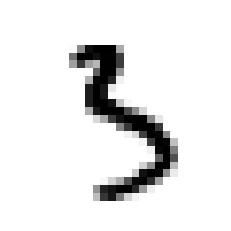

[3946] (예측값)8 (실제값)2


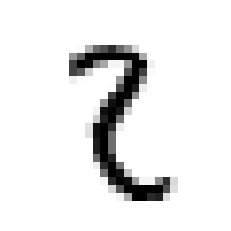

[3976] (예측값)1 (실제값)7


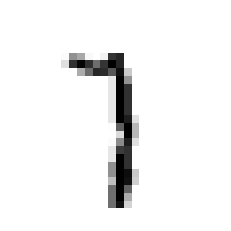

[3984] (예측값)8 (실제값)9


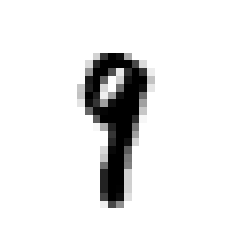

[3985] (예측값)4 (실제값)9


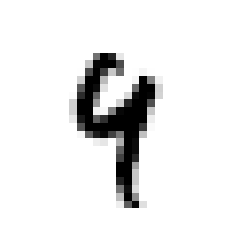

[4007] (예측값)4 (실제값)7


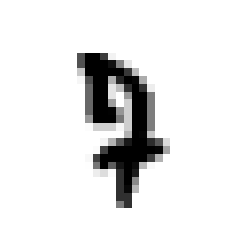

[4063] (예측값)8 (실제값)6


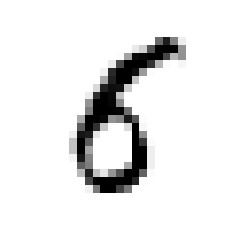

[4065] (예측값)8 (실제값)0


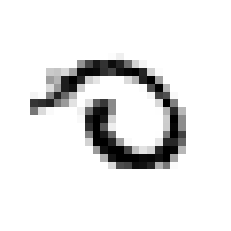

[4075] (예측값)0 (실제값)8


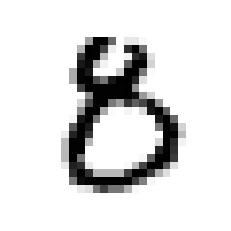

[4078] (예측값)3 (실제값)9


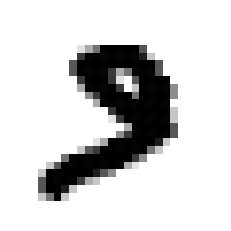

[4152] (예측값)1 (실제값)5


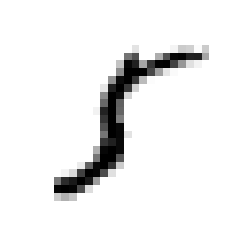

[4163] (예측값)0 (실제값)9


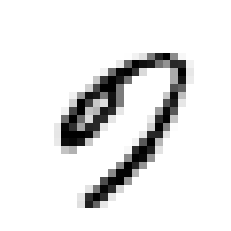

[4176] (예측값)6 (실제값)2


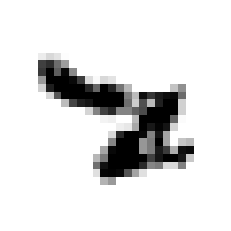

[4199] (예측값)9 (실제값)7


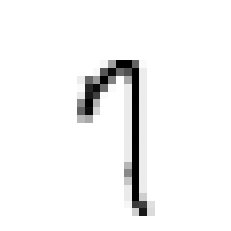

[4201] (예측값)7 (실제값)1


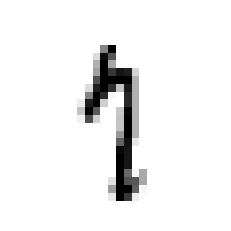

[4211] (예측값)5 (실제값)6


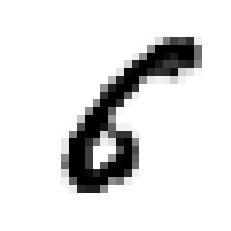

[4224] (예측값)7 (실제값)9


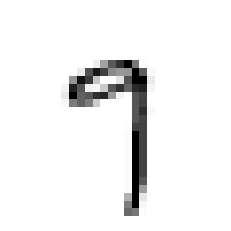

[4228] (예측값)2 (실제값)7


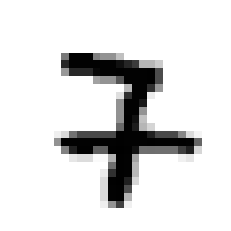

[4248] (예측값)8 (실제값)2


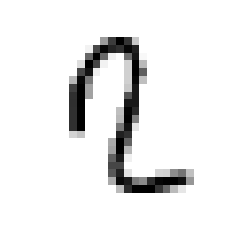

[4255] (예측값)3 (실제값)5


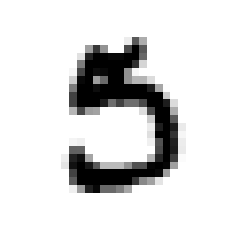

[4271] (예측값)3 (실제값)5


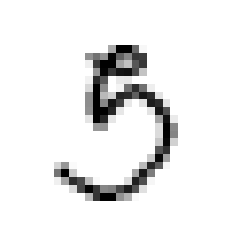

[4289] (예측값)7 (실제값)2


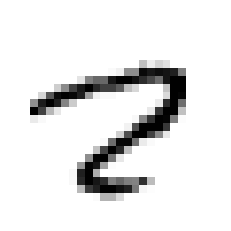

[4306] (예측값)7 (실제값)3


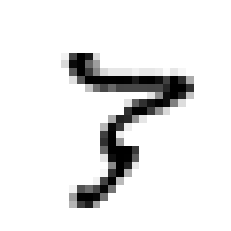

[4314] (예측값)7 (실제값)9


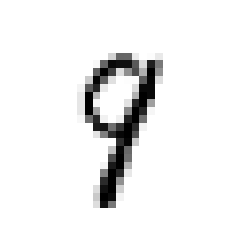

[4344] (예측값)7 (실제값)9


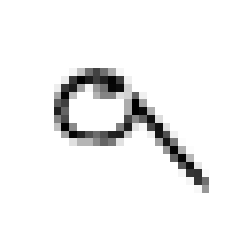

[4355] (예측값)3 (실제값)5


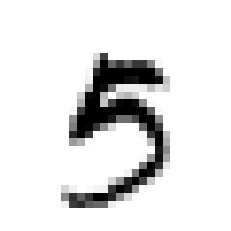

[4360] (예측값)3 (실제값)5


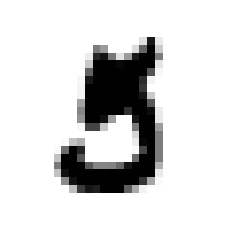

[4369] (예측값)4 (실제값)9


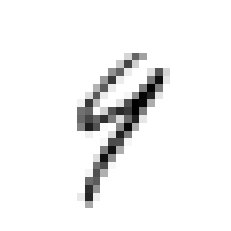

[4415] (예측값)0 (실제값)2


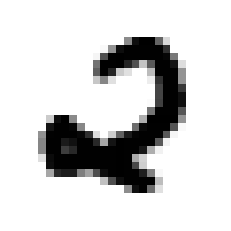

[4425] (예측값)4 (실제값)9


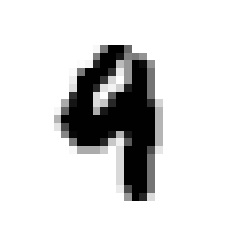

[4433] (예측값)3 (실제값)7


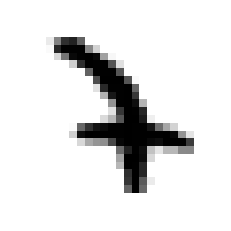

[4477] (예측값)6 (실제값)0


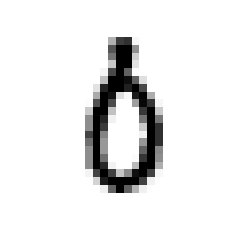

[4487] (예측값)3 (실제값)7


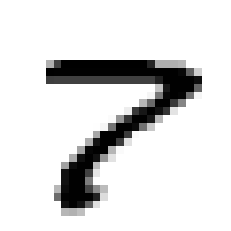

[4497] (예측값)7 (실제값)8


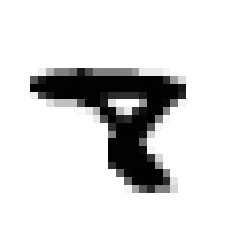

[4534] (예측값)8 (실제값)9


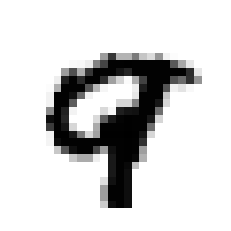

[4536] (예측값)5 (실제값)6


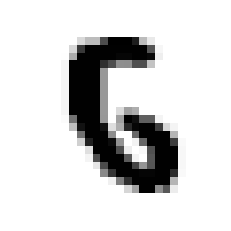

[4547] (예측값)4 (실제값)6


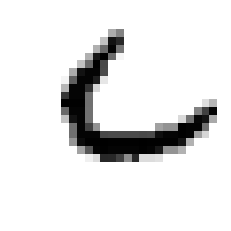

[4601] (예측값)4 (실제값)8


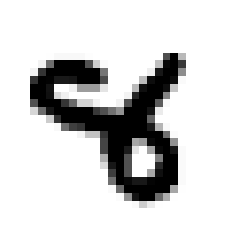

[4635] (예측값)5 (실제값)3


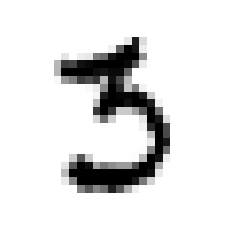

[4639] (예측값)9 (실제값)8


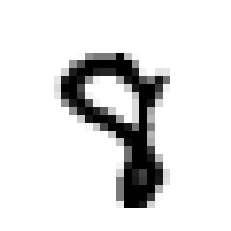

[4690] (예측값)2 (실제값)7


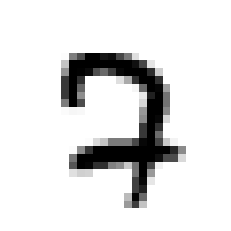

[4736] (예측값)2 (실제값)7


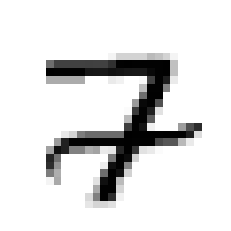

[4751] (예측값)6 (실제값)4


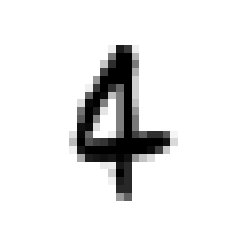

[4761] (예측값)8 (실제값)9


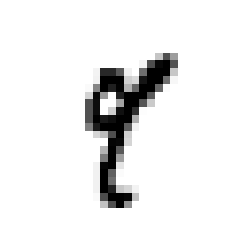

[4807] (예측값)3 (실제값)8


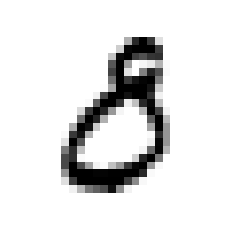

[4823] (예측값)4 (실제값)9


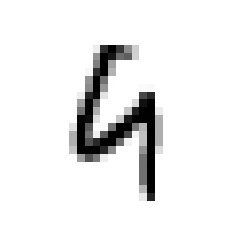

[4860] (예측값)9 (실제값)4


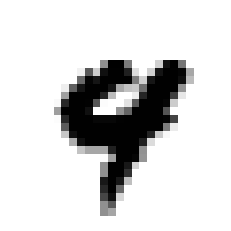

[4876] (예측값)4 (실제값)2


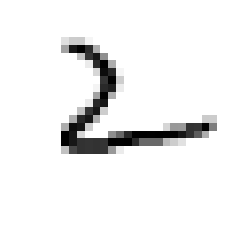

[4880] (예측값)8 (실제값)0


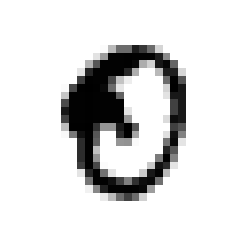

[4886] (예측값)1 (실제값)7


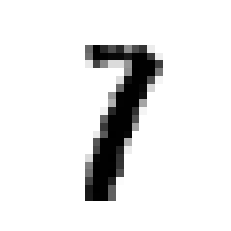

[4952] (예측값)5 (실제값)6


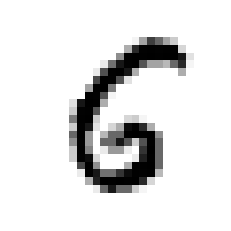

[4956] (예측값)4 (실제값)8


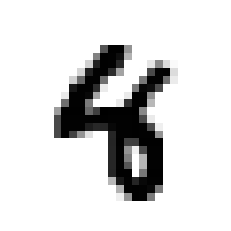

[4966] (예측값)8 (실제값)7


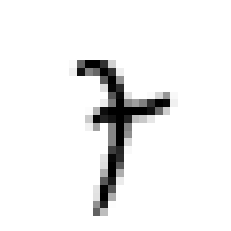

[4990] (예측값)8 (실제값)3


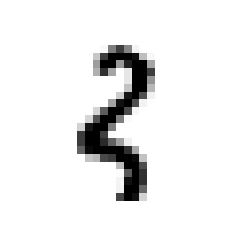

[5067] (예측값)2 (실제값)3


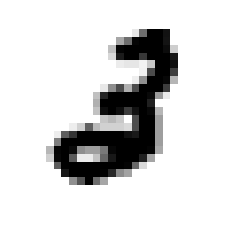

[5165] (예측값)3 (실제값)0


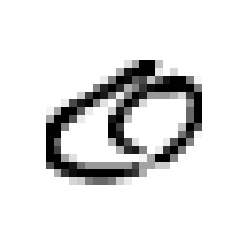

[5209] (예측값)6 (실제값)8


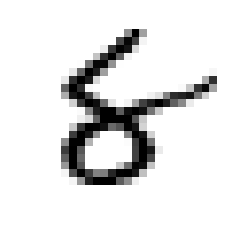

[5331] (예측값)6 (실제값)1


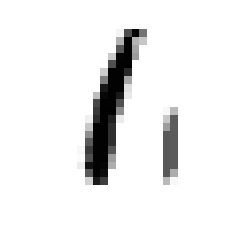

[5409] (예측값)6 (실제값)4


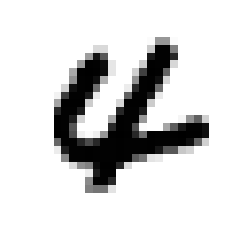

[5457] (예측값)8 (실제값)1


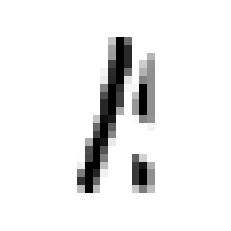

[5493] (예측값)3 (실제값)8


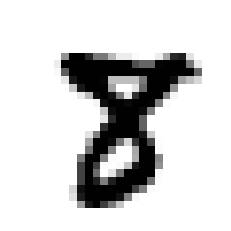

[5495] (예측값)3 (실제값)8


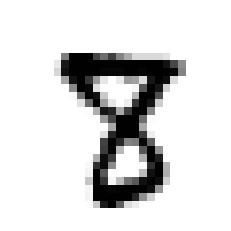

[5564] (예측값)7 (실제값)4


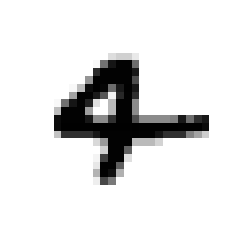

[5586] (예측값)0 (실제값)8


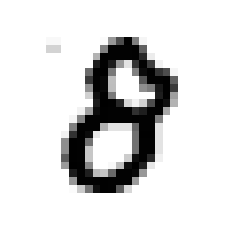

[5600] (예측값)9 (실제값)7


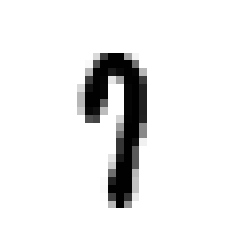

[5634] (예측값)3 (실제값)2


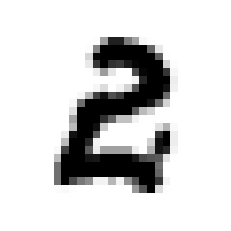

[5642] (예측값)5 (실제값)1


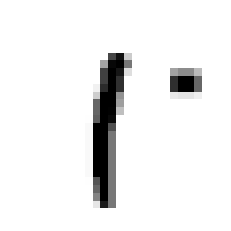

[5734] (예측값)7 (실제값)3


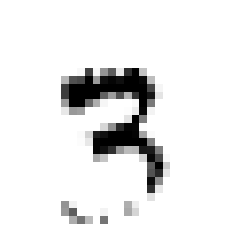

[5735] (예측값)4 (실제값)5


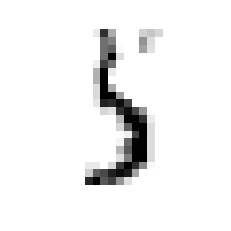

[5749] (예측값)2 (실제값)8


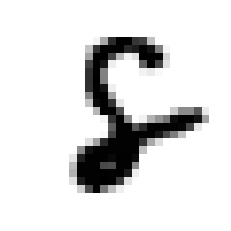

[5842] (예측값)7 (실제값)4


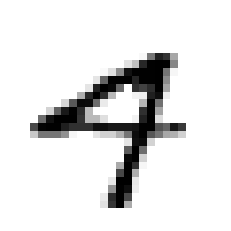

[5887] (예측값)5 (실제값)7


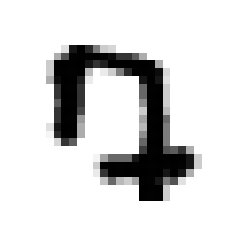

[5888] (예측값)6 (실제값)4


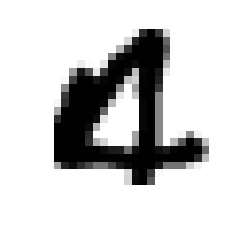

[5926] (예측값)9 (실제값)4


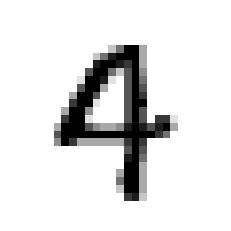

[5936] (예측값)9 (실제값)4


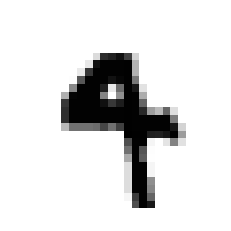

[5937] (예측값)3 (실제값)5


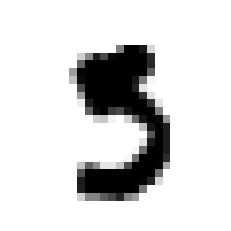

[5955] (예측값)8 (실제값)3


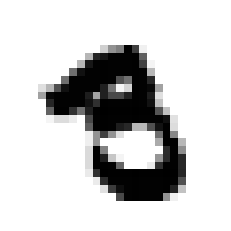

[5972] (예측값)3 (실제값)5


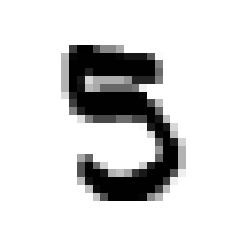

[5973] (예측값)8 (실제값)3


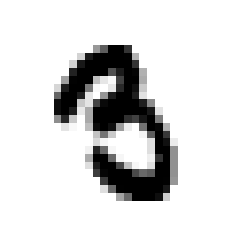

[6035] (예측값)6 (실제값)2


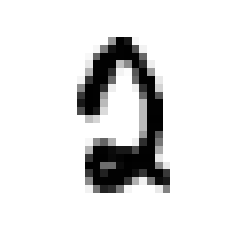

[6059] (예측값)9 (실제값)3


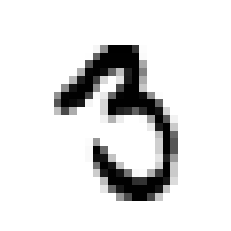

[6091] (예측값)8 (실제값)9


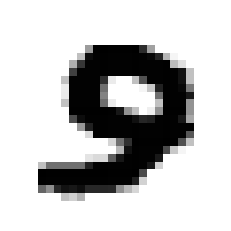

[6166] (예측값)3 (실제값)9


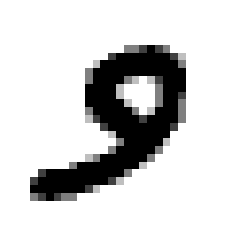

[6390] (예측값)8 (실제값)5


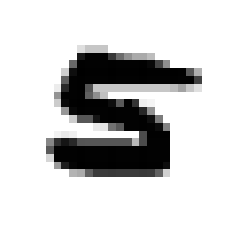

[6391] (예측값)6 (실제값)2


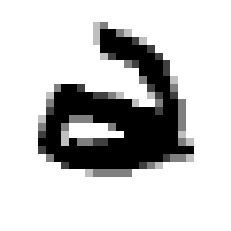

[6400] (예측값)6 (실제값)0


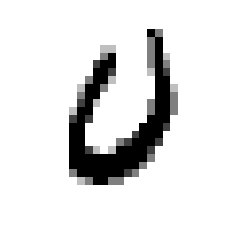

[6505] (예측값)0 (실제값)9


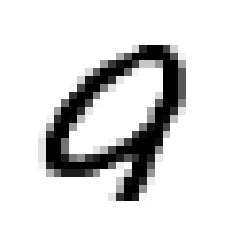

[6532] (예측값)5 (실제값)0


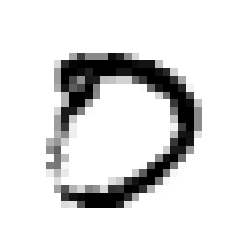

[6555] (예측값)9 (실제값)8


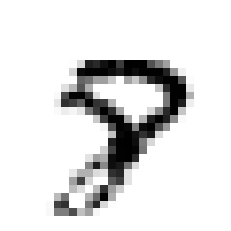

[6560] (예측값)3 (실제값)9


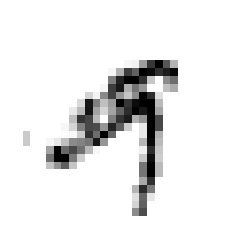

[6568] (예측값)4 (실제값)9


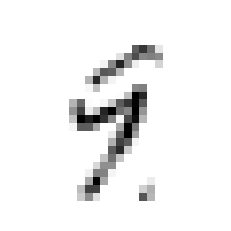

[6571] (예측값)7 (실제값)9


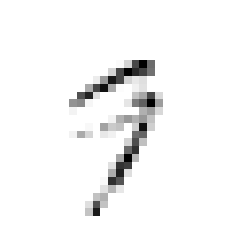

[6573] (예측값)3 (실제값)5


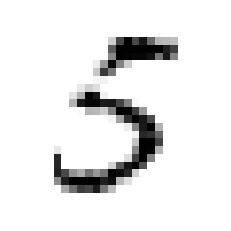

[6576] (예측값)1 (실제값)7


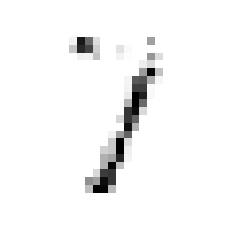

[6597] (예측값)7 (실제값)0


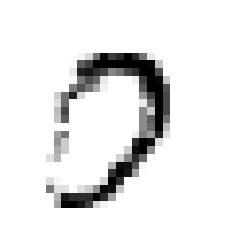

[6598] (예측값)3 (실제값)5


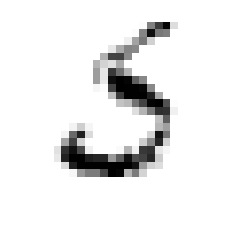

[6625] (예측값)2 (실제값)8


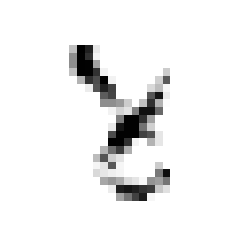

[6645] (예측값)8 (실제값)2


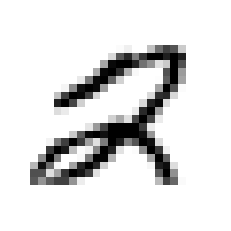

[6651] (예측값)5 (실제값)0


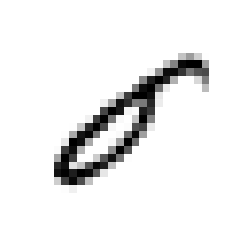

[6783] (예측값)6 (실제값)1


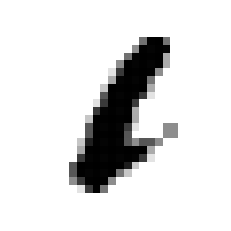

[7432] (예측값)2 (실제값)7


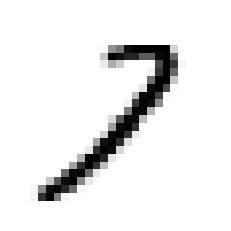

[7434] (예측값)8 (실제값)4


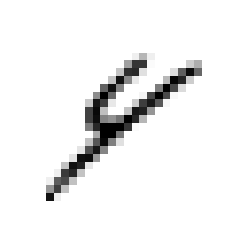

[7451] (예측값)6 (실제값)5


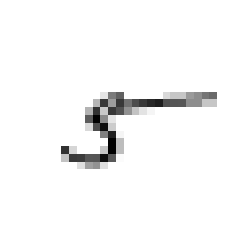

[7545] (예측값)9 (실제값)8


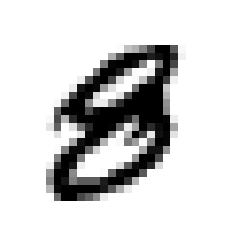

[7569] (예측값)9 (실제값)8


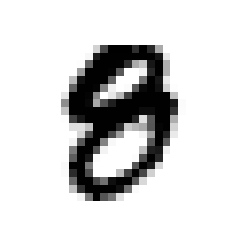

[7595] (예측값)8 (실제값)3


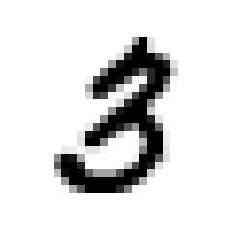

[7637] (예측값)3 (실제값)2


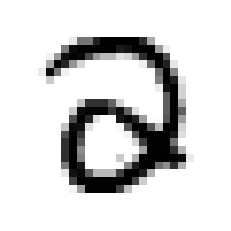

[7812] (예측값)8 (실제값)1


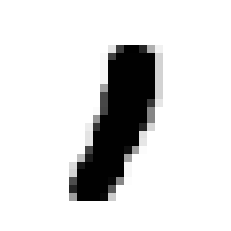

[7847] (예측값)8 (실제값)1


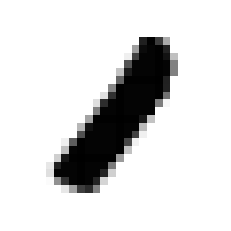

[7849] (예측값)4 (실제값)3


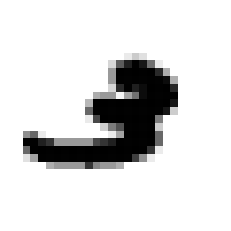

[7856] (예측값)8 (실제값)1


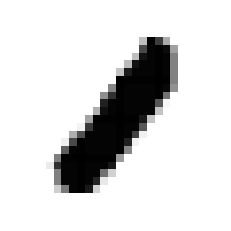

[7858] (예측값)2 (실제값)3


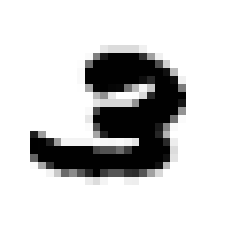

[7886] (예측값)4 (실제값)2


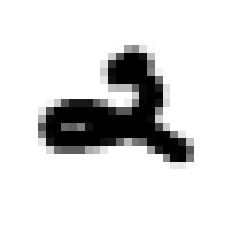

[7899] (예측값)8 (실제값)1


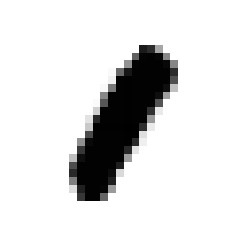

[7928] (예측값)8 (실제값)1


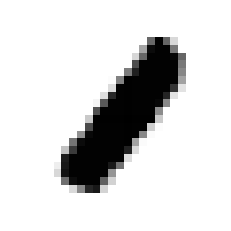

[7990] (예측값)8 (실제값)1


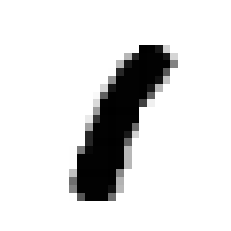

[7991] (예측값)8 (실제값)9


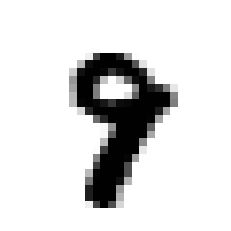

[8020] (예측값)8 (실제값)1


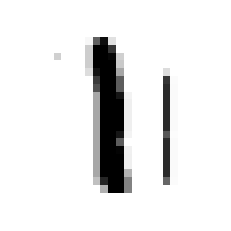

[8062] (예측값)8 (실제값)5


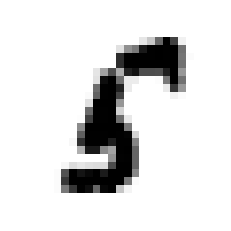

[8094] (예측값)8 (실제값)2


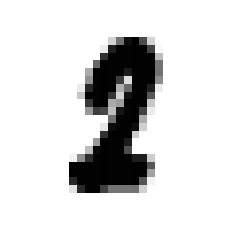

[8095] (예측값)6 (실제값)4


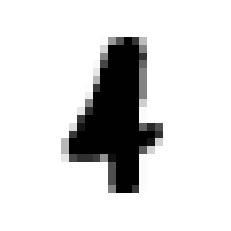

[8097] (예측값)9 (실제값)8


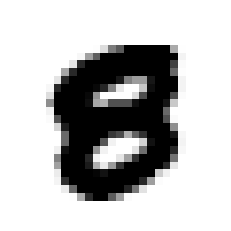

[8160] (예측값)3 (실제값)5


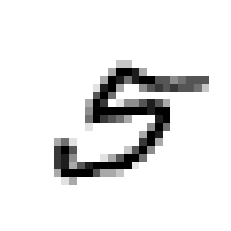

[8198] (예측값)4 (실제값)2


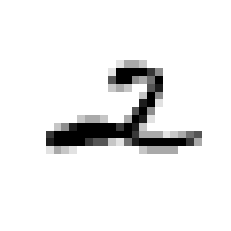

[8272] (예측값)8 (실제값)3


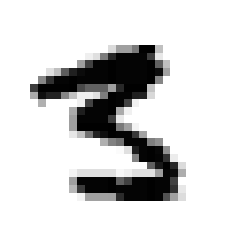

[8277] (예측값)8 (실제값)3


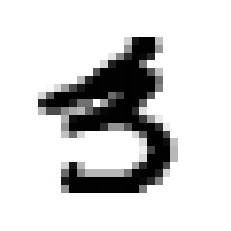

[8296] (예측값)8 (실제값)3


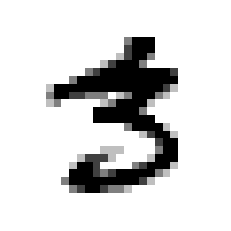

[8325] (예측값)6 (실제값)0


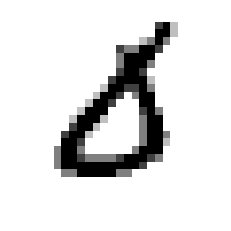

[8339] (예측값)6 (실제값)8


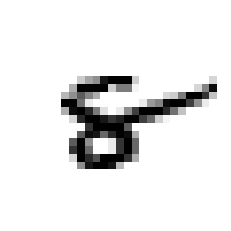

[8406] (예측값)9 (실제값)4


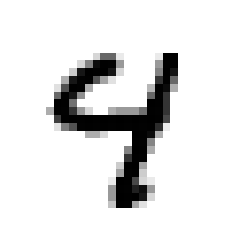

[8408] (예측값)6 (실제값)8


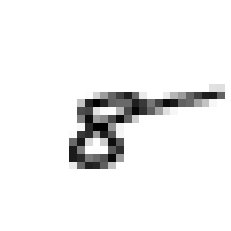

[8410] (예측값)6 (실제값)8


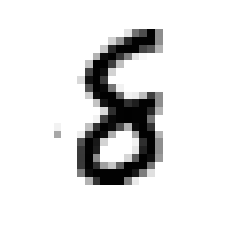

[8519] (예측값)3 (실제값)7


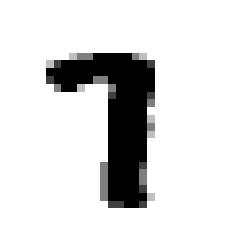

[8520] (예측값)9 (실제값)4


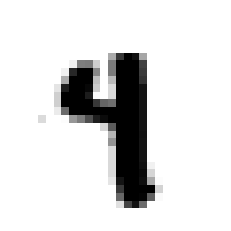

[8522] (예측값)6 (실제값)8


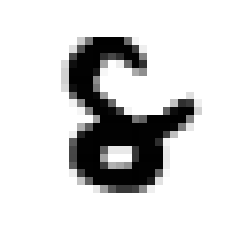

[9009] (예측값)2 (실제값)7


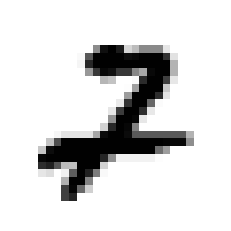

[9015] (예측값)2 (실제값)7


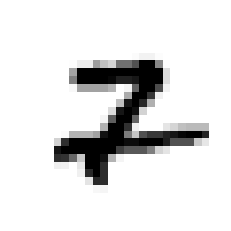

[9019] (예측값)2 (실제값)7


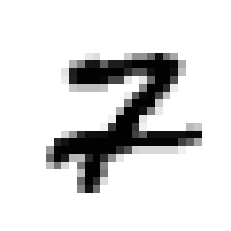

[9024] (예측값)2 (실제값)7


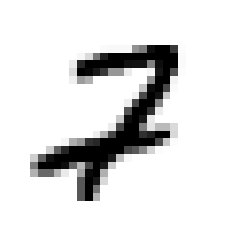

[9031] (예측값)2 (실제값)7


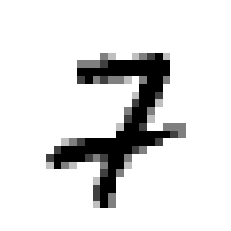

[9036] (예측값)2 (실제값)7


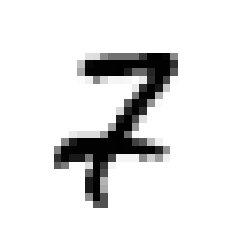

[9045] (예측값)2 (실제값)7


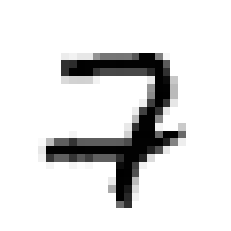

[9071] (예측값)8 (실제값)1


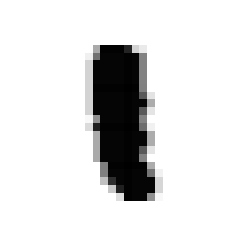

[9280] (예측값)5 (실제값)8


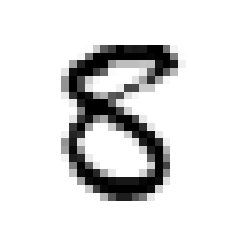

[9513] (예측값)8 (실제값)5


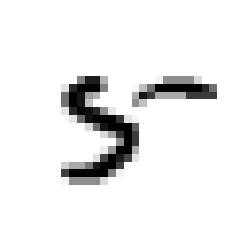

[9587] (예측값)4 (실제값)9


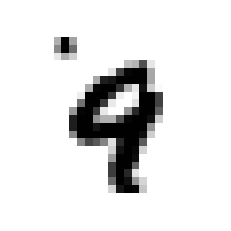

[9624] (예측값)8 (실제값)3


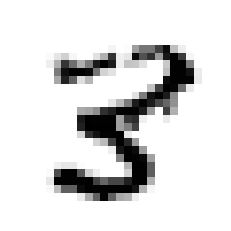

[9634] (예측값)8 (실제값)0


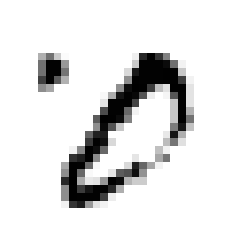

[9662] (예측값)2 (실제값)3


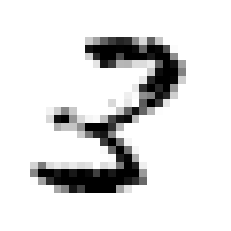

[9664] (예측값)7 (실제값)2


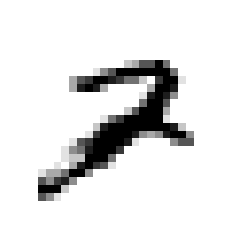

[9669] (예측값)7 (실제값)4


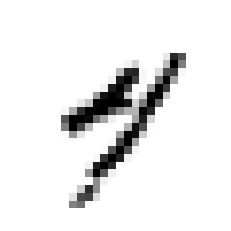

[9679] (예측값)5 (실제값)6


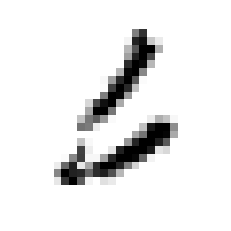

[9698] (예측값)5 (실제값)6


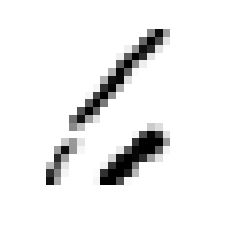

[9719] (예측값)0 (실제값)5


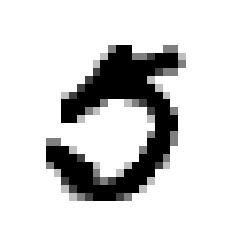

[9729] (예측값)6 (실제값)5


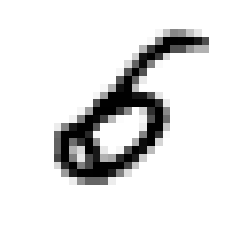

[9745] (예측값)2 (실제값)4


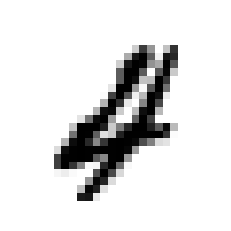

[9749] (예측값)6 (실제값)5


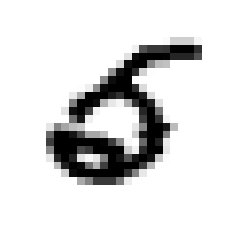

[9768] (예측값)0 (실제값)2


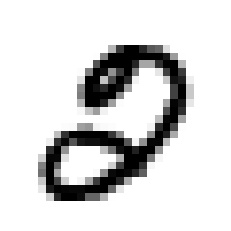

[9770] (예측값)0 (실제값)5


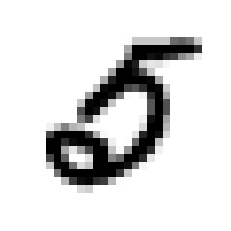

[9779] (예측값)0 (실제값)2


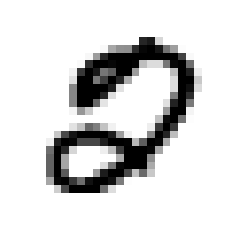

[9808] (예측값)4 (실제값)9


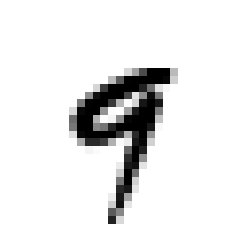

[9811] (예측값)8 (실제값)2


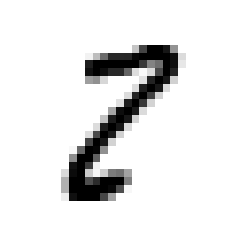

[9839] (예측값)7 (실제값)2


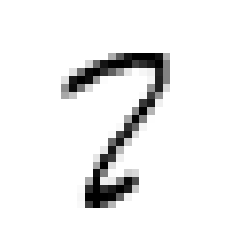

[9905] (예측값)8 (실제값)3


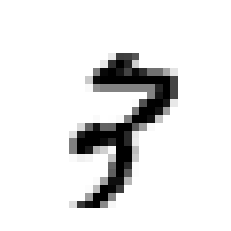

[9944] (예측값)9 (실제값)3


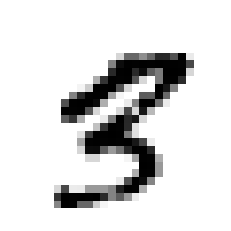

[9982] (예측값)6 (실제값)5


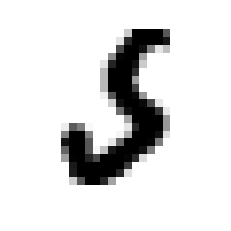

In [20]:
ML_Training()
#sneaky_generate_all()

정상샘플로 측정한 성능결과 : 
Result of Training Data : (total)60000, (hit)58703, (miss)1297, (accuracy)97.83833333333334%
Result of Test Data : (total)10000, (hit)9664, (miss)336, (accuracy)96.64%
적대적샘플로 측정한 성능결과 : 
Result of Training Data : (total)60000, (hit)37338, (miss)22662, (accuracy)62.23%
Result of Test Data : (total)10000, (hit)6211, (miss)3789, (accuracy)62.11%
[2] (예측값)4 (실제값)1


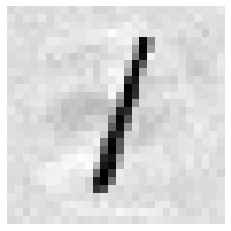

[3] (예측값)5 (실제값)0


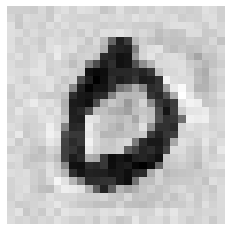

[4] (예측값)6 (실제값)4


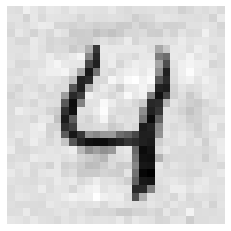

[5] (예측값)7 (실제값)1


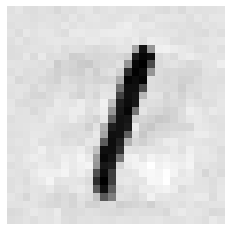

[7] (예측값)7 (실제값)9


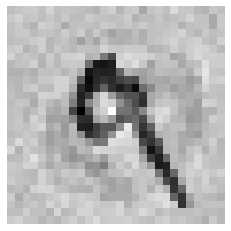

[9] (예측값)2 (실제값)9


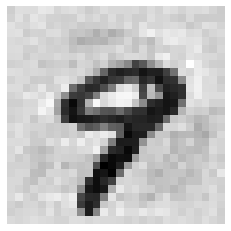

[10] (예측값)3 (실제값)0


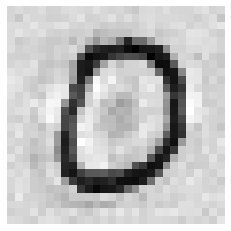

[12] (예측값)5 (실제값)9


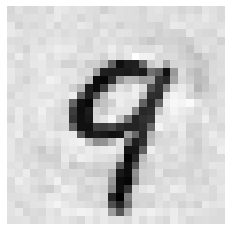

[15] (예측값)8 (실제값)5


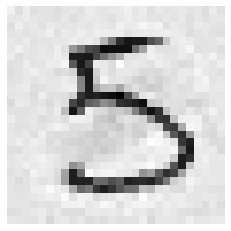

[18] (예측값)8 (실제값)3


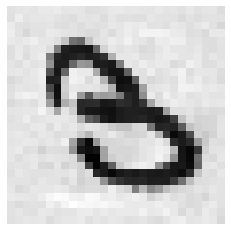

[20] (예측값)4 (실제값)9


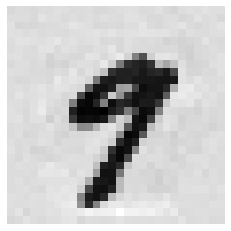

[21] (예측값)5 (실제값)6


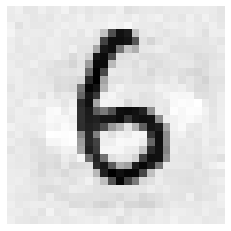

[24] (예측값)9 (실제값)4


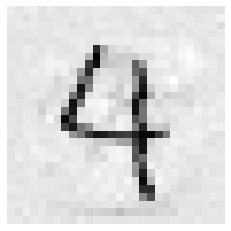

[26] (예측값)2 (실제값)7


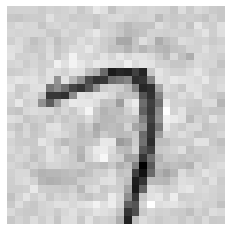

[27] (예측값)2 (실제값)4


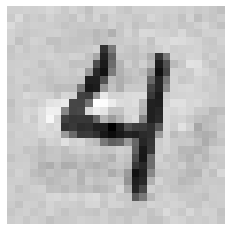

[33] (예측값)8 (실제값)4


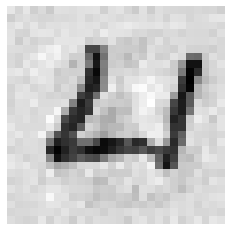

[36] (예측값)1 (실제값)7


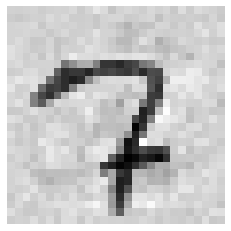

[38] (예측값)3 (실제값)2


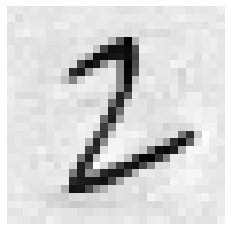

[40] (예측값)5 (실제값)1


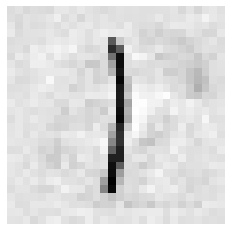

[41] (예측값)6 (실제값)7


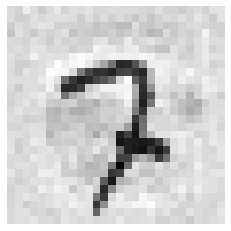

[43] (예측값)8 (실제값)2


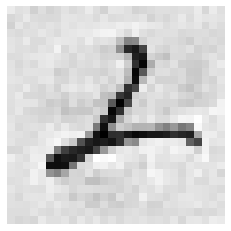

[45] (예측값)0 (실제값)5


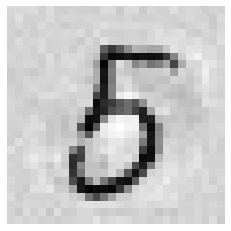

[48] (예측값)5 (실제값)4


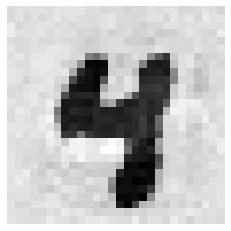

[54] (예측값)1 (실제값)6


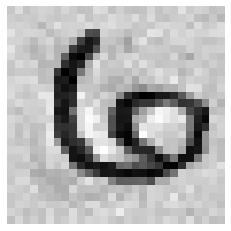

[57] (예측값)4 (실제값)1


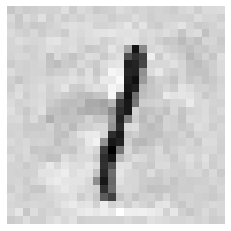

[58] (예측값)5 (실제값)9


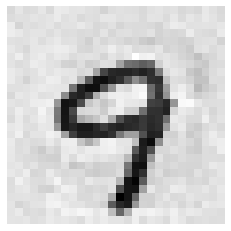

[61] (예측값)9 (실제값)8


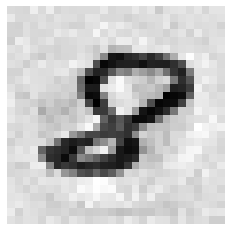

[62] (예측값)5 (실제값)9


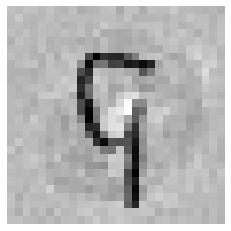

[63] (예측값)2 (실제값)3


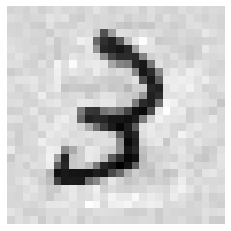

[64] (예측값)2 (실제값)7


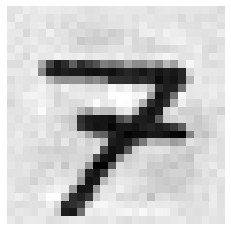

[65] (예측값)3 (실제값)4


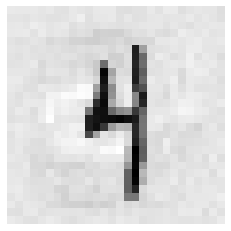

[67] (예측값)5 (실제값)4


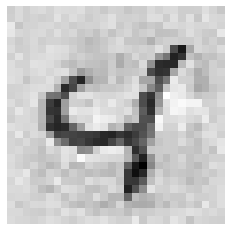

[73] (예측값)8 (실제값)9


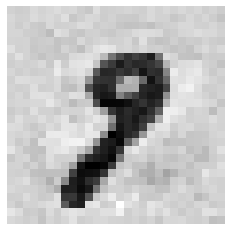

[76] (예측값)4 (실제값)3


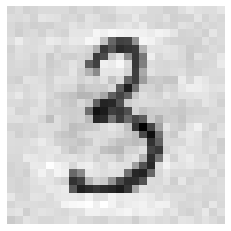

[78] (예측값)6 (실제값)9


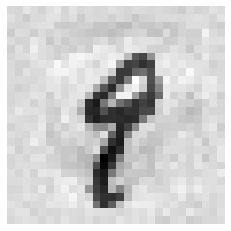

[79] (예측값)8 (실제값)7


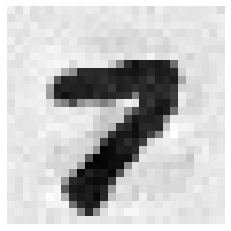

[80] (예측값)9 (실제값)7


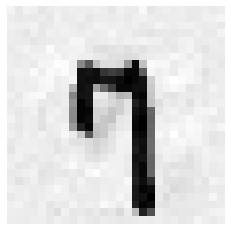

[81] (예측값)0 (실제값)6


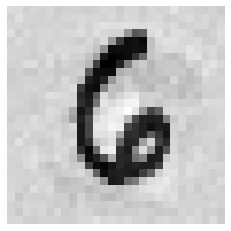

[87] (예측값)7 (실제값)3


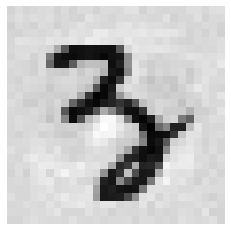

[92] (예측값)2 (실제값)9


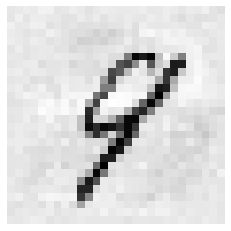

[94] (예측값)8 (실제값)1


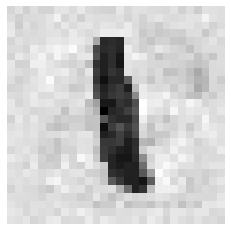

[96] (예측값)9 (실제값)1


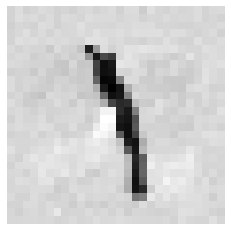

[98] (예측값)5 (실제값)6


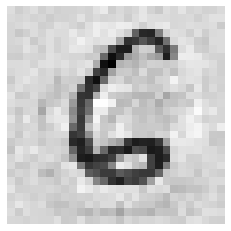

[100] (예측값)1 (실제값)6


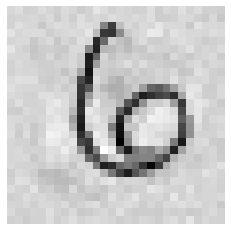

[104] (예측값)8 (실제값)9


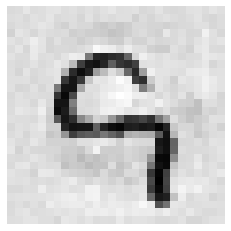

[105] (예측값)7 (실제값)9


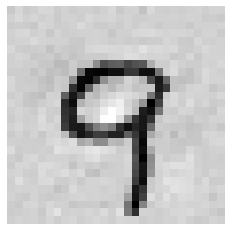

[107] (예측값)9 (실제값)1


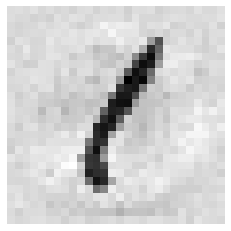

[108] (예측값)5 (실제값)9


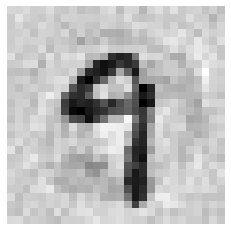

[111] (예측값)3 (실제값)7


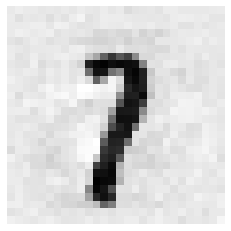

[112] (예측값)4 (실제값)3


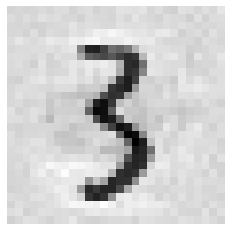

[114] (예측값)6 (실제값)7


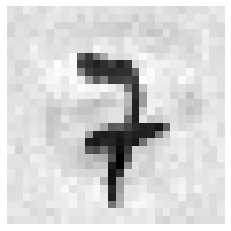

[117] (예측값)9 (실제값)4


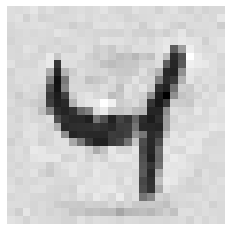

[118] (예측값)0 (실제값)9


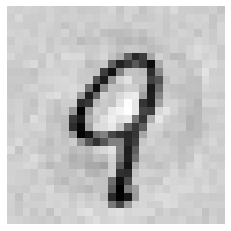

[121] (예측값)9 (실제값)4


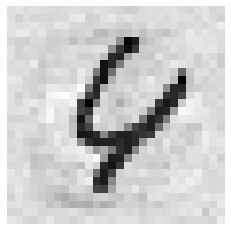

[122] (예측값)4 (실제값)7


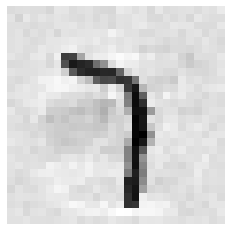

[124] (예측값)6 (실제값)7


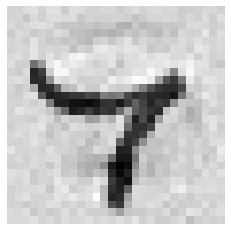

[126] (예측값)8 (실제값)0


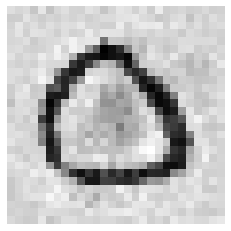

[143] (예측값)5 (실제값)1


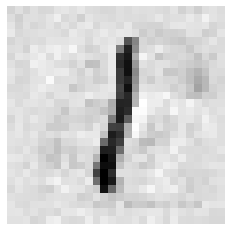

[144] (예측값)4 (실제값)7


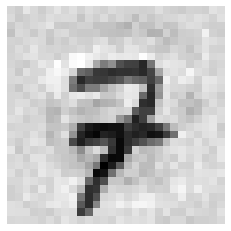

[145] (예측값)7 (실제값)1


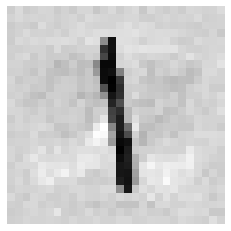

[147] (예측값)0 (실제값)2


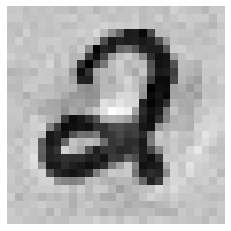

[149] (예측값)9 (실제값)2


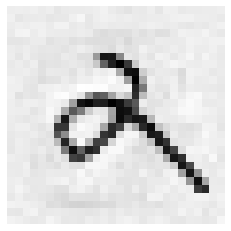

[150] (예측값)4 (실제값)9


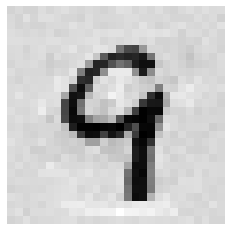

[151] (예측값)5 (실제값)9


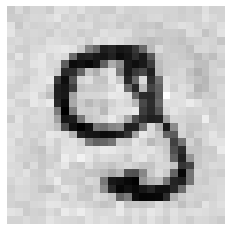

[154] (예측값)8 (실제값)1


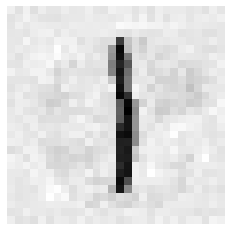

[158] (예측값)2 (실제값)3


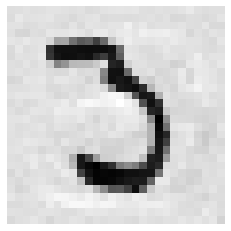

[165] (예측값)3 (실제값)5


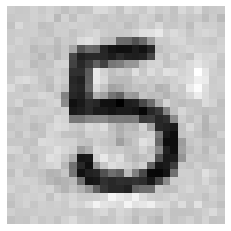

[166] (예측값)2 (실제값)4


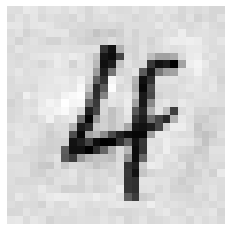

[169] (예측값)5 (실제값)4


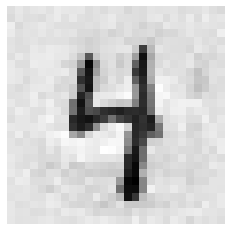

[171] (예측값)8 (실제값)7


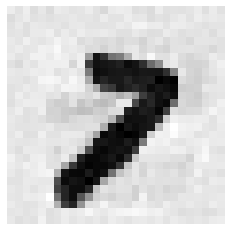

[173] (예측값)0 (실제값)3


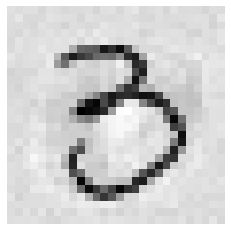

[175] (예측값)2 (실제값)7


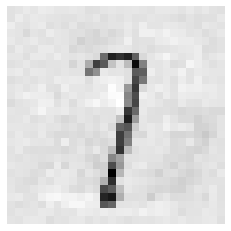

[176] (예측값)3 (실제값)1


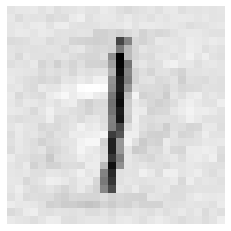

[177] (예측값)4 (실제값)8


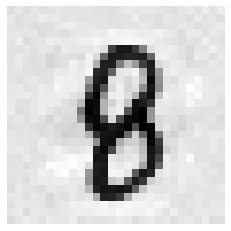

[180] (예측값)7 (실제값)1


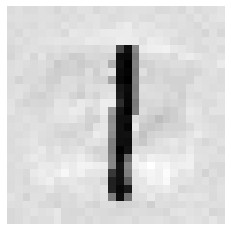

[190] (예측값)9 (실제값)1


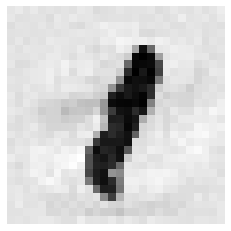

[191] (예측값)2 (실제값)1


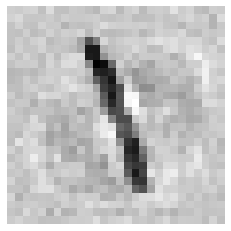

[193] (예측값)2 (실제값)9


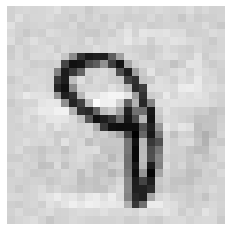

[194] (예측값)3 (실제값)0


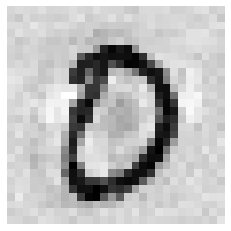

[195] (예측값)4 (실제값)3


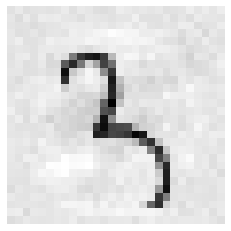

[196] (예측값)5 (실제값)1


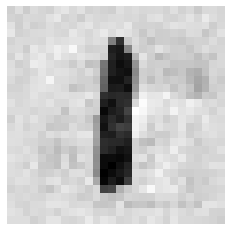

[202] (예측값)2 (실제값)1


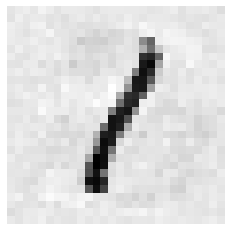

[203] (예측값)3 (실제값)1


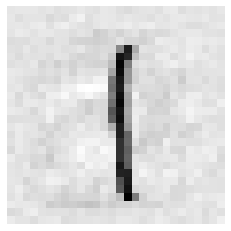

[204] (예측값)4 (실제값)1


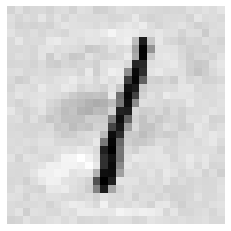

[206] (예측값)6 (실제값)9


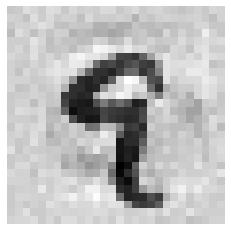

[207] (예측값)4 (실제값)5


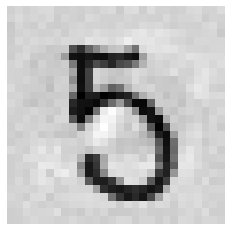

[209] (예측값)0 (실제값)9


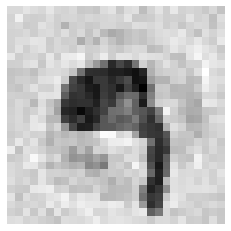

[210] (예측값)1 (실제값)4


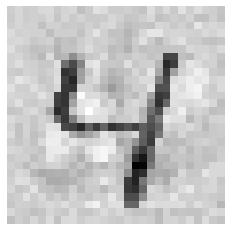

[211] (예측값)2 (실제값)5


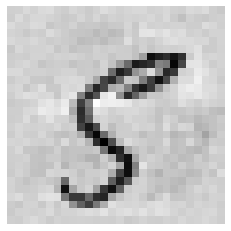

[217] (예측값)8 (실제값)6


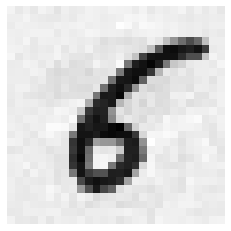

[221] (예측값)3 (실제값)2


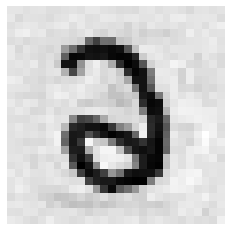

[222] (예측값)4 (실제값)2


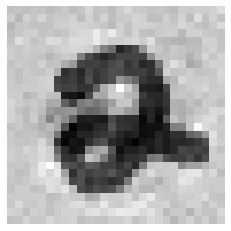

[224] (예측값)6 (실제값)1


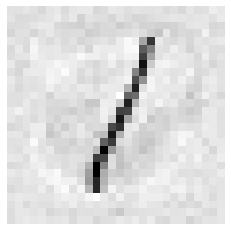

[227] (예측값)0 (실제값)4


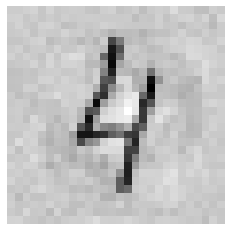

[228] (예측값)2 (실제값)1


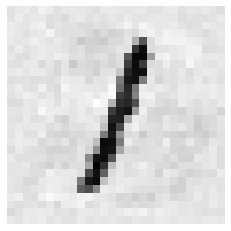

[229] (예측값)3 (실제값)7


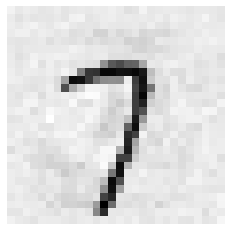

[230] (예측값)4 (실제값)3


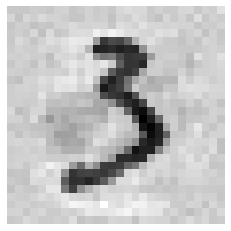

[232] (예측값)6 (실제값)8


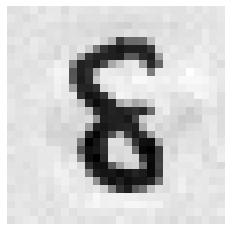

[233] (예측값)7 (실제값)8


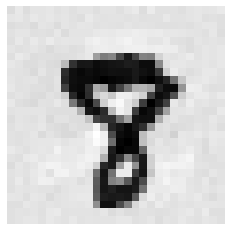

[241] (예측값)8 (실제값)9


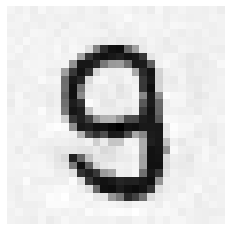

[242] (예측값)9 (실제값)8


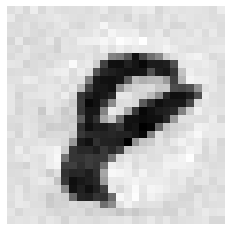

[247] (예측값)6 (실제값)4


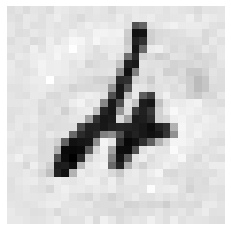

[251] (예측값)9 (실제값)1


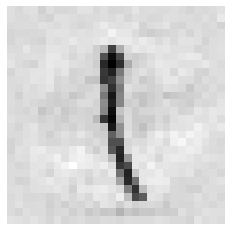

[252] (예측값)5 (실제값)9


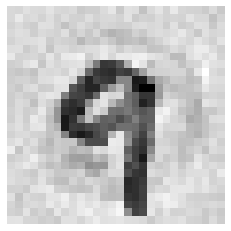

[255] (예측값)3 (실제값)7


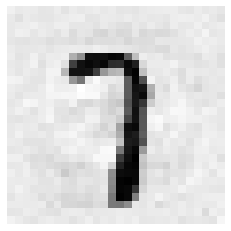

[259] (예측값)5 (실제값)6


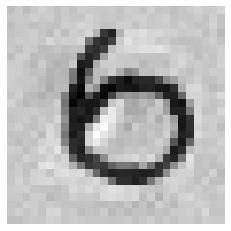

[261] (예측값)0 (실제값)5


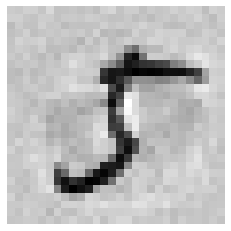

[262] (예측값)1 (실제값)7


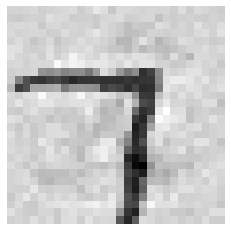

[263] (예측값)2 (실제값)7


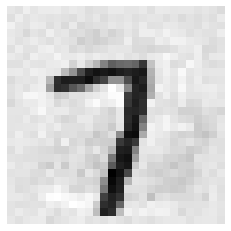

[264] (예측값)3 (실제값)9


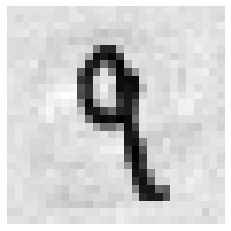

[266] (예측값)5 (실제값)8


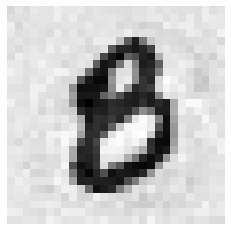

[268] (예측값)9 (실제값)8


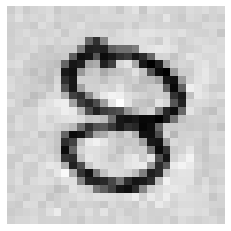

[269] (예측값)8 (실제값)0


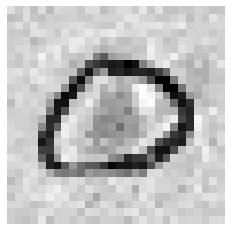

[273] (예측값)3 (실제값)9


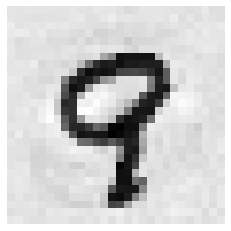

[277] (예측값)7 (실제값)8


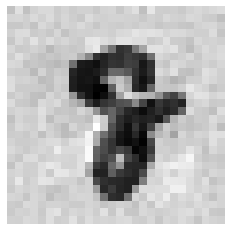

[278] (예측값)8 (실제값)2


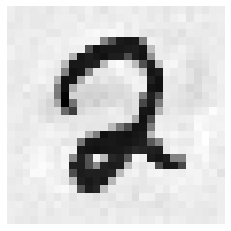

[279] (예측값)9 (실제값)1


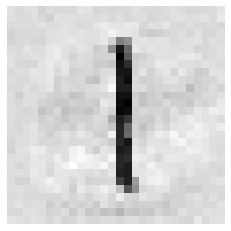

[281] (예측값)4 (실제값)9


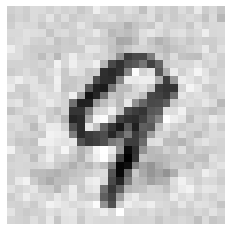

[282] (예측값)2 (실제값)7


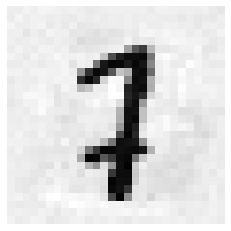

[288] (예측값)9 (실제값)1


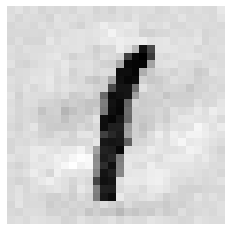

[293] (예측값)8 (실제값)2


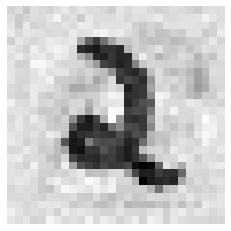

[294] (예측값)6 (실제값)0


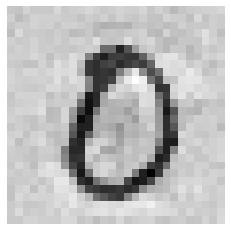

[297] (예측값)9 (실제값)0


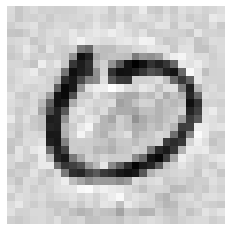

[300] (예측값)6 (실제값)4


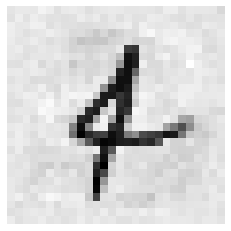

[301] (예측값)3 (실제값)7


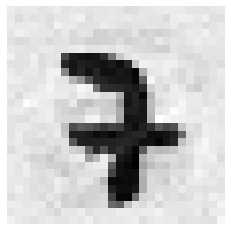

[304] (예측값)6 (실제값)4


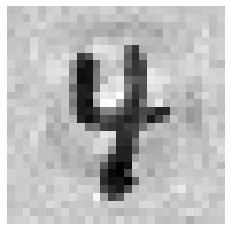

[307] (예측값)9 (실제값)7


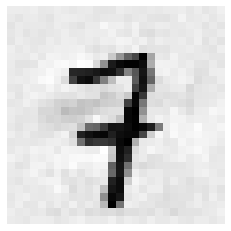

[308] (예측값)8 (실제값)4


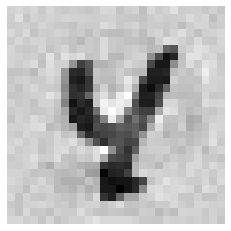

[313] (예측값)5 (실제값)3


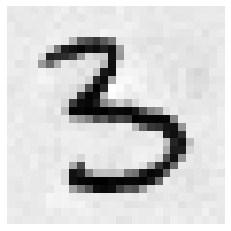

[315] (예측값)7 (실제값)9


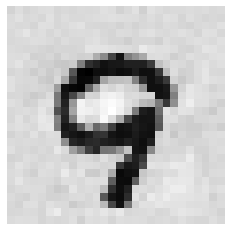

[316] (예측값)8 (실제값)6


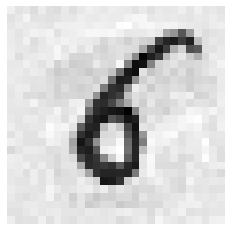

[320] (예측값)8 (실제값)9


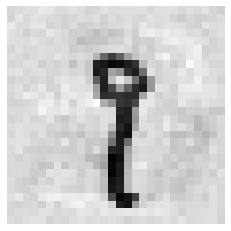

[321] (예측값)3 (실제값)2


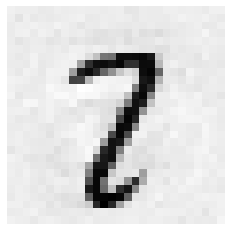

[324] (예측값)6 (실제값)0


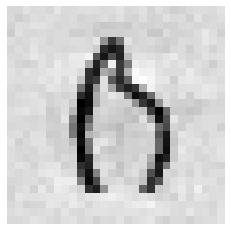

[325] (예측값)7 (실제값)4


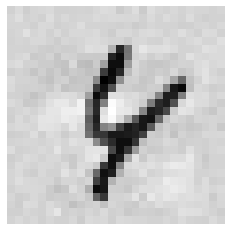

[326] (예측값)8 (실제값)2


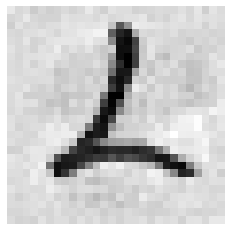

[327] (예측값)9 (실제값)0


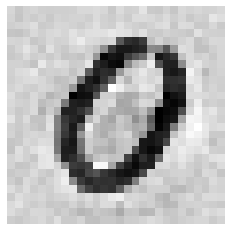

[330] (예측값)3 (실제값)1


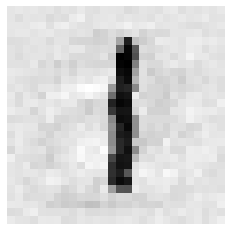

[335] (예측값)8 (실제값)3


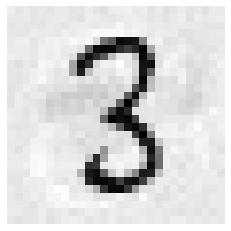

[337] (예측값)1 (실제값)7


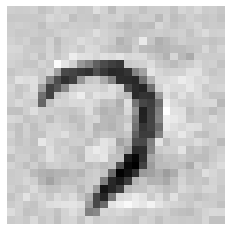

[340] (예측값)4 (실제값)5


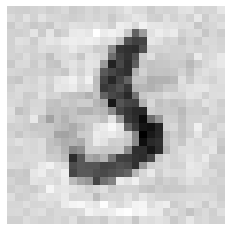

[348] (예측값)3 (실제값)1


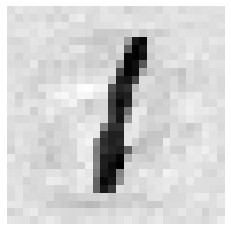

[349] (예측값)7 (실제값)3


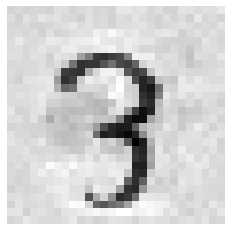

[355] (예측값)0 (실제값)8


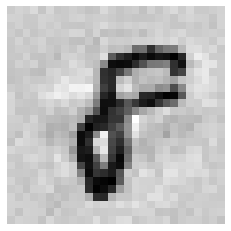

[357] (예측값)2 (실제값)1


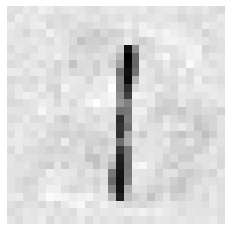

[358] (예측값)3 (실제값)7


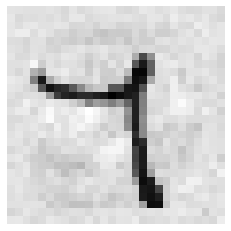

[359] (예측값)4 (실제값)9


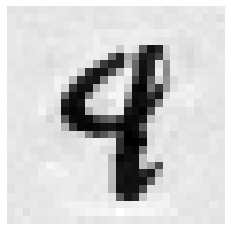

[362] (예측값)8 (실제값)2


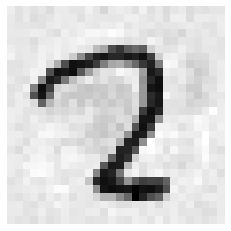

[366] (예측값)2 (실제값)6


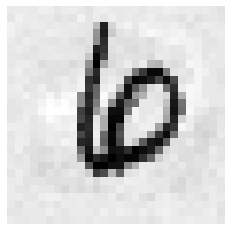

[367] (예측값)3 (실제값)5


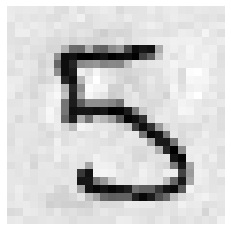

[368] (예측값)4 (실제값)6


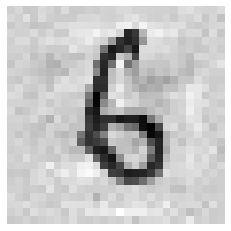

[370] (예측값)2 (실제값)7


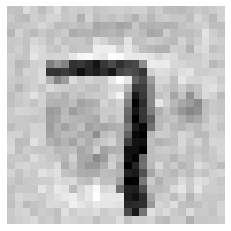

[372] (예측값)8 (실제값)0


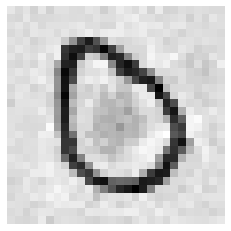

[380] (예측값)6 (실제값)0


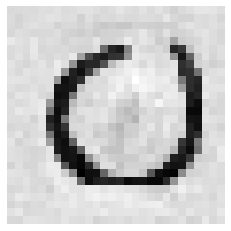

[381] (예측값)7 (실제값)3


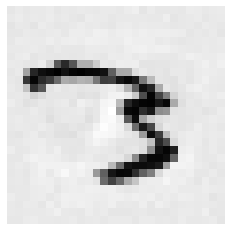

[382] (예측값)8 (실제값)3


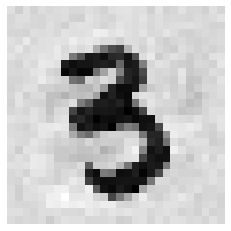

[386] (예측값)3 (실제값)6


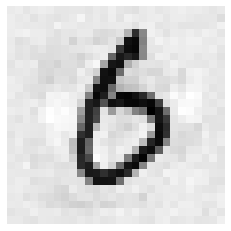

[387] (예측값)4 (실제값)2


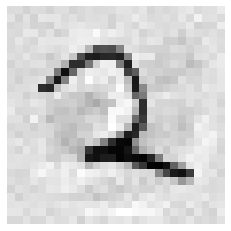

[389] (예측값)6 (실제값)9


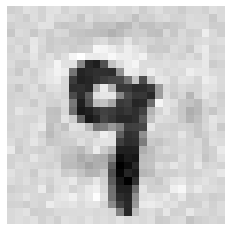

[394] (예측값)3 (실제값)9


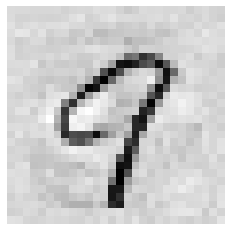

[398] (예측값)7 (실제값)4


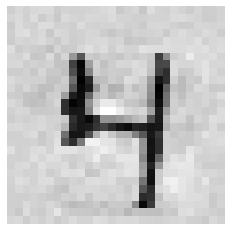

[400] (예측값)0 (실제값)2


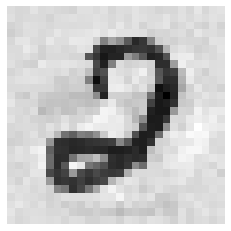

[401] (예측값)0 (실제값)8


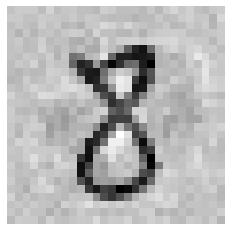

[404] (예측값)3 (실제값)2


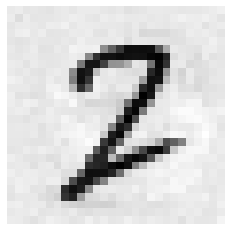

[406] (예측값)6 (실제값)5


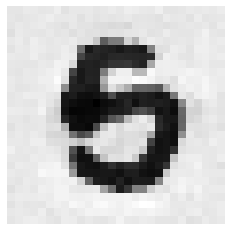

[408] (예측값)8 (실제값)3


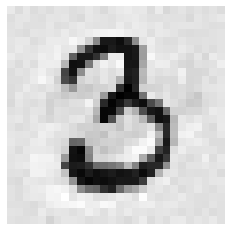

[410] (예측값)5 (실제값)7


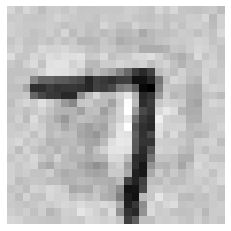

[411] (예측값)1 (실제값)7


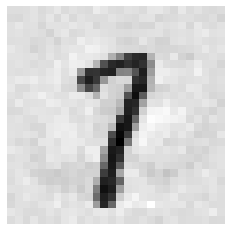

[412] (예측값)3 (실제값)5


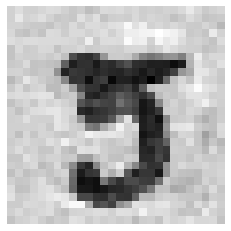

[414] (예측값)4 (실제값)9


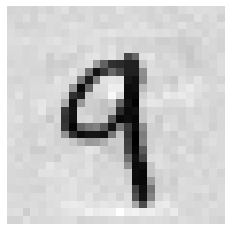

[415] (예측값)5 (실제값)7


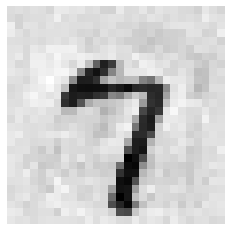

[416] (예측값)6 (실제값)1


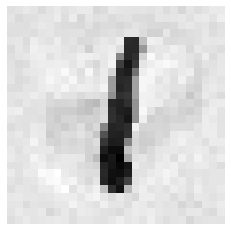

[417] (예측값)7 (실제값)9


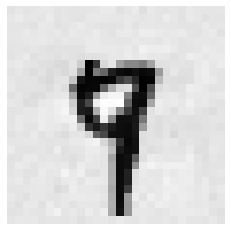

[419] (예측값)9 (실제값)1


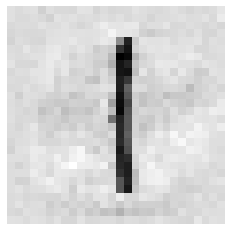

[420] (예측값)0 (실제값)4


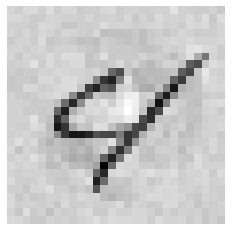

[422] (예측값)7 (실제값)9


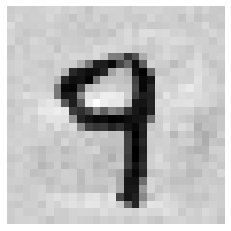

[425] (예측값)5 (실제값)4


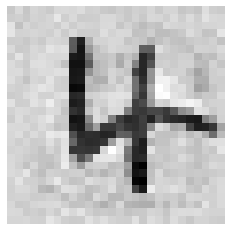

[426] (예측값)6 (실제값)9


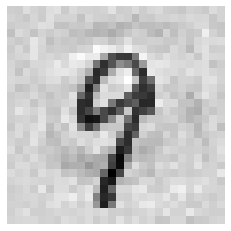

[428] (예측값)8 (실제값)4


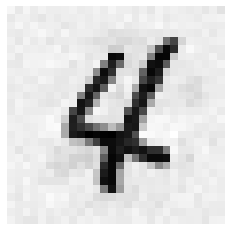

[432] (예측값)2 (실제값)4


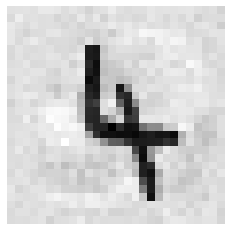

[436] (예측값)6 (실제값)8


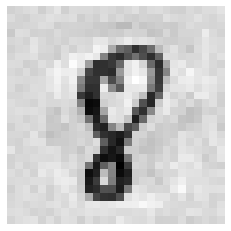

[439] (예측값)9 (실제값)6


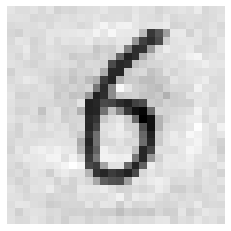

[443] (예측값)3 (실제값)0


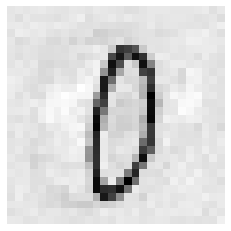

[445] (예측값)5 (실제값)6


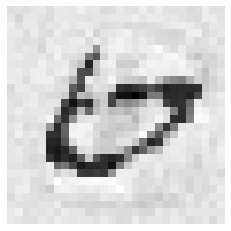

[446] (예측값)0 (실제값)6


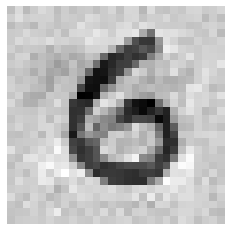

[448] (예측값)0 (실제값)9


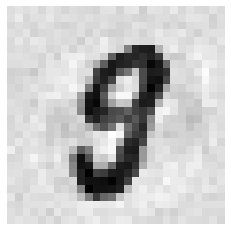

[449] (예측값)5 (실제값)3


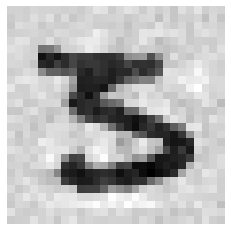

[454] (예측값)7 (실제값)9


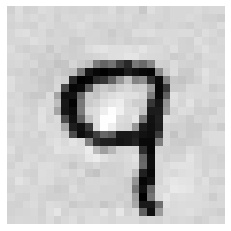

[457] (예측값)0 (실제값)6


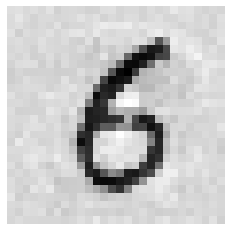

[459] (예측값)2 (실제값)0


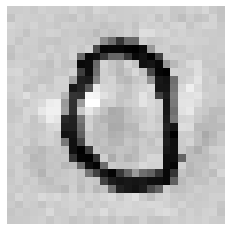

[461] (예측값)4 (실제값)6


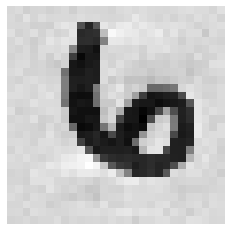

[462] (예측값)5 (실제값)6


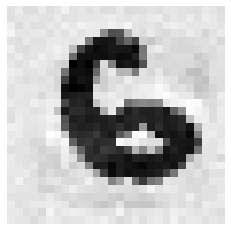

[464] (예측값)8 (실제값)3


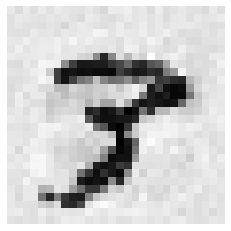

[466] (예측값)0 (실제값)8


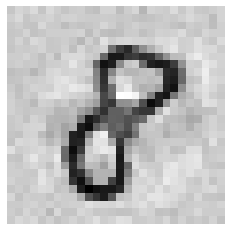

[469] (예측값)3 (실제값)5


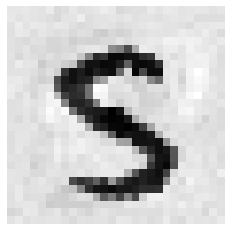

[471] (예측값)5 (실제값)9


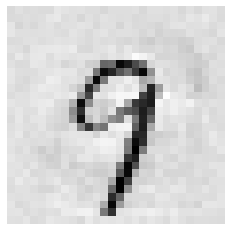

[473] (예측값)8 (실제값)1


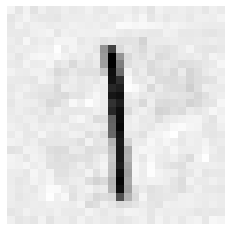

[474] (예측값)9 (실제값)8


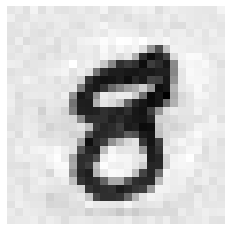

[477] (예측값)3 (실제값)2


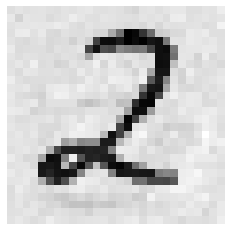

[478] (예측값)4 (실제값)5


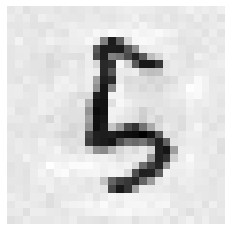

[479] (예측값)5 (실제값)9


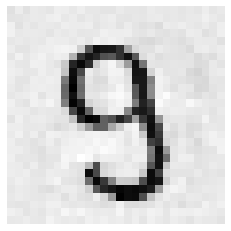

[480] (예측값)6 (실제값)1


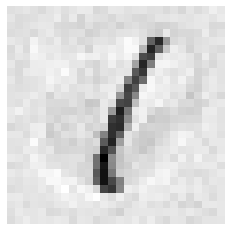

[485] (예측값)2 (실제값)0


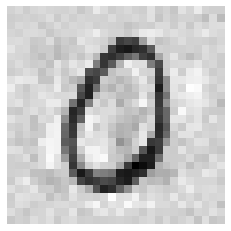

[487] (예측값)3 (실제값)9


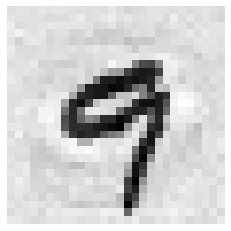

[488] (예측값)4 (실제값)9


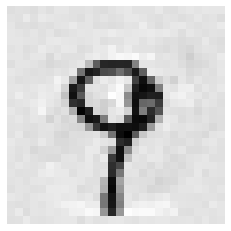

[489] (예측값)5 (실제값)1


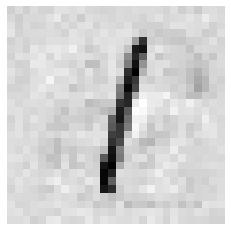

[490] (예측값)6 (실제값)0


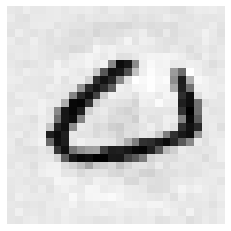

[491] (예측값)7 (실제값)5


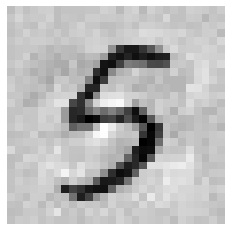

[492] (예측값)8 (실제값)2


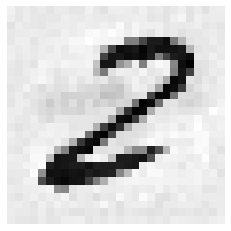

[495] (예측값)2 (실제값)8


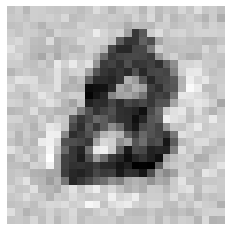

[496] (예측값)2 (실제값)9


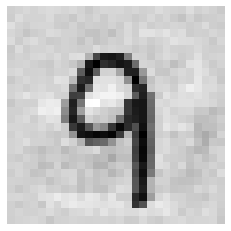

[497] (예측값)3 (실제값)4


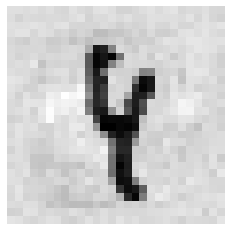

[499] (예측값)5 (실제값)6


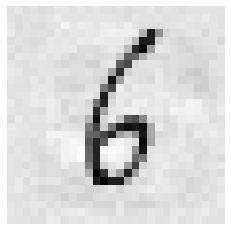

[504] (예측값)7 (실제값)1


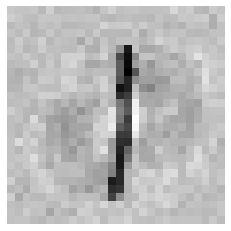

[506] (예측값)2 (실제값)1


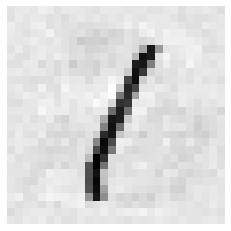

[507] (예측값)4 (실제값)3


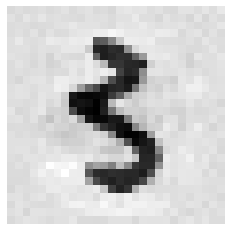

[508] (예측값)5 (실제값)6


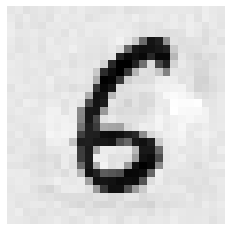

[510] (예측값)8 (실제값)7


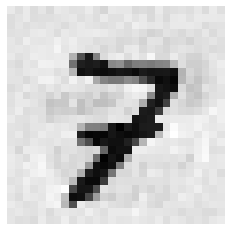

[511] (예측값)9 (실제값)4


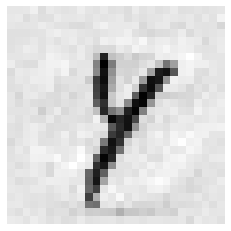

[515] (예측값)4 (실제값)3


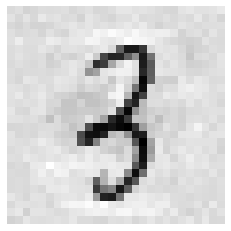

[519] (예측값)9 (실제값)4


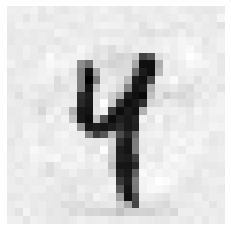

[521] (예측값)1 (실제값)9


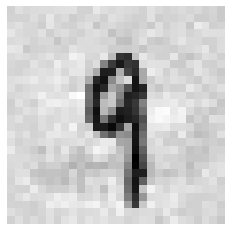

[522] (예측값)2 (실제값)7


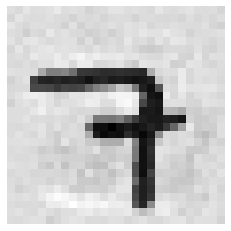

[524] (예측값)4 (실제값)3


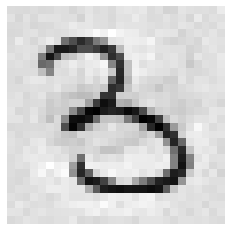

[526] (예측값)0 (실제값)3


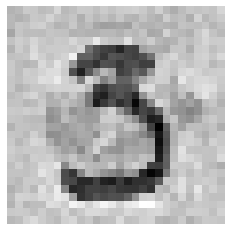

[528] (예측값)8 (실제값)3


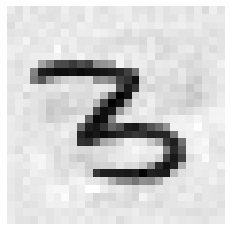

[529] (예측값)9 (실제값)1


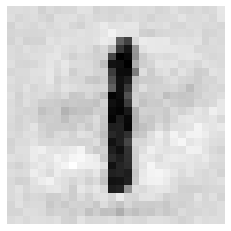

[530] (예측값)0 (실제값)9


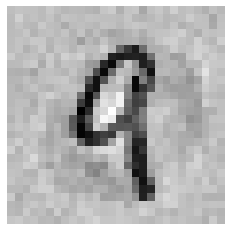

[532] (예측값)2 (실제값)4


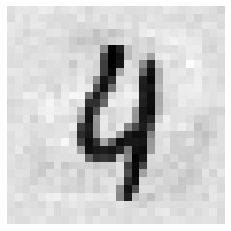

[534] (예측값)4 (실제값)6


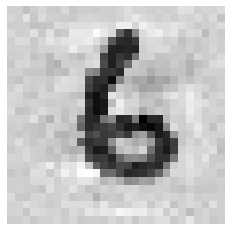

[536] (예측값)1 (실제값)2


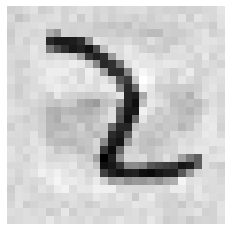

[538] (예측값)9 (실제값)8


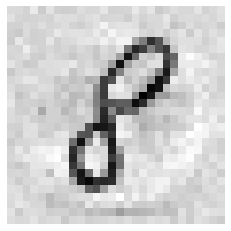

[541] (예측값)2 (실제값)4


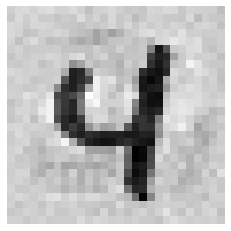

[542] (예측값)3 (실제값)8


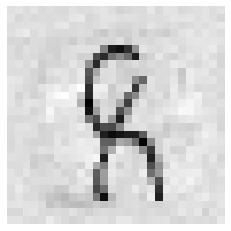

[543] (예측값)4 (실제값)8


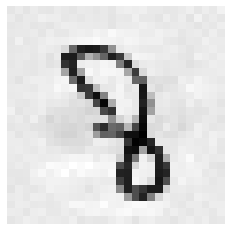

[547] (예측값)8 (실제값)2


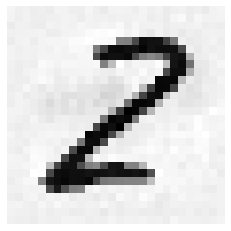

[549] (예측값)0 (실제값)2


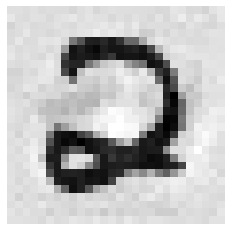

[551] (예측값)2 (실제값)7


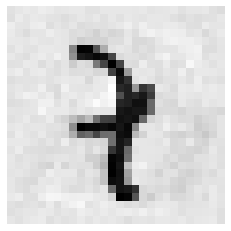

[553] (예측값)6 (실제값)8


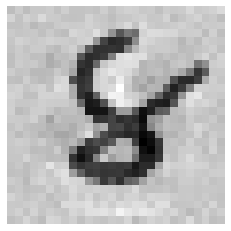

[555] (예측값)6 (실제값)4


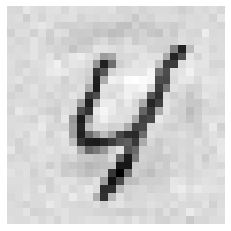

[557] (예측값)8 (실제값)7


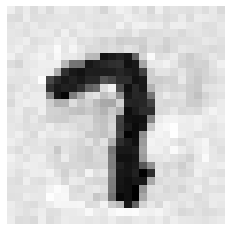

[558] (예측값)0 (실제값)9


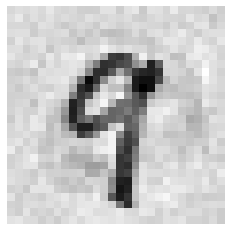

[560] (예측값)2 (실제값)9


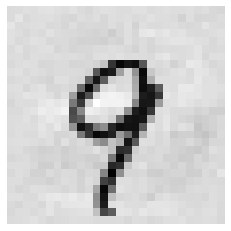

[562] (예측값)4 (실제값)9


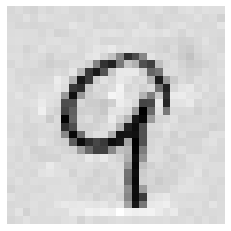

[563] (예측값)5 (실제값)8


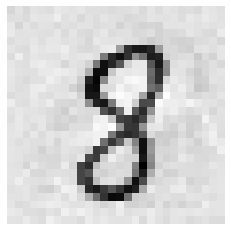

[564] (예측값)6 (실제값)0


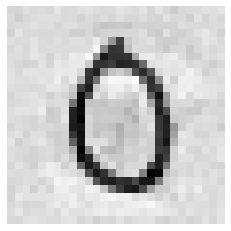

[565] (예측값)7 (실제값)4


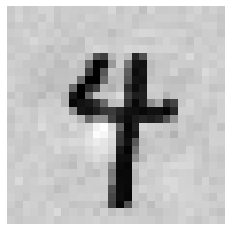

[566] (예측값)5 (실제값)6


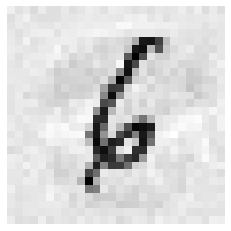

[572] (예측값)4 (실제값)8


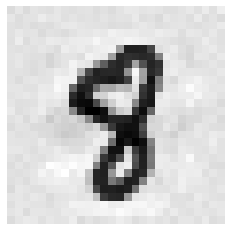

[577] (예측값)9 (실제값)3


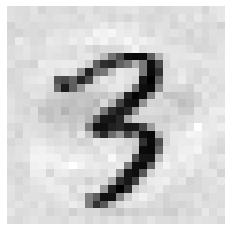

[581] (예측값)3 (실제값)0


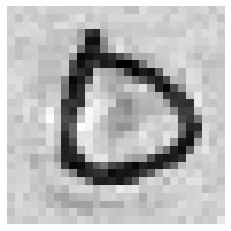

[582] (예측값)4 (실제값)8


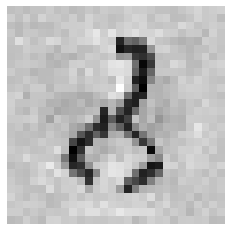

[583] (예측값)5 (실제값)2


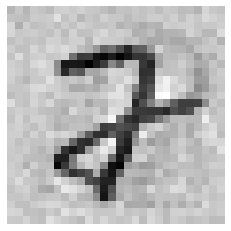

[586] (예측값)9 (실제값)0


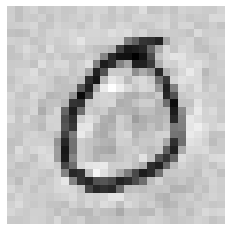

[590] (예측값)8 (실제값)3


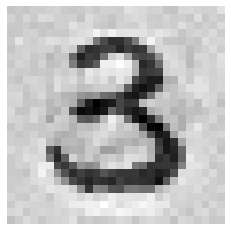

[593] (예측값)7 (실제값)9


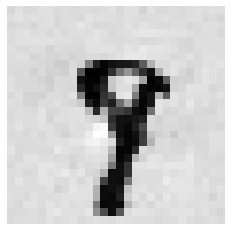

[600] (예측값)4 (실제값)6


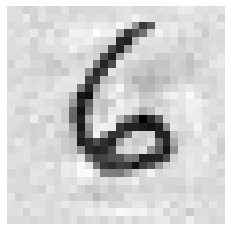

[603] (예측값)9 (실제값)8


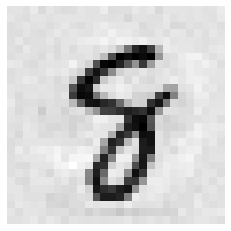

[610] (예측값)6 (실제값)4


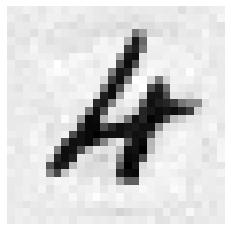

[614] (예측값)0 (실제값)3


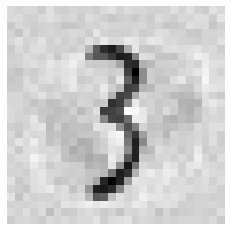

[615] (예측값)2 (실제값)1


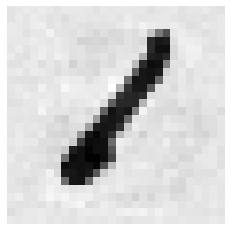

[616] (예측값)3 (실제값)9


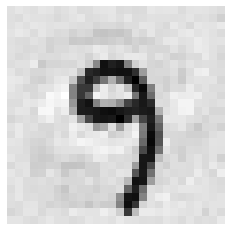

[619] (예측값)8 (실제값)1


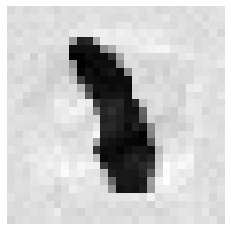

[624] (예측값)3 (실제값)2


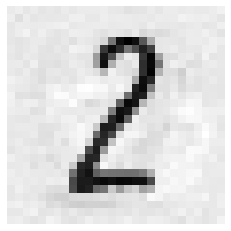

[627] (예측값)6 (실제값)9


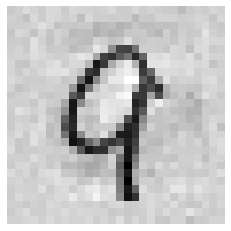

[628] (예측값)7 (실제값)3


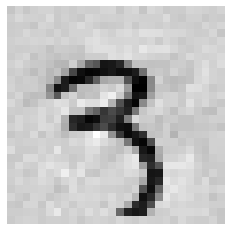

[629] (예측값)6 (실제값)2


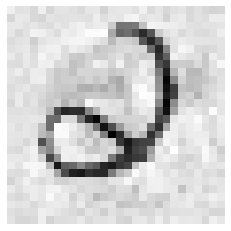

[630] (예측값)5 (실제값)9


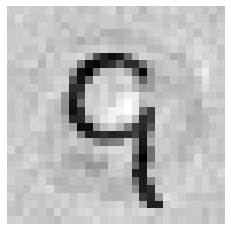

[637] (예측값)9 (실제값)3


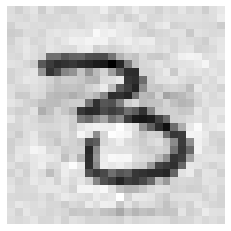

[641] (예측값)3 (실제값)8


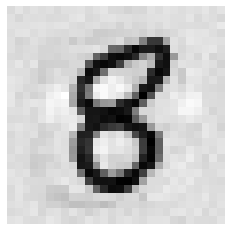

[645] (예측값)6 (실제값)5


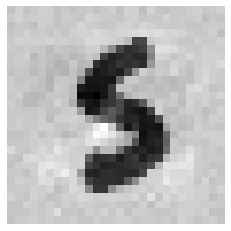

[646] (예측값)6 (실제값)2


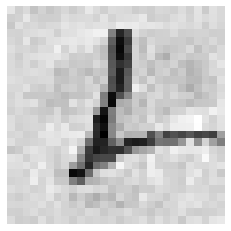

[647] (예측값)9 (실제값)1


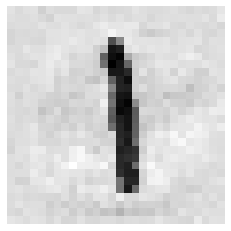

[648] (예측값)5 (실제값)3


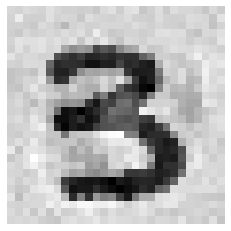

[649] (예측값)1 (실제값)7


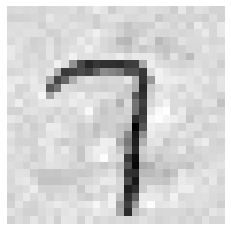

[654] (예측값)6 (실제값)5


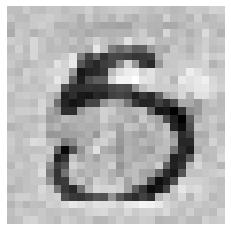

[657] (예측값)8 (실제값)3


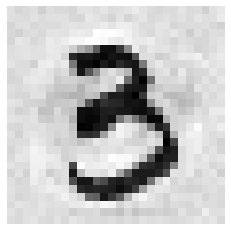

[658] (예측값)0 (실제값)7


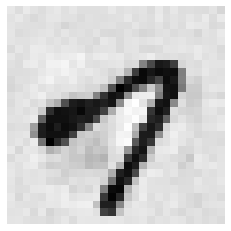

[659] (예측값)1 (실제값)2


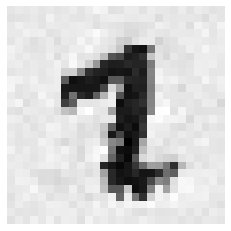

[660] (예측값)2 (실제값)4


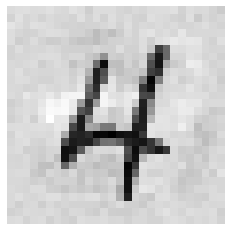

[666] (예측값)8 (실제값)7


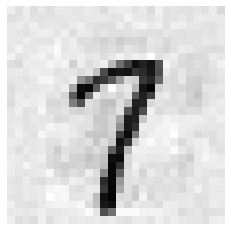

[667] (예측값)9 (실제값)7


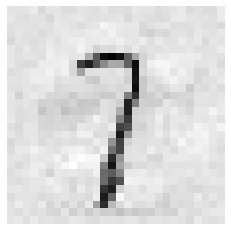

[668] (예측값)2 (실제값)4


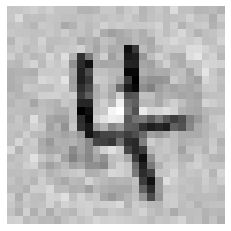

[672] (예측값)4 (실제값)1


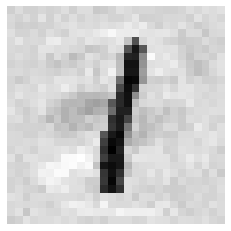

[674] (예측값)6 (실제값)5


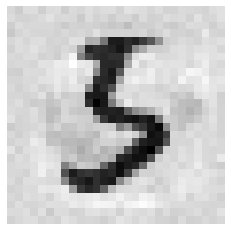

[677] (예측값)9 (실제값)3


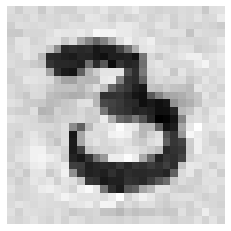

[682] (예측값)4 (실제값)1


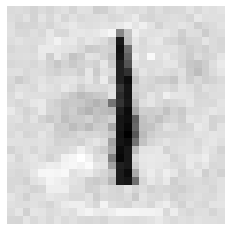

[683] (예측값)5 (실제값)3


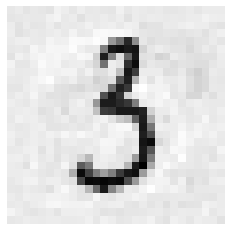

[684] (예측값)2 (실제값)7


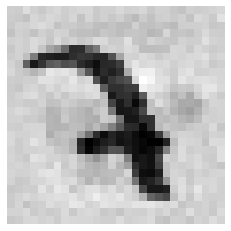

[685] (예측값)7 (실제값)8


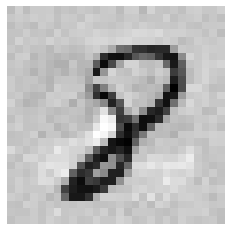

[688] (예측값)0 (실제값)6


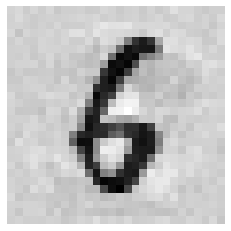

[689] (예측값)1 (실제값)7


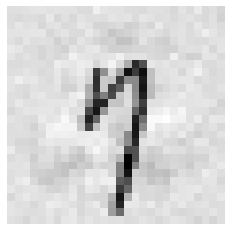

[691] (예측값)4 (실제값)8


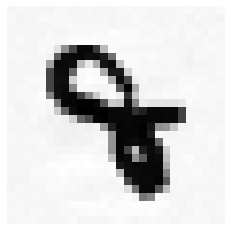

[694] (예측값)8 (실제값)5


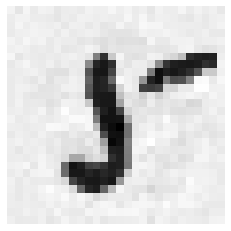

[695] (예측값)9 (실제값)1


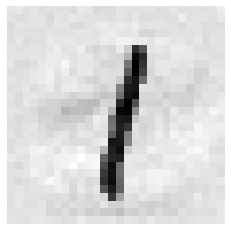

[696] (예측값)7 (실제값)1


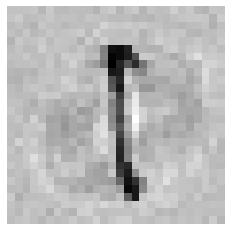

[698] (예측값)2 (실제값)4


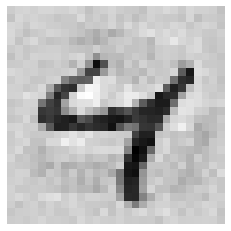

[699] (예측값)4 (실제값)3


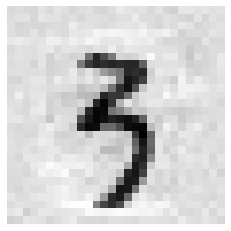

[702] (예측값)2 (실제값)7


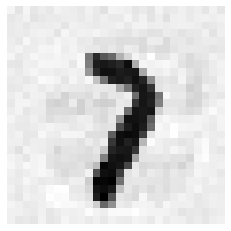

[707] (예측값)3 (실제값)4


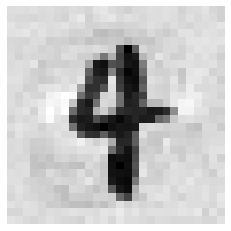

[712] (예측값)9 (실제값)4


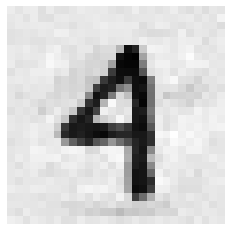

[715] (예측값)3 (실제값)2


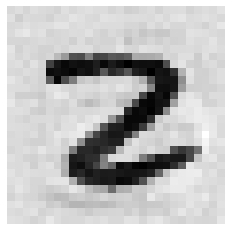

[717] (예측값)7 (실제값)0


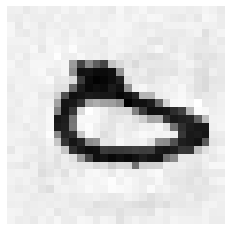

[720] (예측값)8 (실제값)5


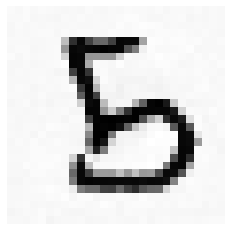

[722] (예측값)9 (실제값)4


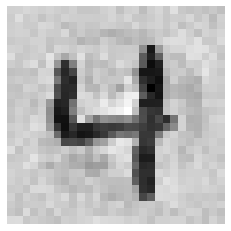

[723] (예측값)6 (실제값)0


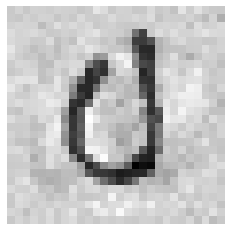

[725] (예측값)3 (실제값)1


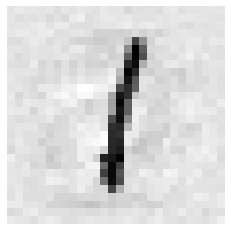

[727] (예측값)5 (실제값)3


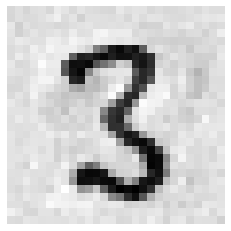

[728] (예측값)8 (실제값)2


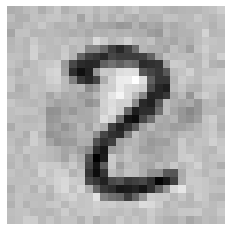

[729] (예측값)0 (실제값)6


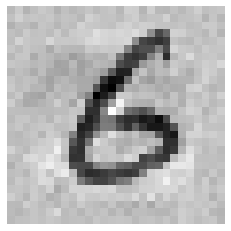

[730] (예측값)5 (실제값)7


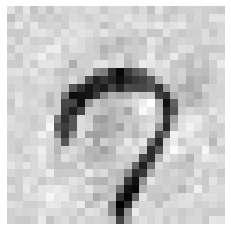

[733] (예측값)3 (실제값)9


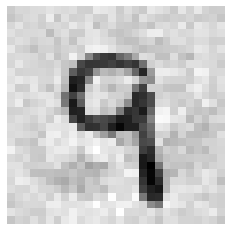

[735] (예측값)3 (실제값)1


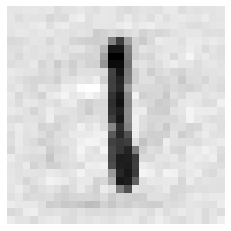

[738] (예측값)8 (실제값)2


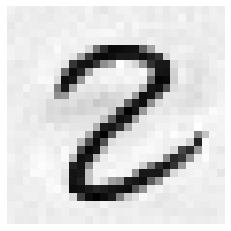

[740] (예측값)5 (실제값)4


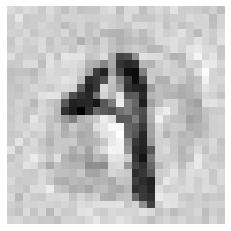

[745] (예측값)5 (실제값)1


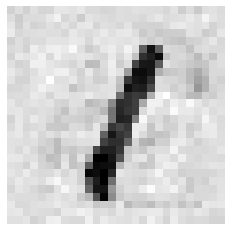

[746] (예측값)6 (실제값)7


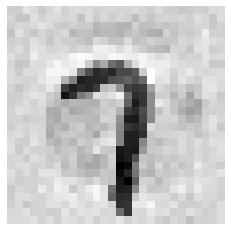

[747] (예측값)7 (실제값)3


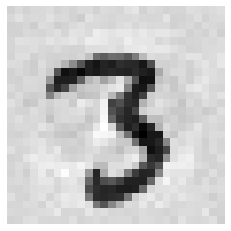

[748] (예측값)8 (실제값)4


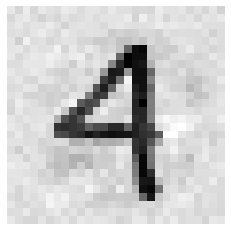

[749] (예측값)9 (실제값)1


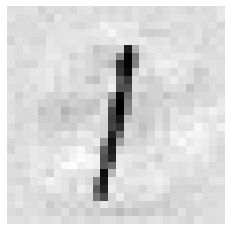

[757] (예측값)9 (실제값)4


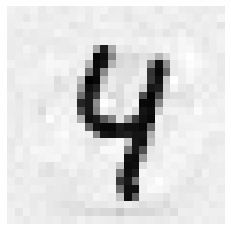

[759] (예측값)3 (실제값)9


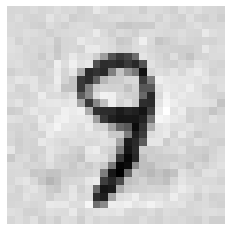

[767] (예측값)0 (실제값)1


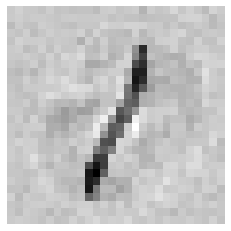

[771] (예측값)6 (실제값)7


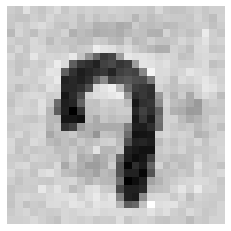

[772] (예측값)7 (실제값)1


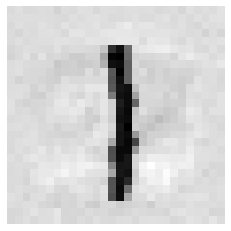

[773] (예측값)8 (실제값)9


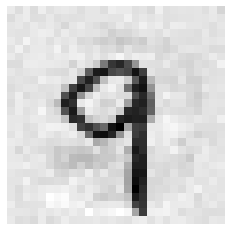

[774] (예측값)9 (실제값)4


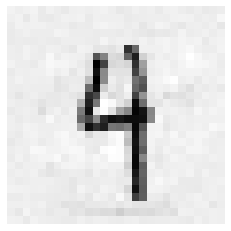

[776] (예측값)2 (실제값)4


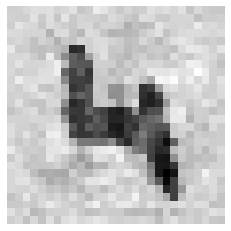

[784] (예측값)9 (실제값)4


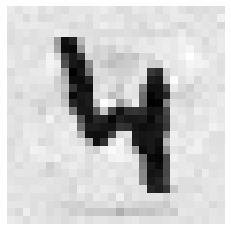

[786] (예측값)3 (실제값)6


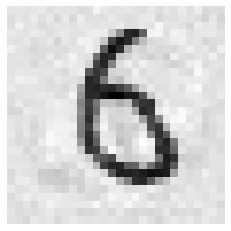

[788] (예측값)3 (실제값)9


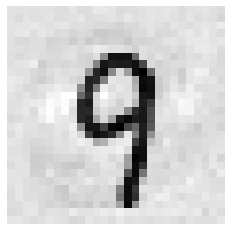

[791] (예측값)7 (실제값)5


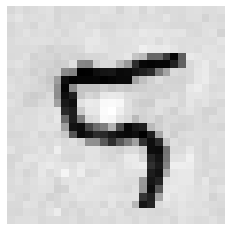

[795] (예측값)1 (실제값)3


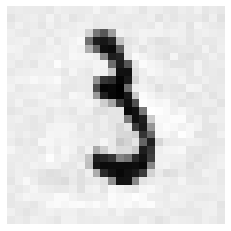

[801] (예측값)8 (실제값)3


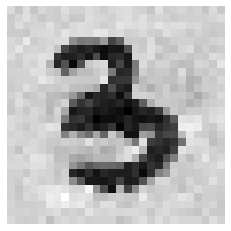

[802] (예측값)9 (실제값)4


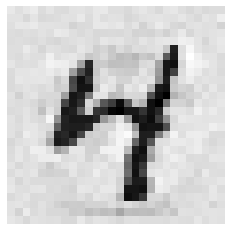

[807] (예측값)8 (실제값)3


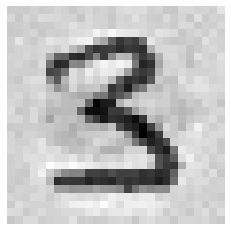

[810] (예측값)8 (실제값)7


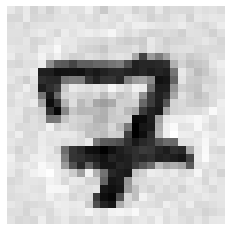

[813] (예측값)8 (실제값)9


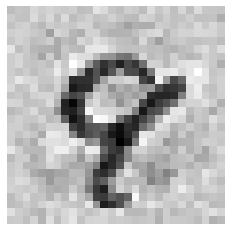

[829] (예측값)9 (실제값)4


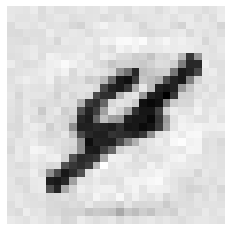

[832] (예측값)3 (실제값)7


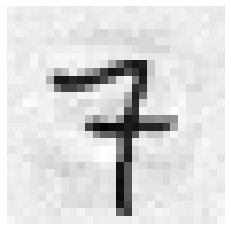

[833] (예측값)4 (실제값)9


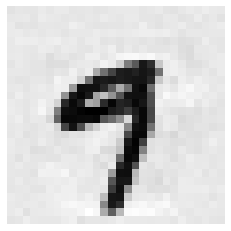

[834] (예측값)8 (실제값)6


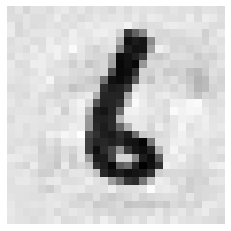

[835] (예측값)6 (실제값)1


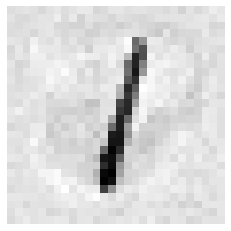

[836] (예측값)7 (실제값)1


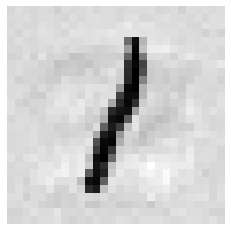

[838] (예측값)9 (실제값)4


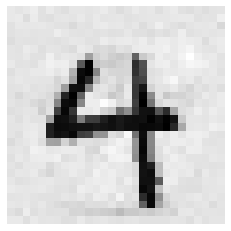

[839] (예측값)3 (실제값)8


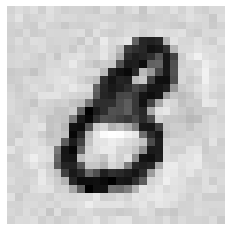

[840] (예측값)2 (실제값)1


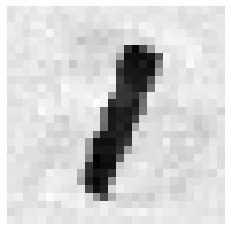

[844] (예측값)6 (실제값)8


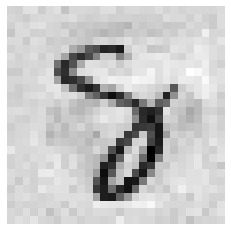

[846] (예측값)8 (실제값)7


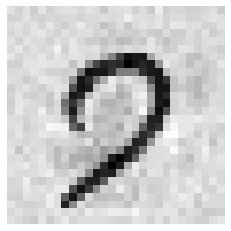

[851] (예측값)3 (실제값)0


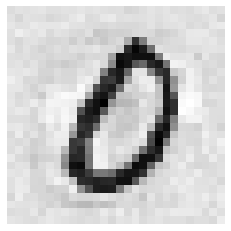

[852] (예측값)4 (실제값)7


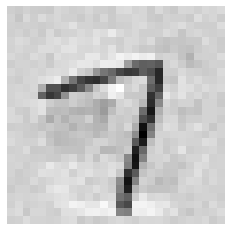

[854] (예측값)6 (실제값)0


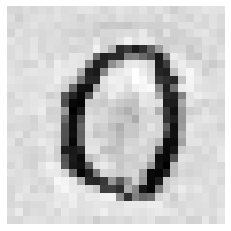

[855] (예측값)7 (실제값)3


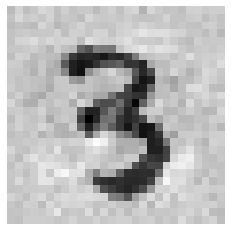

[857] (예측값)9 (실제값)5


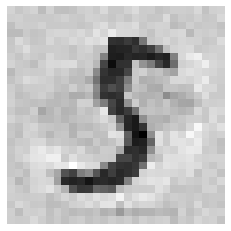

[858] (예측값)0 (실제값)2


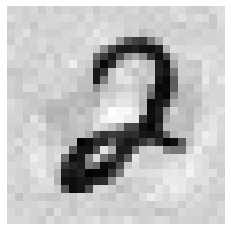

[859] (예측값)1 (실제값)7


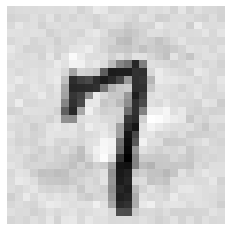

[862] (예측값)4 (실제값)9


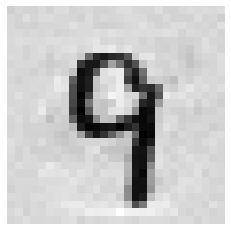

[866] (예측값)8 (실제값)5


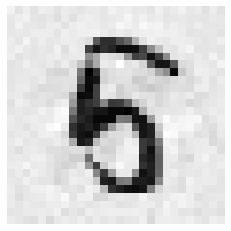

[868] (예측값)0 (실제값)2


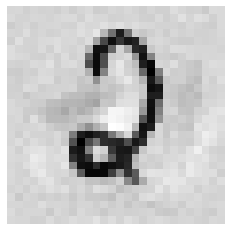

[874] (예측값)6 (실제값)9


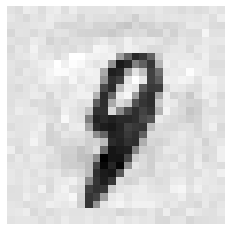

[877] (예측값)0 (실제값)8


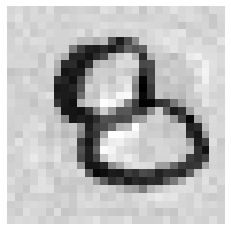

[882] (예측값)6 (실제값)9


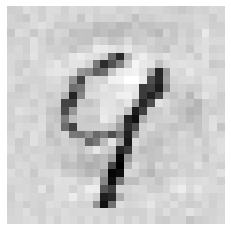

[883] (예측값)7 (실제값)3


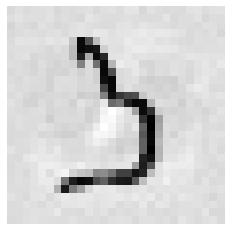

[884] (예측값)8 (실제값)0


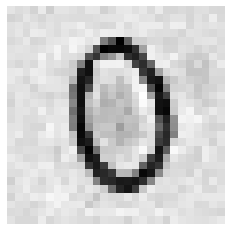

[886] (예측값)0 (실제값)6


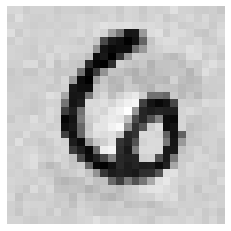

[890] (예측값)5 (실제값)3


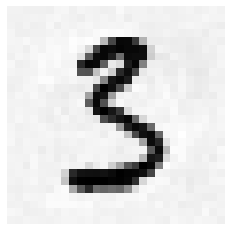

[893] (예측값)8 (실제값)9


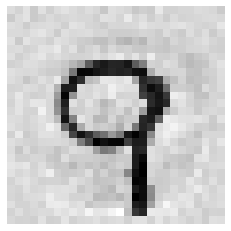

[894] (예측값)9 (실제값)3


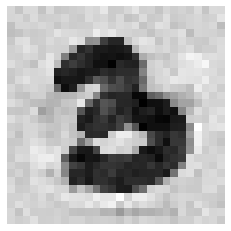

[896] (예측값)2 (실제값)0


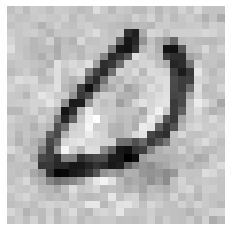

[900] (예측값)5 (실제값)1


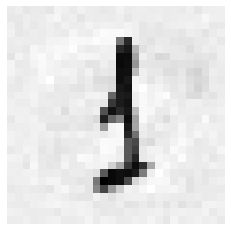

[902] (예측값)7 (실제값)4


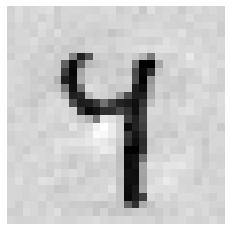

[906] (예측값)2 (실제값)9


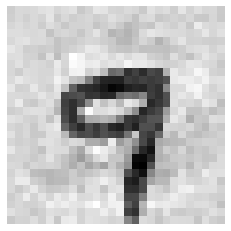

[907] (예측값)2 (실제값)1


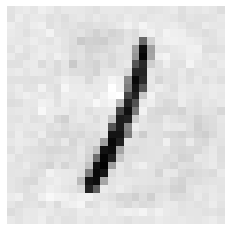

[909] (예측값)4 (실제값)7


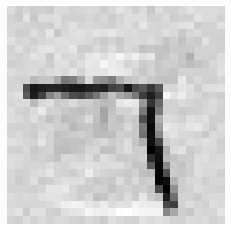

[910] (예측값)5 (실제값)4


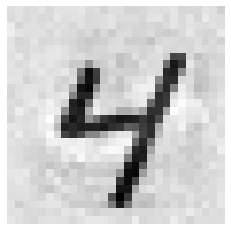

[911] (예측값)6 (실제값)7


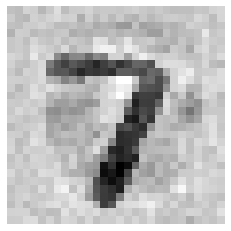

[913] (예측값)8 (실제값)9


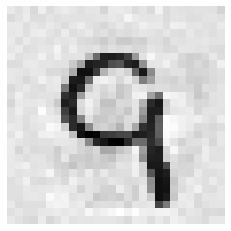

[914] (예측값)9 (실제값)8


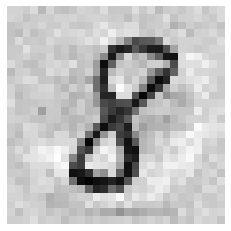

[916] (예측값)2 (실제값)4


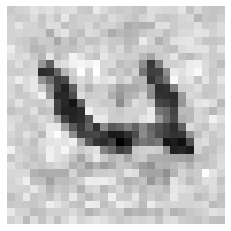

[917] (예측값)2 (실제값)7


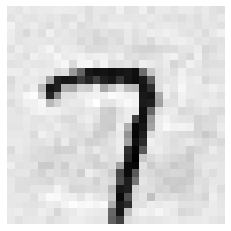

[918] (예측값)3 (실제값)1


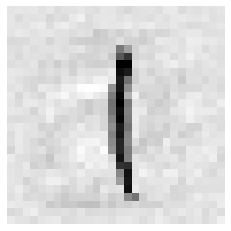

[921] (예측값)6 (실제값)2


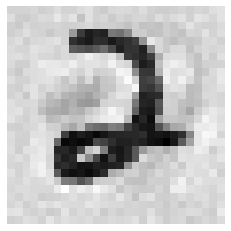

[922] (예측값)7 (실제값)2


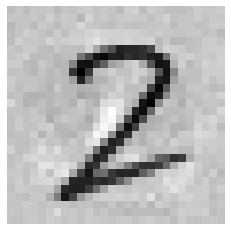

[924] (예측값)7 (실제값)2


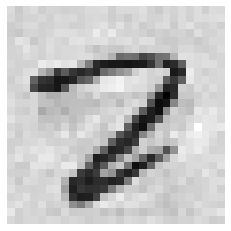

[925] (예측값)0 (실제값)3


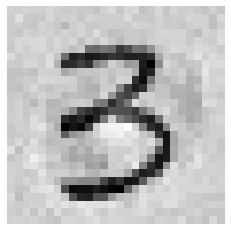

[928] (예측값)3 (실제값)9


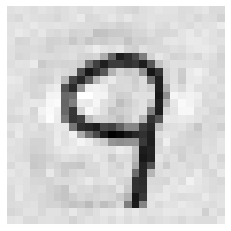

[929] (예측값)4 (실제값)1


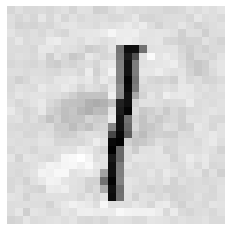

[933] (예측값)8 (실제값)3


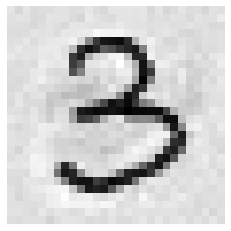

[936] (예측값)1 (실제값)8


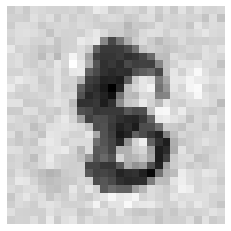

[938] (예측값)8 (실제값)3


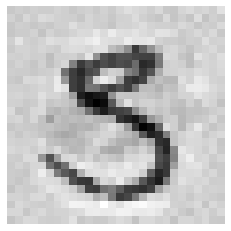

[939] (예측값)5 (실제값)2


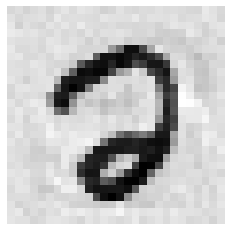

[943] (예측값)0 (실제값)6


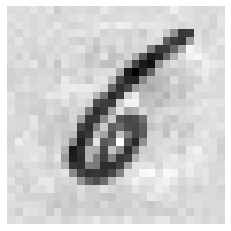

[947] (예측값)9 (실제값)8


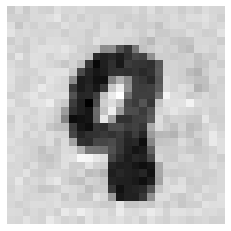

[950] (예측값)8 (실제값)7


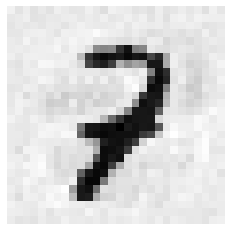

[951] (예측값)9 (실제값)5


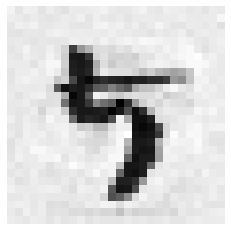

[955] (예측값)3 (실제값)5


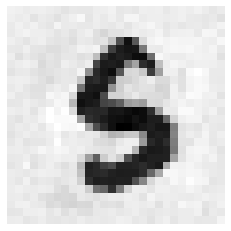

[956] (예측값)2 (실제값)1


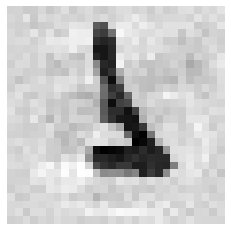

[957] (예측값)5 (실제값)3


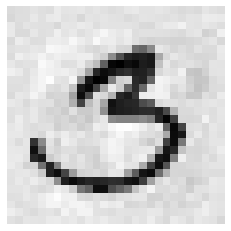

[958] (예측값)6 (실제값)3


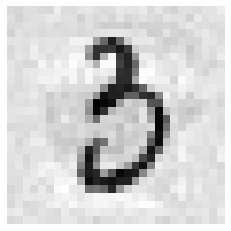

[959] (예측값)9 (실제값)4


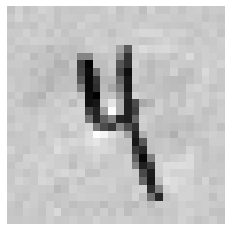

[961] (예측값)9 (실제값)8


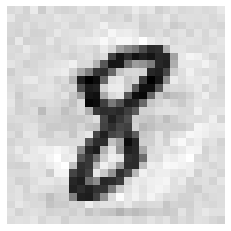

[962] (예측값)7 (실제값)9


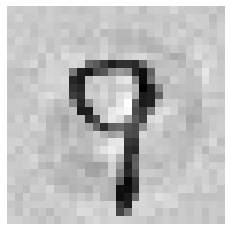

[963] (예측값)2 (실제값)1


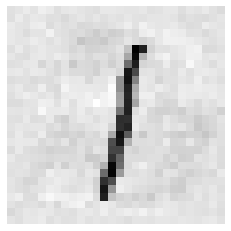

[964] (예측값)3 (실제값)1


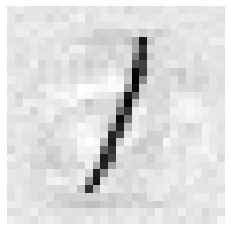

[965] (예측값)0 (실제값)6


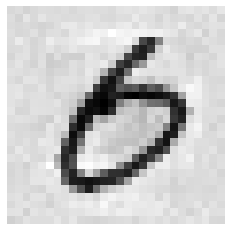

[966] (예측값)5 (실제값)9


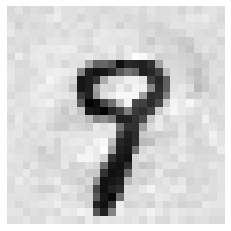

[969] (예측값)8 (실제값)4


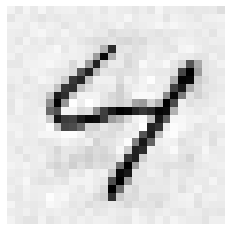

[971] (예측값)8 (실제값)4


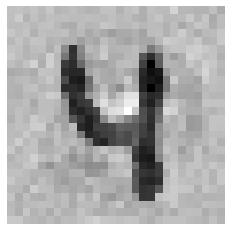

[975] (예측값)6 (실제값)2


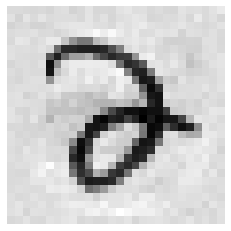

[976] (예측값)5 (실제값)3


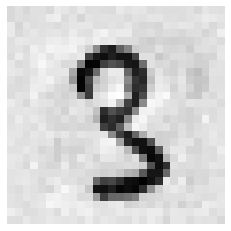

[977] (예측값)6 (실제값)1


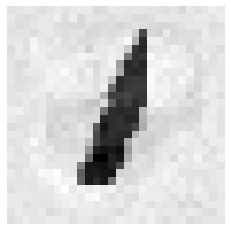

[987] (예측값)6 (실제값)7


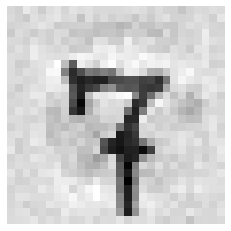

[988] (예측값)7 (실제값)1


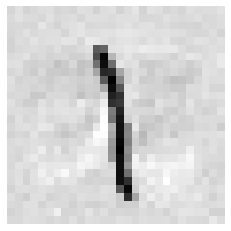

[990] (예측값)9 (실제값)2


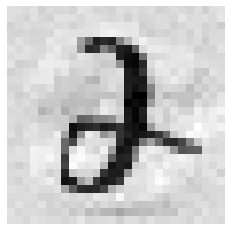

[991] (예측값)5 (실제값)3


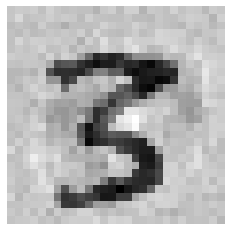

[992] (예측값)4 (실제값)9


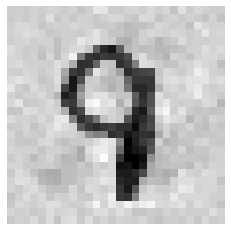

[994] (예측값)3 (실제값)1


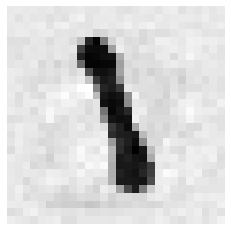

[995] (예측값)0 (실제값)2


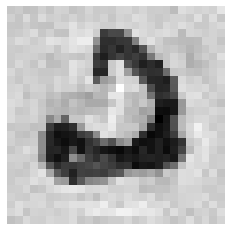

[1000] (예측값)0 (실제값)9


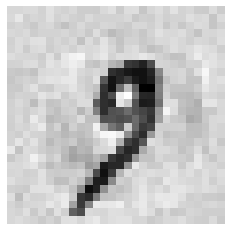

[1002] (예측값)3 (실제값)2


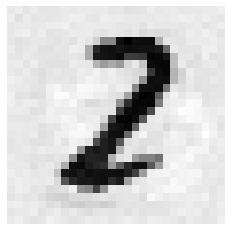

[1003] (예측값)8 (실제값)5


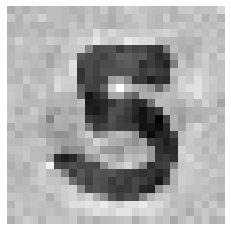

[1004] (예측값)5 (실제값)1


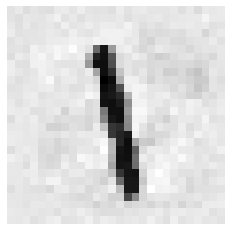

[1005] (예측값)6 (실제값)9


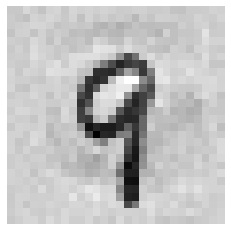

[1008] (예측값)7 (실제값)1


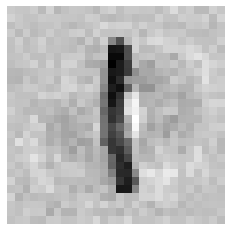

[1009] (예측값)2 (실제값)0


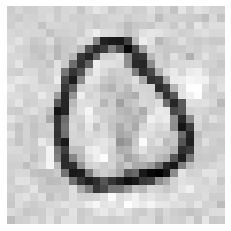

[1012] (예측값)4 (실제값)7


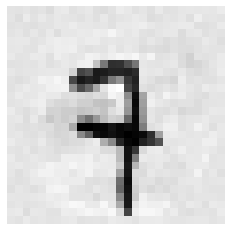

[1013] (예측값)5 (실제값)9


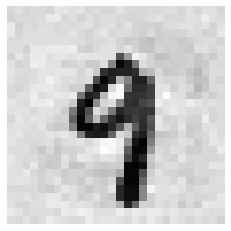

[1014] (예측값)7 (실제값)6


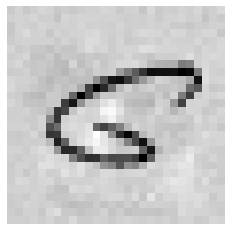

[1015] (예측값)8 (실제값)4


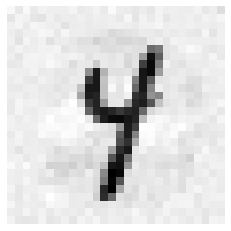

[1016] (예측값)0 (실제값)2


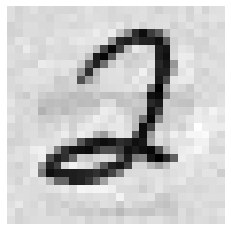

[1019] (예측값)2 (실제값)1


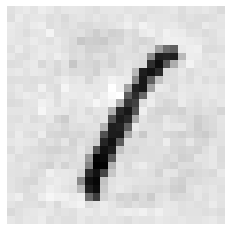

[1021] (예측값)8 (실제값)7


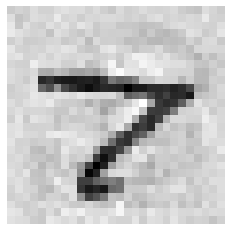

[1024] (예측값)8 (실제값)4


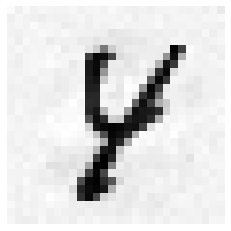

[1025] (예측값)9 (실제값)1


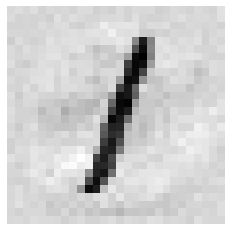

[1032] (예측값)8 (실제값)5


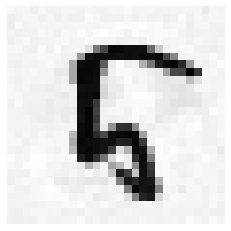

[1033] (예측값)9 (실제값)8


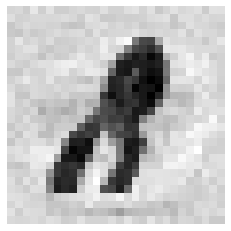

[1036] (예측값)3 (실제값)2


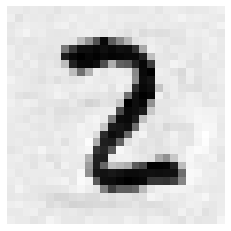

[1038] (예측값)5 (실제값)1


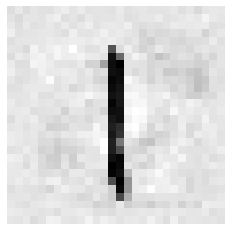

[1039] (예측값)6 (실제값)7


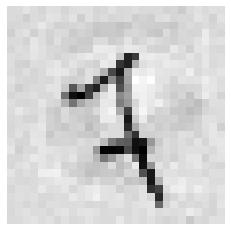

[1040] (예측값)7 (실제값)1


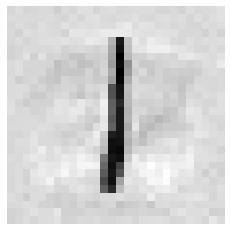

[1043] (예측값)5 (실제값)4


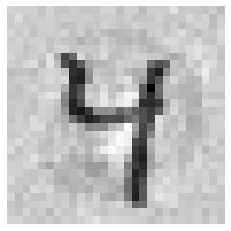

[1044] (예측값)8 (실제값)6


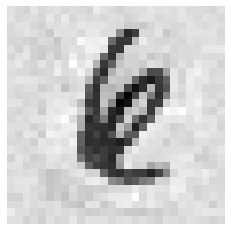

[1045] (예측값)8 (실제값)9


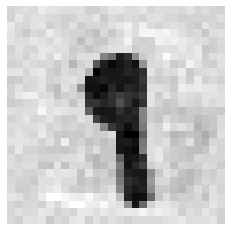

[1046] (예측값)3 (실제값)5


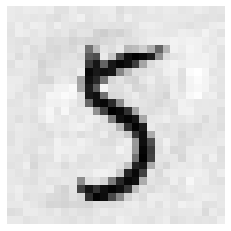

[1051] (예측값)8 (실제값)4


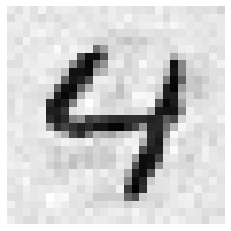

[1052] (예측값)9 (실제값)8


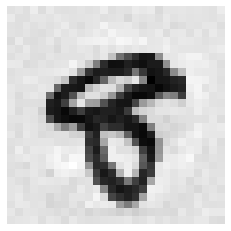

[1055] (예측값)3 (실제값)7


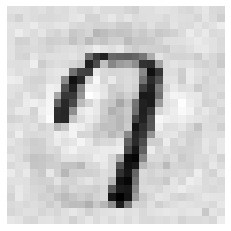

[1058] (예측값)6 (실제값)9


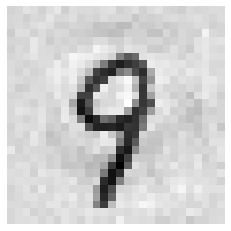

[1062] (예측값)9 (실제값)3


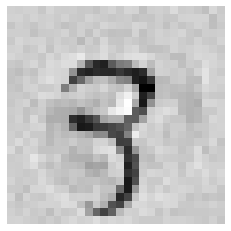

[1063] (예측값)4 (실제값)9


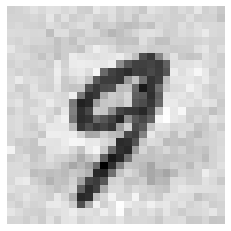

[1067] (예측값)8 (실제값)3


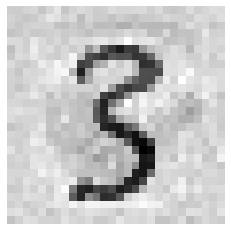

[1071] (예측값)0 (실제값)7


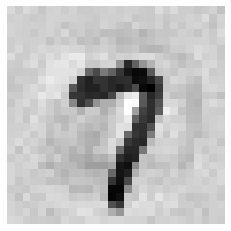

[1077] (예측값)6 (실제값)4


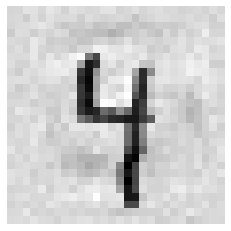

[1078] (예측값)7 (실제값)4


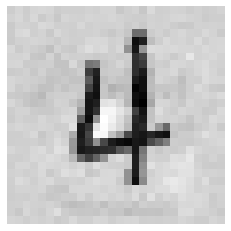

[1080] (예측값)9 (실제값)4


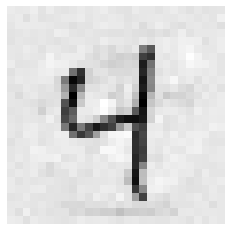

[1081] (예측값)5 (실제값)9


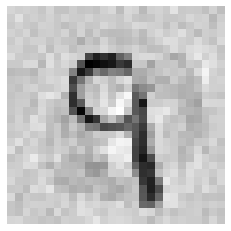

[1082] (예측값)1 (실제값)5


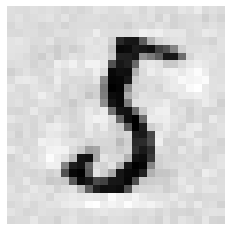

[1085] (예측값)4 (실제값)6


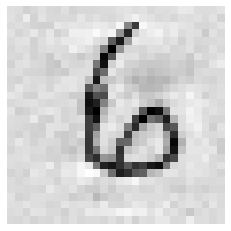

[1086] (예측값)5 (실제값)9


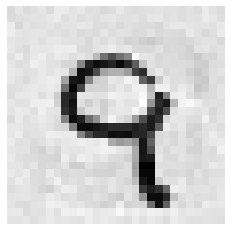

[1088] (예측값)7 (실제값)9


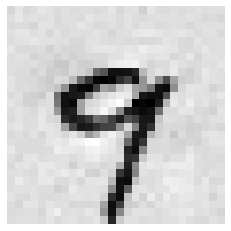

[1092] (예측값)2 (실제값)3


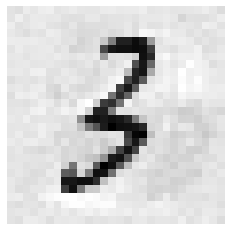

[1093] (예측값)3 (실제값)8


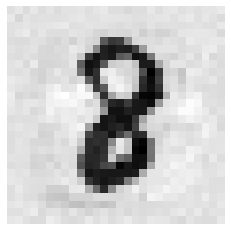

[1096] (예측값)6 (실제값)7


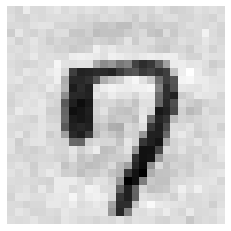

[1097] (예측값)7 (실제값)1


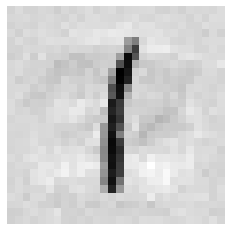

[1099] (예측값)9 (실제값)6


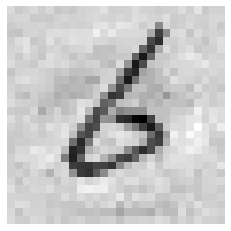

[1101] (예측값)3 (실제값)8


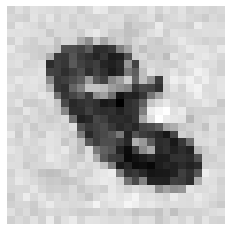

[1103] (예측값)3 (실제값)9


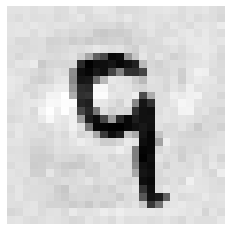

[1107] (예측값)8 (실제값)9


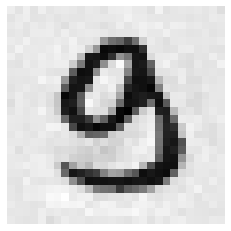

[1110] (예측값)1 (실제값)7


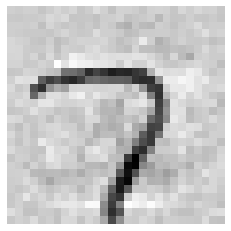

[1112] (예측값)6 (실제값)4


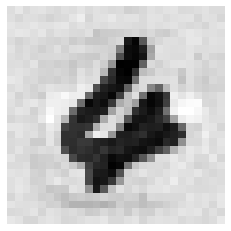

[1116] (예측값)7 (실제값)4


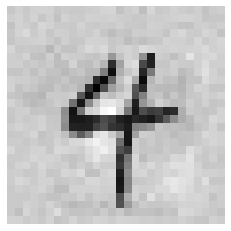

[1122] (예측값)3 (실제값)7


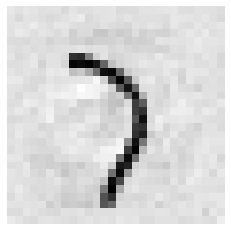

[1124] (예측값)5 (실제값)8


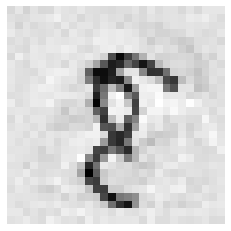

[1127] (예측값)9 (실제값)3


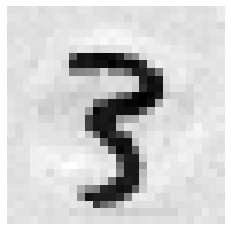

[1128] (예측값)0 (실제값)3


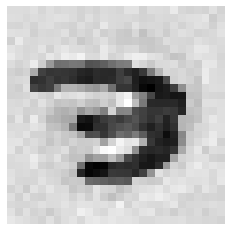

[1129] (예측값)2 (실제값)1


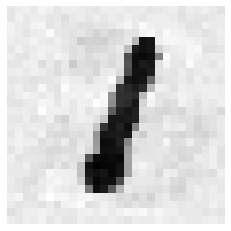

[1132] (예측값)5 (실제값)2


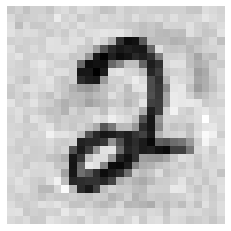

[1133] (예측값)6 (실제값)7


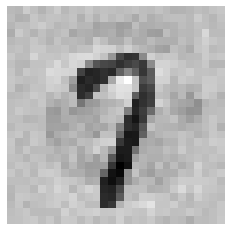

[1137] (예측값)7 (실제값)1


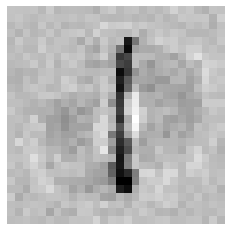

[1138] (예측값)1 (실제값)2


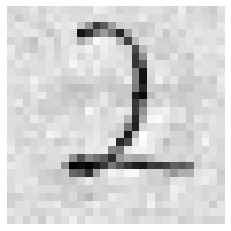

[1143] (예측값)6 (실제값)7


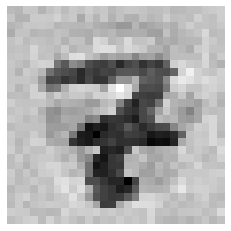

[1145] (예측값)8 (실제값)4


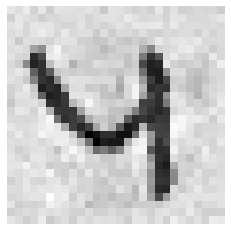

[1147] (예측값)0 (실제값)4


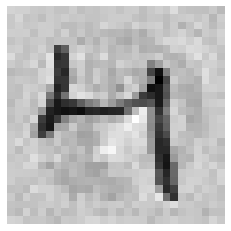

[1151] (예측값)5 (실제값)6


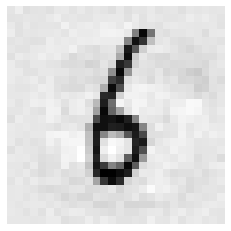

[1153] (예측값)0 (실제값)6


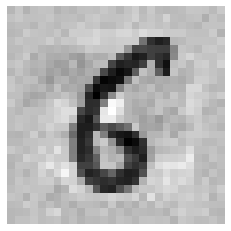

[1154] (예측값)5 (실제값)0


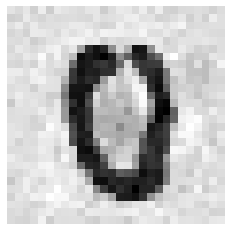

[1155] (예측값)0 (실제값)2


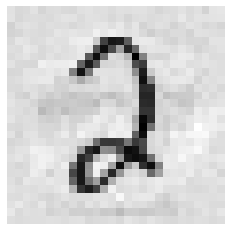

[1156] (예측값)2 (실제값)7


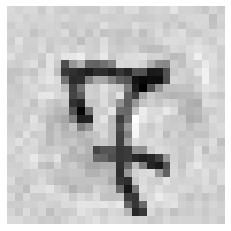

[1159] (예측값)0 (실제값)4


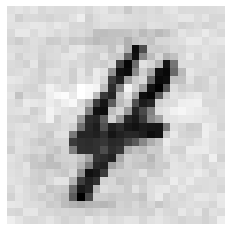

[1163] (예측값)9 (실제값)4


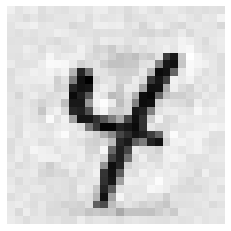

[1164] (예측값)5 (실제값)7


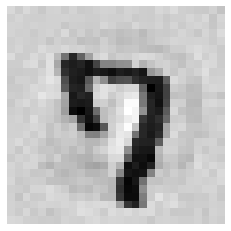

[1166] (예측값)2 (실제값)3


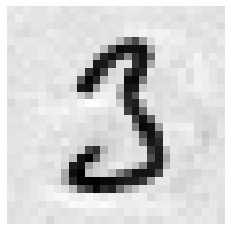

[1176] (예측값)3 (실제값)0


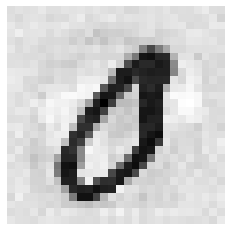

[1178] (예측값)5 (실제값)4


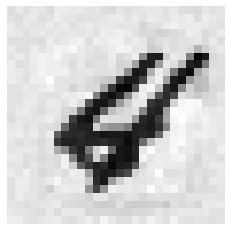

[1181] (예측값)8 (실제값)6


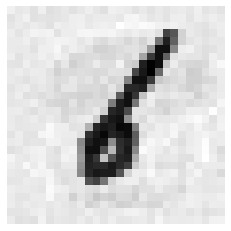

[1182] (예측값)9 (실제값)6


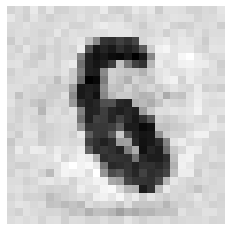

[1184] (예측값)1 (실제값)2


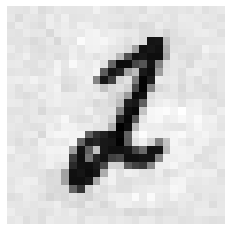

[1187] (예측값)6 (실제값)2


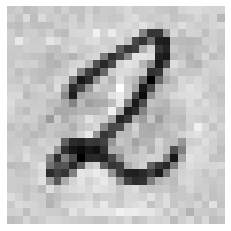

[1188] (예측값)5 (실제값)0


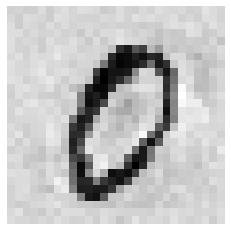

[1191] (예측값)5 (실제값)0


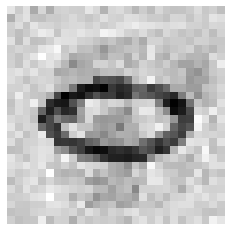

[1192] (예측값)5 (실제값)9


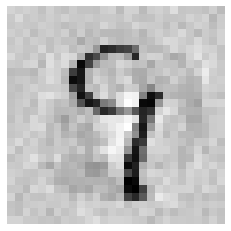

[1194] (예측값)3 (실제값)7


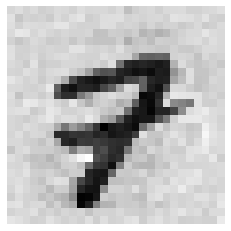

[1197] (예측값)6 (실제값)0


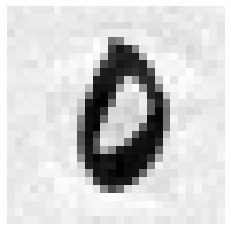

[1198] (예측값)4 (실제값)8


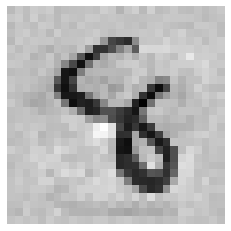

[1200] (예측값)9 (실제값)8


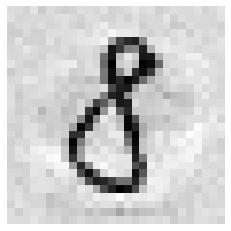

[1206] (예측값)2 (실제값)7


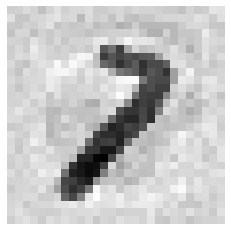

[1208] (예측값)8 (실제값)3


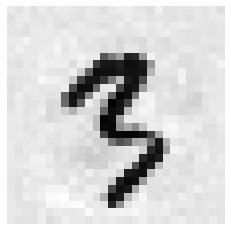

[1209] (예측값)8 (실제값)6


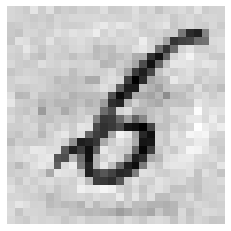

[1210] (예측값)0 (실제값)2


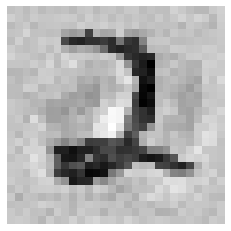

[1212] (예측값)3 (실제값)6


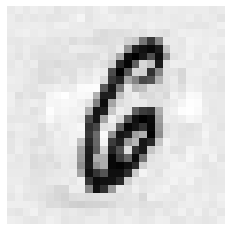

[1214] (예측값)5 (실제값)1


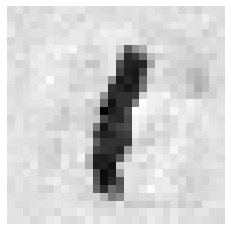

[1215] (예측값)6 (실제값)3


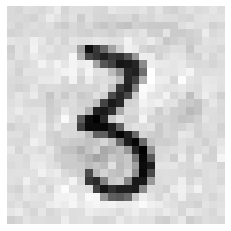

[1216] (예측값)8 (실제값)7


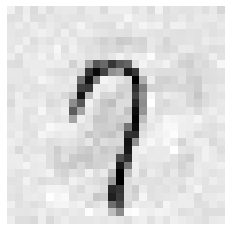

[1218] (예측값)2 (실제값)0


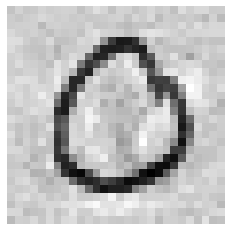

[1222] (예측값)5 (실제값)4


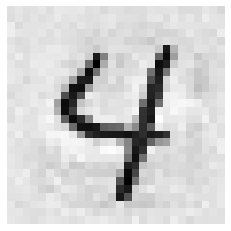

[1223] (예측값)6 (실제값)0


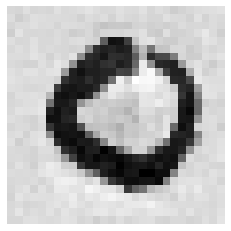

[1224] (예측값)7 (실제값)2


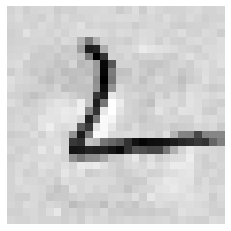

[1226] (예측값)2 (실제값)7


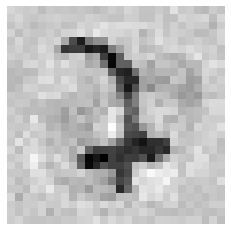

[1228] (예측값)3 (실제값)9


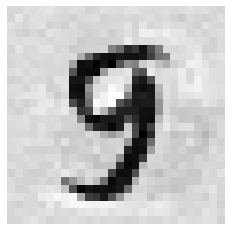

[1229] (예측값)3 (실제값)8


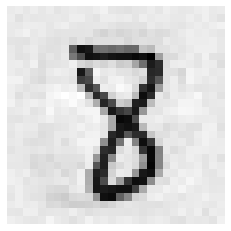

[1232] (예측값)7 (실제값)9


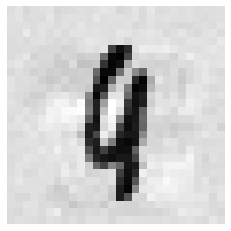

[1238] (예측값)4 (실제값)1


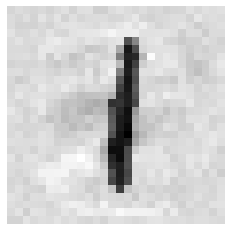

[1239] (예측값)5 (실제값)3


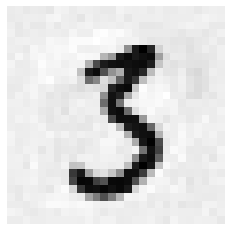

[1240] (예측값)6 (실제값)1


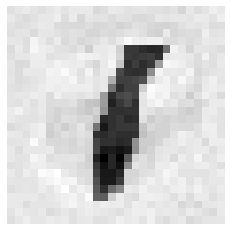

[1241] (예측값)8 (실제값)7


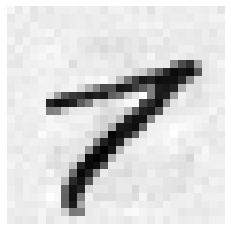

[1242] (예측값)9 (실제값)4


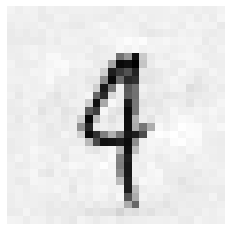

[1247] (예측값)5 (실제값)9


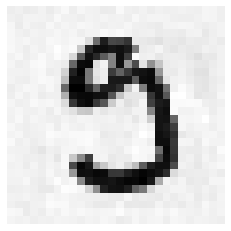

[1248] (예측값)6 (실제값)8


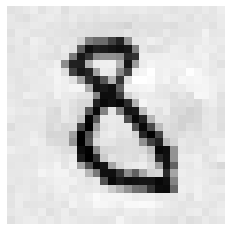

[1249] (예측값)7 (실제값)8


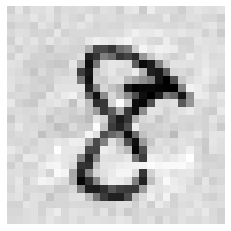

[1250] (예측값)8 (실제값)6


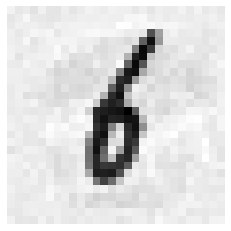

[1255] (예측값)3 (실제값)9


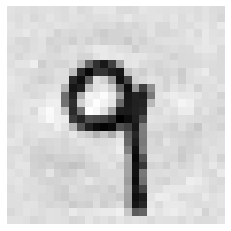

[1256] (예측값)8 (실제값)2


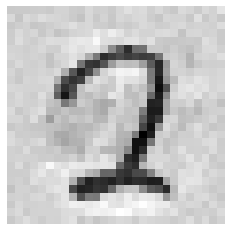

[1257] (예측값)5 (실제값)1


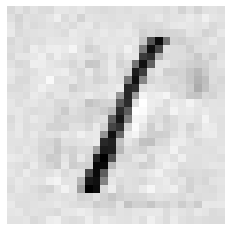

[1260] (예측값)8 (실제값)7


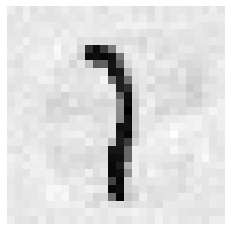

[1263] (예측값)8 (실제값)4


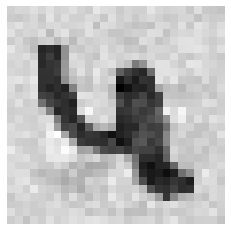

[1269] (예측값)8 (실제값)2


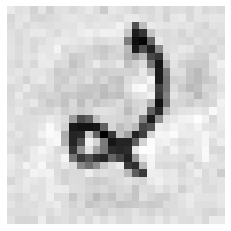

[1270] (예측값)9 (실제값)4


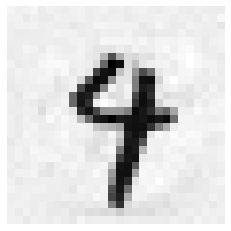

[1272] (예측값)3 (실제값)5


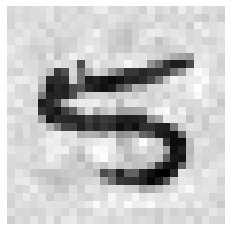

[1275] (예측값)5 (실제값)4


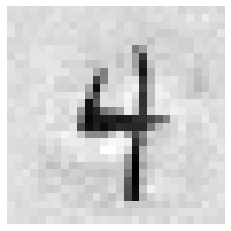

[1276] (예측값)2 (실제값)7


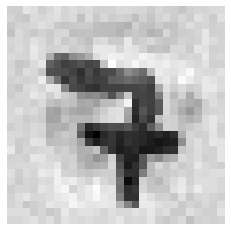

[1277] (예측값)7 (실제값)9


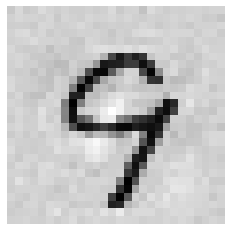

[1279] (예측값)9 (실제값)4


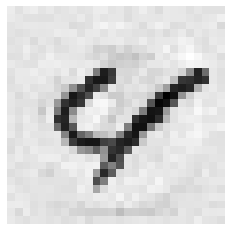

[1280] (예측값)0 (실제값)1


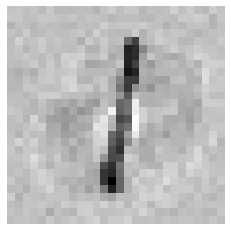

[1282] (예측값)2 (실제값)9


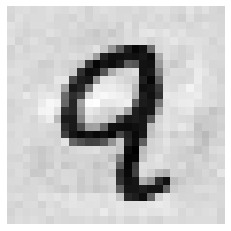

[1283] (예측값)3 (실제값)7


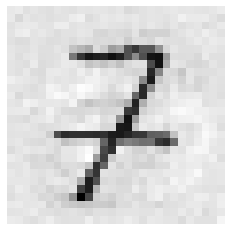

[1287] (예측값)9 (실제값)8


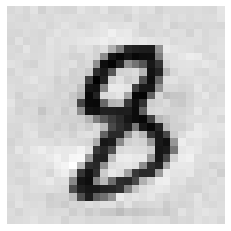

[1289] (예측값)8 (실제값)5


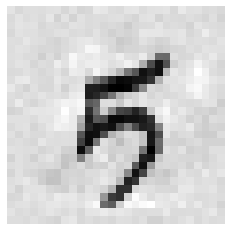

[1295] (예측값)9 (실제값)1


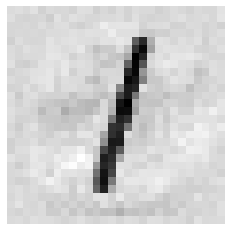

[1298] (예측값)2 (실제값)3


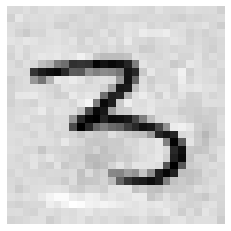

[1299] (예측값)3 (실제값)5


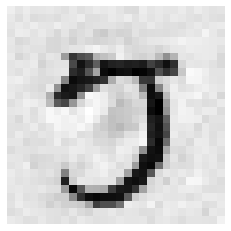

[1301] (예측값)6 (실제값)4


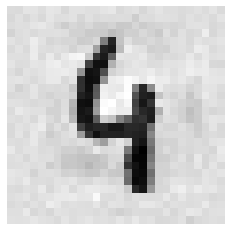

[1303] (예측값)8 (실제값)2


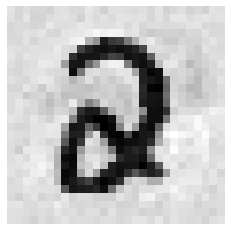

[1304] (예측값)5 (실제값)9


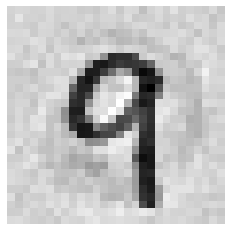

[1305] (예측값)2 (실제값)1


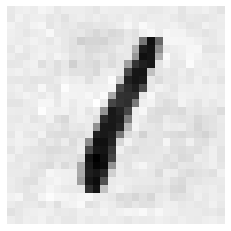

[1307] (예측값)4 (실제값)6


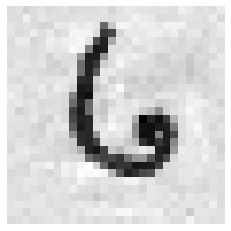

[1309] (예측값)2 (실제값)9


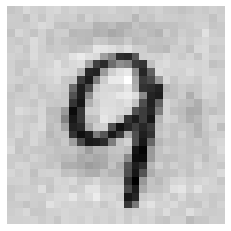

[1310] (예측값)7 (실제값)3


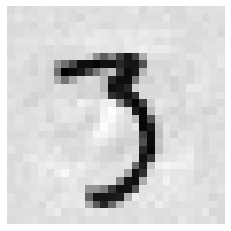

[1313] (예측값)5 (실제값)4


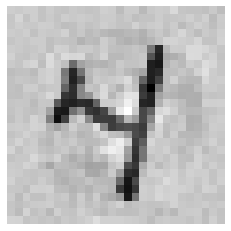

[1316] (예측값)3 (실제값)1


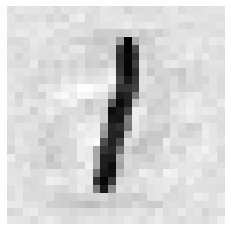

[1317] (예측값)4 (실제값)3


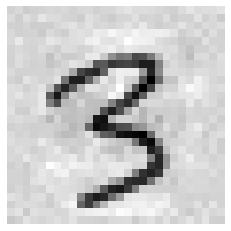

[1318] (예측값)5 (실제값)1


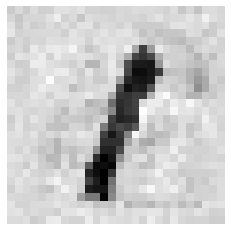

[1319] (예측값)0 (실제값)8


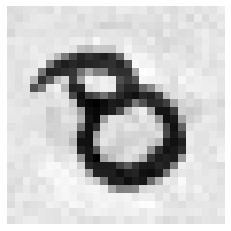

[1322] (예측값)5 (실제값)9


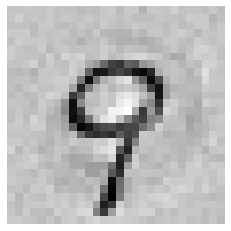

[1325] (예측값)6 (실제값)8


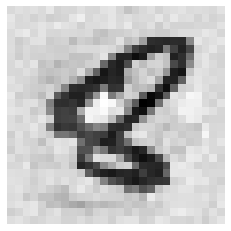

[1326] (예측값)2 (실제값)7


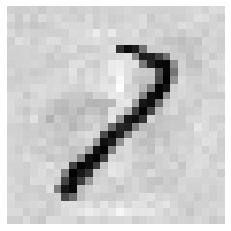

[1328] (예측값)6 (실제값)7


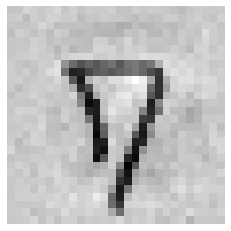

[1329] (예측값)7 (실제값)1


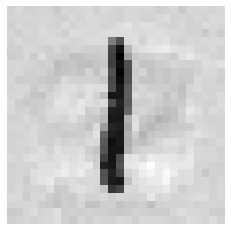

[1335] (예측값)3 (실제값)2


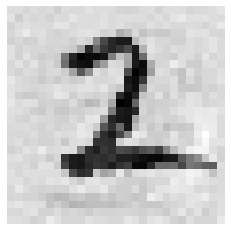

[1337] (예측값)5 (실제값)2


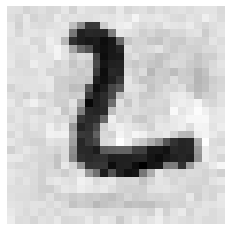

[1340] (예측값)8 (실제값)5


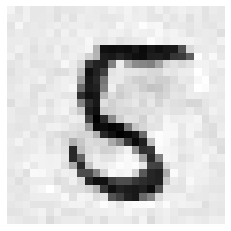

[1342] (예측값)5 (실제값)4


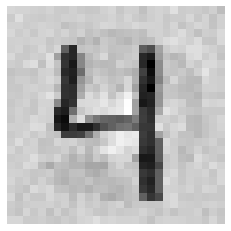

[1343] (예측값)3 (실제값)9


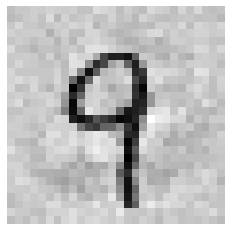

[1347] (예측값)5 (실제값)7


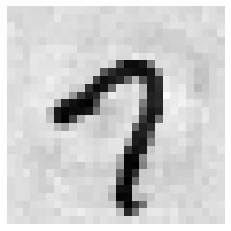

[1351] (예측값)9 (실제값)1


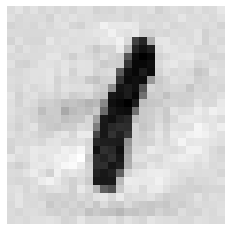

[1352] (예측값)0 (실제값)2


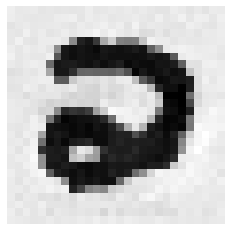

[1354] (예측값)2 (실제값)3


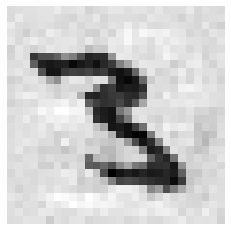

[1355] (예측값)3 (실제값)7


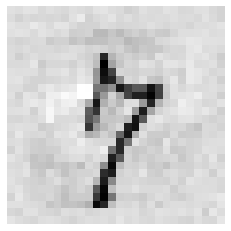

[1357] (예측값)5 (실제값)4


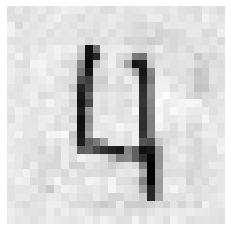

[1360] (예측값)9 (실제값)1


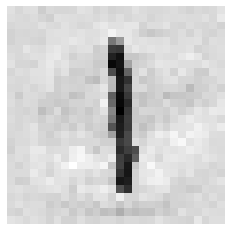

[1363] (예측값)2 (실제값)7


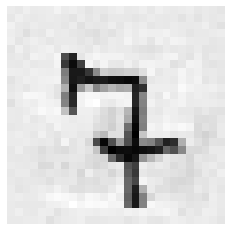

[1364] (예측값)3 (실제값)8


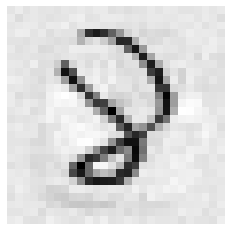

[1366] (예측값)5 (실제값)7


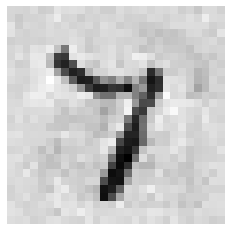

[1368] (예측값)7 (실제값)1


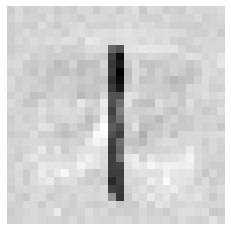

[1371] (예측값)2 (실제값)8


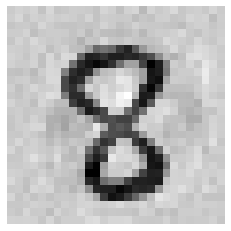

[1375] (예측값)8 (실제값)2


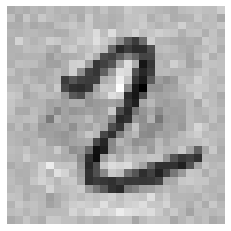

[1377] (예측값)7 (실제값)6


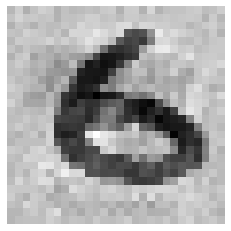

[1378] (예측값)8 (실제값)5


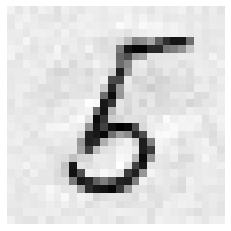

[1379] (예측값)9 (실제값)0


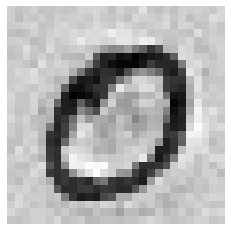

[1385] (예측값)6 (실제값)9


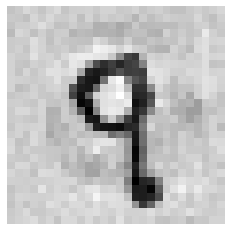

[1386] (예측값)8 (실제값)7


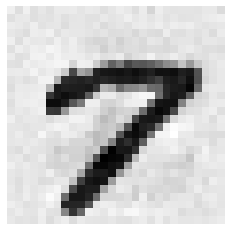

[1387] (예측값)9 (실제값)6


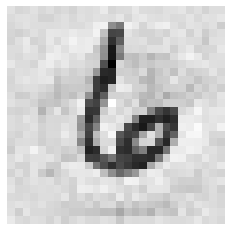

[1391] (예측값)3 (실제값)4


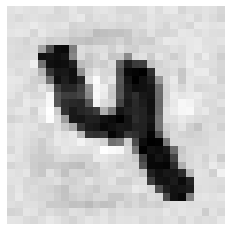

[1392] (예측값)4 (실제값)1


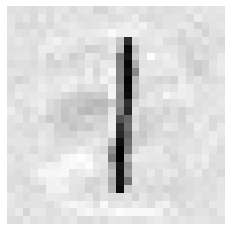

[1393] (예측값)6 (실제값)5


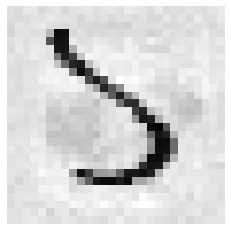

[1396] (예측값)7 (실제값)9


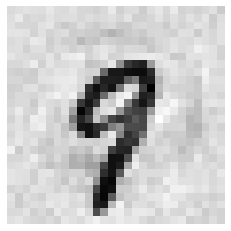

[1398] (예측값)3 (실제값)8


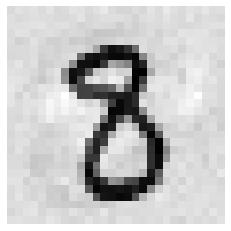

[1401] (예측값)6 (실제값)7


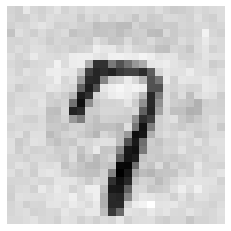

[1402] (예측값)7 (실제값)2


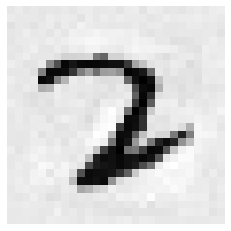

[1403] (예측값)8 (실제값)1


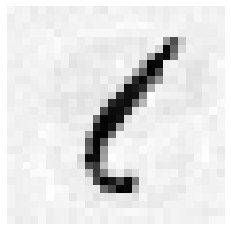

[1404] (예측값)9 (실제값)0


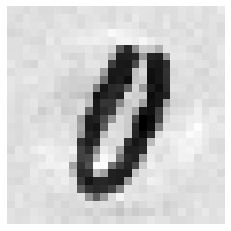

[1409] (예측값)8 (실제값)2


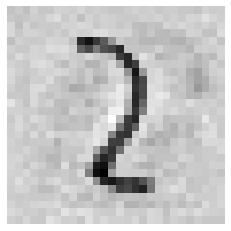

[1410] (예측값)6 (실제값)2


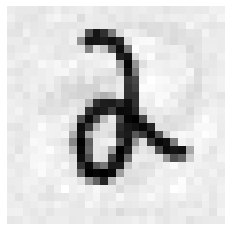

[1412] (예측값)8 (실제값)2


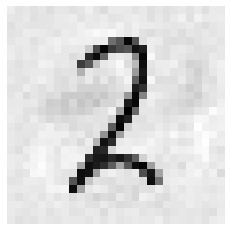

[1413] (예측값)9 (실제값)4


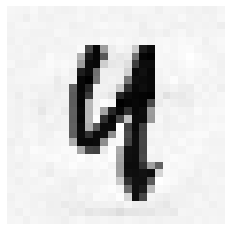

[1414] (예측값)5 (실제값)9


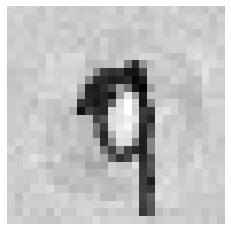

[1422] (예측값)9 (실제값)4


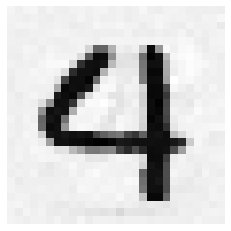

[1423] (예측값)0 (실제값)9


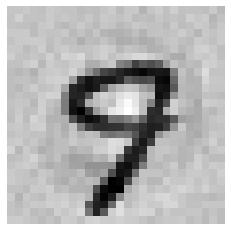

[1426] (예측값)8 (실제값)3


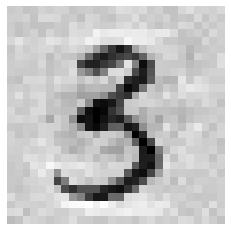

[1433] (예측값)1 (실제값)8


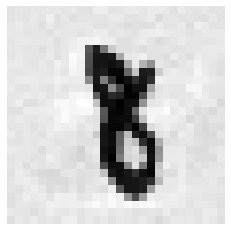

[1438] (예측값)6 (실제값)0


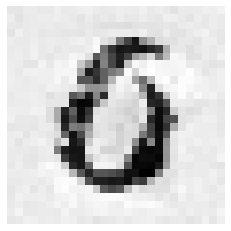

[1440] (예측값)8 (실제값)4


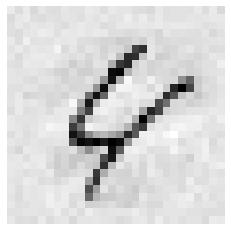

[1445] (예측값)3 (실제값)0


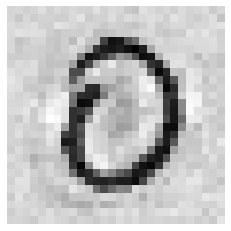

[1446] (예측값)6 (실제값)2


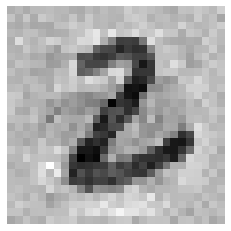

[1447] (예측값)6 (실제값)5


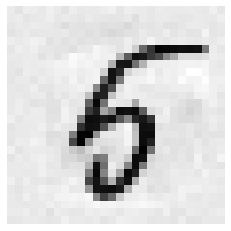

[1448] (예측값)7 (실제값)1


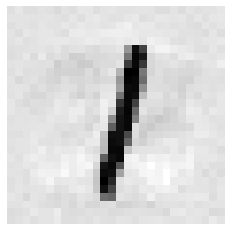

[1453] (예측값)2 (실제값)4


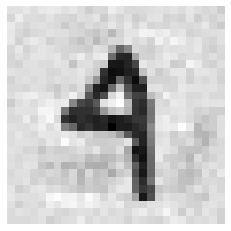

[1455] (예측값)4 (실제값)9


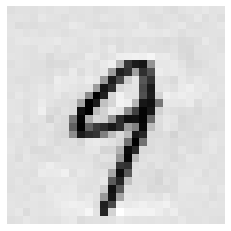

[1459] (예측값)8 (실제값)2


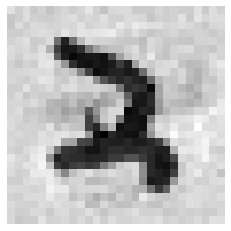

[1462] (예측값)1 (실제값)2


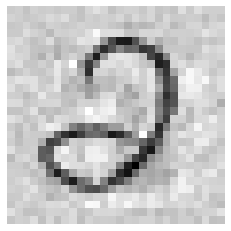

[1464] (예측값)3 (실제값)8


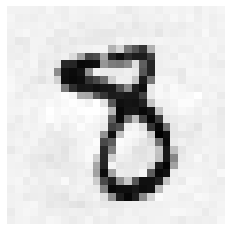

[1465] (예측값)5 (실제값)4


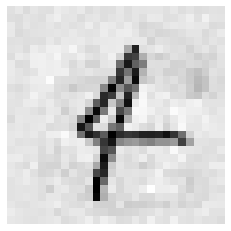

[1467] (예측값)7 (실제값)5


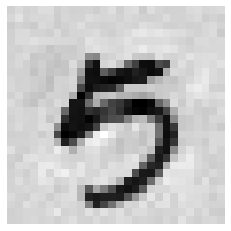

[1469] (예측값)2 (실제값)3


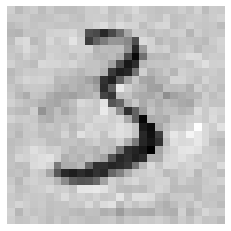

[1475] (예측값)5 (실제값)6


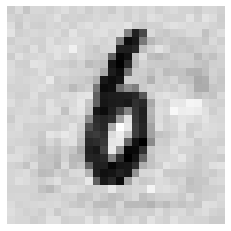

[1477] (예측값)2 (실제값)7


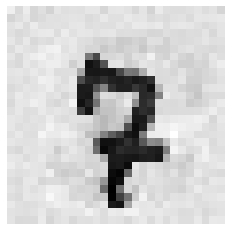

[1478] (예측값)8 (실제값)6


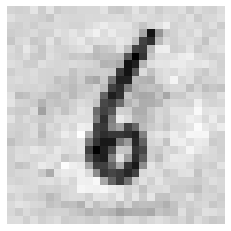

[1481] (예측값)2 (실제값)9


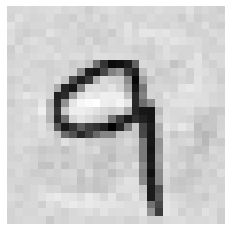

[1482] (예측값)5 (실제값)6


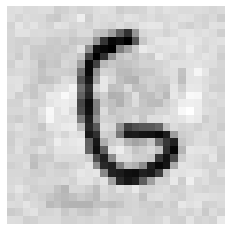

[1486] (예측값)7 (실제값)9


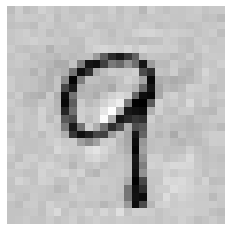

[1488] (예측값)9 (실제값)4


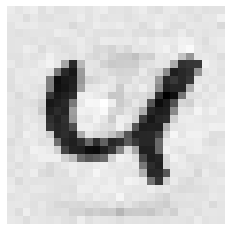

[1489] (예측값)5 (실제값)3


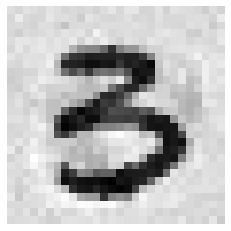

[1492] (예측값)3 (실제값)9


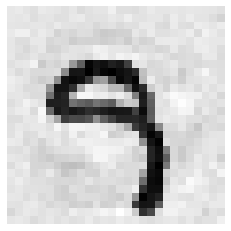

[1494] (예측값)5 (실제값)7


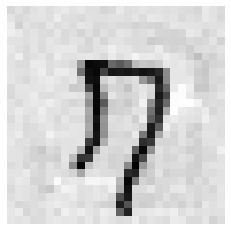

[1496] (예측값)8 (실제값)7


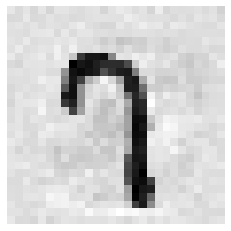

[1500] (예측값)2 (실제값)7


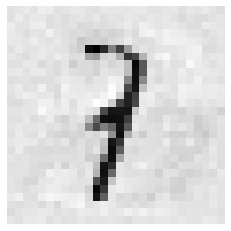

[1503] (예측값)5 (실제값)3


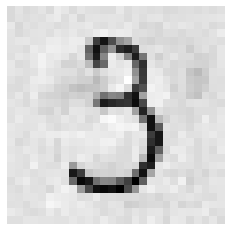

[1504] (예측값)6 (실제값)0


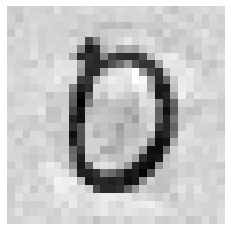

[1505] (예측값)8 (실제값)7


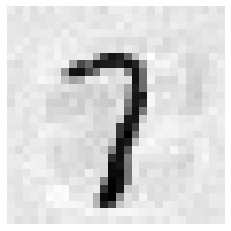

[1506] (예측값)8 (실제값)2


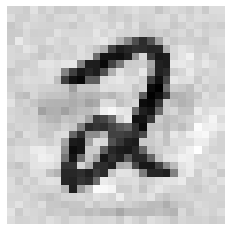

[1512] (예측값)8 (실제값)9


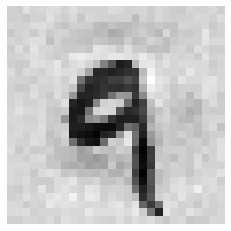

[1514] (예측값)8 (실제값)2


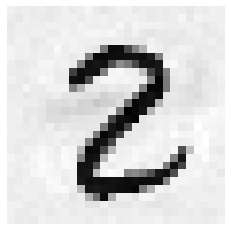

[1515] (예측값)9 (실제값)1


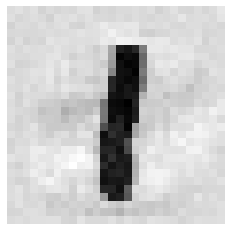

[1516] (예측값)9 (실제값)4


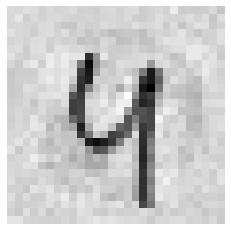

[1518] (예측값)3 (실제값)2


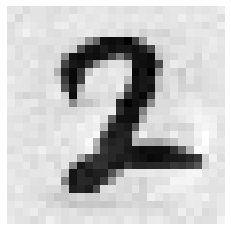

[1520] (예측값)8 (실제값)7


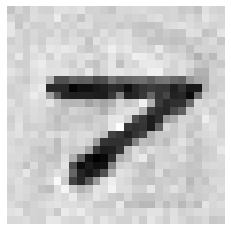

[1522] (예측값)8 (실제값)7


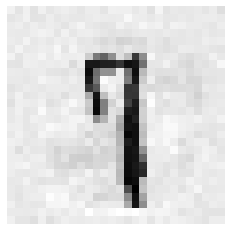

[1525] (예측값)1 (실제값)5


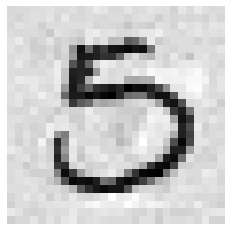

[1527] (예측값)3 (실제값)1


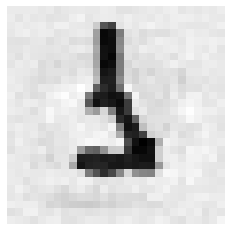

[1530] (예측값)6 (실제값)8


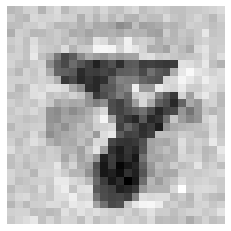

[1532] (예측값)8 (실제값)9


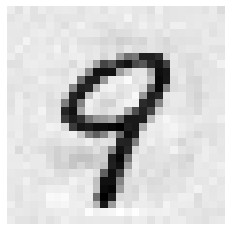

[1533] (예측값)9 (실제값)0


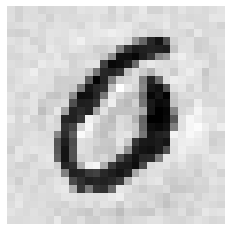

[1537] (예측값)5 (실제값)6


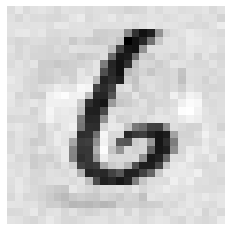

[1538] (예측값)4 (실제값)2


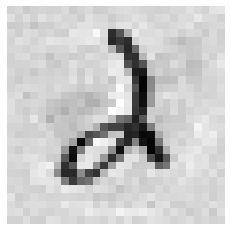

[1540] (예측값)2 (실제값)7


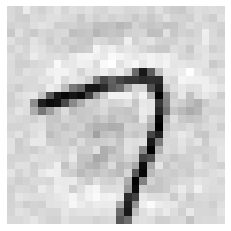

[1541] (예측값)3 (실제값)8


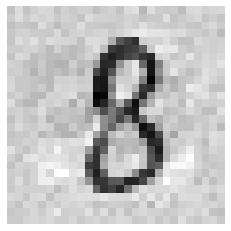

[1546] (예측값)3 (실제값)2


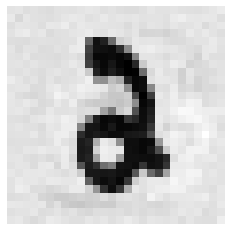

[1547] (예측값)5 (실제값)4


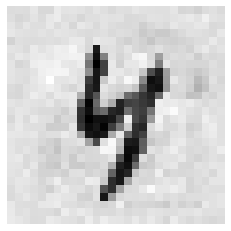

[1549] (예측값)7 (실제값)4


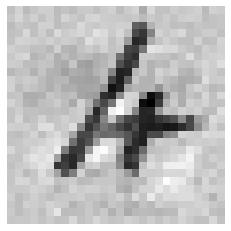

[1551] (예측값)3 (실제값)2


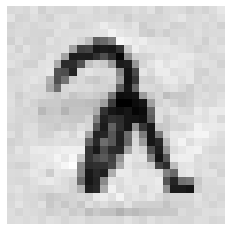

[1552] (예측값)0 (실제값)4


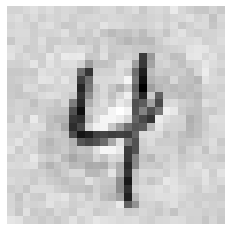

[1553] (예측값)3 (실제값)9


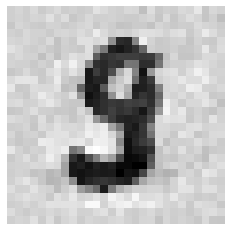

[1554] (예측값)8 (실제값)9


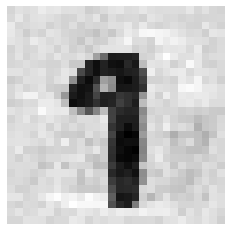

[1555] (예측값)3 (실제값)1


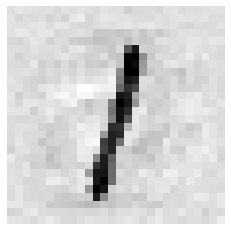

[1558] (예측값)6 (실제값)0


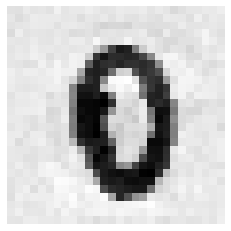

[1559] (예측값)7 (실제값)9


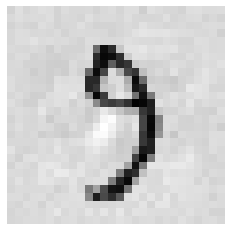

[1560] (예측값)9 (실제값)8


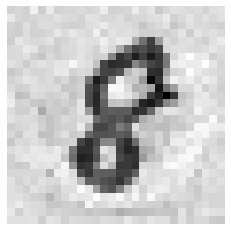

[1561] (예측값)9 (실제값)4


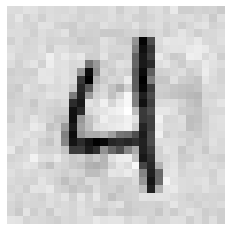

[1563] (예측값)2 (실제값)7


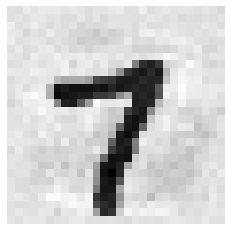

[1564] (예측값)3 (실제값)7


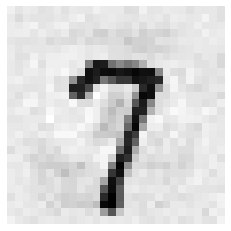

[1566] (예측값)5 (실제값)7


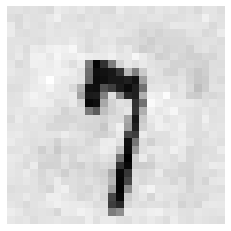

[1568] (예측값)7 (실제값)8


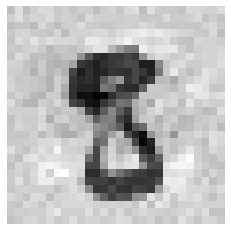

[1571] (예측값)0 (실제값)4


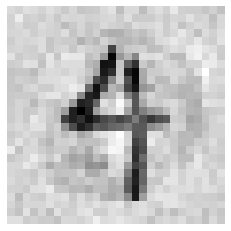

[1573] (예측값)2 (실제값)8


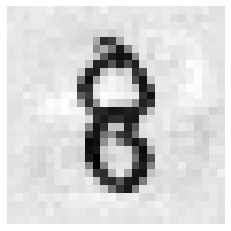

[1575] (예측값)5 (실제값)4


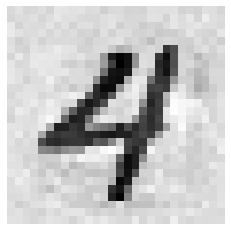

[1576] (예측값)6 (실제값)7


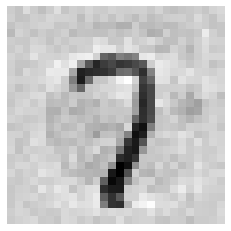

[1579] (예측값)9 (실제값)6


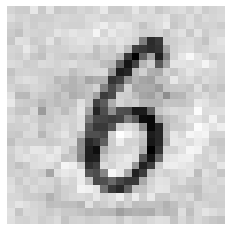

[1580] (예측값)0 (실제값)4


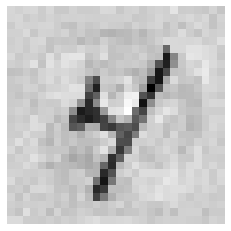

[1583] (예측값)3 (실제값)8


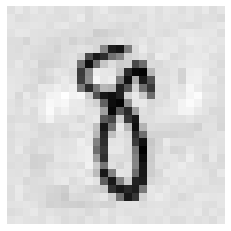

[1584] (예측값)4 (실제값)8


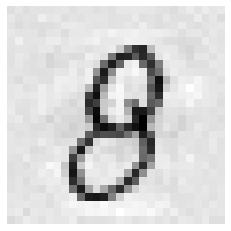

[1587] (예측값)7 (실제값)6


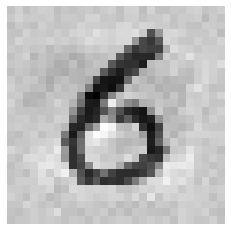

[1592] (예측값)2 (실제값)7


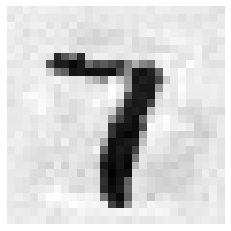

[1594] (예측값)4 (실제값)9


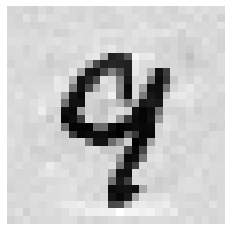

[1595] (예측값)5 (실제값)7


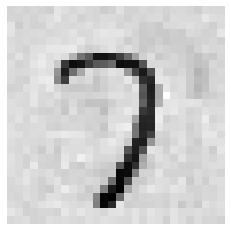

[1596] (예측값)6 (실제값)9


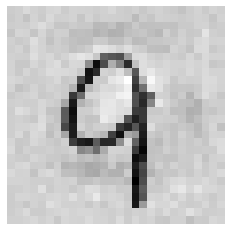

[1597] (예측값)7 (실제값)9


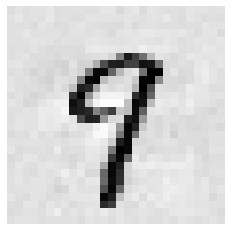

[1599] (예측값)9 (실제값)4


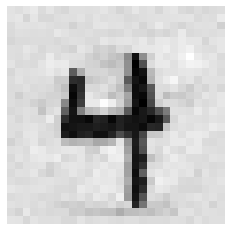

[1603] (예측값)3 (실제값)1


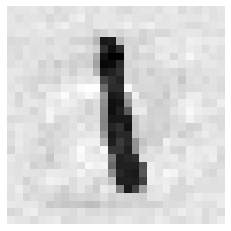

[1604] (예측값)6 (실제값)2


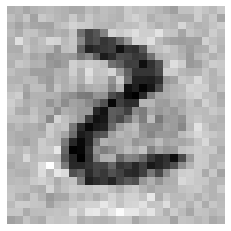

[1607] (예측값)7 (실제값)3


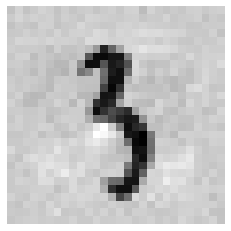

[1609] (예측값)6 (실제값)2


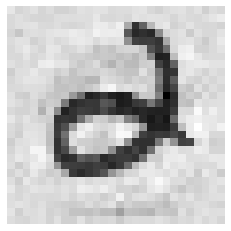

[1611] (예측값)1 (실제값)3


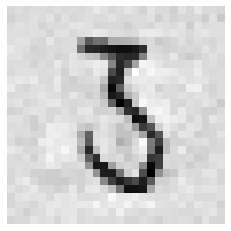

[1614] (예측값)9 (실제값)4


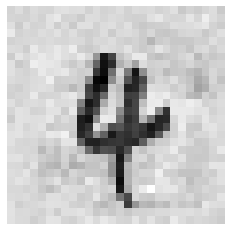

[1617] (예측값)8 (실제값)3


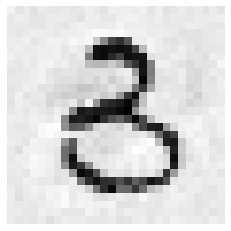

[1621] (예측값)2 (실제값)0


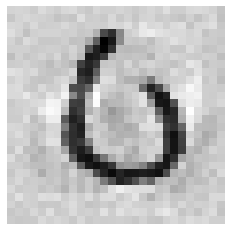

[1626] (예측값)0 (실제값)6


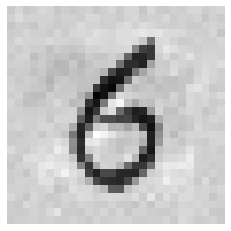

[1628] (예측값)9 (실제값)3


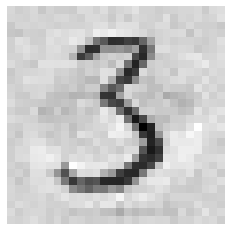

[1633] (예측값)5 (실제값)1


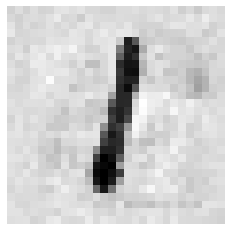

[1634] (예측값)6 (실제값)4


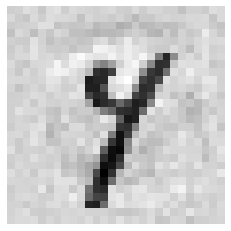

[1635] (예측값)0 (실제값)5


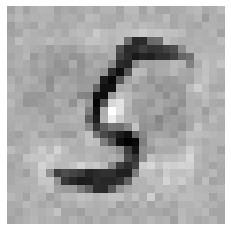

[1637] (예측값)9 (실제값)5


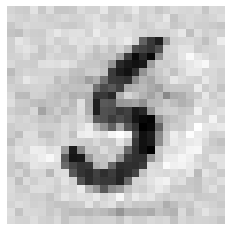

[1640] (예측값)8 (실제값)9


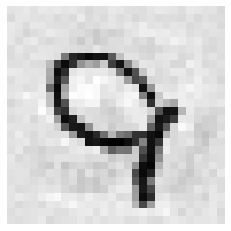

[1643] (예측값)5 (실제값)1


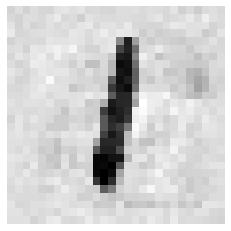

[1647] (예측값)0 (실제값)9


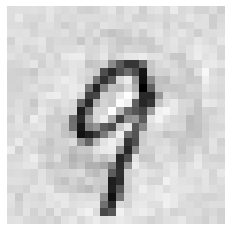

[1650] (예측값)3 (실제값)0


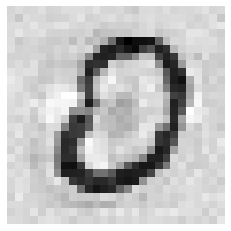

[1651] (예측값)4 (실제값)8


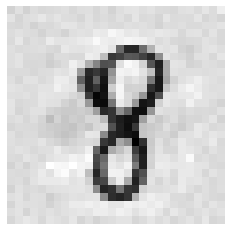

[1654] (예측값)7 (실제값)2


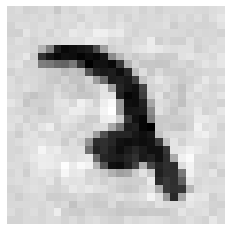

[1655] (예측값)8 (실제값)9


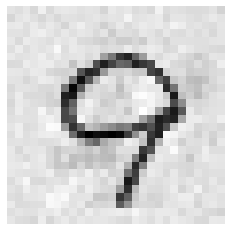

[1657] (예측값)0 (실제값)1


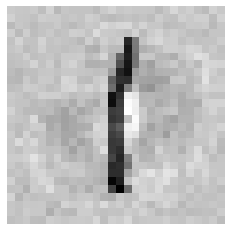

[1660] (예측값)3 (실제값)7


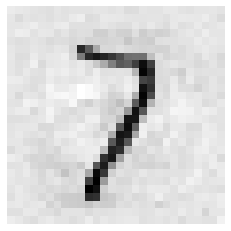

[1664] (예측값)0 (실제값)8


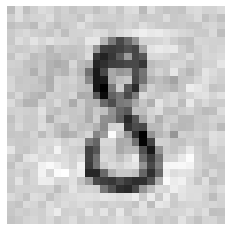

[1665] (예측값)8 (실제값)4


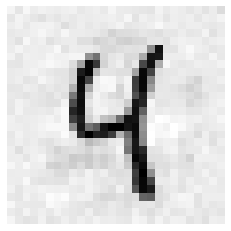

[1668] (예측값)3 (실제값)9


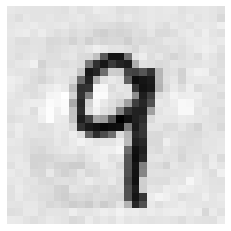

[1671] (예측값)3 (실제값)7


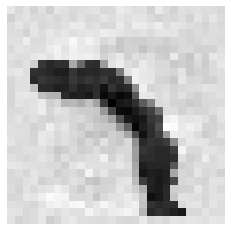

[1673] (예측값)7 (실제값)1


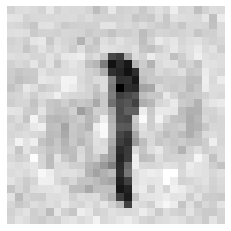

[1678] (예측값)7 (실제값)2


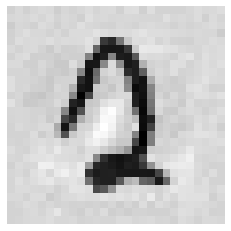

[1679] (예측값)8 (실제값)4


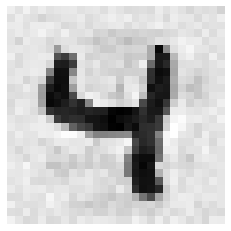

[1680] (예측값)9 (실제값)4


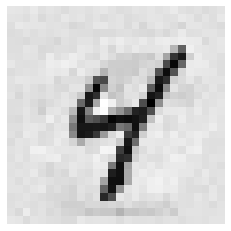

[1681] (예측값)7 (실제값)3


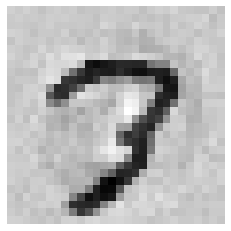

[1684] (예측값)3 (실제값)5


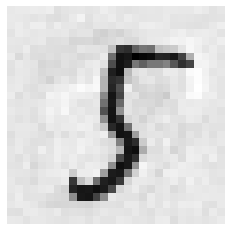

[1686] (예측값)5 (실제값)8


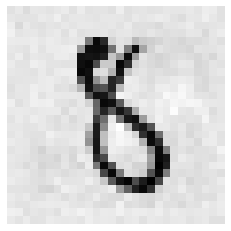

[1690] (예측값)9 (실제값)3


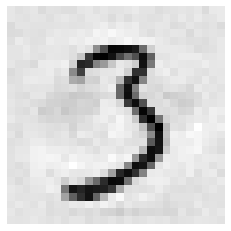

[1691] (예측값)2 (실제값)1


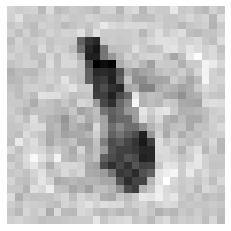

[1692] (예측값)2 (실제값)0


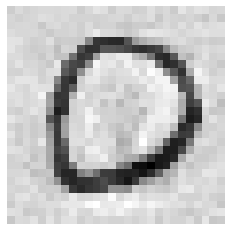

[1694] (예측값)3 (실제값)8


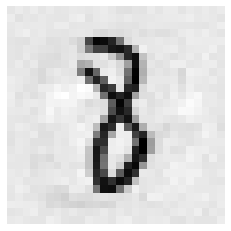

[1695] (예측값)4 (실제값)9


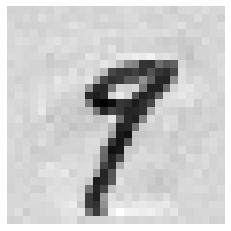

[1696] (예측값)8 (실제값)2


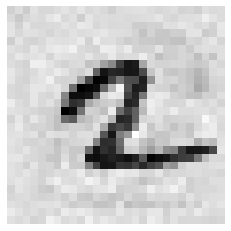

[1697] (예측값)6 (실제값)9


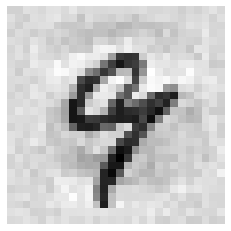

[1700] (예측값)9 (실제값)0


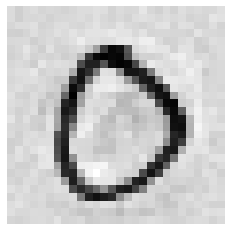

[1701] (예측값)5 (실제값)4


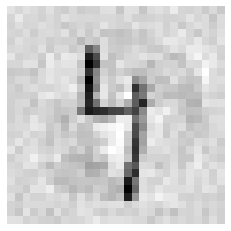

[1703] (예측값)2 (실제값)7


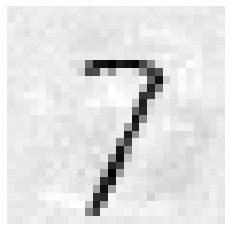

[1704] (예측값)3 (실제값)1


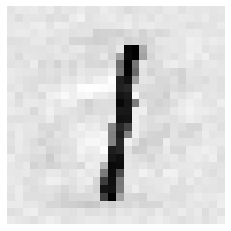

[1705] (예측값)4 (실제값)7


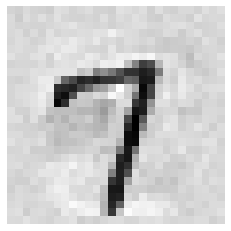

[1706] (예측값)5 (실제값)4


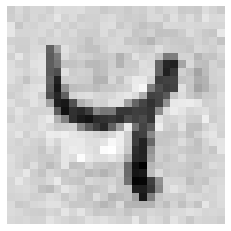

[1708] (예측값)6 (실제값)0


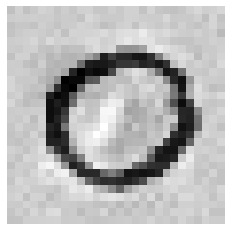

[1709] (예측값)8 (실제값)9


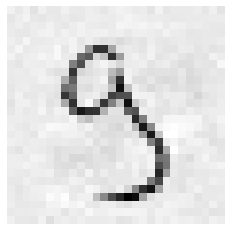

[1712] (예측값)1 (실제값)0


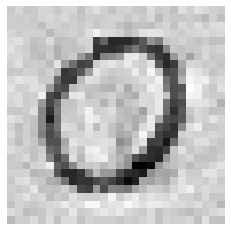

[1716] (예측값)5 (실제값)7


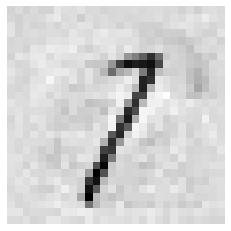

[1717] (예측값)6 (실제값)8


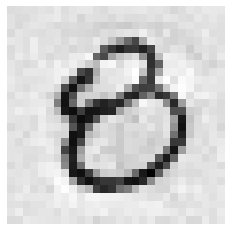

[1718] (예측값)3 (실제값)7


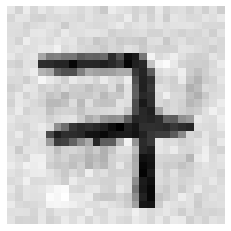

[1720] (예측값)9 (실제값)4


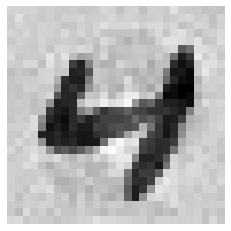

[1721] (예측값)1 (실제값)7


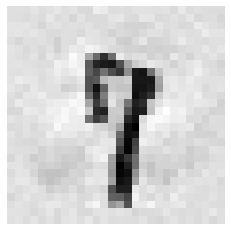

[1722] (예측값)7 (실제값)2


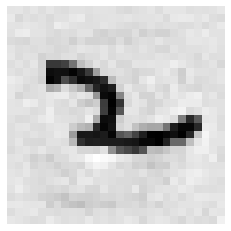

[1724] (예측값)5 (실제값)4


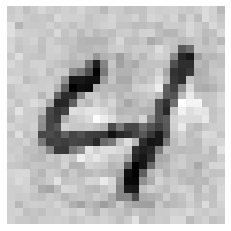

[1727] (예측값)7 (실제값)3


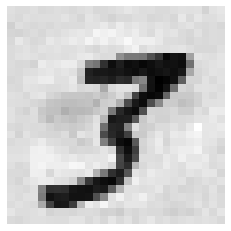

[1728] (예측값)7 (실제값)1


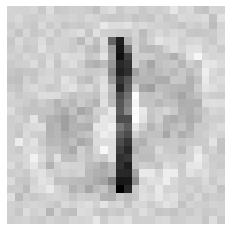

[1730] (예측값)8 (실제값)3


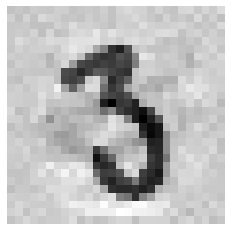

[1732] (예측값)5 (실제값)9


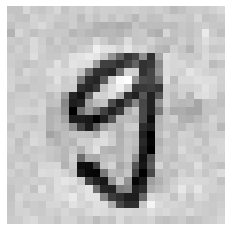

[1734] (예측값)5 (실제값)7


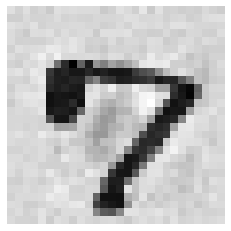

[1735] (예측값)9 (실제값)4


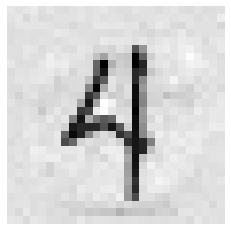

[1736] (예측값)7 (실제값)1


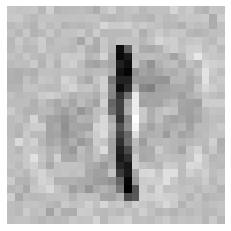

[1737] (예측값)1 (실제값)5


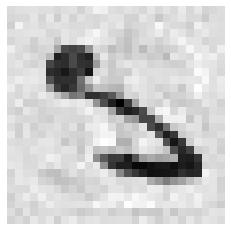

[1740] (예측값)4 (실제값)8


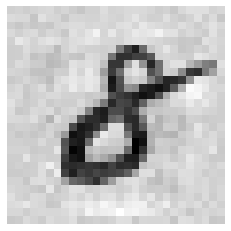

[1743] (예측값)7 (실제값)9


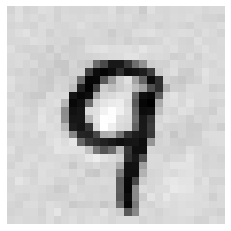

[1745] (예측값)0 (실제값)9


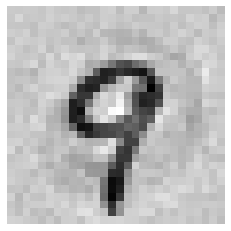

[1751] (예측값)6 (실제값)4


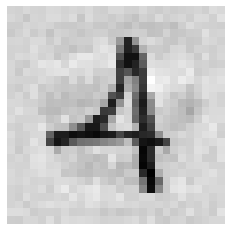

[1760] (예측값)5 (실제값)1


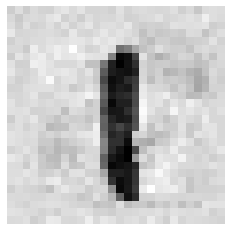

[1761] (예측값)6 (실제값)5


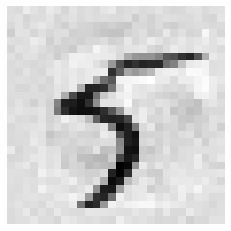

[1765] (예측값)5 (실제값)3


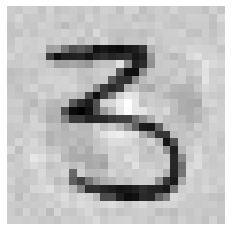

[1766] (예측값)2 (실제값)1


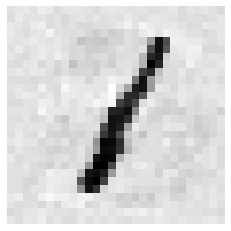

[1772] (예측값)8 (실제값)7


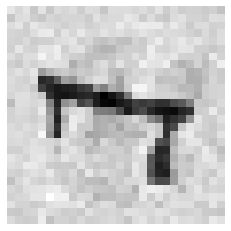

[1773] (예측값)9 (실제값)1


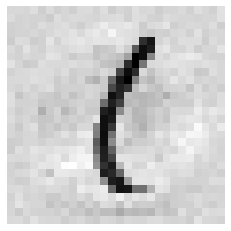

[1774] (예측값)0 (실제값)8


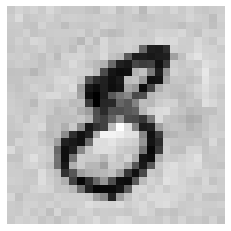

[1775] (예측값)2 (실제값)0


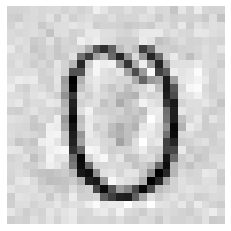

[1776] (예측값)2 (실제값)7


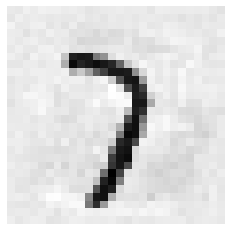

[1777] (예측값)3 (실제값)0


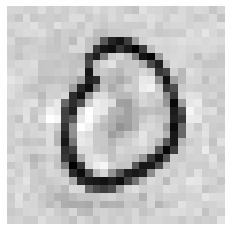

[1779] (예측값)2 (실제값)3


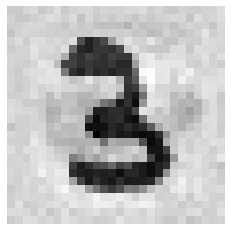

[1780] (예측값)7 (실제값)1


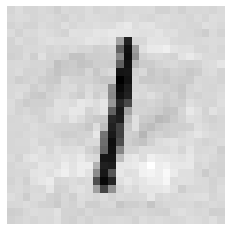

[1783] (예측값)5 (실제값)7


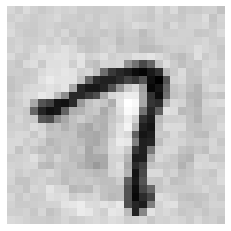

[1786] (예측값)7 (실제값)4


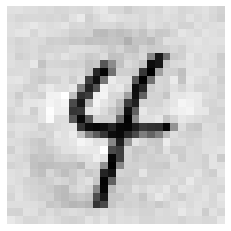

[1788] (예측값)5 (실제값)9


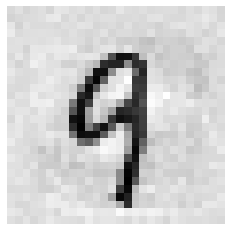

[1790] (예측값)7 (실제값)2


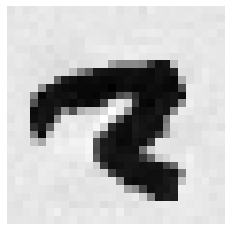

[1794] (예측값)2 (실제값)0


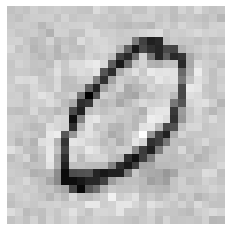

[1797] (예측값)5 (실제값)3


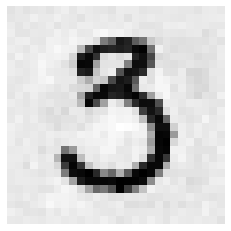

[1800] (예측값)4 (실제값)6


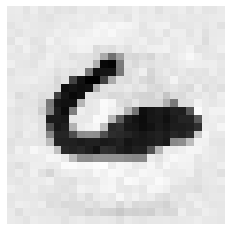

[1805] (예측값)5 (실제값)7


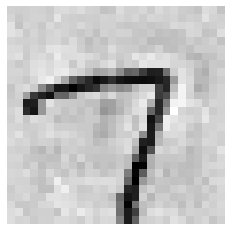

[1806] (예측값)6 (실제값)7


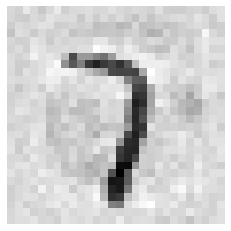

[1809] (예측값)9 (실제값)7


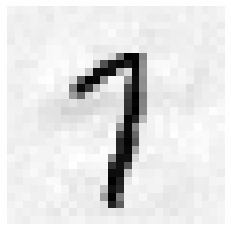

[1812] (예측값)2 (실제값)9


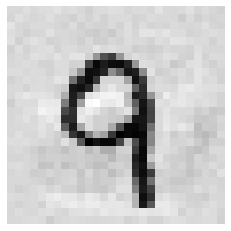

[1813] (예측값)3 (실제값)8


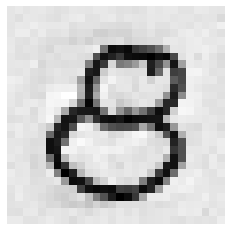

[1814] (예측값)8 (실제값)7


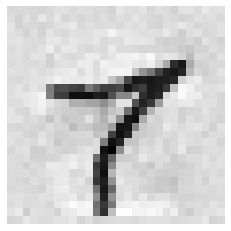

[1815] (예측값)5 (실제값)4


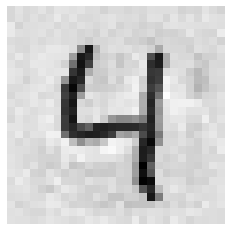

[1818] (예측값)8 (실제값)6


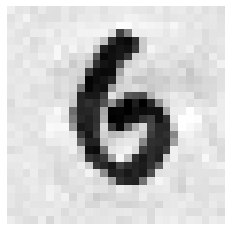

[1819] (예측값)9 (실제값)6


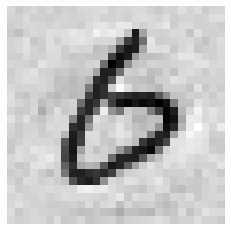

[1821] (예측값)5 (실제값)9


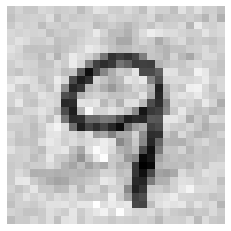

[1823] (예측값)3 (실제값)8


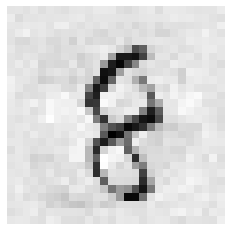

[1825] (예측값)5 (실제값)9


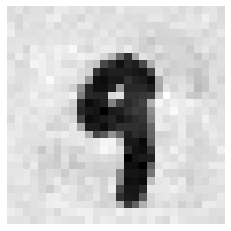

[1829] (예측값)9 (실제값)1


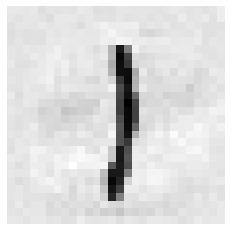

[1830] (예측값)0 (실제값)1


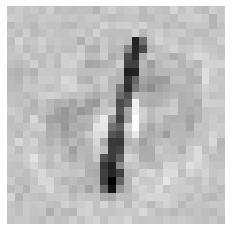

[1832] (예측값)2 (실제값)3


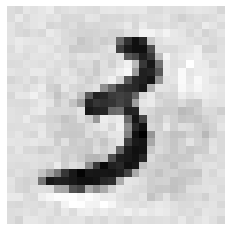

[1836] (예측값)6 (실제값)1


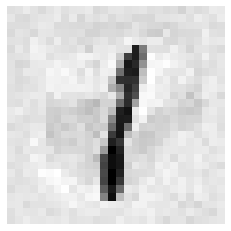

[1837] (예측값)7 (실제값)3


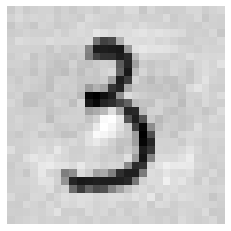

[1838] (예측값)8 (실제값)1


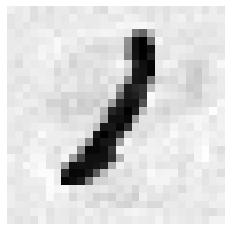

[1842] (예측값)3 (실제값)2


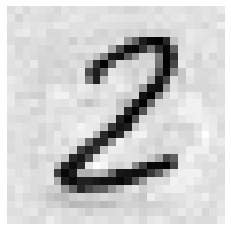

[1844] (예측값)5 (실제값)1


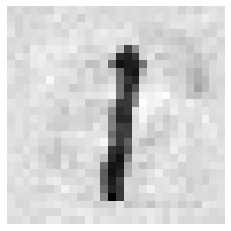

[1848] (예측값)9 (실제값)7


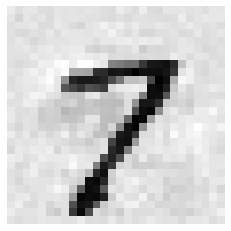

[1849] (예측값)0 (실제값)4


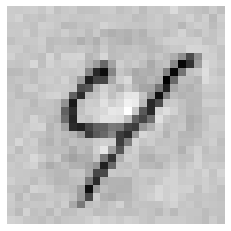

[1851] (예측값)3 (실제값)9


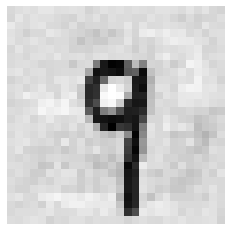

[1852] (예측값)3 (실제값)6


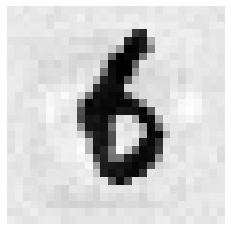

[1853] (예측값)4 (실제값)9


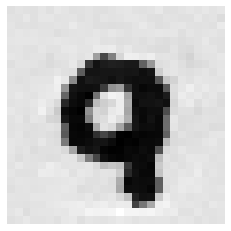

[1855] (예측값)6 (실제값)8


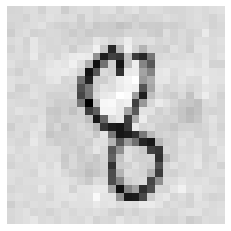

[1860] (예측값)3 (실제값)5


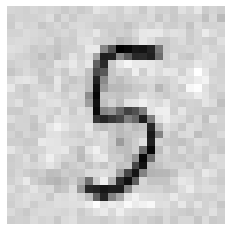

[1862] (예측값)3 (실제값)4


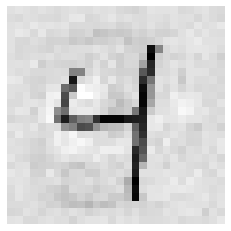

[1865] (예측값)6 (실제값)4


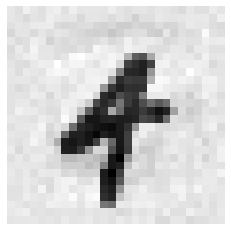

[1868] (예측값)9 (실제값)1


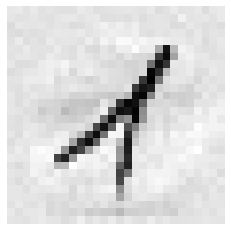

[1869] (예측값)5 (실제값)9


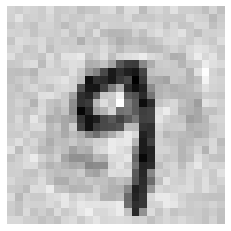

[1871] (예측값)3 (실제값)2


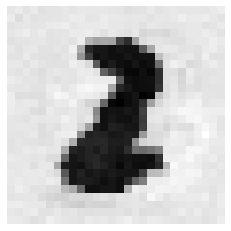

[1874] (예측값)4 (실제값)5


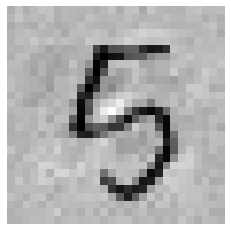

[1876] (예측값)9 (실제값)1


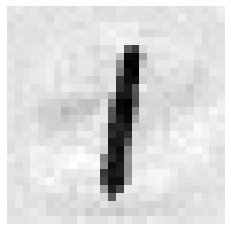

[1878] (예측값)3 (실제값)8


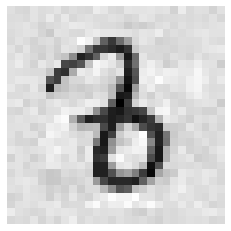

[1881] (예측값)4 (실제값)9


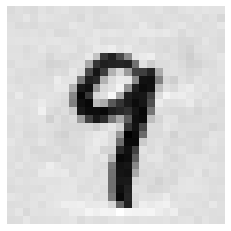

[1882] (예측값)5 (실제값)8


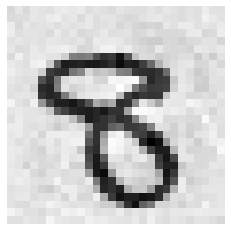

[1883] (예측값)9 (실제값)7


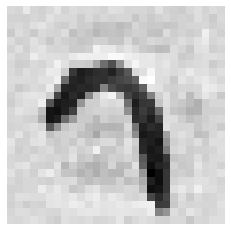

[1884] (예측값)7 (실제값)1


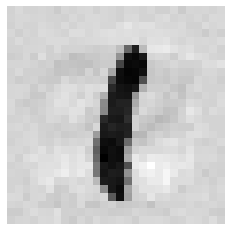

[1885] (예측값)8 (실제값)1


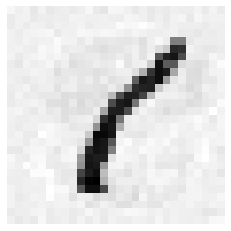

[1886] (예측값)8 (실제값)6


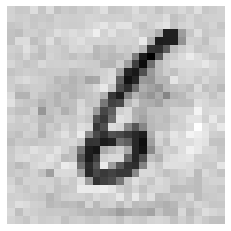

[1887] (예측값)5 (실제값)7


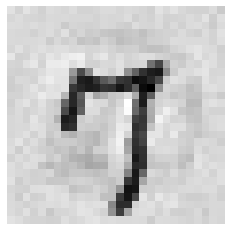

[1892] (예측값)5 (실제값)0


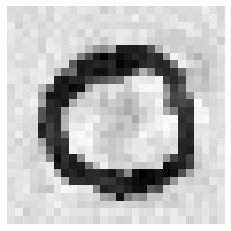

[1894] (예측값)7 (실제값)9


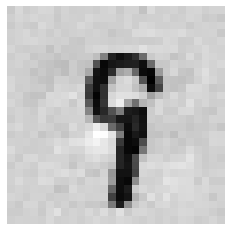

[1897] (예측값)7 (실제값)1


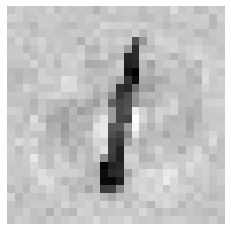

[1898] (예측값)2 (실제값)0


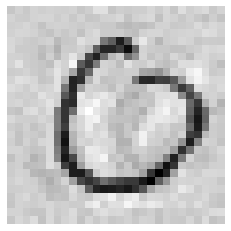

[1901] (예측값)4 (실제값)9


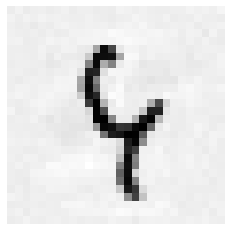

[1902] (예측값)6 (실제값)5


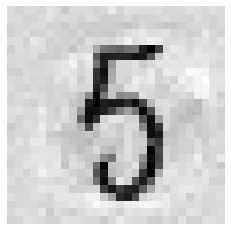

[1903] (예측값)2 (실제값)7


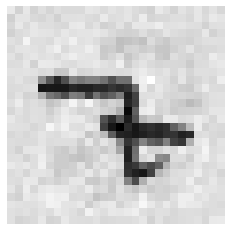

[1904] (예측값)0 (실제값)9


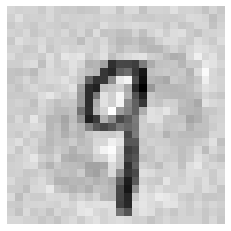

[1907] (예측값)3 (실제값)0


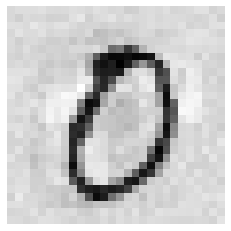

[1908] (예측값)4 (실제값)6


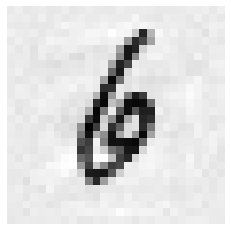

[1909] (예측값)8 (실제값)1


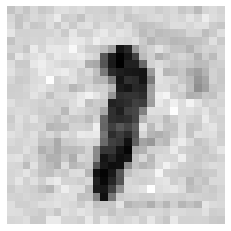

[1912] (예측값)9 (실제값)8


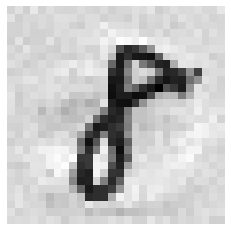

[1915] (예측값)3 (실제값)2


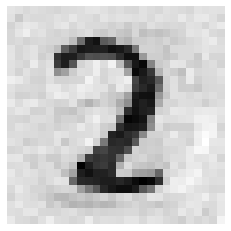

[1920] (예측값)9 (실제값)4


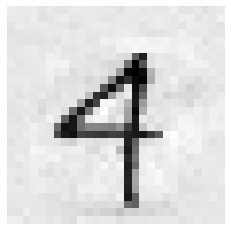

[1922] (예측값)2 (실제값)1


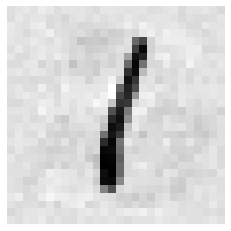

[1924] (예측값)5 (실제값)4


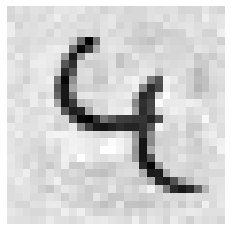

[1925] (예측값)6 (실제값)7


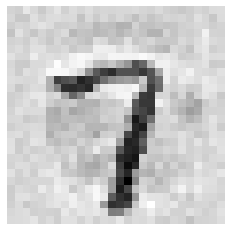

[1926] (예측값)7 (실제값)3


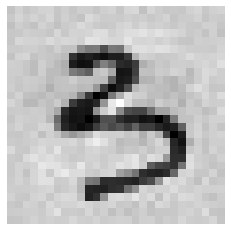

[1928] (예측값)9 (실제값)3


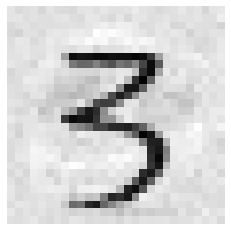

[1935] (예측값)6 (실제값)7


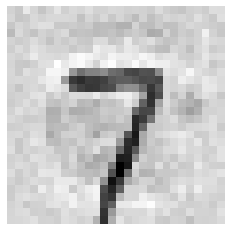

[1937] (예측값)8 (실제값)6


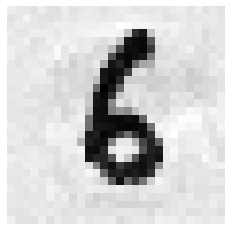

[1938] (예측값)9 (실제값)4


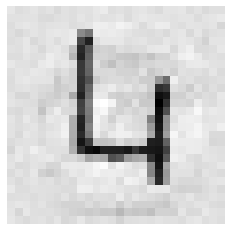

[1939] (예측값)7 (실제값)1


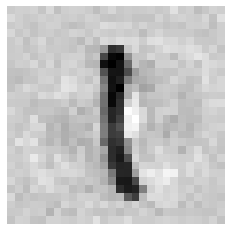

[1941] (예측값)2 (실제값)7


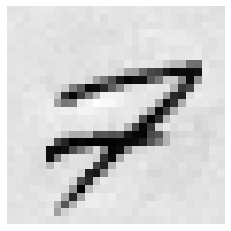

[1942] (예측값)3 (실제값)8


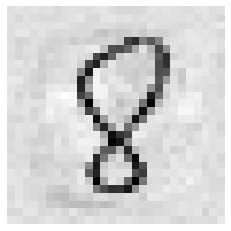

[1945] (예측값)6 (실제값)1


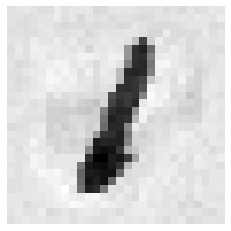

[1952] (예측값)3 (실제값)9


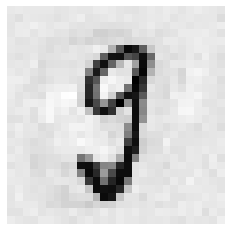

[1957] (예측값)9 (실제값)2


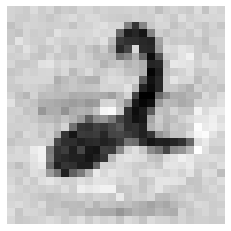

[1958] (예측값)9 (실제값)4


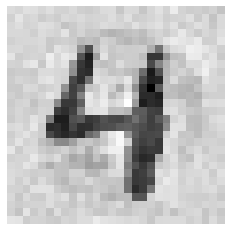

[1960] (예측값)2 (실제값)8


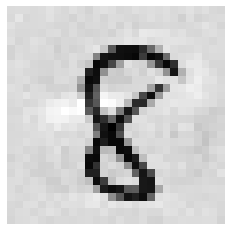

[1961] (예측값)3 (실제값)8


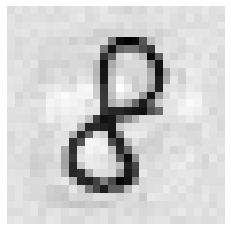

[1963] (예측값)5 (실제값)4


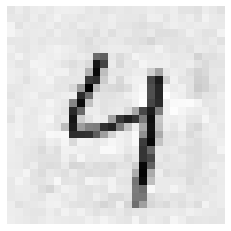

[1964] (예측값)6 (실제값)9


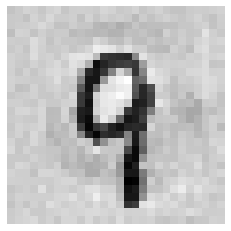

[1970] (예측값)3 (실제값)5


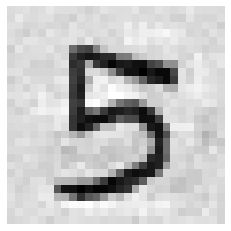

[1973] (예측값)5 (실제값)8


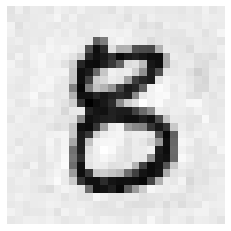

[1976] (예측값)9 (실제값)3


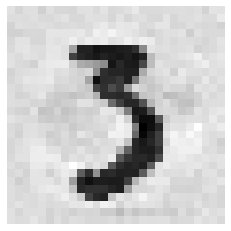

[1979] (예측값)2 (실제값)9


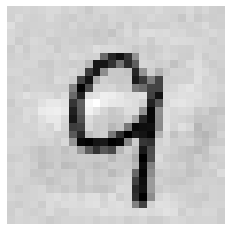

[1981] (예측값)4 (실제값)6


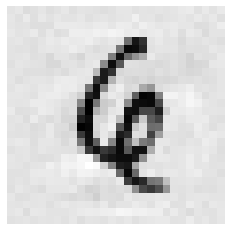

[1982] (예측값)5 (실제값)6


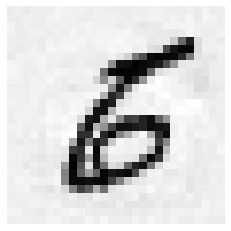

[1984] (예측값)0 (실제값)2


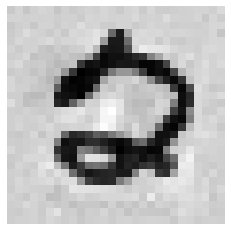

[1986] (예측값)9 (실제값)1


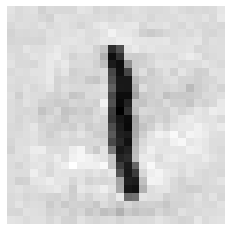

[1992] (예측값)6 (실제값)9


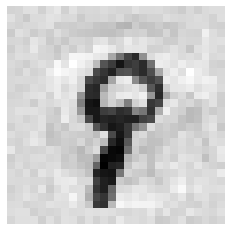

[1993] (예측값)7 (실제값)1


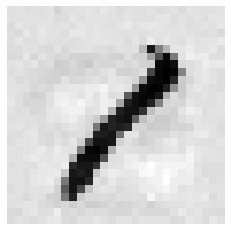

[1995] (예측값)9 (실제값)0


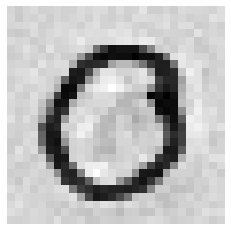

[1998] (예측값)2 (실제값)9


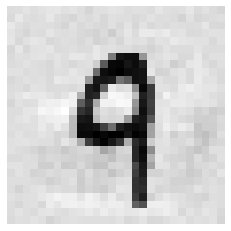

[1999] (예측값)3 (실제값)5


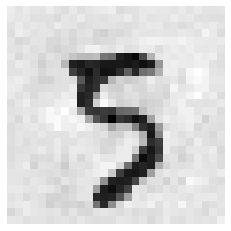

[2000] (예측값)4 (실제값)6


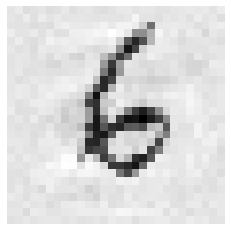

[2003] (예측값)8 (실제값)5


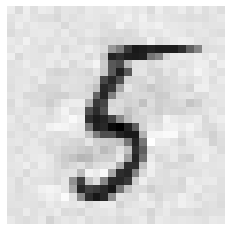

[2004] (예측값)9 (실제값)8


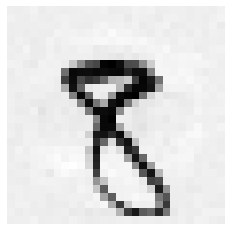

[2008] (예측값)4 (실제값)3


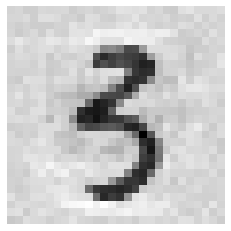

[2010] (예측값)6 (실제값)1


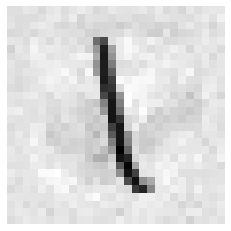

[2011] (예측값)7 (실제값)3


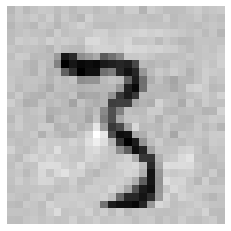

[2013] (예측값)9 (실제값)1


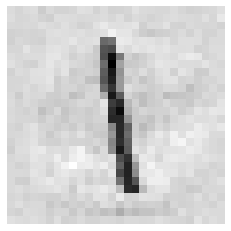

[2014] (예측값)0 (실제값)9


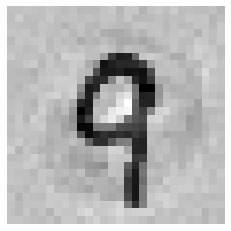

[2016] (예측값)2 (실제값)7


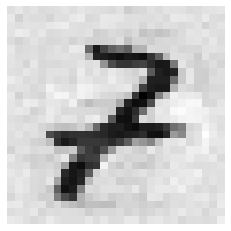

[2017] (예측값)4 (실제값)1


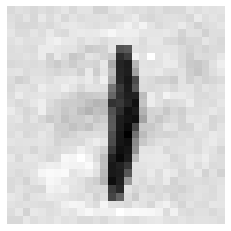

[2018] (예측값)8 (실제값)1


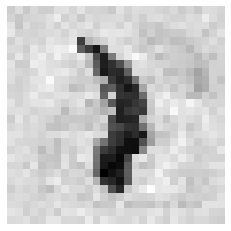

[2019] (예측값)4 (실제값)9


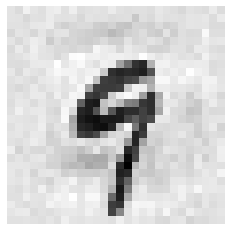

[2022] (예측값)9 (실제값)4


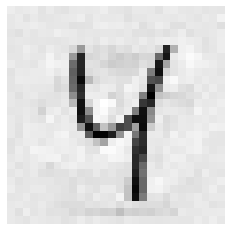

[2028] (예측값)5 (실제값)7


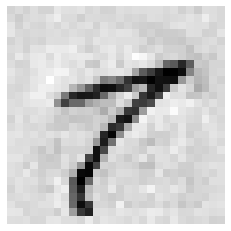

[2029] (예측값)6 (실제값)5


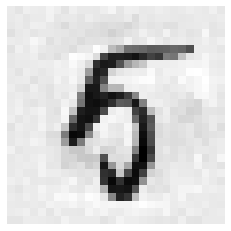

[2035] (예측값)3 (실제값)5


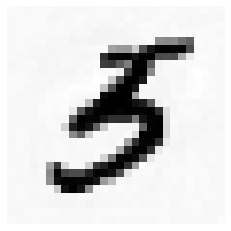

[2038] (예측값)7 (실제값)8


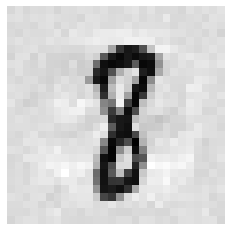

[2040] (예측값)9 (실제값)5


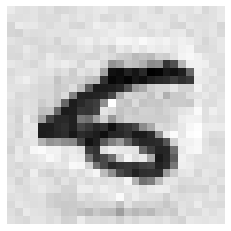

[2041] (예측값)7 (실제값)1


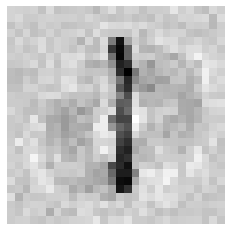

[2043] (예측값)2 (실제값)4


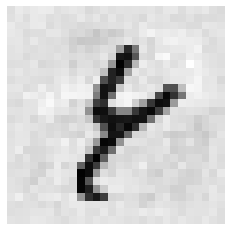

[2044] (예측값)7 (실제값)2


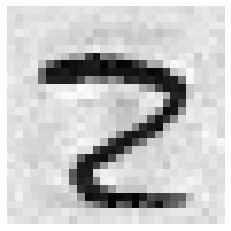

[2048] (예측값)9 (실제값)7


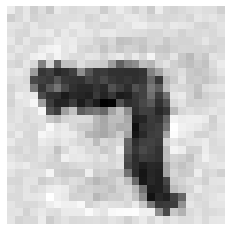

[2049] (예측값)0 (실제값)9


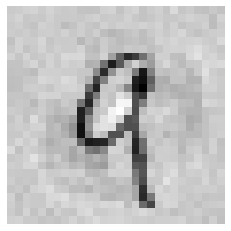

[2052] (예측값)7 (실제값)8


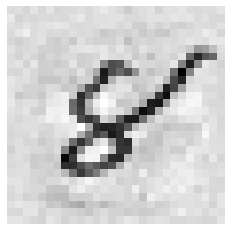

[2053] (예측값)5 (실제값)4


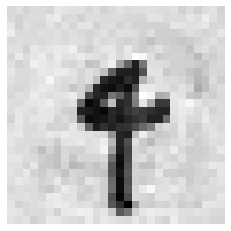

[2054] (예측값)6 (실제값)9


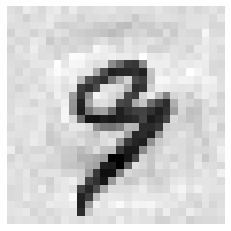

[2056] (예측값)9 (실제값)8


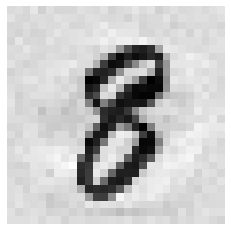

[2059] (예측값)2 (실제값)7


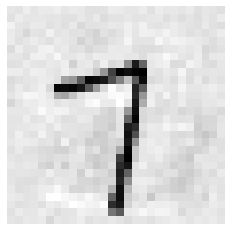

[2063] (예측값)6 (실제값)7


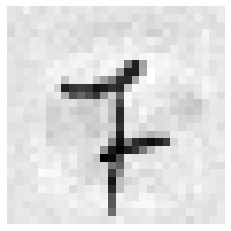

[2064] (예측값)7 (실제값)5


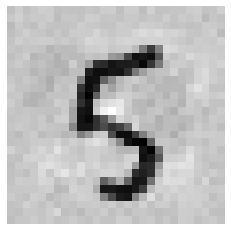

[2067] (예측값)5 (실제값)0


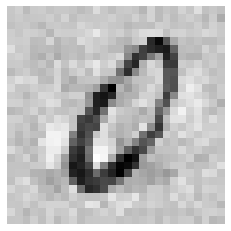

[2068] (예측값)2 (실제값)9


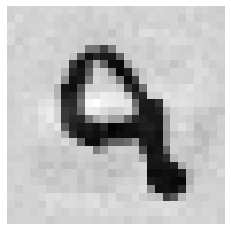

[2070] (예측값)5 (실제값)7


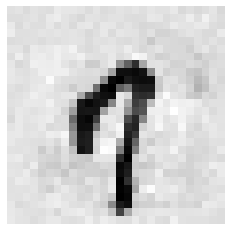

[2073] (예측값)8 (실제값)5


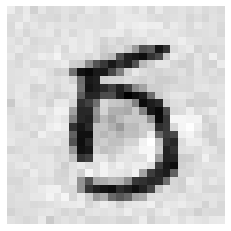

[2074] (예측값)9 (실제값)4


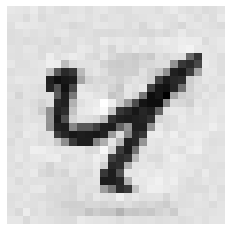

[2081] (예측값)6 (실제값)0


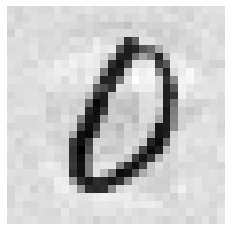

[2091] (예측값)6 (실제값)7


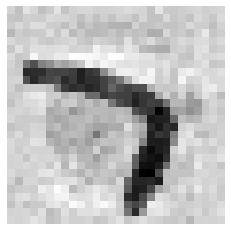

[2093] (예측값)9 (실제값)8


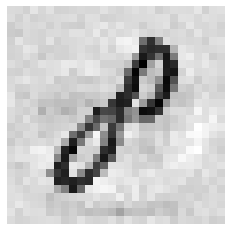

[2094] (예측값)0 (실제값)4


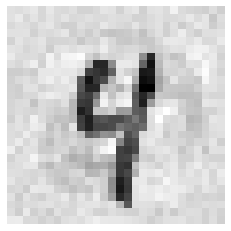

[2095] (예측값)2 (실제값)7


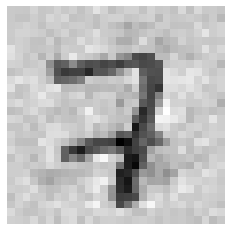

[2097] (예측값)3 (실제값)6


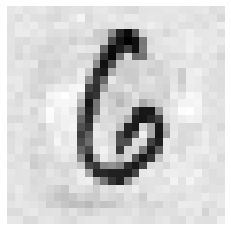

[2098] (예측값)0 (실제값)2


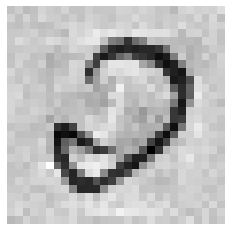

[2104] (예측값)2 (실제값)7


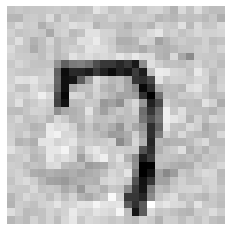

[2105] (예측값)8 (실제값)3


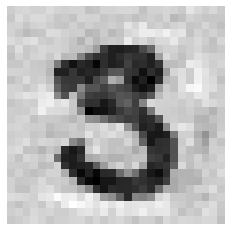

[2109] (예측값)6 (실제값)3


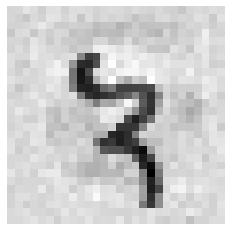

[2115] (예측값)5 (실제값)7


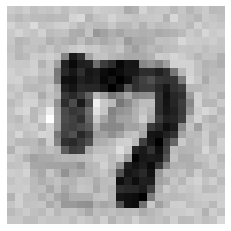

[2118] (예측값)0 (실제값)6


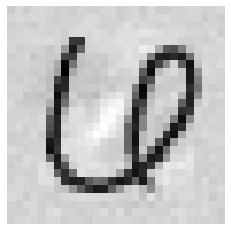

[2119] (예측값)9 (실제값)8


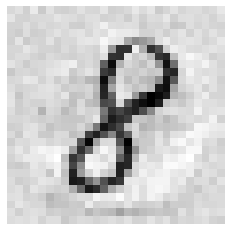

[2120] (예측값)0 (실제값)4


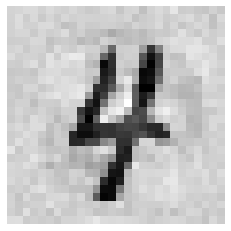

[2122] (예측값)3 (실제값)2


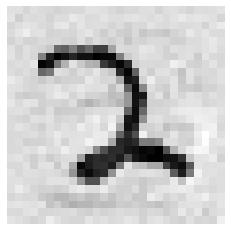

[2123] (예측값)4 (실제값)7


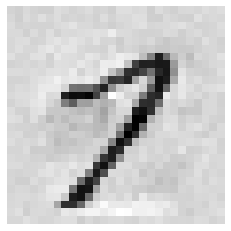

[2125] (예측값)6 (실제값)5


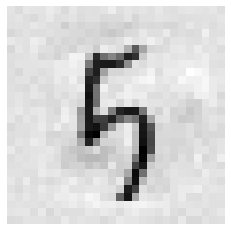

[2129] (예측값)0 (실제값)9


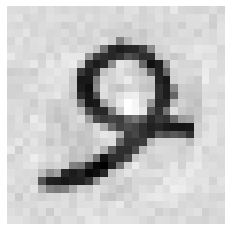

[2131] (예측값)2 (실제값)6


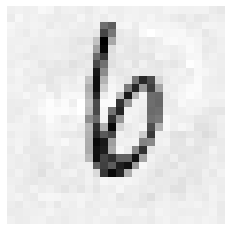

[2132] (예측값)3 (실제값)7


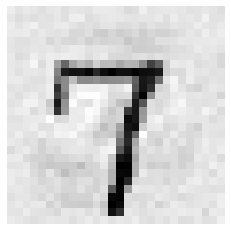

[2135] (예측값)7 (실제값)6


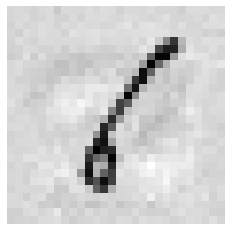

[2137] (예측값)9 (실제값)1


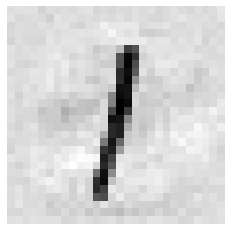

[2141] (예측값)3 (실제값)7


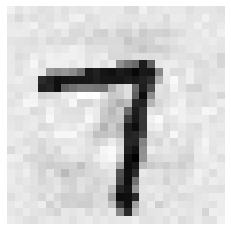

[2147] (예측값)0 (실제값)9


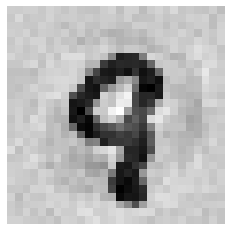

[2153] (예측값)6 (실제값)3


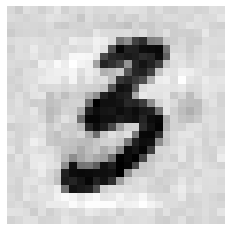

[2156] (예측값)9 (실제값)6


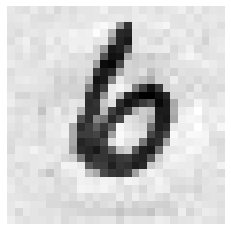

[2160] (예측값)3 (실제값)6


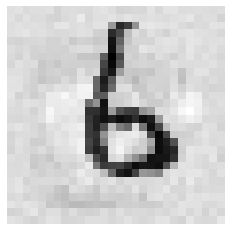

[2161] (예측값)4 (실제값)9


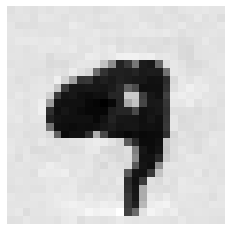

[2162] (예측값)6 (실제값)5


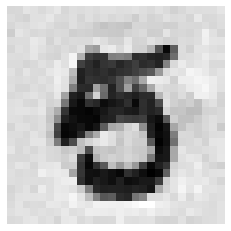

[2165] (예측값)9 (실제값)4


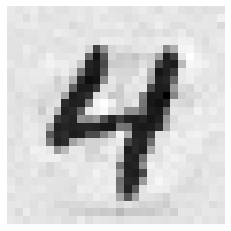

[2166] (예측값)9 (실제값)1


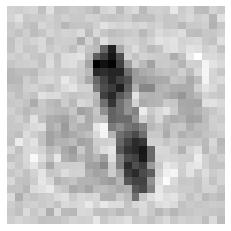

[2172] (예측값)6 (실제값)8


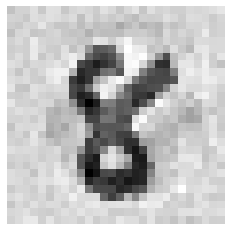

[2174] (예측값)8 (실제값)3


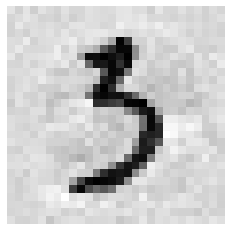

[2175] (예측값)9 (실제값)1


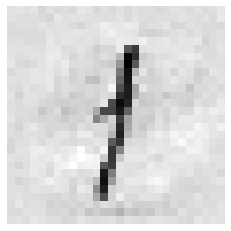

[2179] (예측값)3 (실제값)8


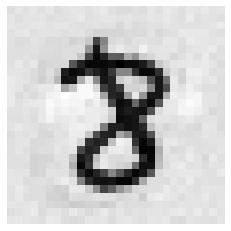

[2182] (예측값)2 (실제값)1


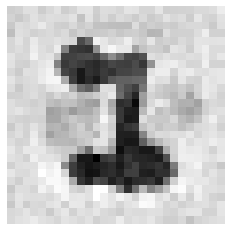

[2186] (예측값)0 (실제값)2


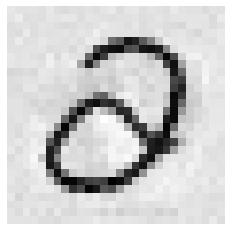

[2189] (예측값)3 (실제값)9


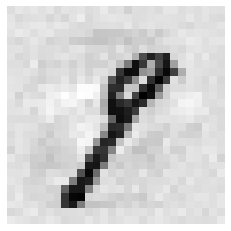

[2194] (예측값)5 (실제값)6


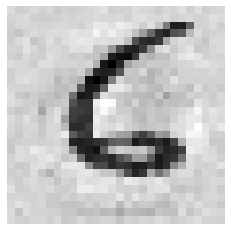

[2195] (예측값)2 (실제값)7


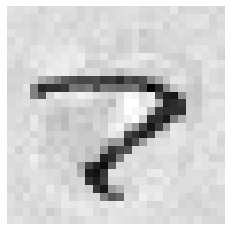

[2198] (예측값)3 (실제값)2


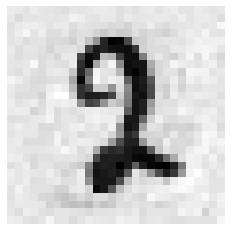

[2199] (예측값)4 (실제값)6


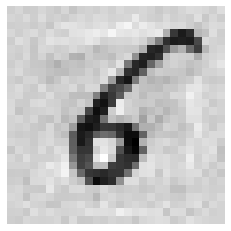

[2200] (예측값)6 (실제값)2


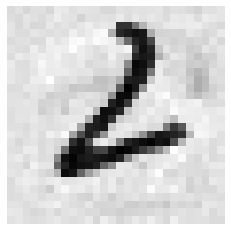

[2202] (예측값)9 (실제값)4


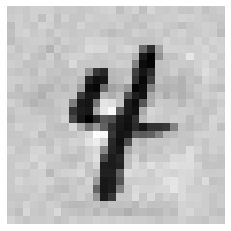

[2203] (예측값)9 (실제값)8


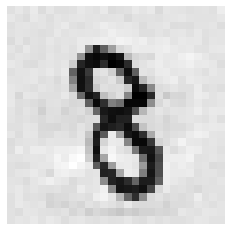

[2209] (예측값)5 (실제값)0


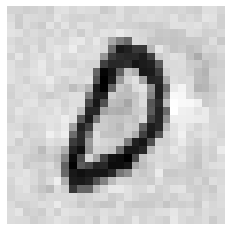

[2210] (예측값)7 (실제값)6


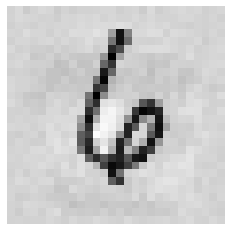

[2212] (예측값)2 (실제값)9


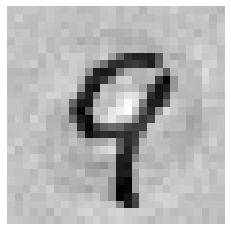

[2215] (예측값)5 (실제값)6


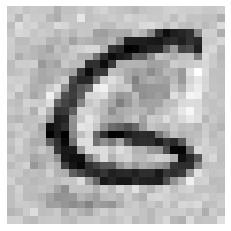

[2216] (예측값)4 (실제값)9


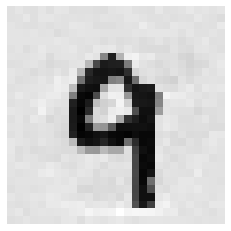

[2221] (예측값)9 (실제값)1


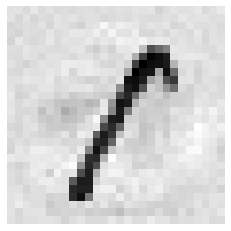

[2224] (예측값)8 (실제값)5


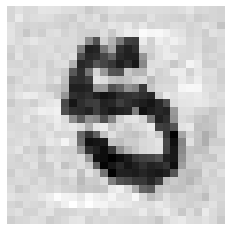

[2225] (예측값)3 (실제값)8


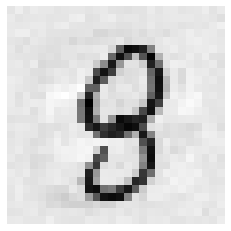

[2227] (예측값)5 (실제값)9


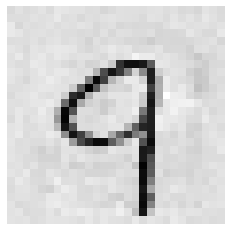

[2228] (예측값)6 (실제값)1


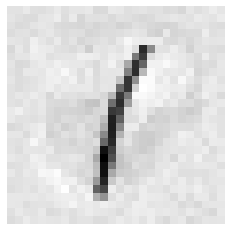

[2232] (예측값)0 (실제값)9


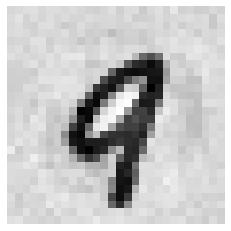

[2234] (예측값)2 (실제값)7


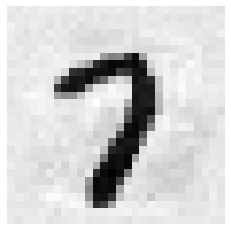

[2235] (예측값)3 (실제값)1


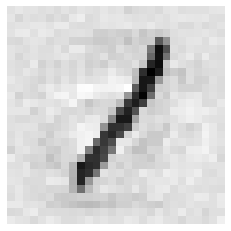

[2239] (예측값)9 (실제값)1


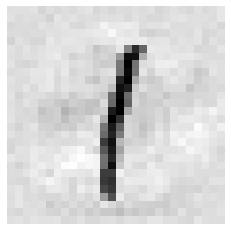

[2242] (예측값)3 (실제값)2


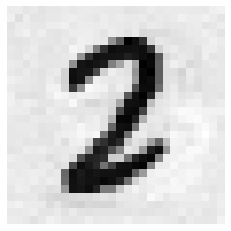

[2244] (예측값)5 (실제값)9


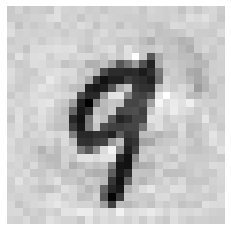

[2245] (예측값)6 (실제값)1


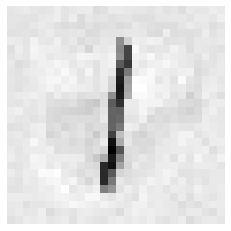

[2249] (예측값)9 (실제값)4


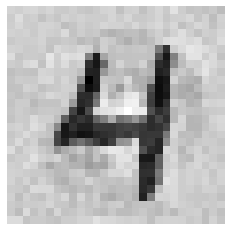

[2250] (예측값)4 (실제값)9


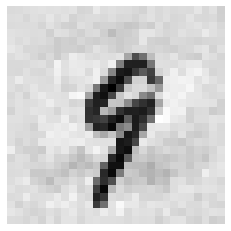

[2251] (예측값)2 (실제값)4


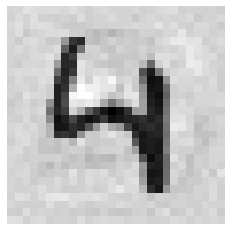

[2252] (예측값)3 (실제값)7


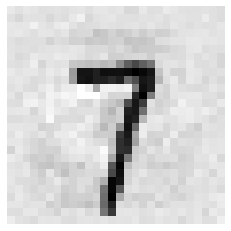

[2255] (예측값)6 (실제값)3


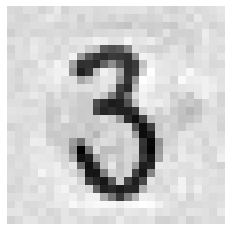

[2257] (예측값)8 (실제값)9


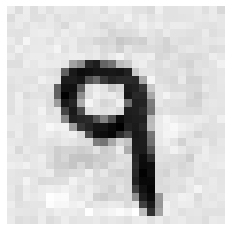

[2258] (예측값)9 (실제값)1


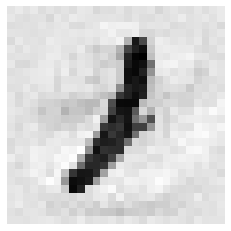

[2261] (예측값)2 (실제값)1


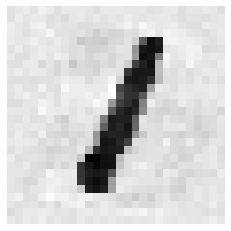

[2262] (예측값)3 (실제값)7


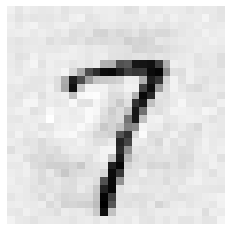

[2263] (예측값)4 (실제값)9


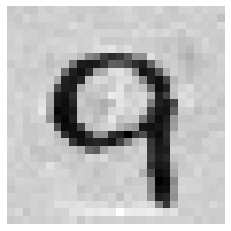

[2264] (예측값)5 (실제값)4


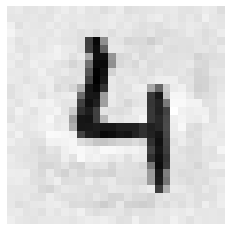

[2265] (예측값)6 (실제값)4


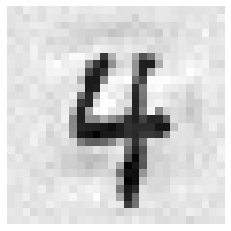

[2266] (예측값)7 (실제값)1


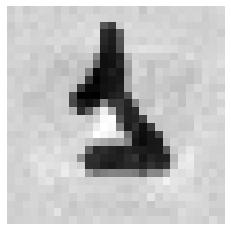

[2268] (예측값)9 (실제값)7


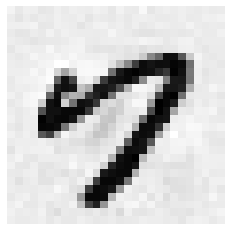

[2273] (예측값)4 (실제값)1


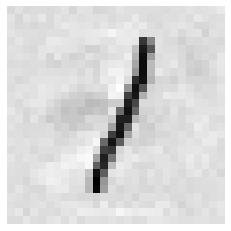

[2275] (예측값)6 (실제값)7


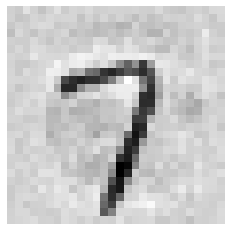

[2277] (예측값)8 (실제값)1


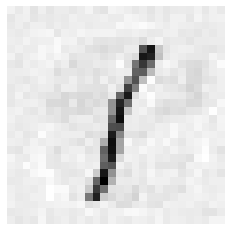

[2282] (예측값)3 (실제값)5


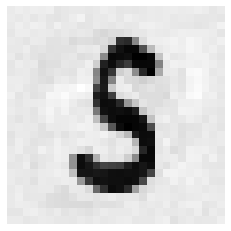

[2283] (예측값)4 (실제값)1


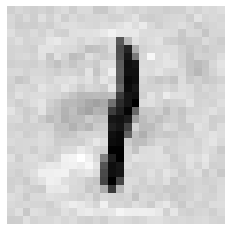

[2284] (예측값)5 (실제값)3


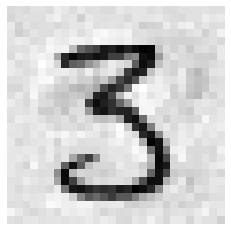

[2285] (예측값)2 (실제값)7


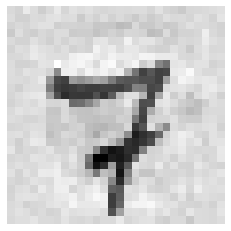

[2286] (예측값)7 (실제값)6


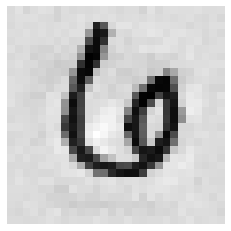

[2292] (예측값)3 (실제값)9


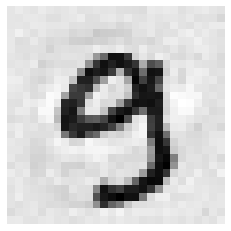

[2293] (예측값)6 (실제값)9


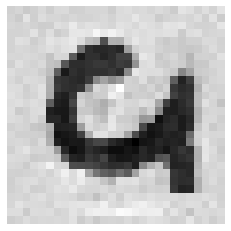

[2294] (예측값)5 (실제값)0


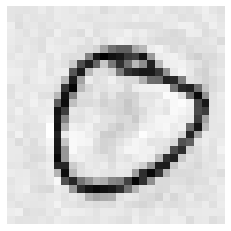

[2295] (예측값)6 (실제값)0


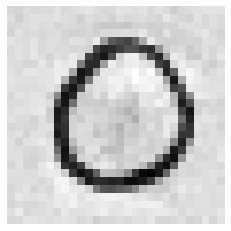

[2296] (예측값)7 (실제값)2


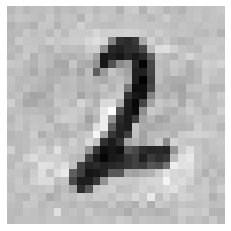

[2298] (예측값)0 (실제값)8


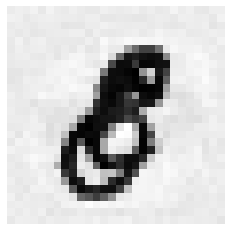

[2299] (예측값)7 (실제값)2


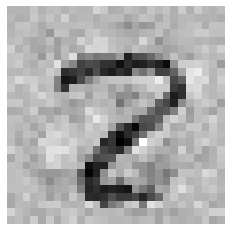

[2300] (예측값)2 (실제값)3


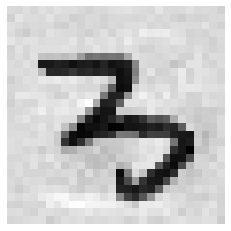

[2301] (예측값)3 (실제값)7


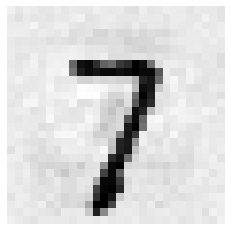

[2302] (예측값)4 (실제값)1


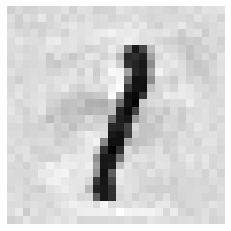

[2304] (예측값)6 (실제값)0


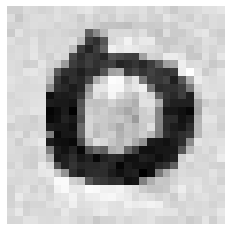

[2306] (예측값)8 (실제값)4


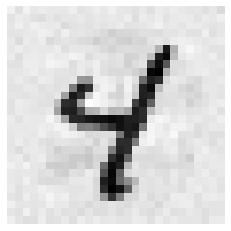

[2307] (예측값)9 (실제값)4


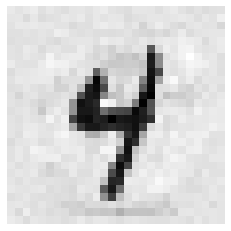

[2308] (예측값)5 (실제값)3


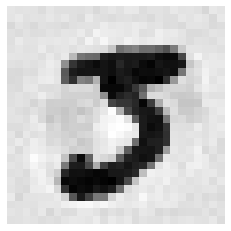

[2310] (예측값)2 (실제값)9


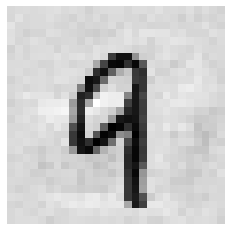

[2311] (예측값)3 (실제값)2


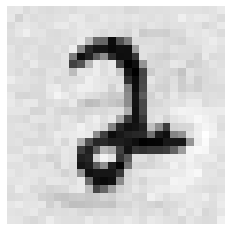

[2312] (예측값)4 (실제값)3


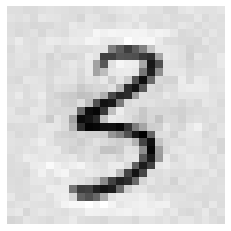

[2313] (예측값)5 (실제값)9


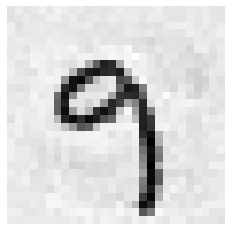

[2314] (예측값)2 (실제값)7


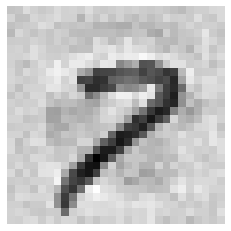

[2320] (예측값)8 (실제값)9


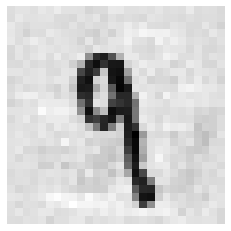

[2325] (예측값)8 (실제값)7


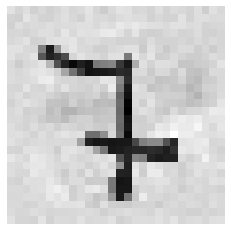

[2330] (예측값)3 (실제값)4


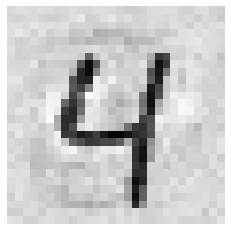

[2332] (예측값)5 (실제값)7


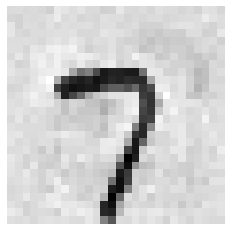

[2333] (예측값)6 (실제값)0


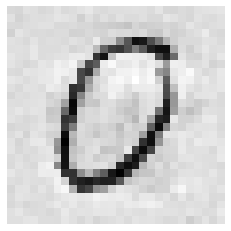

[2334] (예측값)8 (실제값)7


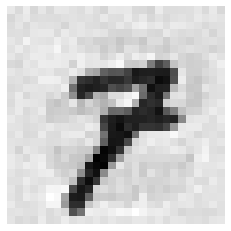

[2335] (예측값)9 (실제값)1


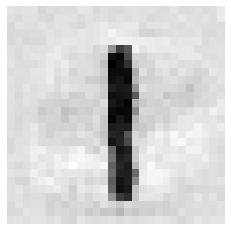

[2336] (예측값)0 (실제값)4


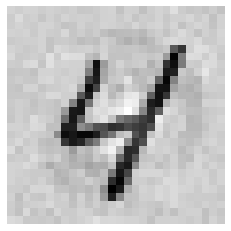

[2338] (예측값)2 (실제값)4


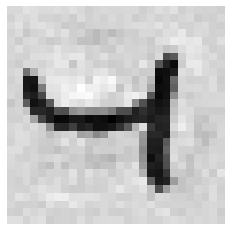

[2343] (예측값)8 (실제값)1


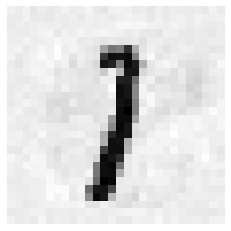

[2345] (예측값)0 (실제값)9


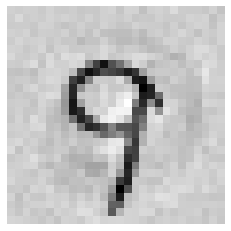

[2348] (예측값)4 (실제값)3


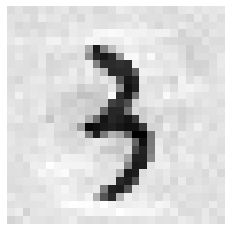

[2350] (예측값)6 (실제값)2


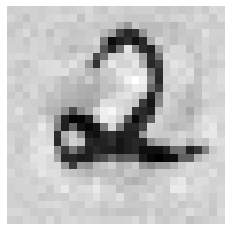

[2356] (예측값)3 (실제값)1


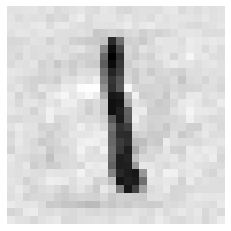

[2357] (예측값)4 (실제값)1


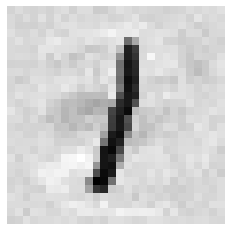

[2358] (예측값)5 (실제값)1


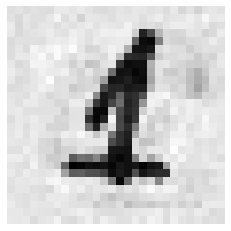

[2361] (예측값)8 (실제값)9


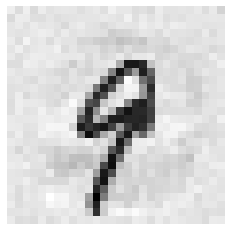

[2362] (예측값)9 (실제값)8


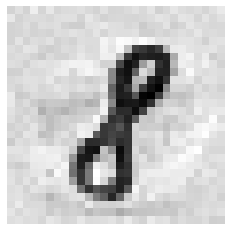

[2363] (예측값)9 (실제값)4


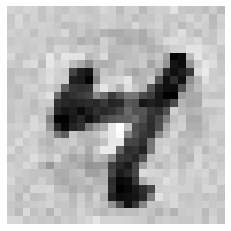

[2365] (예측값)2 (실제값)7


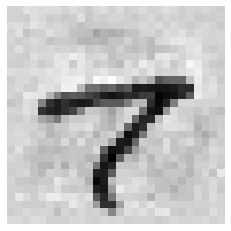

[2366] (예측값)3 (실제값)1


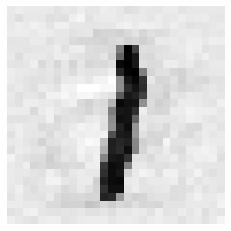

[2369] (예측값)6 (실제값)5


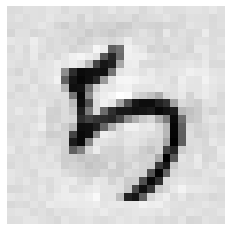

[2372] (예측값)9 (실제값)7


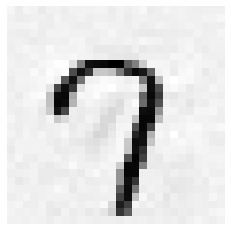

[2373] (예측값)0 (실제값)4


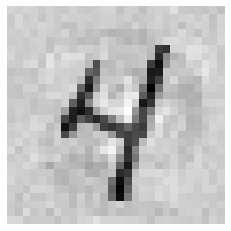

[2375] (예측값)2 (실제값)4


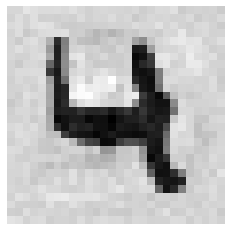

[2377] (예측값)4 (실제값)7


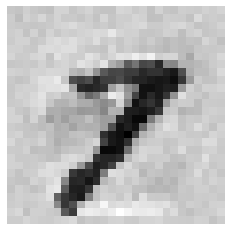

[2378] (예측값)5 (실제값)0


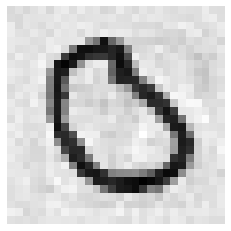

[2380] (예측값)0 (실제값)9


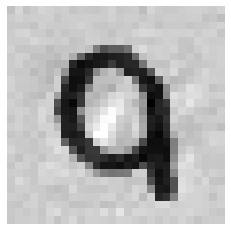

[2381] (예측값)9 (실제값)8


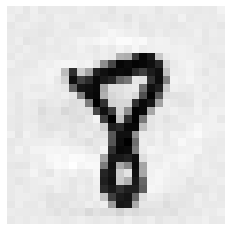

[2382] (예측값)0 (실제값)8


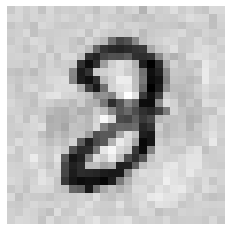

[2384] (예측값)2 (실제값)0


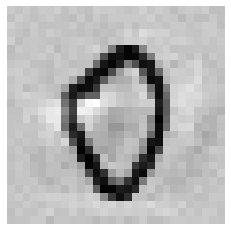

[2387] (예측값)6 (실제값)9


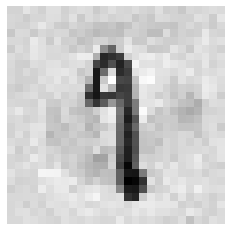

[2388] (예측값)0 (실제값)6


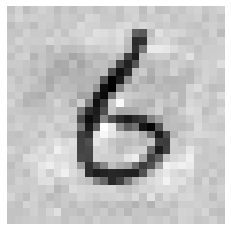

[2393] (예측값)3 (실제값)8


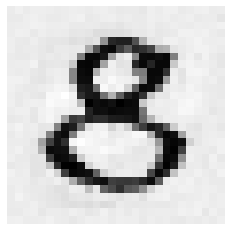

[2395] (예측값)3 (실제값)8


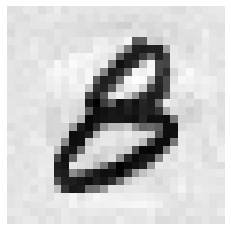

[2397] (예측값)8 (실제값)2


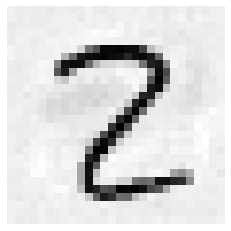

[2398] (예측값)9 (실제값)1


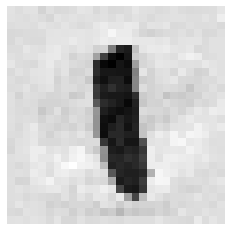

[2400] (예측값)3 (실제값)5


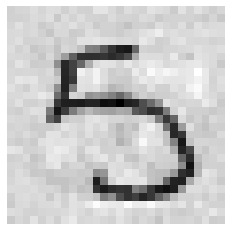

[2401] (예측값)2 (실제값)4


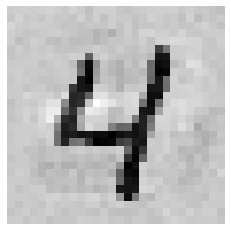

[2405] (예측값)6 (실제값)3


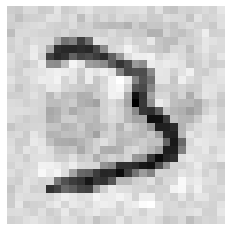

[2406] (예측값)7 (실제값)9


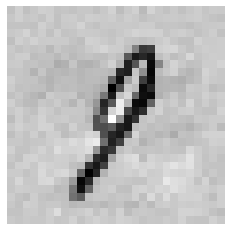

[2408] (예측값)9 (실제값)3


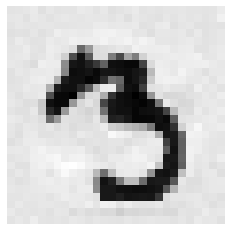

[2409] (예측값)0 (실제값)1


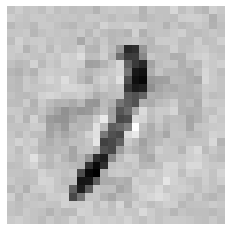

[2412] (예측값)3 (실제값)2


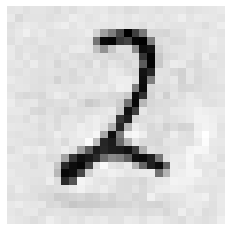

[2414] (예측값)8 (실제값)9


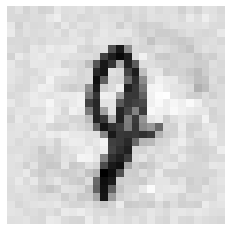

[2417] (예측값)5 (실제값)0


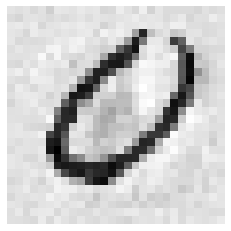

[2418] (예측값)9 (실제값)1


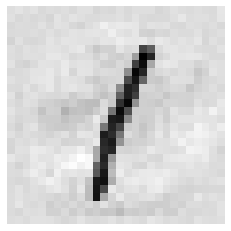

[2419] (예측값)0 (실제값)8


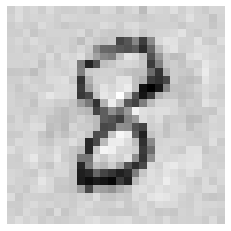

[2420] (예측값)2 (실제값)9


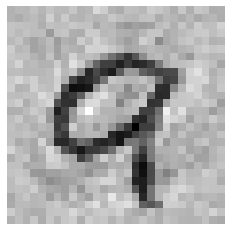

[2422] (예측값)7 (실제값)6


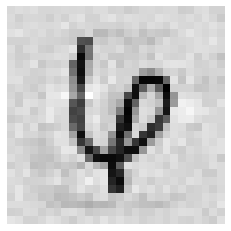

[2424] (예측값)5 (실제값)3


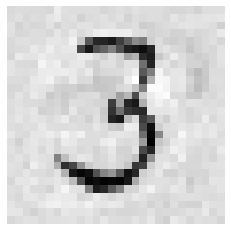

[2425] (예측값)6 (실제값)8


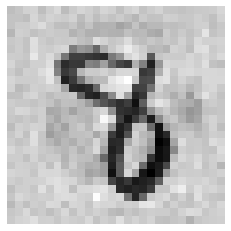

[2426] (예측값)7 (실제값)9


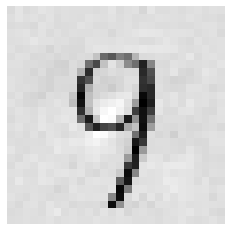

[2432] (예측값)3 (실제값)2


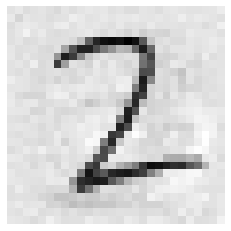

[2433] (예측값)1 (실제값)2


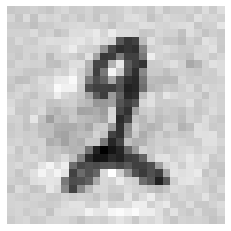

[2435] (예측값)6 (실제값)0


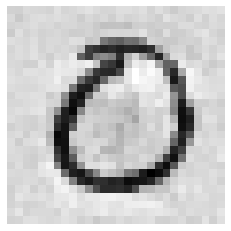

[2437] (예측값)8 (실제값)2


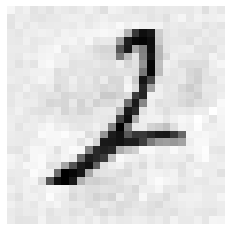

[2438] (예측값)5 (실제값)9


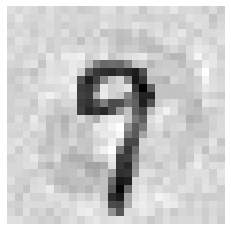

[2440] (예측값)2 (실제값)4


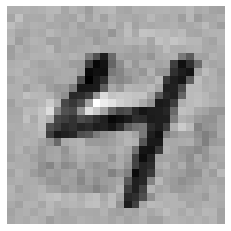

[2441] (예측값)4 (실제값)3


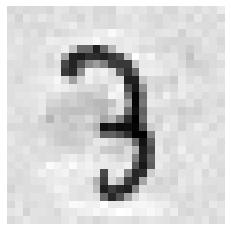

[2444] (예측값)7 (실제값)1


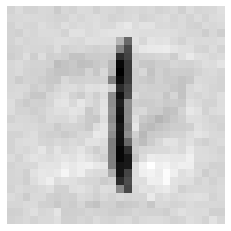

[2447] (예측값)0 (실제값)4


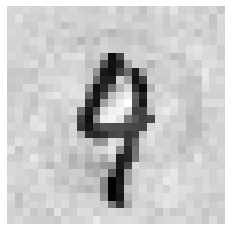

[2448] (예측값)8 (실제값)9


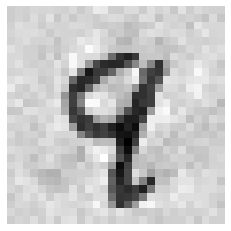

[2449] (예측값)2 (실제값)0


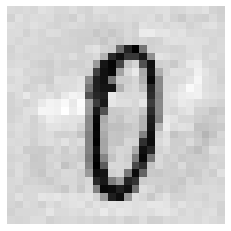

[2454] (예측값)8 (실제값)6


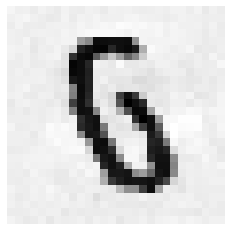

[2455] (예측값)9 (실제값)0


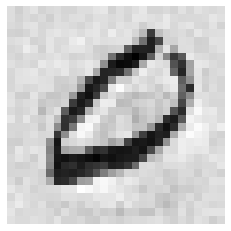

[2456] (예측값)5 (실제값)9


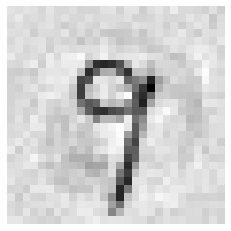

[2459] (예측값)3 (실제값)2


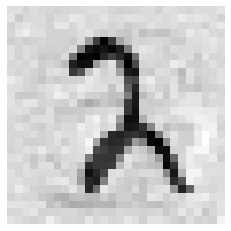

[2460] (예측값)4 (실제값)5


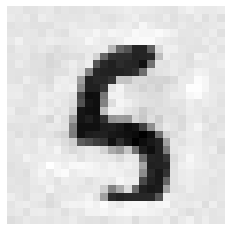

[2461] (예측값)5 (실제값)0


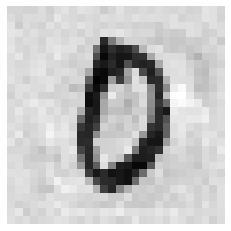

[2464] (예측값)9 (실제값)4


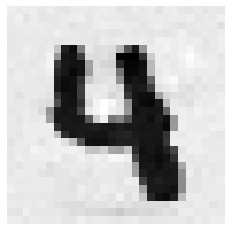

[2470] (예측값)5 (실제값)8


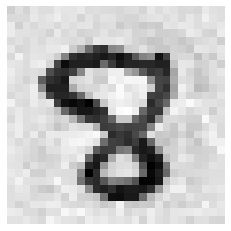

[2472] (예측값)8 (실제값)9


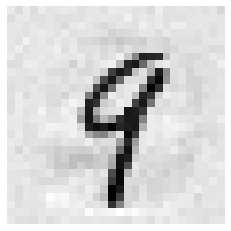

[2473] (예측값)8 (실제값)1


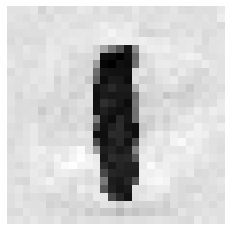

[2478] (예측값)4 (실제값)9


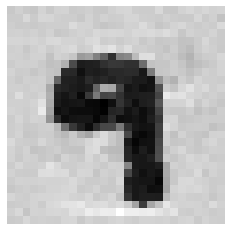

[2479] (예측값)5 (실제값)0


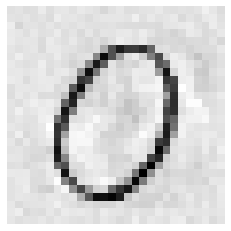

[2480] (예측값)6 (실제값)7


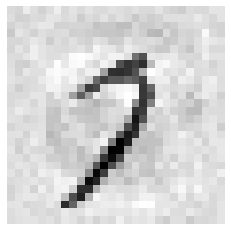

[2483] (예측값)9 (실제값)6


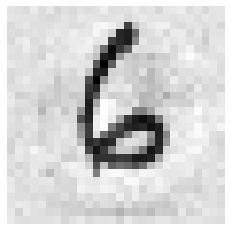

[2485] (예측값)2 (실제값)0


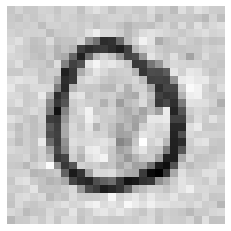

[2488] (예측값)4 (실제값)2


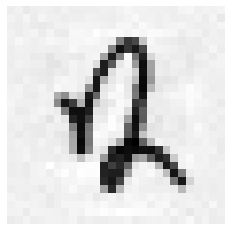

[2490] (예측값)6 (실제값)7


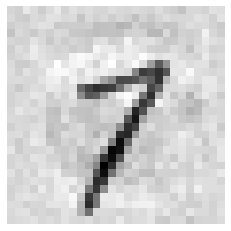

[2493] (예측값)0 (실제값)9


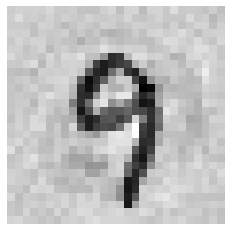

[2494] (예측값)8 (실제값)9


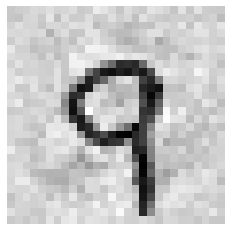

[2496] (예측값)3 (실제값)2


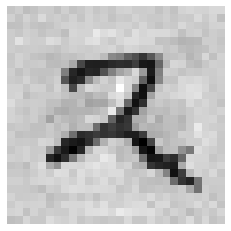

[2497] (예측값)4 (실제값)9


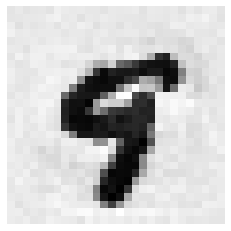

[2499] (예측값)9 (실제값)4


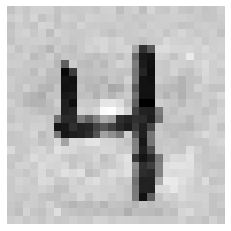

[2504] (예측값)2 (실제값)1


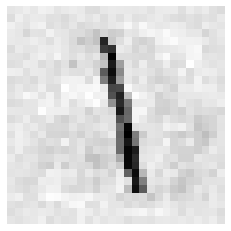

[2508] (예측값)7 (실제값)6


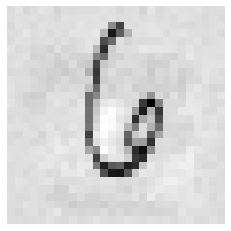

[2509] (예측값)8 (실제값)4


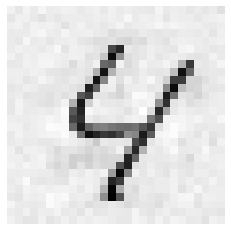

[2510] (예측값)9 (실제값)1


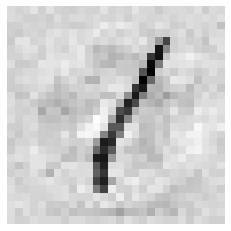

[2512] (예측값)3 (실제값)8


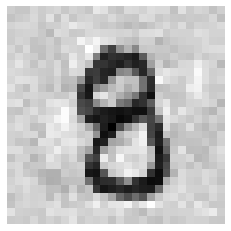

[2521] (예측값)0 (실제값)7


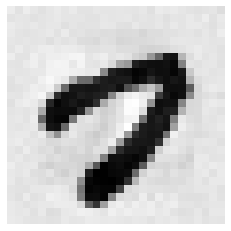

[2523] (예측값)2 (실제값)7


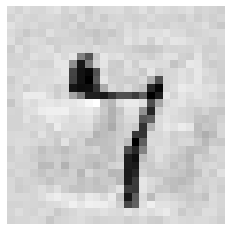

[2524] (예측값)3 (실제값)1


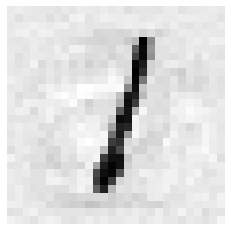

[2525] (예측값)9 (실제값)5


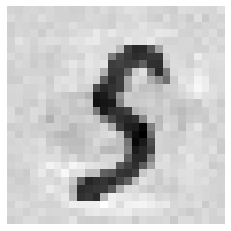

[2528] (예측값)8 (실제값)9


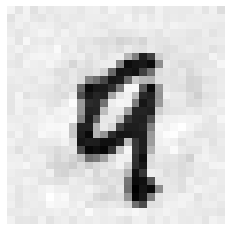

[2529] (예측값)9 (실제값)1


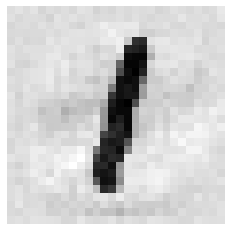

[2530] (예측값)0 (실제값)4


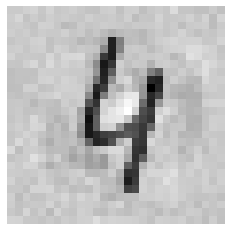

[2532] (예측값)2 (실제값)6


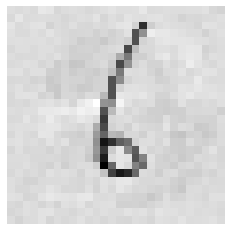

[2534] (예측값)5 (실제값)3


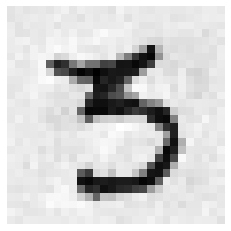

[2537] (예측값)9 (실제값)4


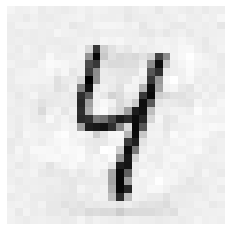

[2544] (예측값)6 (실제값)9


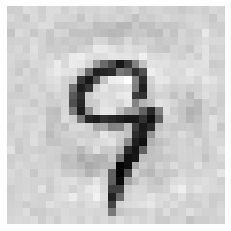

[2545] (예측값)3 (실제값)5


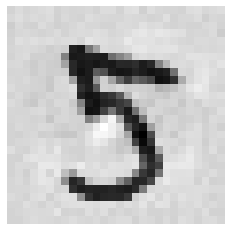

[2548] (예측값)0 (실제값)9


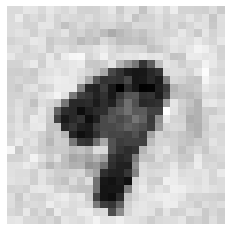

[2550] (예측값)3 (실제값)8


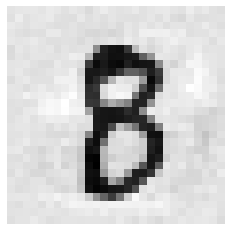

[2559] (예측값)3 (실제값)5


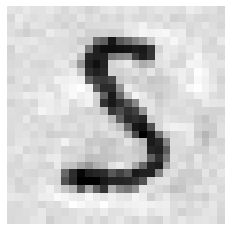

[2562] (예측값)9 (실제값)6


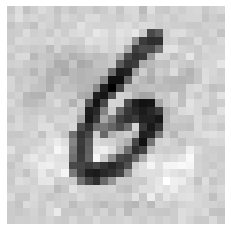

[2564] (예측값)9 (실제값)7


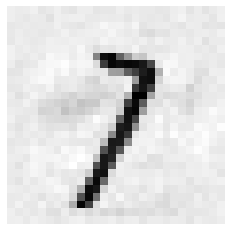

[2568] (예측값)3 (실제값)0


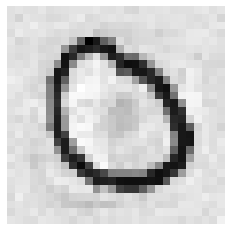

[2571] (예측값)6 (실제값)0


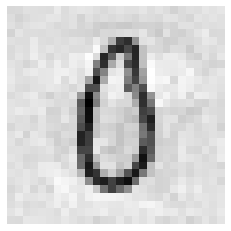

[2573] (예측값)8 (실제값)5


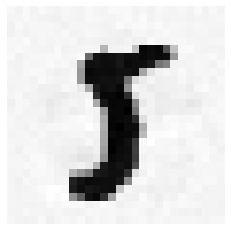

[2574] (예측값)9 (실제값)5


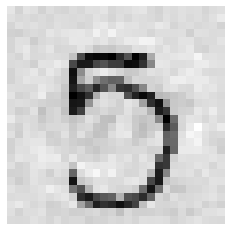

[2576] (예측값)2 (실제값)1


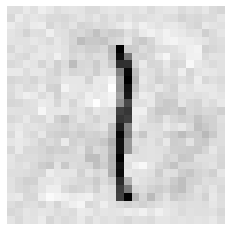

[2577] (예측값)3 (실제값)7


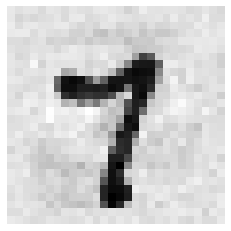

[2580] (예측값)0 (실제값)6


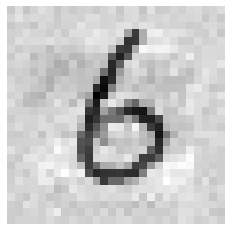

[2582] (예측값)0 (실제값)9


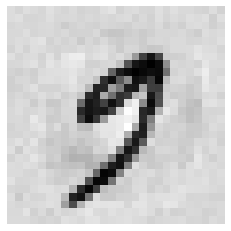

[2584] (예측값)2 (실제값)8


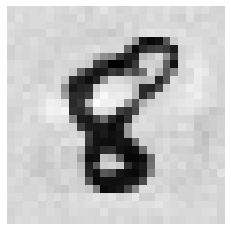

[2585] (예측값)3 (실제값)9


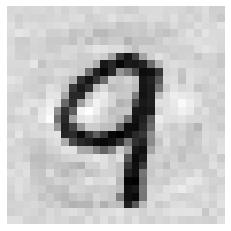

[2587] (예측값)5 (실제값)3


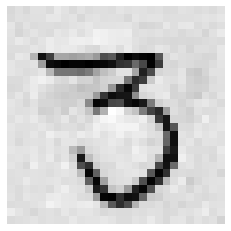

[2590] (예측값)8 (실제값)1


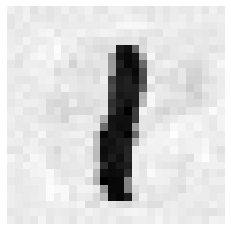

[2598] (예측값)7 (실제값)8


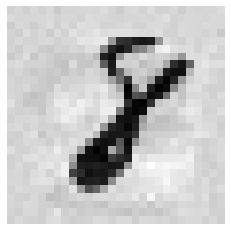

[2601] (예측값)0 (실제값)6


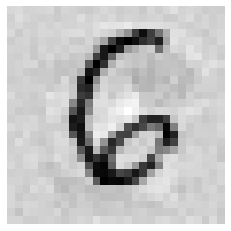

[2604] (예측값)3 (실제값)5


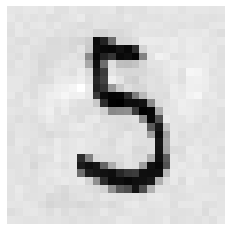

[2607] (예측값)8 (실제값)7


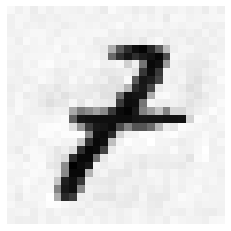

[2608] (예측값)9 (실제값)8


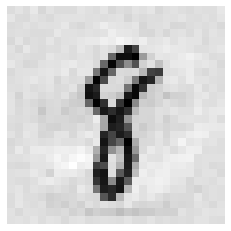

[2609] (예측값)0 (실제값)6


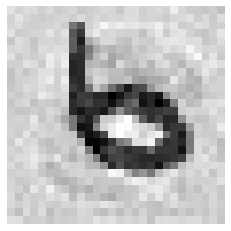

[2611] (예측값)2 (실제값)5


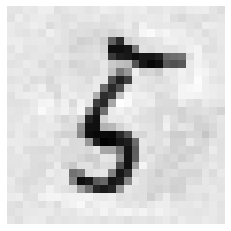

[2612] (예측값)3 (실제값)1


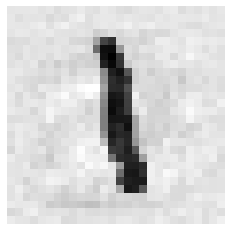

[2613] (예측값)5 (실제값)4


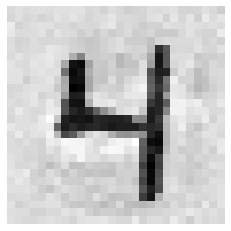

[2617] (예측값)9 (실제값)8


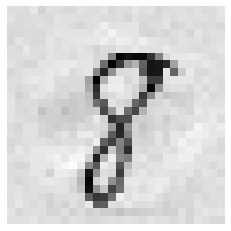

[2619] (예측값)2 (실제값)0


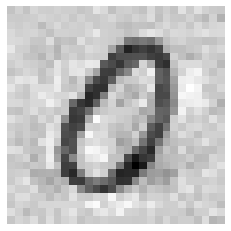

[2624] (예측값)8 (실제값)3


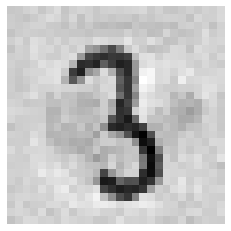

[2627] (예측값)9 (실제값)0


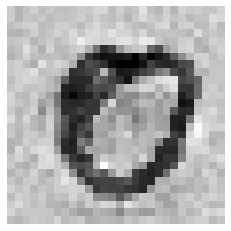

[2628] (예측값)0 (실제값)7


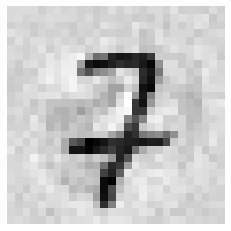

[2630] (예측값)8 (실제값)4


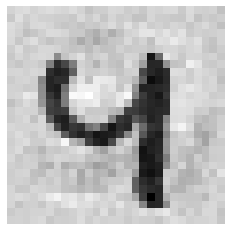

[2633] (예측값)5 (실제값)9


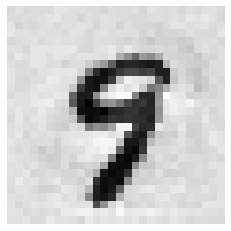

[2635] (예측값)7 (실제값)2


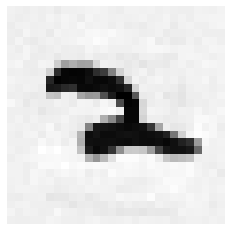

[2638] (예측값)6 (실제값)0


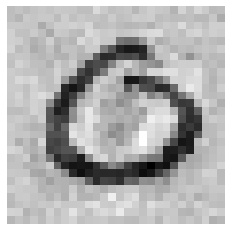

[2642] (예측값)5 (실제값)7


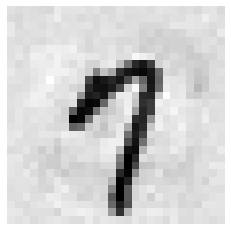

[2643] (예측값)0 (실제값)6


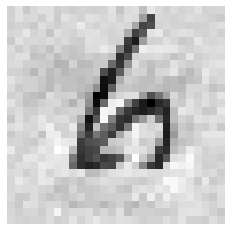

[2645] (예측값)9 (실제값)4


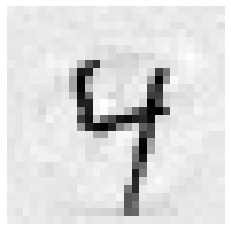

[2648] (예측값)5 (실제값)9


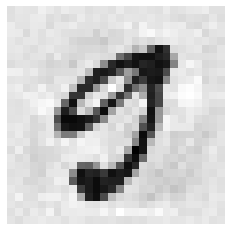

[2651] (예측값)5 (실제값)6


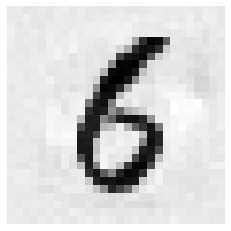

[2652] (예측값)6 (실제값)2


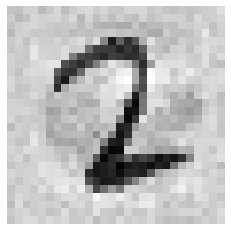

[2654] (예측값)1 (실제값)6


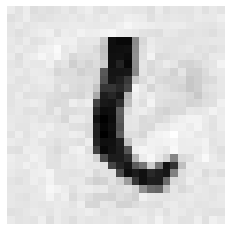

[2655] (예측값)9 (실제값)1


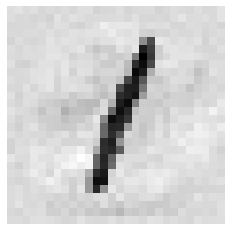

[2659] (예측값)3 (실제값)4


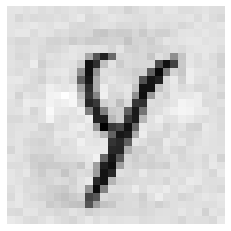

[2661] (예측값)5 (실제값)1


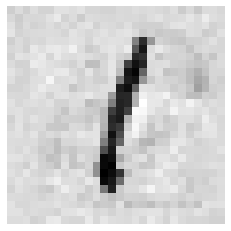

[2664] (예측값)8 (실제값)2


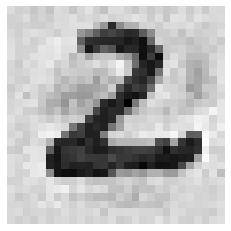

[2666] (예측값)2 (실제값)7


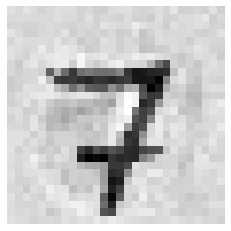

[2669] (예측값)3 (실제값)2


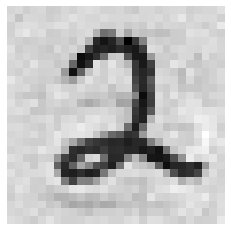

[2670] (예측값)6 (실제값)5


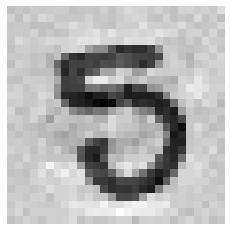

[2671] (예측값)8 (실제값)7


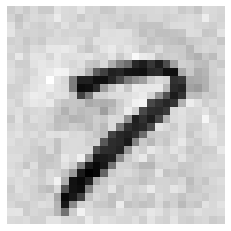

[2673] (예측값)8 (실제값)9


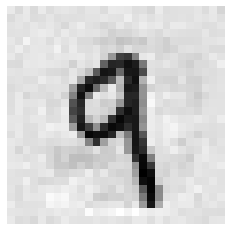

[2674] (예측값)9 (실제값)1


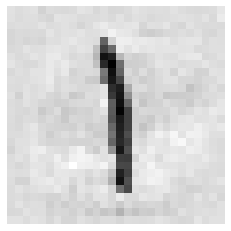

[2675] (예측값)9 (실제값)4


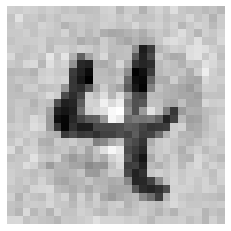

[2676] (예측값)2 (실제값)1


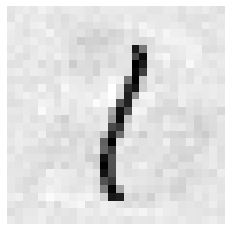

[2679] (예측값)6 (실제값)2


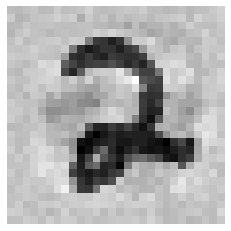

[2680] (예측값)7 (실제값)4


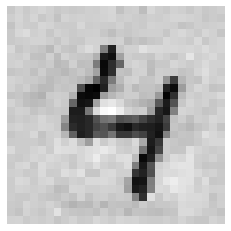

[2683] (예측값)5 (실제값)4


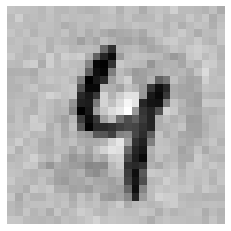

[2684] (예측값)1 (실제값)3


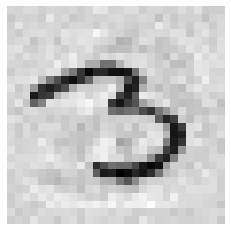

[2688] (예측값)5 (실제값)1


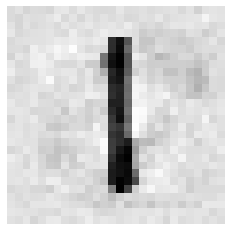

[2689] (예측값)6 (실제값)5


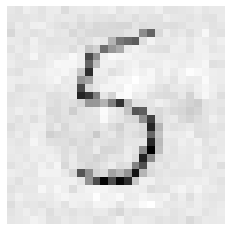

[2692] (예측값)5 (실제값)9


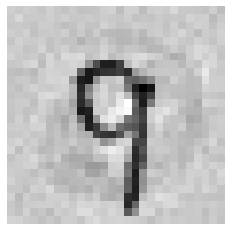

[2694] (예측값)3 (실제값)9


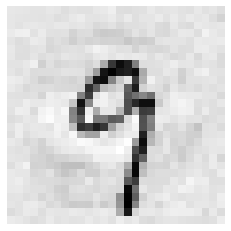

[2698] (예측값)7 (실제값)5


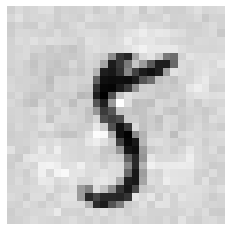

[2699] (예측값)8 (실제값)2


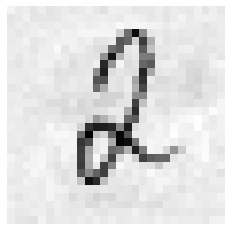

[2701] (예측값)5 (실제값)4


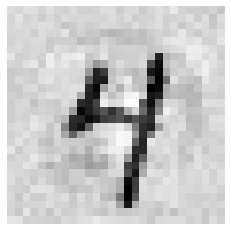

[2703] (예측값)2 (실제값)0


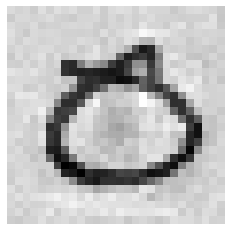

[2704] (예측값)3 (실제값)1


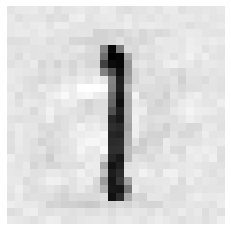

[2705] (예측값)4 (실제값)1


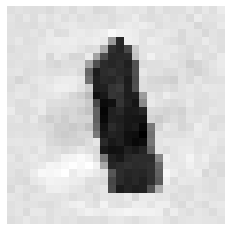

[2708] (예측값)7 (실제값)4


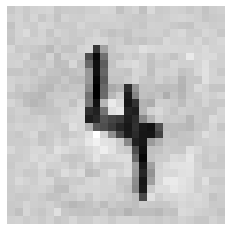

[2710] (예측값)9 (실제값)7


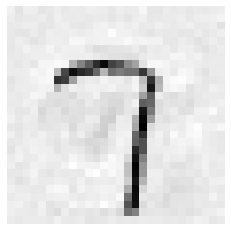

[2713] (예측값)2 (실제값)0


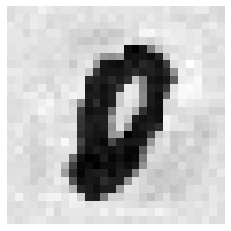

[2719] (예측값)9 (실제값)1


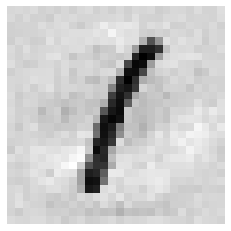

[2720] (예측값)0 (실제값)9


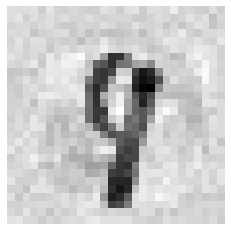

[2721] (예측값)2 (실제값)6


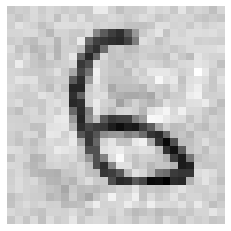

[2722] (예측값)2 (실제값)1


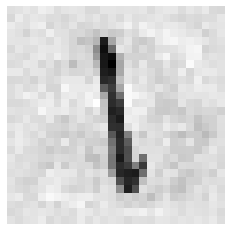

[2724] (예측값)5 (실제값)8


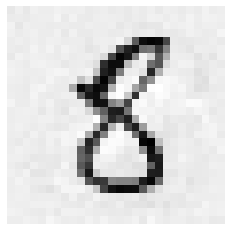

[2725] (예측값)6 (실제값)1


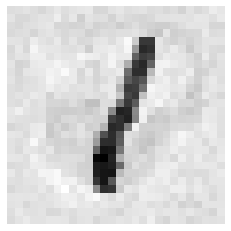

[2729] (예측값)0 (실제값)2


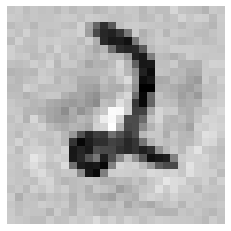

[2734] (예측값)5 (실제값)1


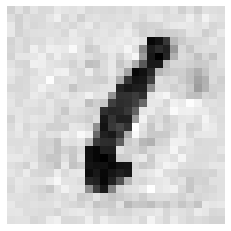

[2735] (예측값)6 (실제값)9


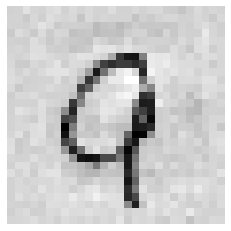

[2736] (예측값)2 (실제값)7


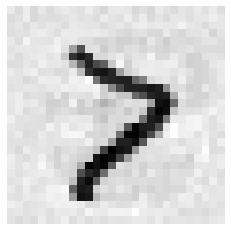

[2740] (예측값)2 (실제값)9


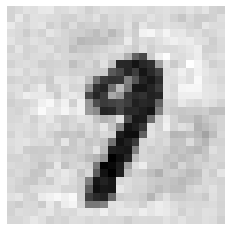

[2742] (예측값)4 (실제값)9


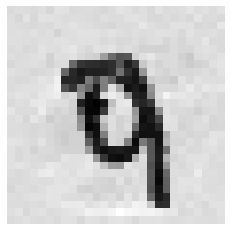

[2743] (예측값)6 (실제값)5


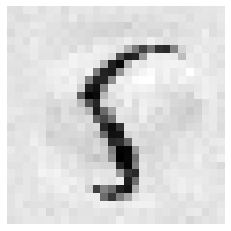

[2745] (예측값)8 (실제값)3


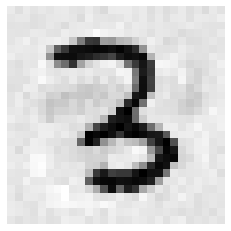

[2746] (예측값)9 (실제값)1


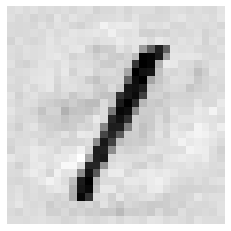

[2748] (예측값)2 (실제값)0


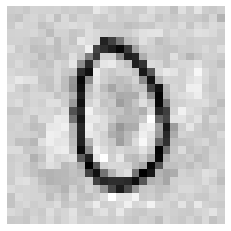

[2749] (예측값)5 (실제값)7


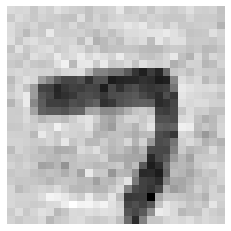

[2751] (예측값)4 (실제값)6


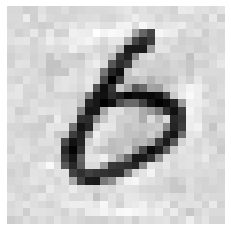

[2753] (예측값)6 (실제값)1


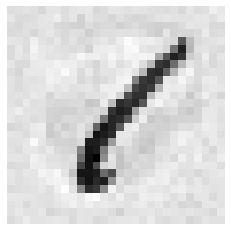

[2755] (예측값)8 (실제값)9


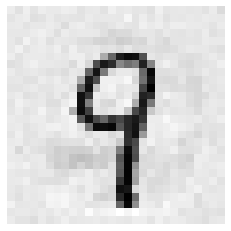

[2757] (예측값)7 (실제값)1


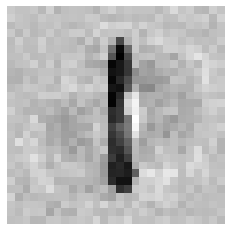

[2769] (예측값)2 (실제값)9


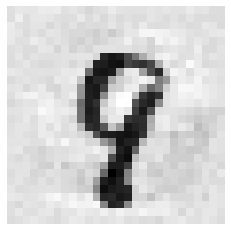

[2770] (예측값)2 (실제값)3


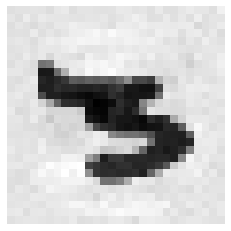

[2771] (예측값)5 (실제값)4


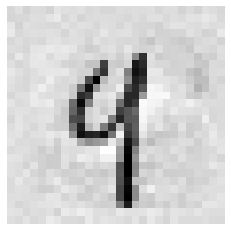

[2778] (예측값)3 (실제값)4


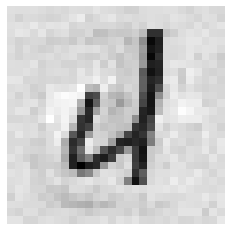

[2786] (예측값)2 (실제값)1


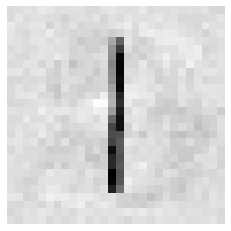

[2788] (예측값)4 (실제값)1


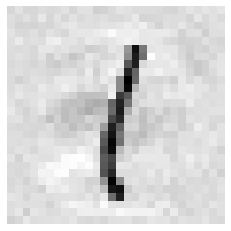

[2793] (예측값)9 (실제값)8


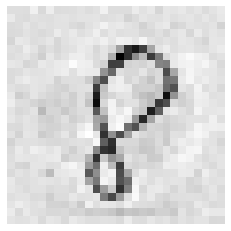

[2795] (예측값)1 (실제값)6


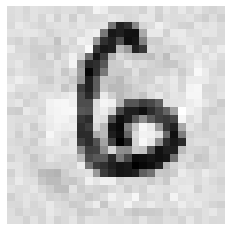

[2800] (예측값)6 (실제값)8


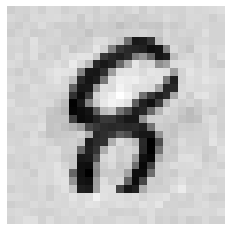

[2802] (예측값)0 (실제값)2


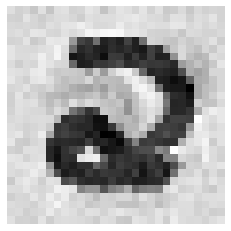

[2803] (예측값)9 (실제값)1


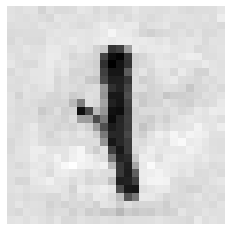

[2804] (예측값)0 (실제값)4


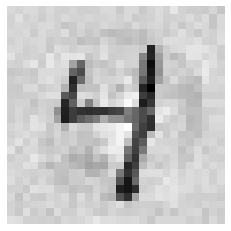

[2808] (예측값)5 (실제값)7


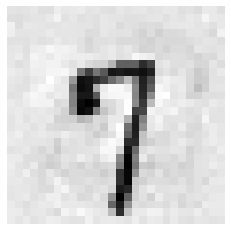

[2810] (예측값)3 (실제값)5


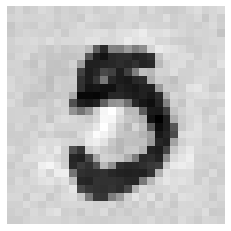

[2811] (예측값)8 (실제값)0


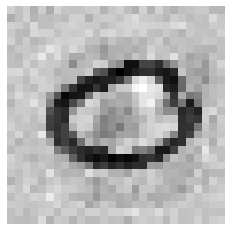

[2815] (예측값)3 (실제값)1


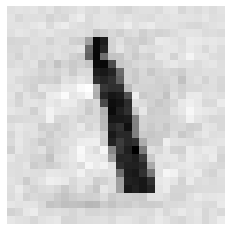

[2820] (예측값)8 (실제값)7


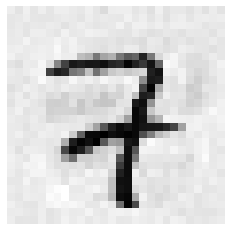

[2822] (예측값)7 (실제값)1


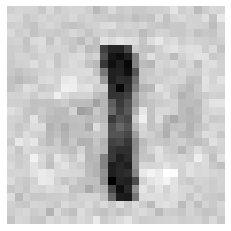

[2823] (예측값)2 (실제값)7


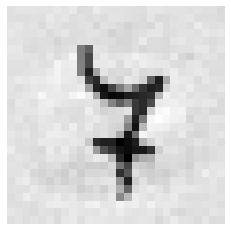

[2825] (예측값)3 (실제값)1


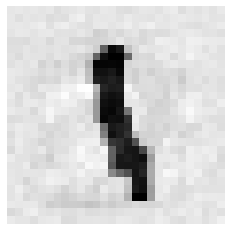

[2829] (예측값)7 (실제값)5


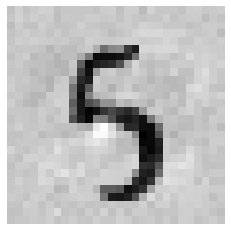

[2831] (예측값)9 (실제값)6


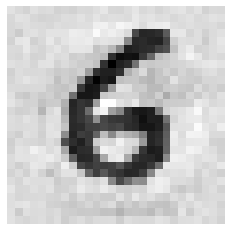

[2833] (예측값)2 (실제값)7


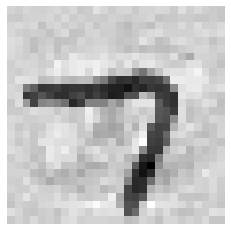

[2837] (예측값)2 (실제값)7


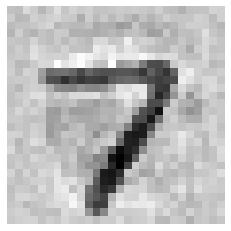

[2841] (예측값)2 (실제값)7


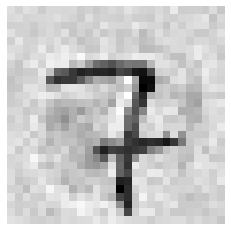

[2843] (예측값)2 (실제값)7


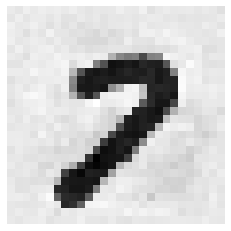

[2844] (예측값)3 (실제값)7


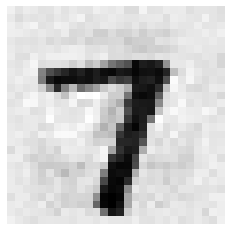

[2845] (예측값)4 (실제값)9


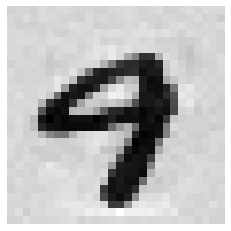

[2853] (예측값)4 (실제값)3


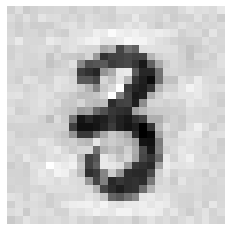

[2854] (예측값)5 (실제값)9


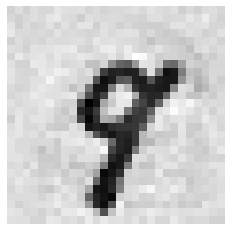

[2858] (예측값)5 (실제값)9


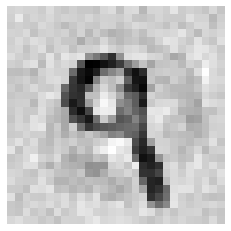

[2861] (예측값)3 (실제값)2


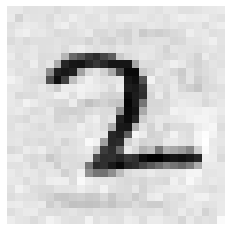

[2862] (예측값)4 (실제값)8


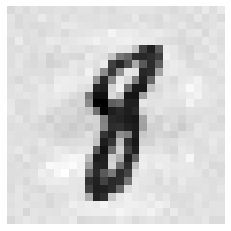

[2863] (예측값)5 (실제값)9


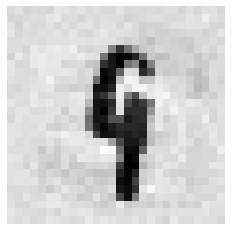

[2864] (예측값)6 (실제값)2


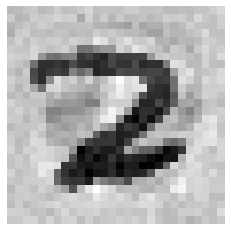

[2867] (예측값)9 (실제값)1


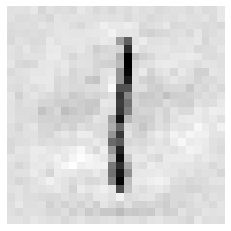

[2868] (예측값)7 (실제값)1


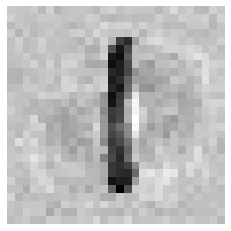

[2870] (예측값)2 (실제값)9


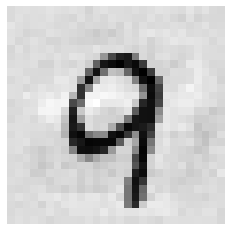

[2872] (예측값)5 (실제값)4


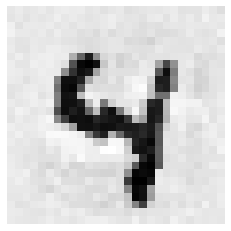

[2875] (예측값)0 (실제값)9


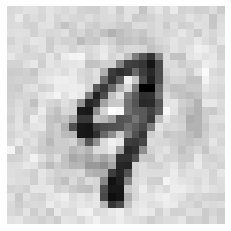

[2877] (예측값)2 (실제값)4


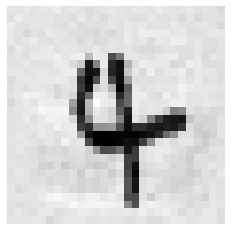

[2878] (예측값)3 (실제값)1


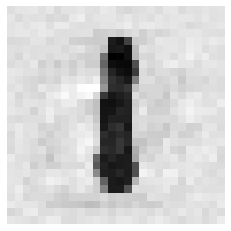

[2880] (예측값)6 (실제값)1


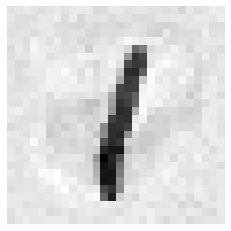

[2883] (예측값)0 (실제값)9


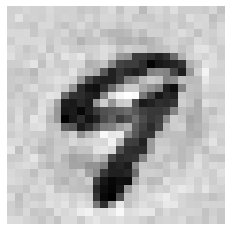

[2885] (예측값)2 (실제값)1


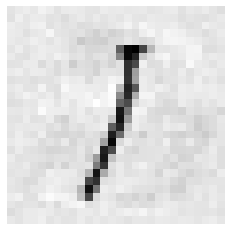

[2894] (예측값)2 (실제값)0


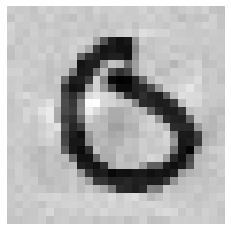

[2901] (예측값)9 (실제값)4


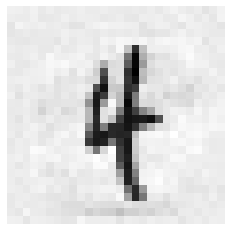

[2902] (예측값)2 (실제값)1


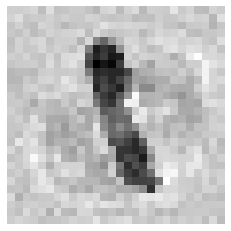

[2904] (예측값)3 (실제값)2


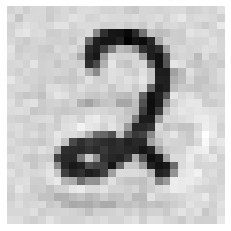

[2906] (예측값)5 (실제값)3


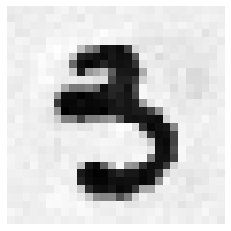

[2911] (예측값)0 (실제값)8


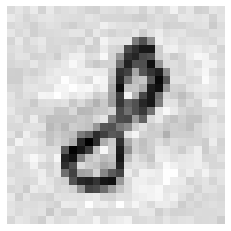

[2913] (예측값)3 (실제값)5


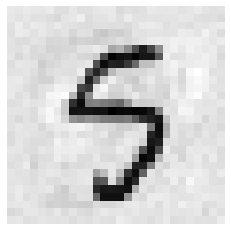

[2914] (예측값)4 (실제값)3


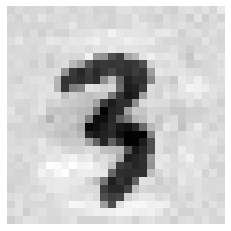

[2915] (예측값)3 (실제값)7


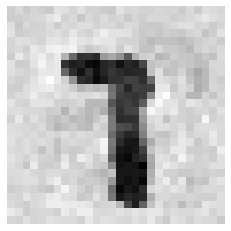

[2916] (예측값)4 (실제값)9


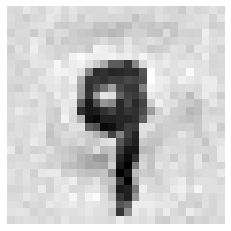

[2917] (예측값)7 (실제값)4


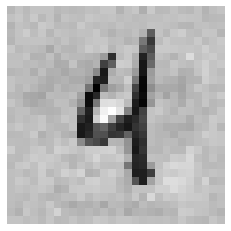

[2919] (예측값)9 (실제값)5


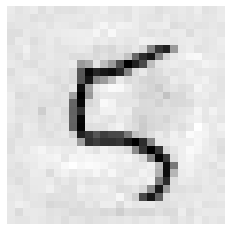

[2923] (예측값)3 (실제값)9


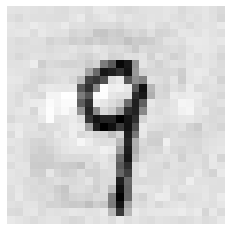

[2928] (예측값)9 (실제값)1


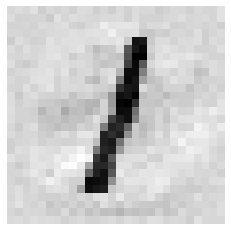

[2933] (예측값)4 (실제값)6


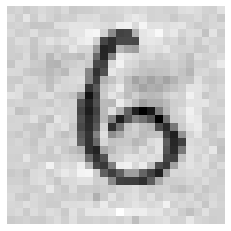

[2938] (예측값)9 (실제값)4


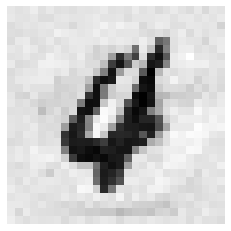

[2939] (예측값)5 (실제값)9


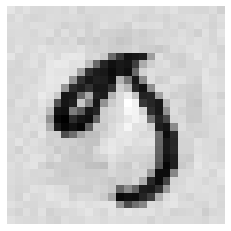

[2941] (예측값)5 (실제값)9


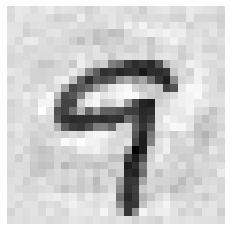

[2942] (예측값)2 (실제값)0


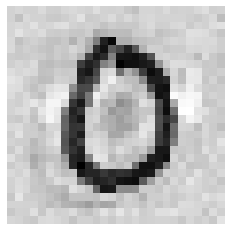

[2944] (예측값)5 (실제값)0


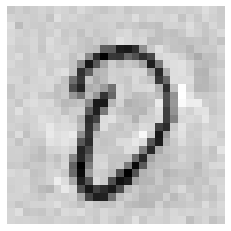

[2945] (예측값)6 (실제값)3


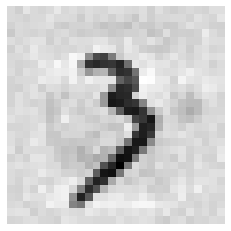

[2949] (예측값)0 (실제값)8


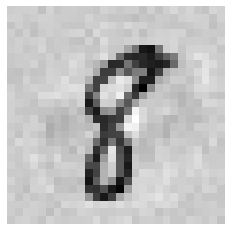

[2953] (예측값)5 (실제값)3


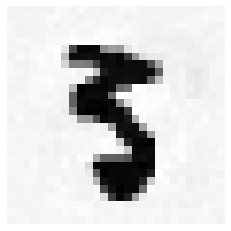

[2958] (예측값)0 (실제값)9


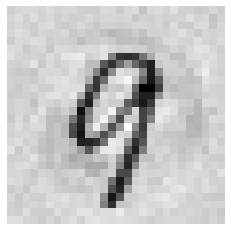

[2961] (예측값)2 (실제값)7


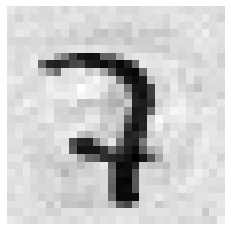

[2964] (예측값)4 (실제값)9


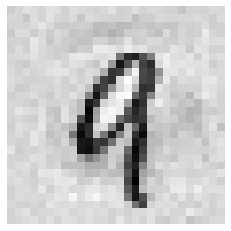

[2965] (예측값)7 (실제값)1


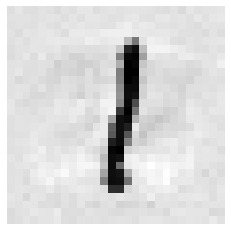

[2966] (예측값)8 (실제값)9


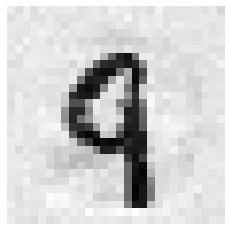

[2970] (예측값)2 (실제값)5


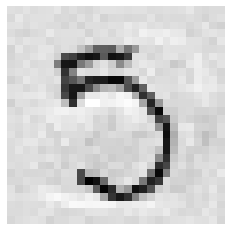

[2971] (예측값)3 (실제값)2


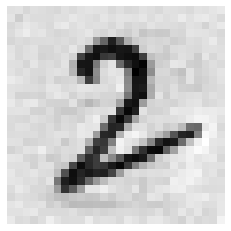

[2973] (예측값)5 (실제값)9


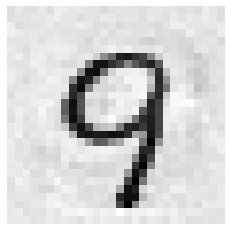

[2974] (예측값)6 (실제값)1


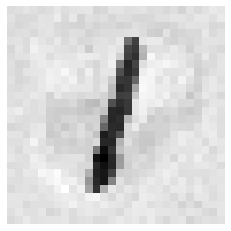

[2975] (예측값)0 (실제값)8


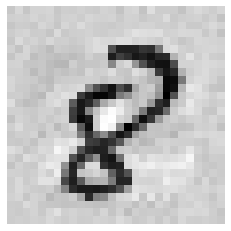

[2979] (예측값)1 (실제값)9


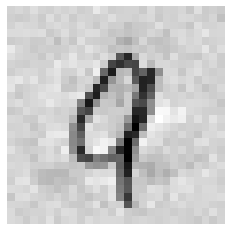

[2984] (예측값)6 (실제값)1


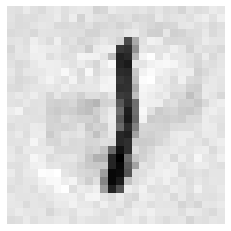

[2986] (예측값)8 (실제값)5


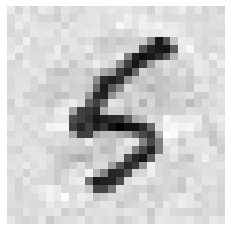

[2987] (예측값)9 (실제값)5


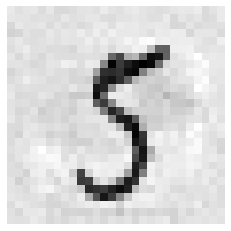

[2989] (예측값)1 (실제값)3


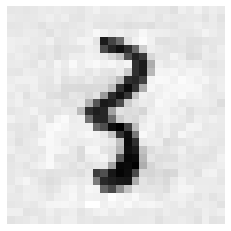

[2992] (예측값)5 (실제값)3


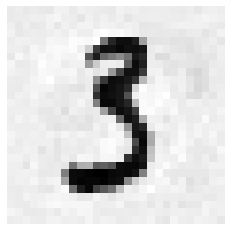

[2993] (예측값)6 (실제값)7


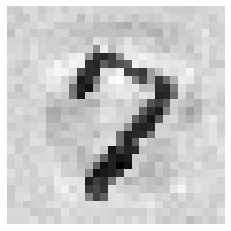

[2994] (예측값)7 (실제값)6


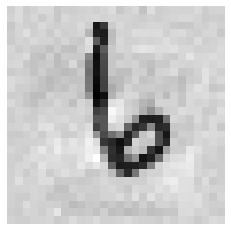

[2995] (예측값)8 (실제값)6


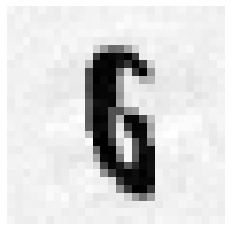

[2997] (예측값)7 (실제값)1


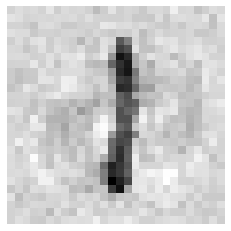

[3000] (예측값)3 (실제값)6


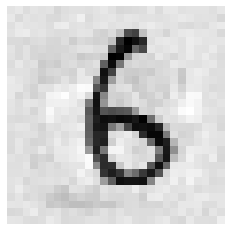

[3001] (예측값)4 (실제값)9


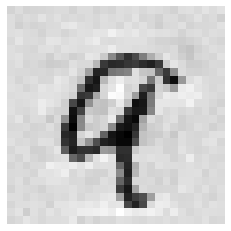

[3005] (예측값)8 (실제값)9


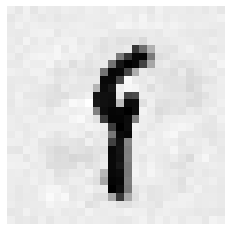

[3008] (예측값)7 (실제값)9


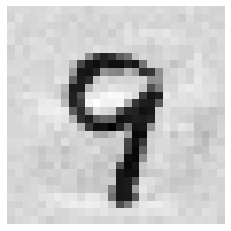

[3009] (예측값)3 (실제값)7


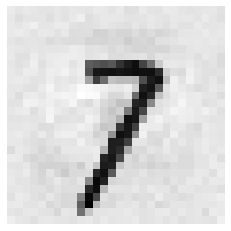

[3019] (예측값)3 (실제값)1


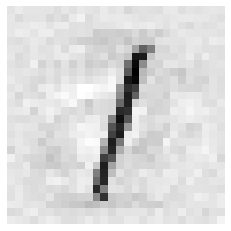

[3024] (예측값)8 (실제값)4


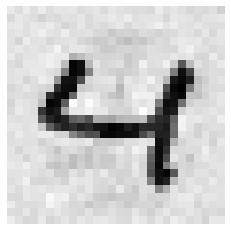

[3025] (예측값)9 (실제값)4


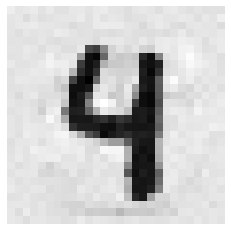

[3026] (예측값)7 (실제값)1


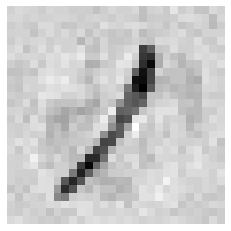

[3029] (예측값)5 (실제값)4


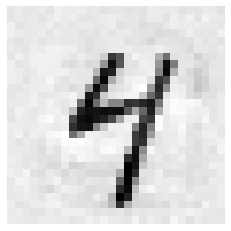

[3030] (예측값)7 (실제값)6


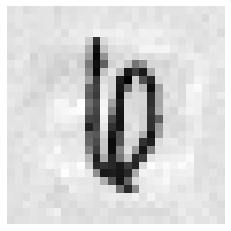

[3033] (예측값)0 (실제값)6


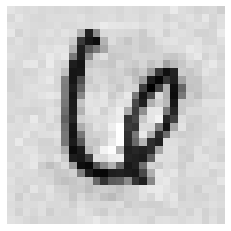

[3034] (예측값)2 (실제값)9


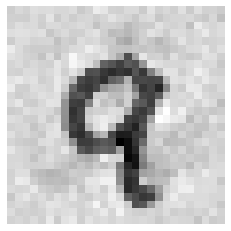

[3038] (예측값)0 (실제값)7


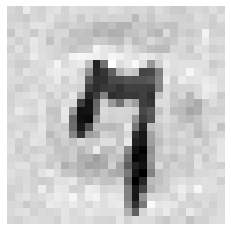

[3039] (예측값)7 (실제값)1


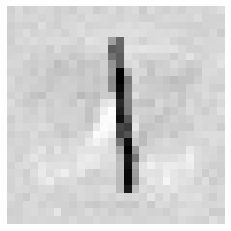

[3041] (예측값)0 (실제값)9


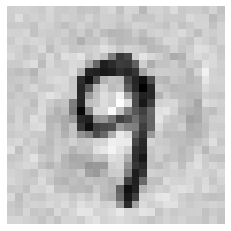

[3044] (예측값)3 (실제값)0


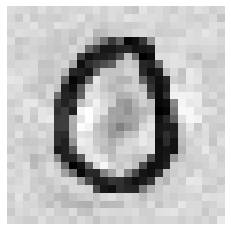

[3056] (예측값)5 (실제값)9


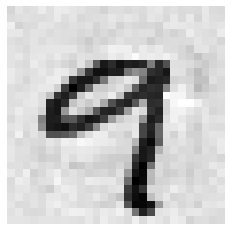

[3057] (예측값)6 (실제값)2


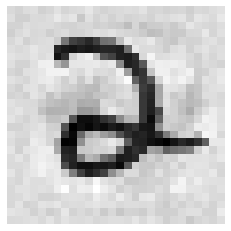

[3058] (예측값)7 (실제값)6


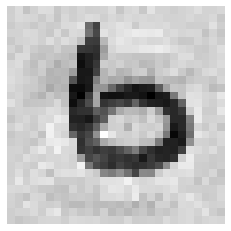

[3059] (예측값)8 (실제값)7


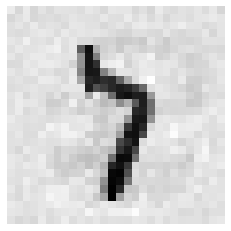

[3060] (예측값)5 (실제값)9


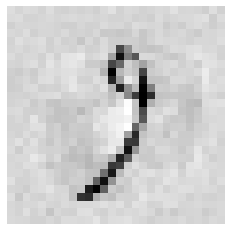

[3062] (예측값)2 (실제값)8


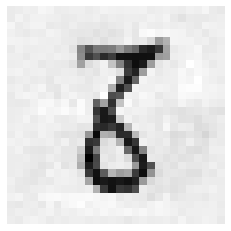

[3063] (예측값)3 (실제값)6


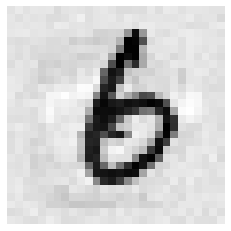

[3066] (예측값)6 (실제값)4


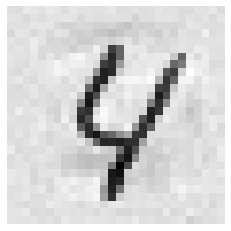

[3067] (예측값)7 (실제값)6


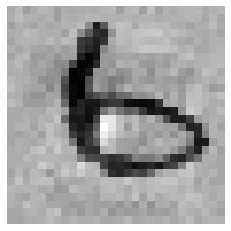

[3069] (예측값)9 (실제값)4


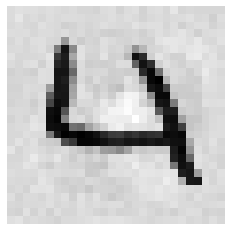

[3073] (예측값)3 (실제값)1


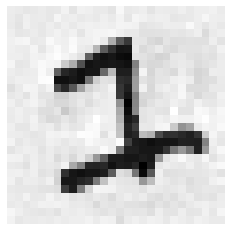

[3075] (예측값)7 (실제값)9


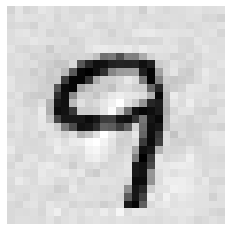

[3077] (예측값)9 (실제값)0


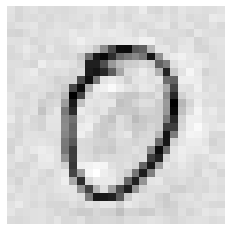

[3078] (예측값)0 (실제값)3


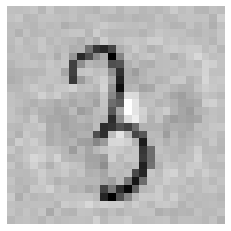

[3084] (예측값)6 (실제값)7


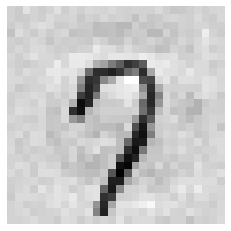

[3086] (예측값)8 (실제값)4


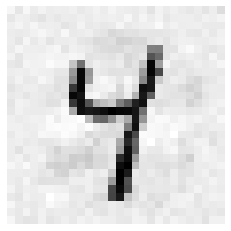

[3088] (예측값)0 (실제값)6


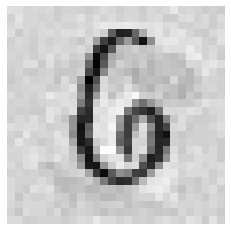

[3090] (예측값)2 (실제값)0


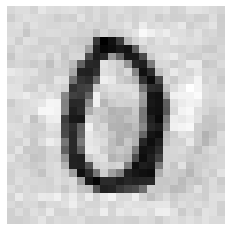

[3092] (예측값)4 (실제값)1


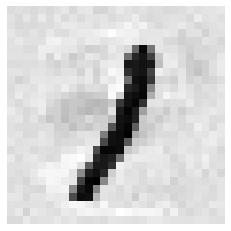

[3095] (예측값)8 (실제값)5


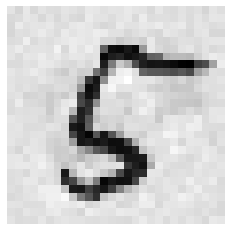

[3096] (예측값)9 (실제값)4


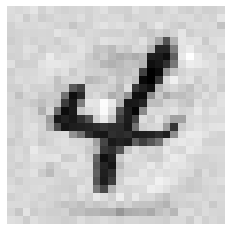

[3097] (예측값)0 (실제값)1


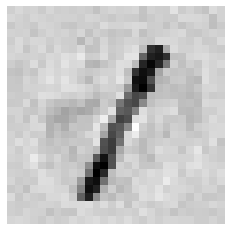

[3098] (예측값)3 (실제값)7


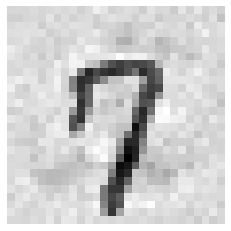

[3099] (예측값)2 (실제값)1


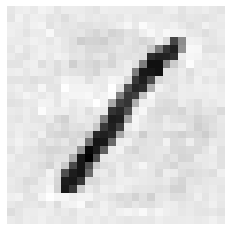

[3103] (예측값)5 (실제값)7


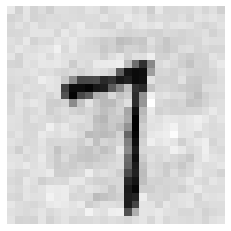

[3107] (예측값)5 (실제값)7


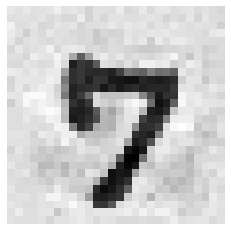

[3109] (예측값)1 (실제값)7


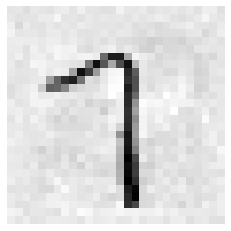

[3110] (예측값)6 (실제값)3


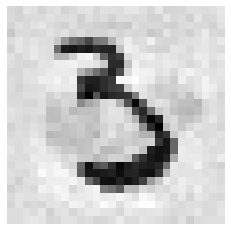

[3112] (예측값)9 (실제값)8


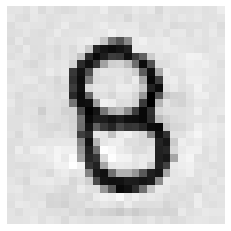

[3114] (예측값)2 (실제값)4


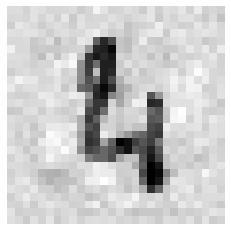

[3117] (예측값)4 (실제값)5


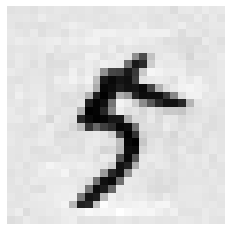

[3118] (예측값)5 (실제값)6


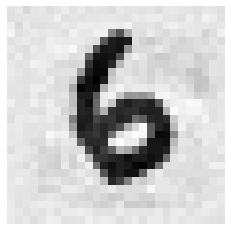

[3123] (예측값)0 (실제값)4


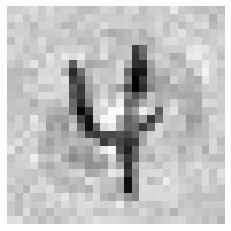

[3129] (예측값)8 (실제값)3


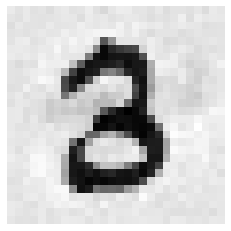

[3130] (예측값)9 (실제값)6


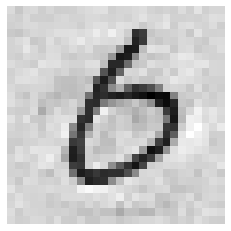

[3132] (예측값)2 (실제값)1


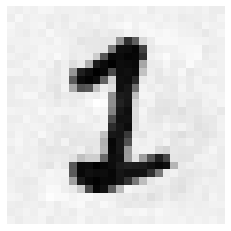

[3133] (예측값)3 (실제값)4


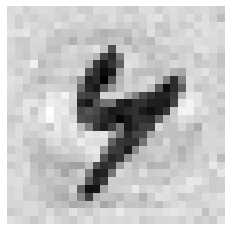

[3134] (예측값)6 (실제값)2


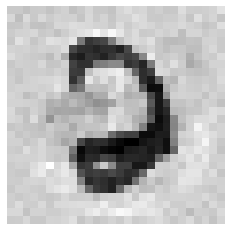

[3135] (예측값)5 (실제값)6


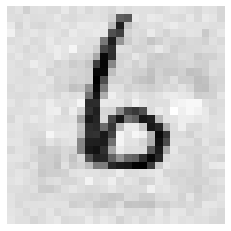

[3136] (예측값)6 (실제값)7


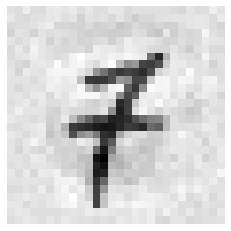

[3138] (예측값)9 (실제값)3


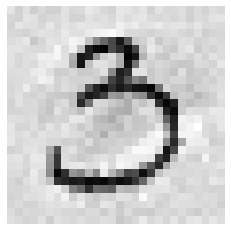

[3139] (예측값)9 (실제값)8


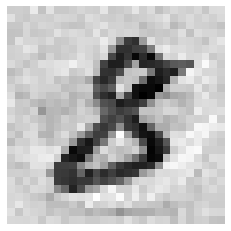

[3146] (예측값)7 (실제값)3


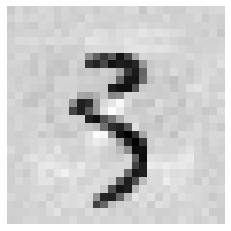

[3147] (예측값)8 (실제값)9


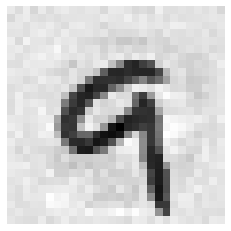

[3148] (예측값)9 (실제값)1


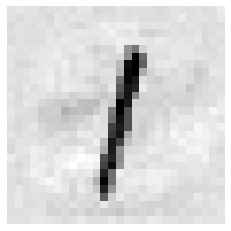

[3151] (예측값)3 (실제값)2


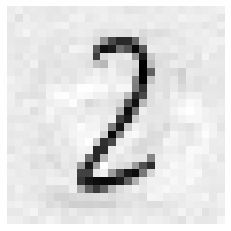

[3160] (예측값)2 (실제값)9


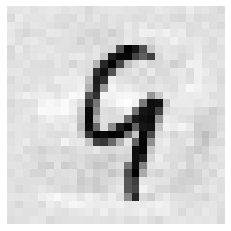

[3163] (예측값)5 (실제값)8


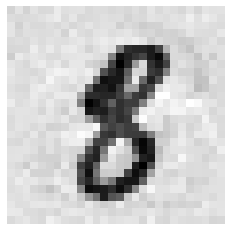

[3166] (예측값)9 (실제값)7


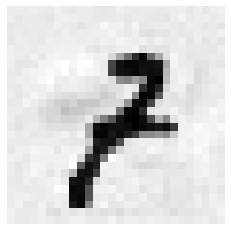

[3168] (예측값)2 (실제값)9


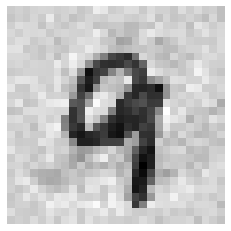

[3169] (예측값)2 (실제값)4


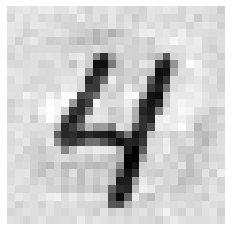

[3170] (예측값)3 (실제값)0


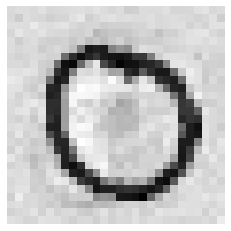

[3171] (예측값)8 (실제값)5


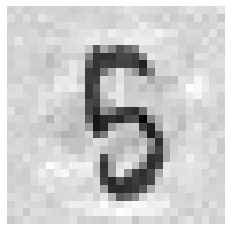

[3172] (예측값)5 (실제값)4


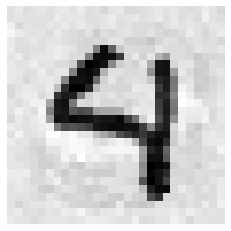

[3173] (예측값)7 (실제값)6


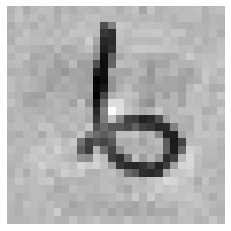

[3175] (예측값)9 (실제값)1


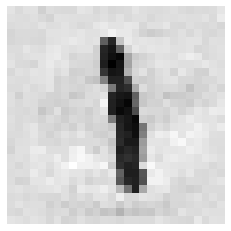

[3181] (예측값)5 (실제값)6


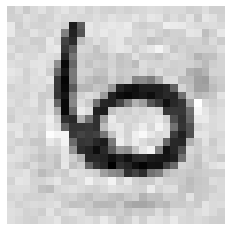

[3183] (예측값)8 (실제값)5


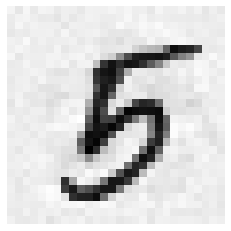

[3189] (예측값)4 (실제값)7


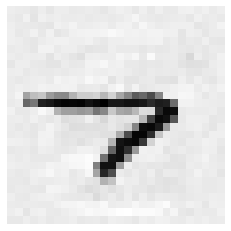

[3190] (예측값)5 (실제값)9


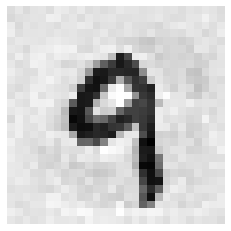

[3191] (예측값)6 (실제값)0


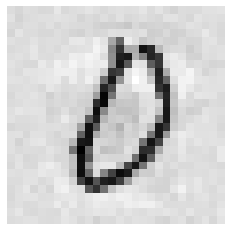

[3193] (예측값)8 (실제값)3


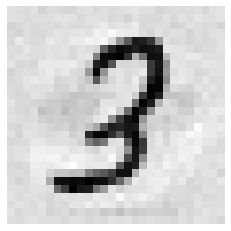

[3194] (예측값)9 (실제값)4


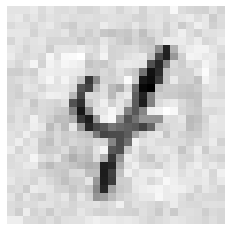

[3196] (예측값)2 (실제값)1


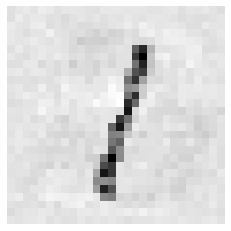

[3203] (예측값)0 (실제값)1


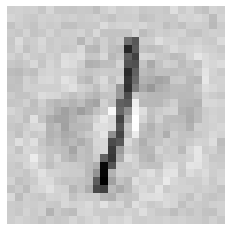

[3206] (예측값)3 (실제값)8


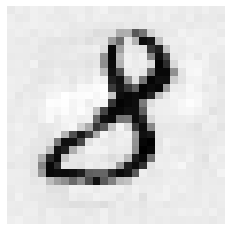

[3207] (예측값)6 (실제값)2


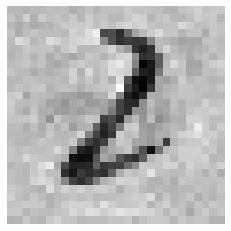

[3208] (예측값)5 (실제값)7


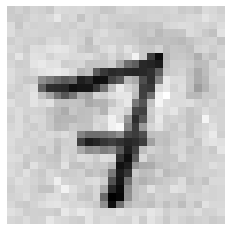

[3211] (예측값)9 (실제값)1


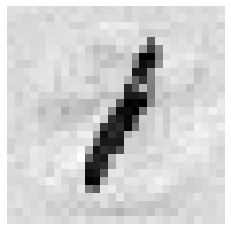

[3212] (예측값)9 (실제값)2


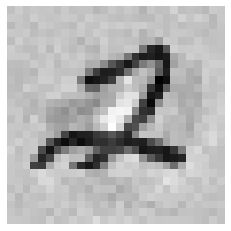

[3213] (예측값)1 (실제값)7


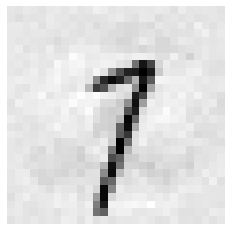

[3214] (예측값)2 (실제값)1


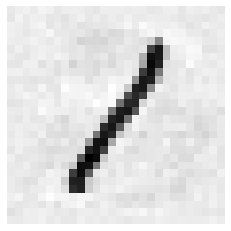

[3218] (예측값)4 (실제값)6


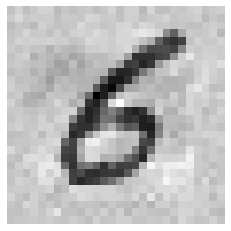

[3225] (예측값)5 (실제값)7


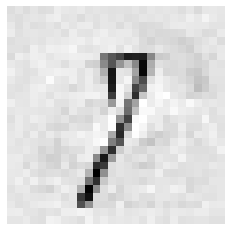

[3227] (예측값)7 (실제값)1


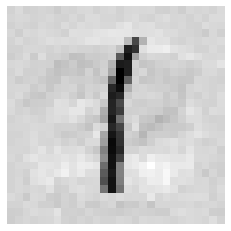

[3228] (예측값)8 (실제값)4


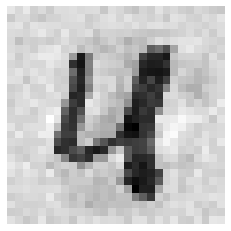

[3229] (예측값)3 (실제값)2


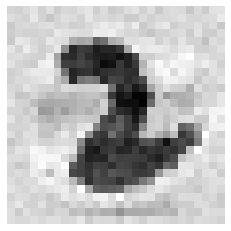

[3230] (예측값)7 (실제값)1


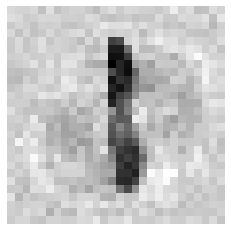

[3232] (예측값)3 (실제값)4


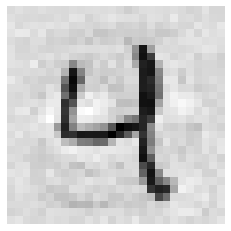

[3233] (예측값)5 (실제값)4


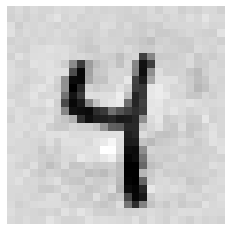

[3236] (예측값)8 (실제값)7


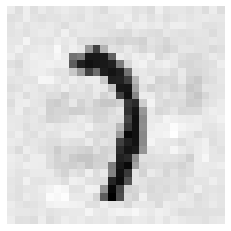

[3238] (예측값)0 (실제값)6


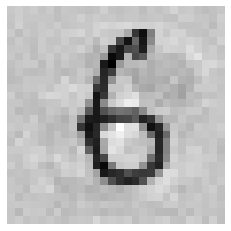

[3240] (예측값)8 (실제값)9


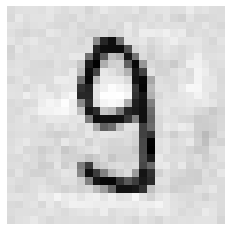

[3241] (예측값)3 (실제값)9


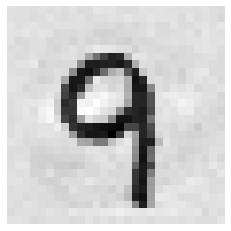

[3243] (예측값)5 (실제값)0


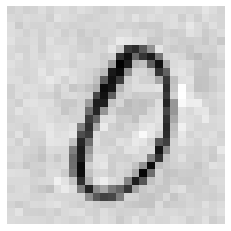

[3244] (예측값)6 (실제값)1


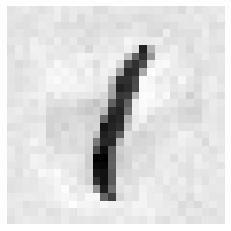

[3246] (예측값)9 (실제값)8


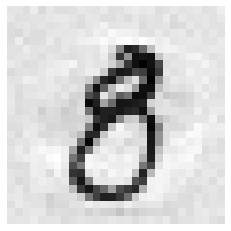

[3251] (예측값)4 (실제값)0


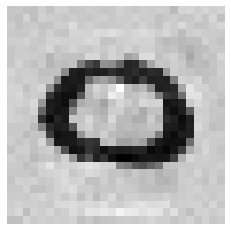

[3252] (예측값)5 (실제값)6


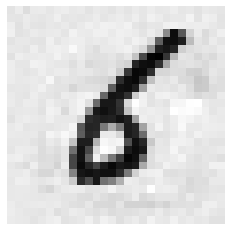

[3253] (예측값)6 (실제값)1


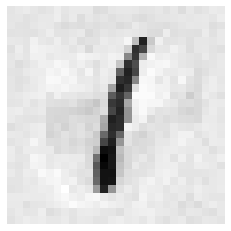

[3254] (예측값)5 (실제값)6


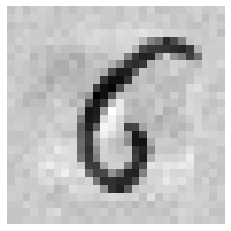

[3259] (예측값)8 (실제값)1


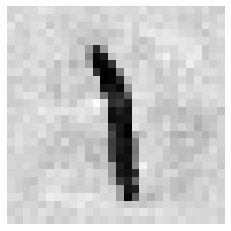

[3260] (예측값)3 (실제값)2


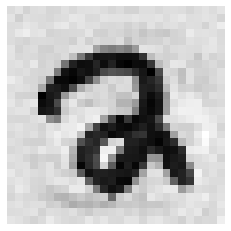

[3261] (예측값)4 (실제값)3


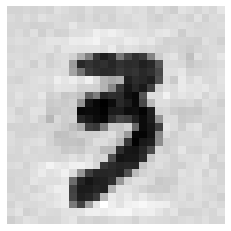

[3262] (예측값)5 (실제값)7


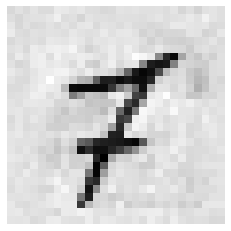

[3263] (예측값)6 (실제값)8


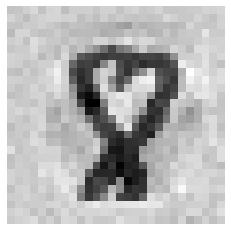

[3265] (예측값)8 (실제값)0


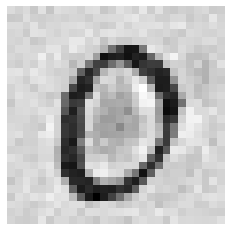

[3269] (예측값)3 (실제값)6


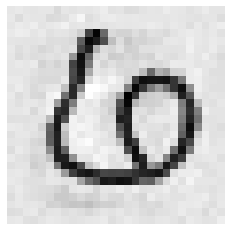

[3272] (예측값)6 (실제값)1


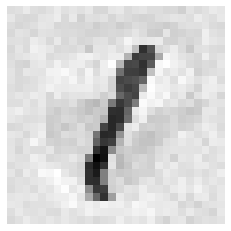

[3276] (예측값)7 (실제값)1


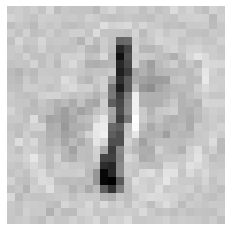

[3277] (예측값)1 (실제값)7


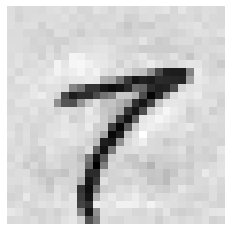

[3278] (예측값)2 (실제값)4


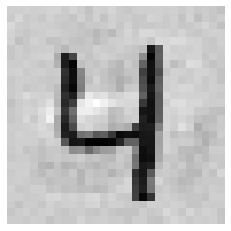

[3279] (예측값)3 (실제값)8


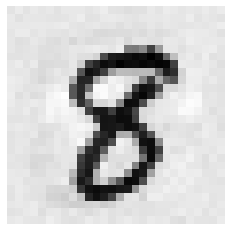

[3284] (예측값)7 (실제값)8


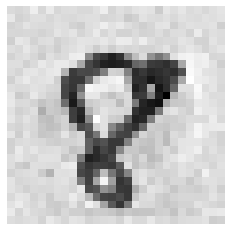

[3287] (예측값)2 (실제값)9


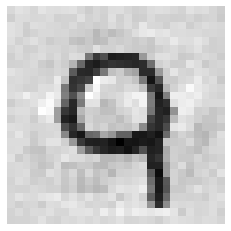

[3292] (예측값)5 (실제값)7


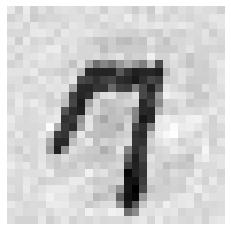

[3302] (예측값)9 (실제값)6


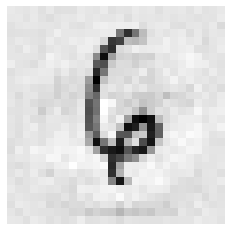

[3303] (예측값)0 (실제값)7


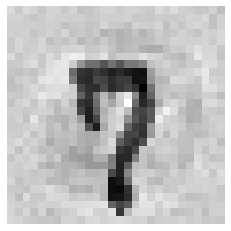

[3308] (예측값)8 (실제값)7


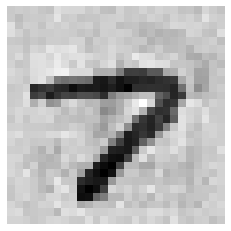

[3309] (예측값)6 (실제값)7


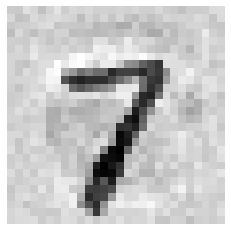

[3313] (예측값)0 (실제값)8


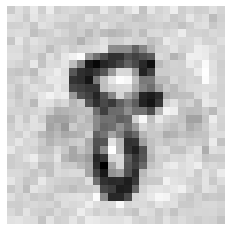

[3315] (예측값)3 (실제값)0


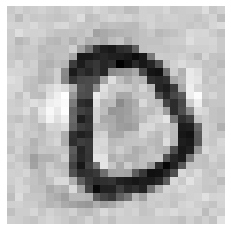

[3317] (예측값)5 (실제값)0


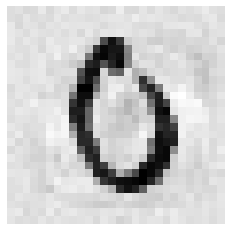

[3328] (예측값)6 (실제값)7


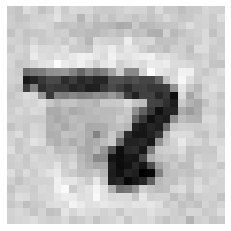

[3329] (예측값)8 (실제값)7


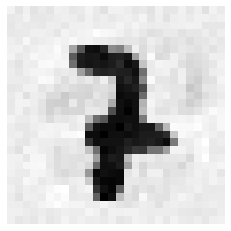

[3330] (예측값)0 (실제값)2


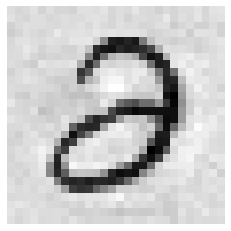

[3333] (예측값)2 (실제값)7


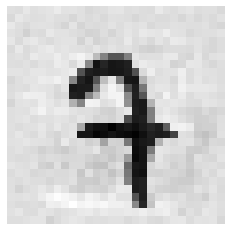

[3334] (예측값)3 (실제값)5


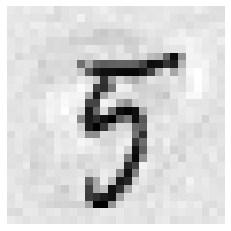

[3338] (예측값)8 (실제값)9


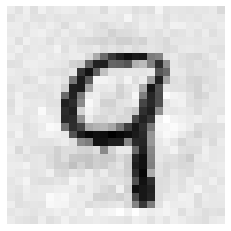

[3343] (예측값)2 (실제값)8


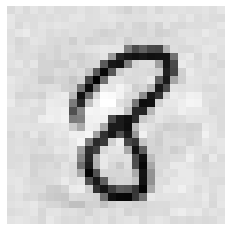

[3344] (예측값)4 (실제값)6


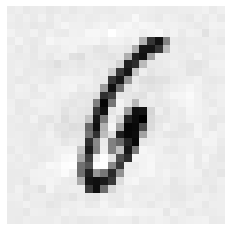

[3347] (예측값)8 (실제값)0


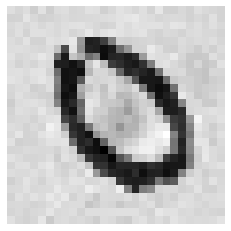

[3349] (예측값)2 (실제값)7


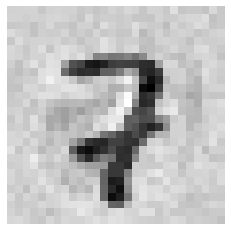

[3350] (예측값)5 (실제값)6


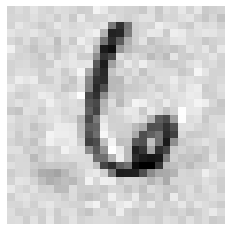

[3351] (예측값)2 (실제값)1


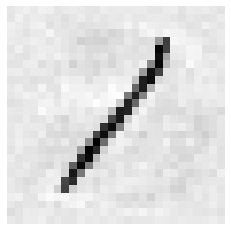

[3354] (예측값)8 (실제값)1


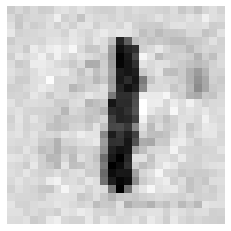

[3355] (예측값)6 (실제값)2


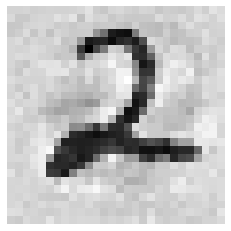

[3363] (예측값)5 (실제값)3


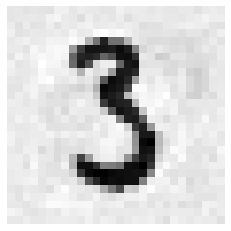

[3365] (예측값)0 (실제값)6


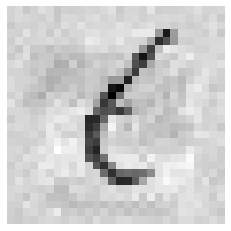

[3367] (예측값)3 (실제값)2


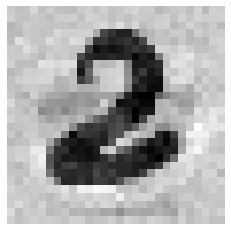

[3369] (예측값)1 (실제값)9


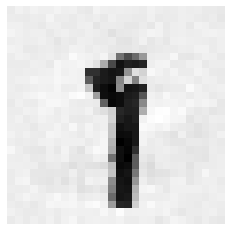

[3370] (예측값)2 (실제값)4


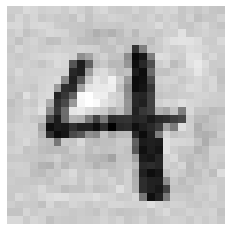

[3373] (예측값)5 (실제값)7


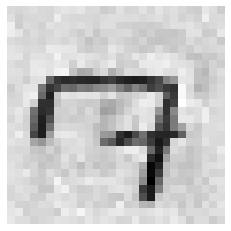

[3376] (예측값)8 (실제값)7


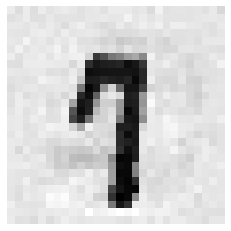

[3377] (예측값)9 (실제값)4


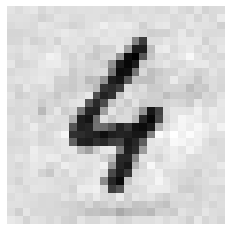

[3378] (예측값)5 (실제값)7


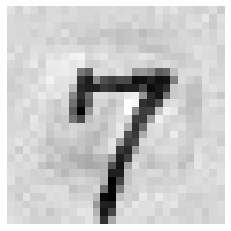

[3380] (예측값)3 (실제값)1


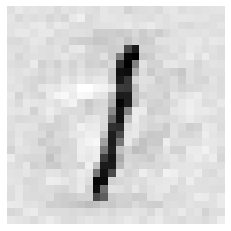

[3381] (예측값)8 (실제값)3


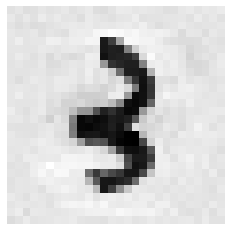

[3384] (예측값)6 (실제값)2


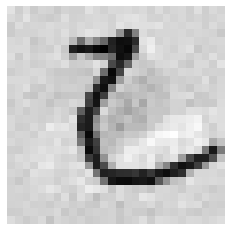

[3386] (예측값)2 (실제값)1


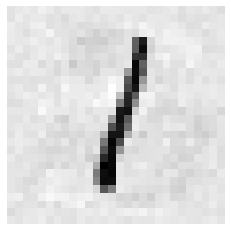

[3392] (예측값)5 (실제값)9


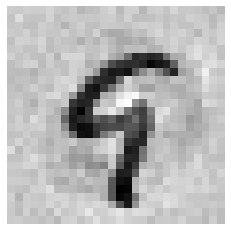

[3394] (예측값)2 (실제값)9


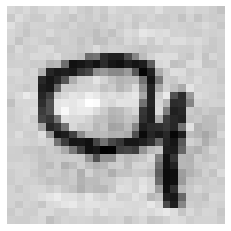

[3396] (예측값)4 (실제값)2


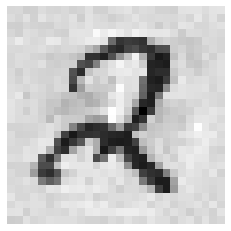

[3400] (예측값)9 (실제값)7


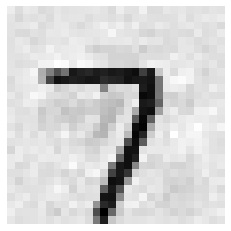

[3404] (예측값)2 (실제값)9


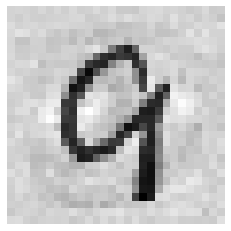

[3405] (예측값)5 (실제값)4


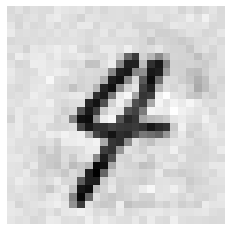

[3410] (예측값)0 (실제값)4


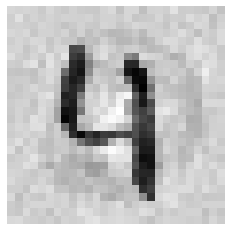

[3414] (예측값)8 (실제값)5


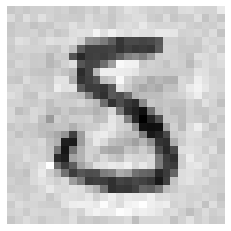

[3420] (예측값)0 (실제값)1


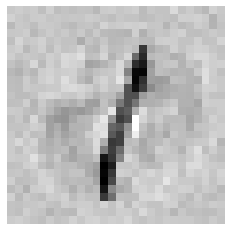

[3421] (예측값)2 (실제값)1


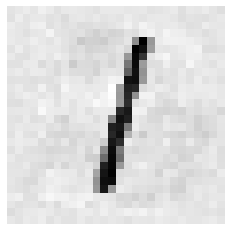

[3422] (예측값)0 (실제값)6


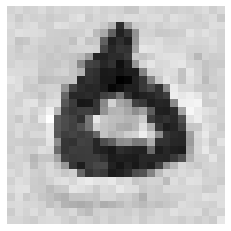

[3423] (예측값)4 (실제값)7


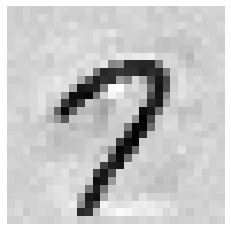

[3424] (예측값)5 (실제값)6


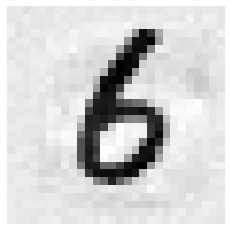

[3425] (예측값)6 (실제값)7


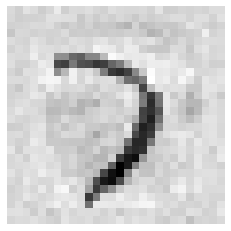

[3426] (예측값)7 (실제값)9


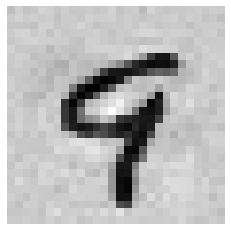

[3427] (예측값)8 (실제값)6


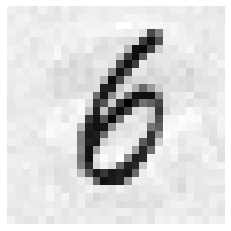

[3428] (예측값)9 (실제값)6


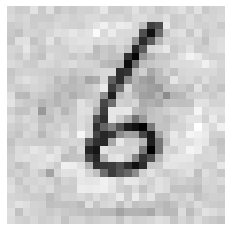

[3429] (예측값)8 (실제값)4


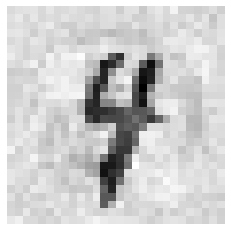

[3430] (예측값)2 (실제값)1


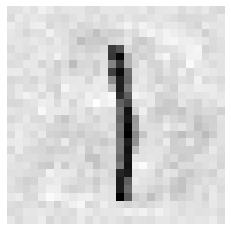

[3432] (예측값)4 (실제값)3


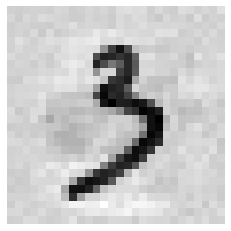

[3433] (예측값)5 (실제값)1


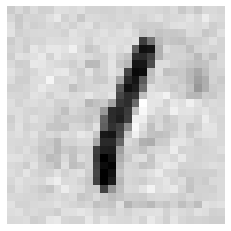

[3434] (예측값)6 (실제값)1


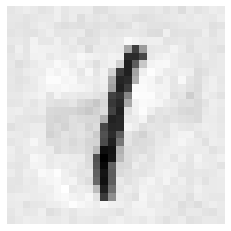

[3436] (예측값)8 (실제값)2


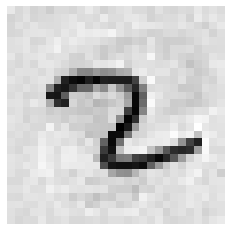

[3437] (예측값)9 (실제값)4


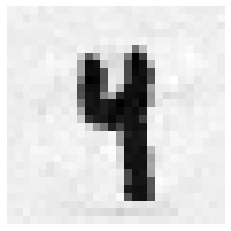

[3438] (예측값)0 (실제값)1


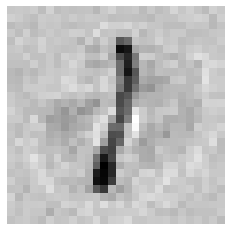

[3440] (예측값)2 (실제값)8


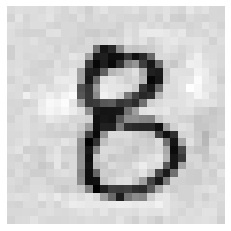

[3443] (예측값)5 (실제값)3


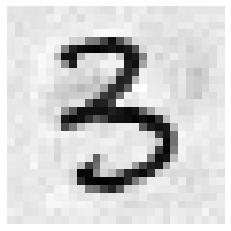

[3447] (예측값)4 (실제값)6


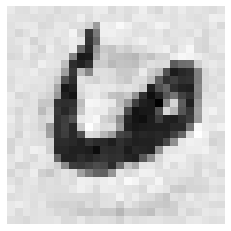

[3448] (예측값)5 (실제값)3


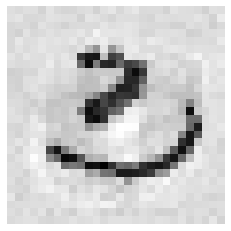

[3450] (예측값)2 (실제값)0


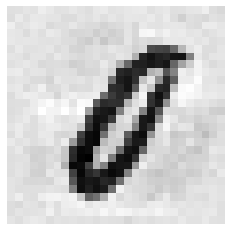

[3451] (예측값)3 (실제값)7


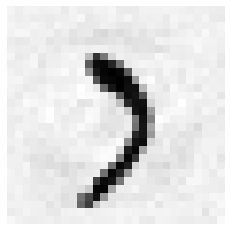

[3459] (예측값)2 (실제값)9


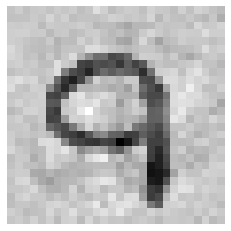

[3460] (예측값)2 (실제값)9


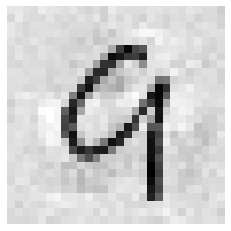

[3467] (예측값)0 (실제값)9


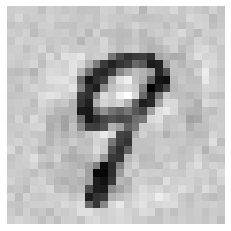

[3468] (예측값)8 (실제값)5


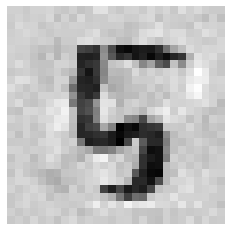

[3472] (예측값)5 (실제값)9


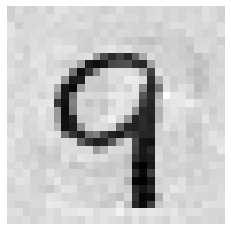

[3474] (예측값)1 (실제값)2


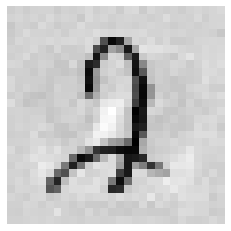

[3475] (예측값)8 (실제값)3


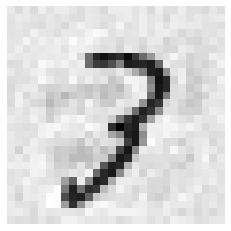

[3476] (예측값)9 (실제값)3


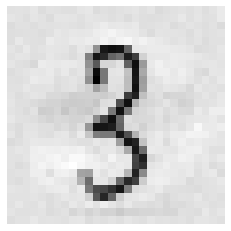

[3477] (예측값)0 (실제값)9


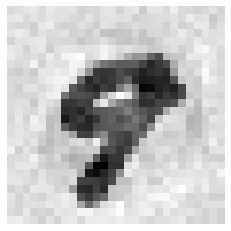

[3478] (예측값)2 (실제값)9


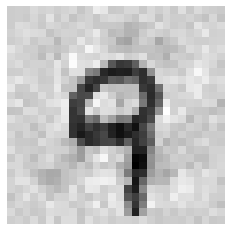

[3479] (예측값)2 (실제값)0


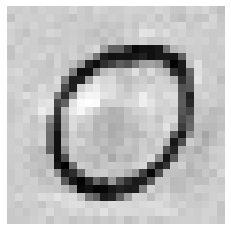

[3480] (예측값)3 (실제값)1


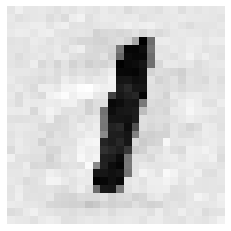

[3485] (예측값)8 (실제값)9


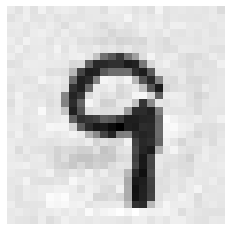

[3489] (예측값)3 (실제값)2


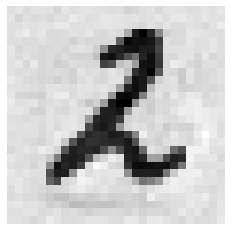

[3490] (예측값)8 (실제값)4


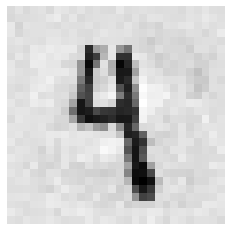

[3492] (예측값)9 (실제값)8


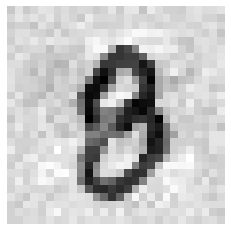

[3493] (예측값)8 (실제값)3


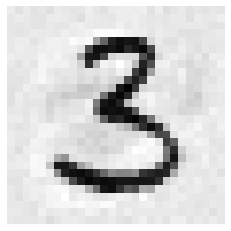

[3495] (예측값)9 (실제값)4


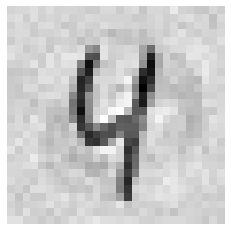

[3496] (예측값)2 (실제값)0


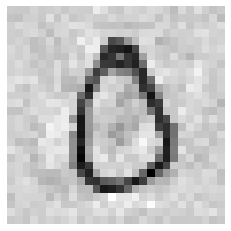

[3497] (예측값)2 (실제값)4


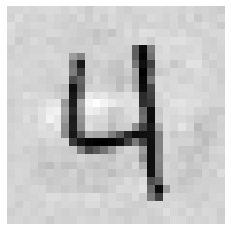

[3501] (예측값)5 (실제값)9


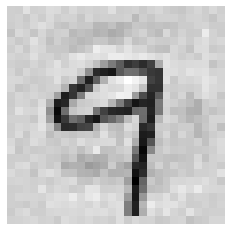

[3502] (예측값)4 (실제값)8


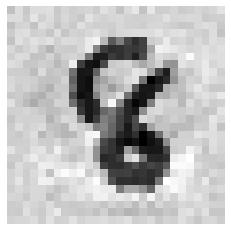

[3503] (예측값)1 (실제값)9


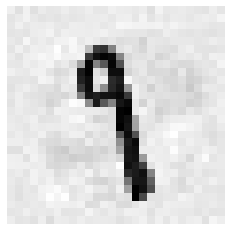

[3504] (예측값)7 (실제값)9


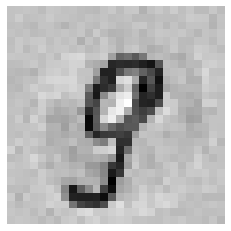

[3505] (예측값)1 (실제값)7


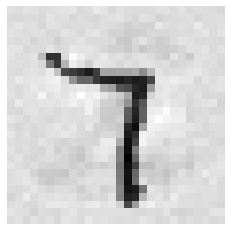

[3507] (예측값)3 (실제값)9


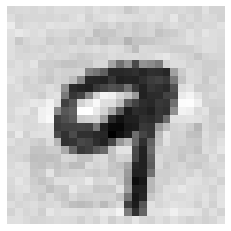

[3509] (예측값)5 (실제값)8


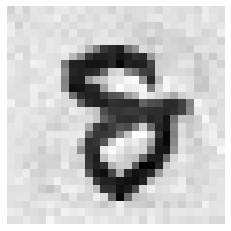

[3516] (예측값)2 (실제값)8


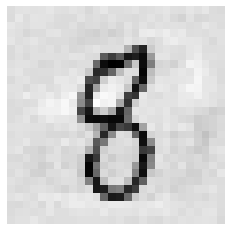

[3518] (예측값)4 (실제값)6


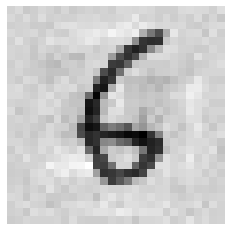

[3519] (예측값)5 (실제값)8


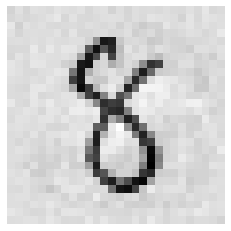

[3520] (예측값)7 (실제값)6


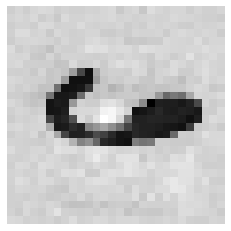

[3525] (예측값)3 (실제값)7


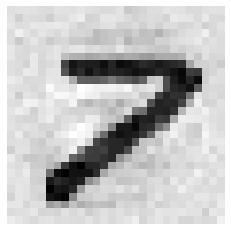

[3526] (예측값)4 (실제값)9


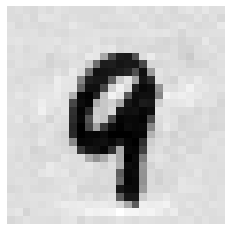

[3527] (예측값)5 (실제값)3


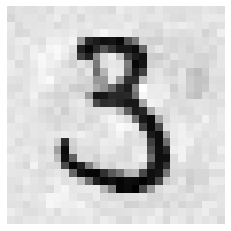

[3529] (예측값)7 (실제값)9


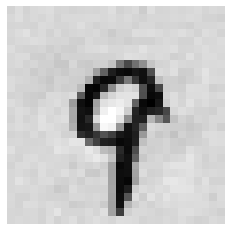

[3531] (예측값)9 (실제값)3


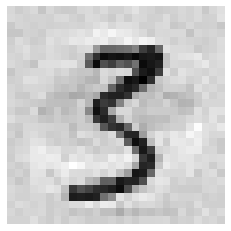

[3532] (예측값)7 (실제값)1


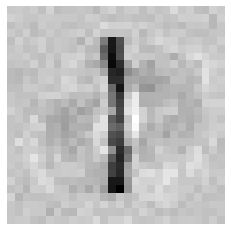

[3533] (예측값)5 (실제값)4


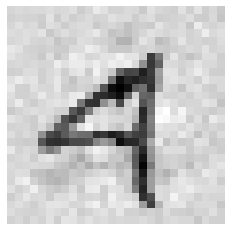

[3534] (예측값)8 (실제값)4


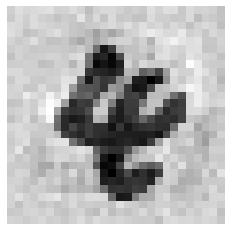

[3536] (예측값)4 (실제값)0


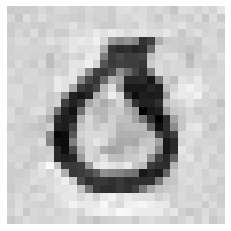

[3544] (예측값)7 (실제값)4


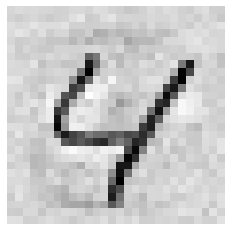

[3547] (예측값)6 (실제값)2


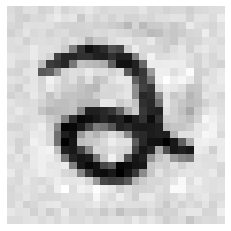

[3549] (예측값)2 (실제값)3


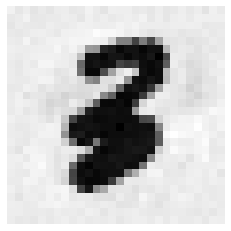

[3550] (예측값)9 (실제값)6


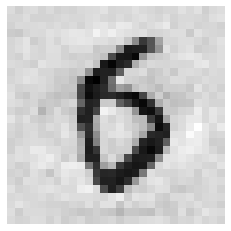

[3551] (예측값)0 (실제값)4


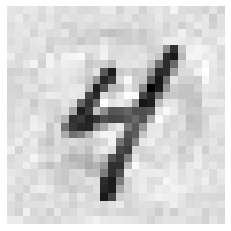

[3553] (예측값)2 (실제값)9


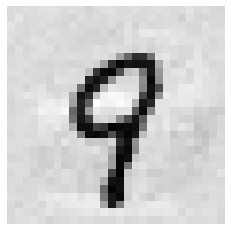

[3555] (예측값)4 (실제값)8


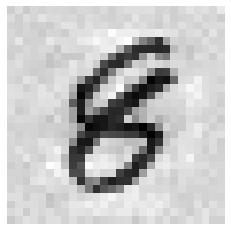

[3557] (예측값)0 (실제값)6


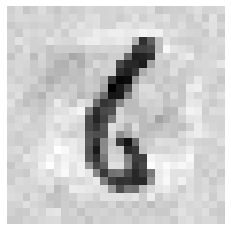

[3558] (예측값)0 (실제값)5


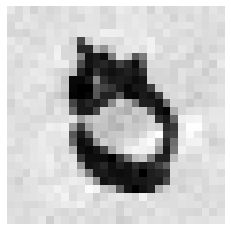

[3559] (예측값)9 (실제값)8


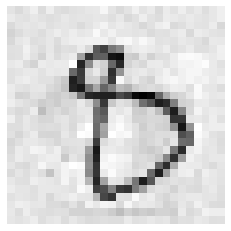

[3561] (예측값)1 (실제값)4


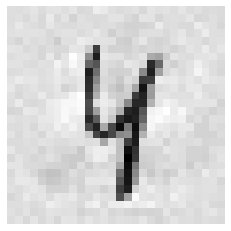

[3562] (예측값)2 (실제값)1


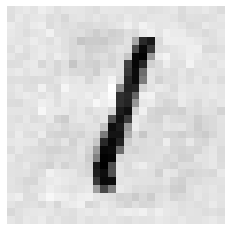

[3565] (예측값)6 (실제값)5


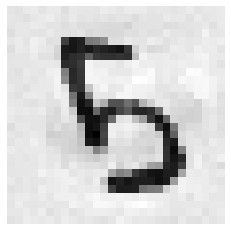

[3567] (예측값)5 (실제값)8


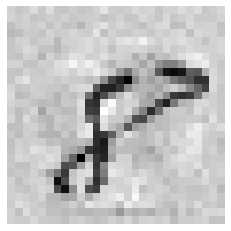

[3568] (예측값)5 (실제값)4


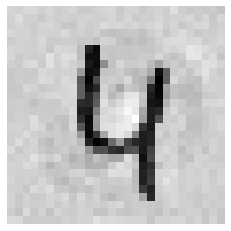

[3575] (예측값)8 (실제값)7


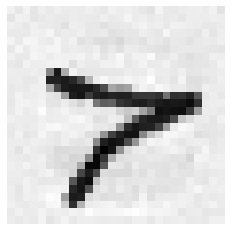

[3576] (예측값)9 (실제값)8


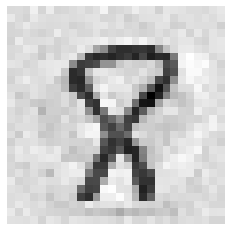

[3578] (예측값)1 (실제값)2


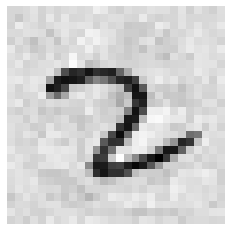

[3580] (예측값)3 (실제값)7


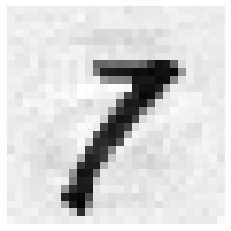

[3582] (예측값)5 (실제값)1


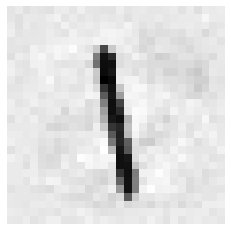

[3586] (예측값)9 (실제값)1


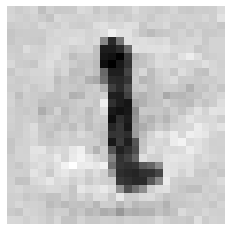

[3589] (예측값)2 (실제값)7


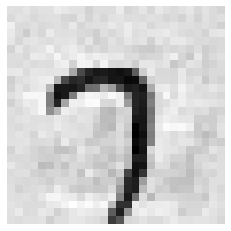

[3591] (예측값)8 (실제값)5


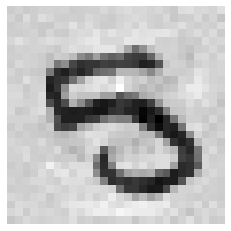

[3592] (예측값)5 (실제값)9


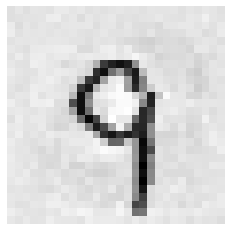

[3597] (예측값)1 (실제값)9


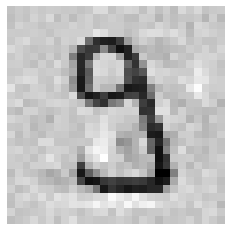

[3599] (예측값)3 (실제값)2


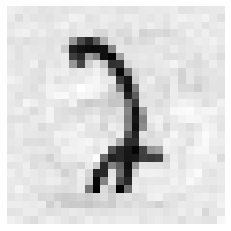

[3601] (예측값)5 (실제값)1


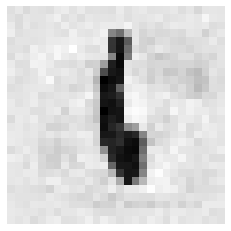

[3605] (예측값)8 (실제값)1


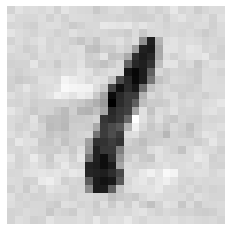

[3606] (예측값)2 (실제값)1


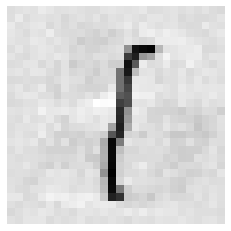

[3607] (예측값)3 (실제값)4


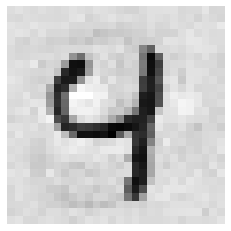

[3612] (예측값)9 (실제값)4


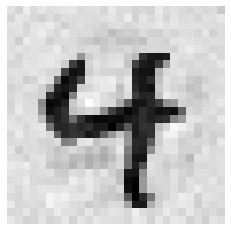

[3613] (예측값)9 (실제값)0


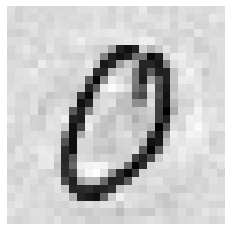

[3616] (예측값)2 (실제값)7


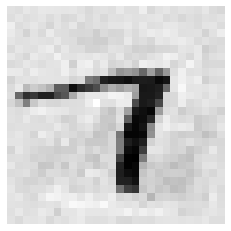

[3618] (예측값)4 (실제값)9


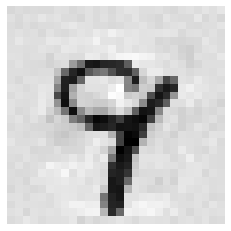

[3621] (예측값)8 (실제값)4


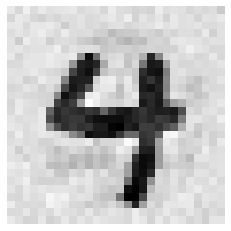

[3626] (예측값)3 (실제값)8


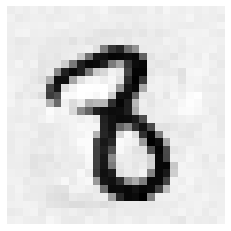

[3628] (예측값)8 (실제값)2


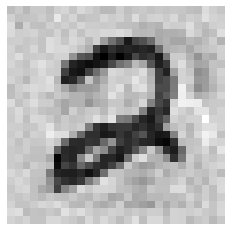

[3633] (예측값)0 (실제값)8


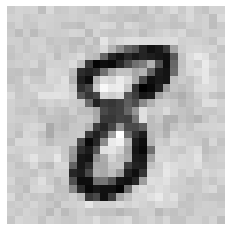

[3634] (예측값)3 (실제값)0


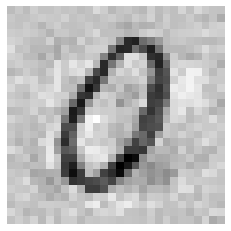

[3636] (예측값)3 (실제값)5


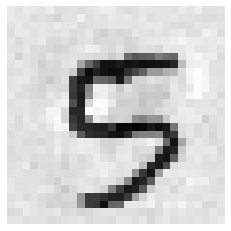

[3637] (예측값)4 (실제값)7


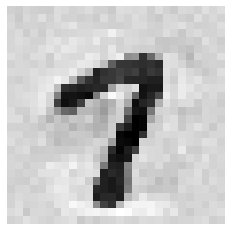

[3638] (예측값)5 (실제값)1


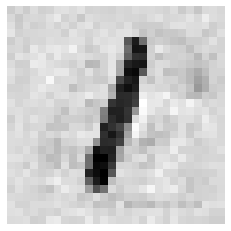

[3653] (예측값)0 (실제값)4


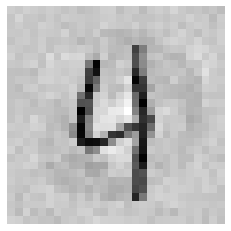

[3656] (예측값)4 (실제값)7


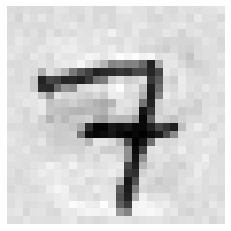

[3662] (예측값)0 (실제값)8


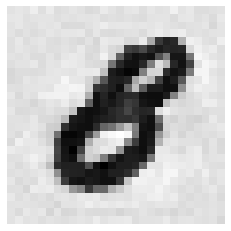

[3664] (예측값)2 (실제값)9


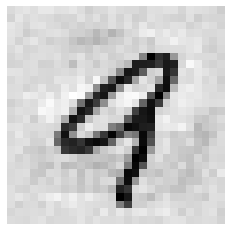

[3666] (예측값)4 (실제값)9


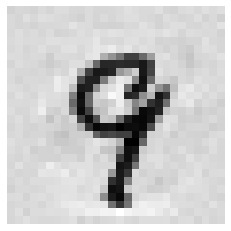

[3668] (예측값)6 (실제값)2


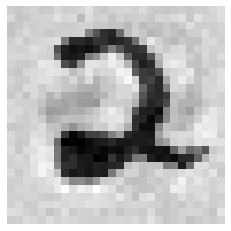

[3669] (예측값)7 (실제값)1


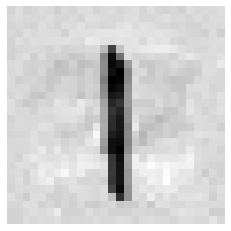

[3672] (예측값)0 (실제값)4


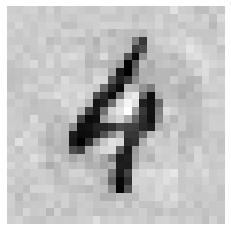

[3674] (예측값)3 (실제값)8


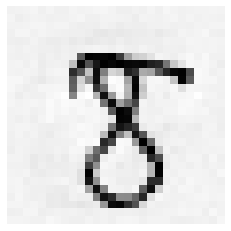

[3677] (예측값)6 (실제값)0


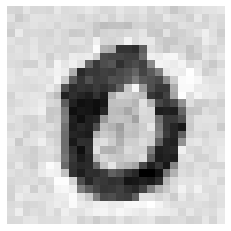

[3680] (예측값)9 (실제값)0


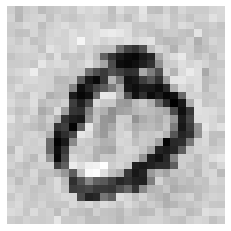

[3688] (예측값)8 (실제값)6


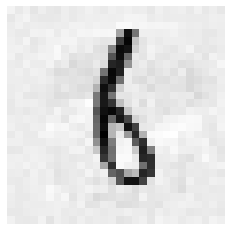

[3689] (예측값)9 (실제값)1


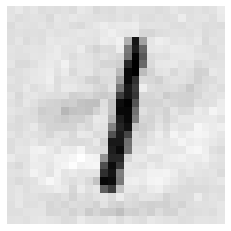

[3693] (예측값)3 (실제값)9


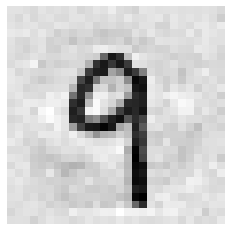

[3698] (예측값)8 (실제값)0


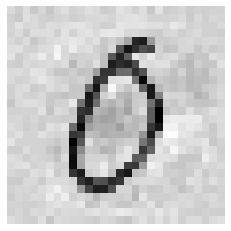

[3699] (예측값)9 (실제값)1


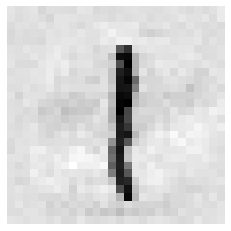

[3702] (예측값)4 (실제값)5


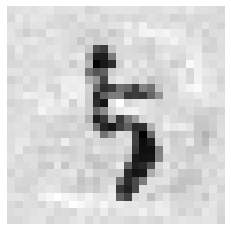

[3703] (예측값)3 (실제값)2


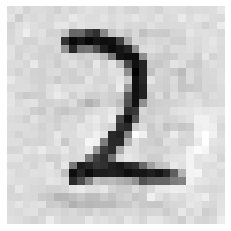

[3706] (예측값)6 (실제값)0


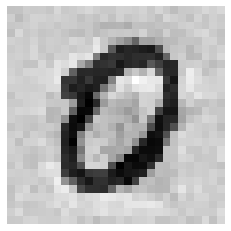

[3707] (예측값)7 (실제값)8


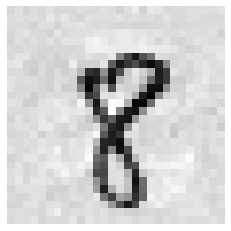

[3709] (예측값)5 (실제값)9


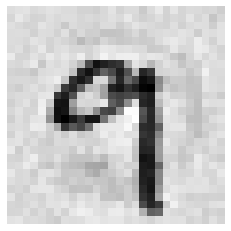

[3710] (예측값)1 (실제값)0


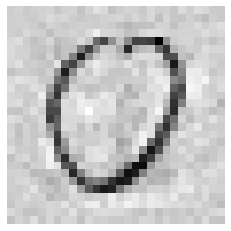

[3713] (예측값)4 (실제값)7


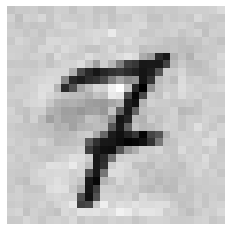

[3714] (예측값)5 (실제값)6


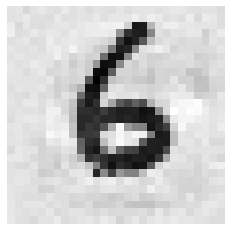

[3717] (예측값)8 (실제값)3


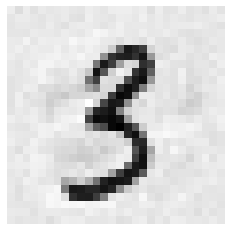

[3718] (예측값)9 (실제값)4


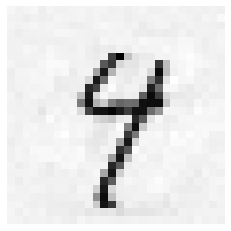

[3720] (예측값)2 (실제값)7


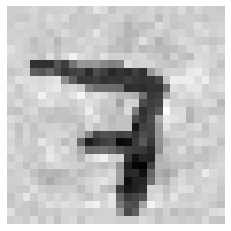

[3721] (예측값)2 (실제값)7


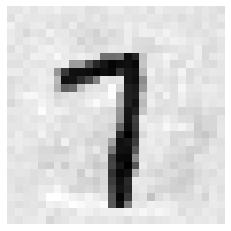

[3723] (예측값)6 (실제값)9


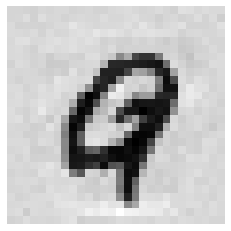

[3728] (예측값)5 (실제값)4


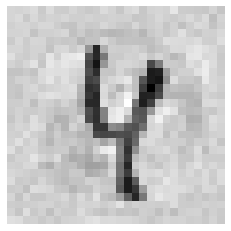

[3739] (예측값)1 (실제값)3


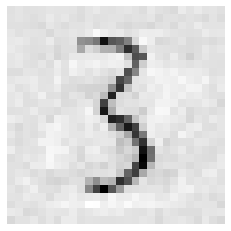

[3741] (예측값)3 (실제값)1


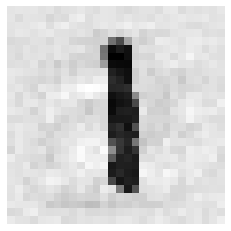

[3742] (예측값)4 (실제값)3


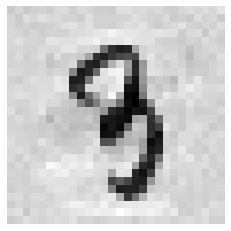

[3745] (예측값)8 (실제값)1


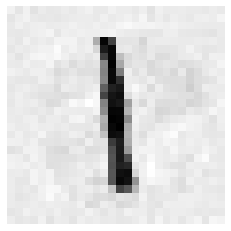

[3747] (예측값)7 (실제값)1


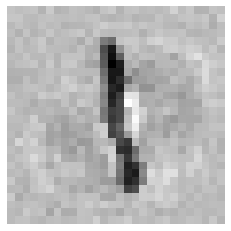

[3751] (예측값)4 (실제값)7


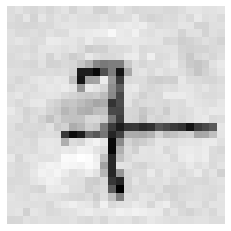

[3752] (예측값)6 (실제값)4


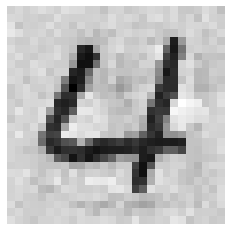

[3754] (예측값)7 (실제값)5


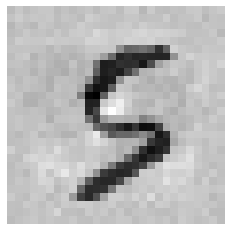

[3756] (예측값)9 (실제값)5


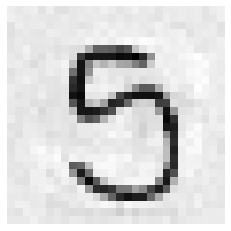

[3757] (예측값)0 (실제값)8


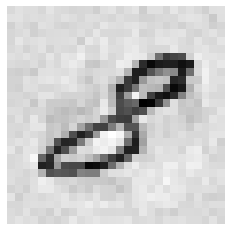

[3759] (예측값)2 (실제값)9


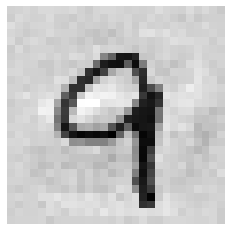

[3760] (예측값)3 (실제값)9


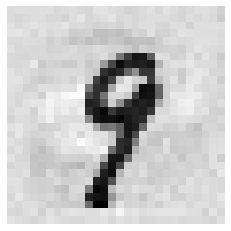

[3762] (예측값)5 (실제값)6


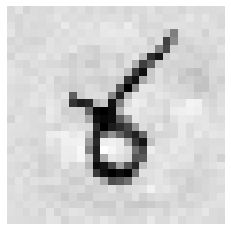

[3764] (예측값)7 (실제값)0


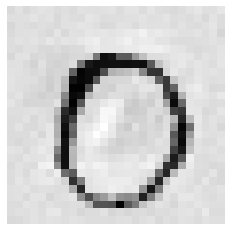

[3767] (예측값)2 (실제값)7


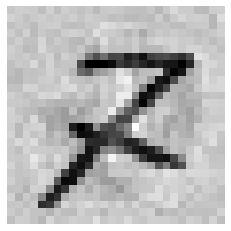

[3770] (예측값)3 (실제값)4


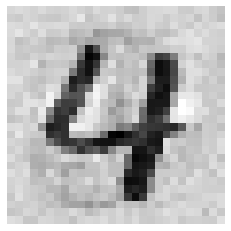

[3772] (예측값)5 (실제값)2


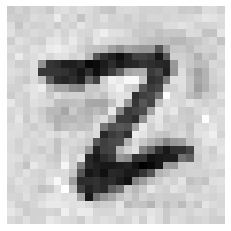

[3776] (예측값)8 (실제값)5


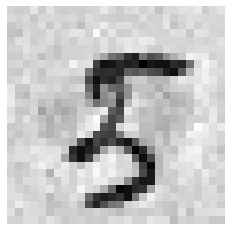

[3777] (예측값)7 (실제값)1


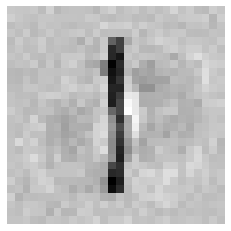

[3780] (예측값)2 (실제값)4


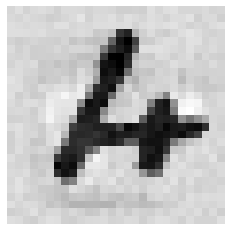

[3782] (예측값)5 (실제값)8


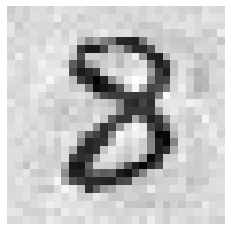

[3785] (예측값)1 (실제값)2


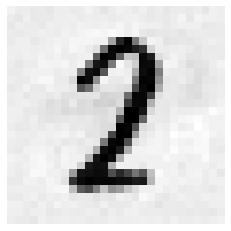

[3786] (예측값)9 (실제값)1


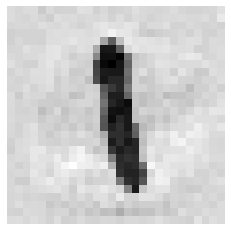

[3793] (예측값)6 (실제값)4


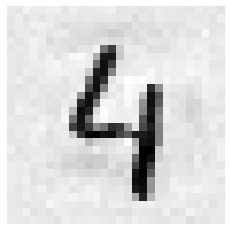

[3796] (예측값)8 (실제값)2


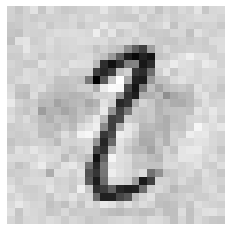

[3798] (예측값)4 (실제값)9


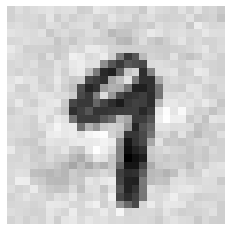

[3800] (예측값)3 (실제값)6


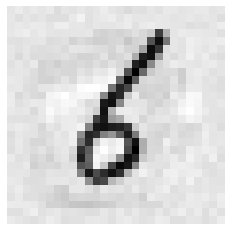

[3808] (예측값)1 (실제값)7


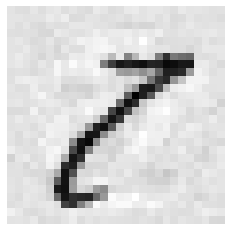

[3809] (예측값)2 (실제값)1


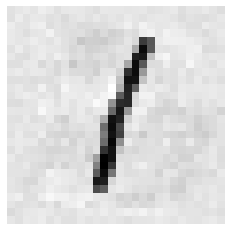

[3811] (예측값)3 (실제값)2


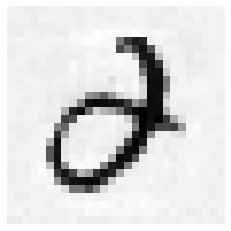

[3812] (예측값)5 (실제값)3


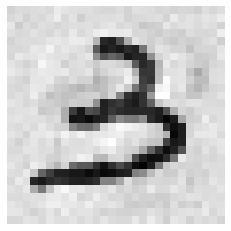

[3816] (예측값)9 (실제값)8


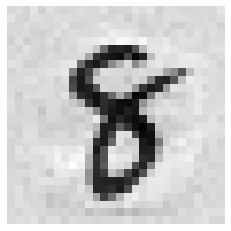

[3817] (예측값)0 (실제값)2


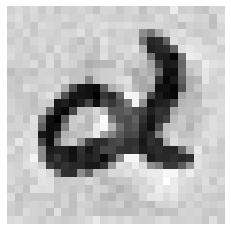

[3818] (예측값)6 (실제값)0


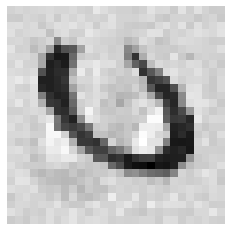

[3821] (예측값)4 (실제값)9


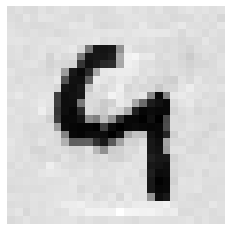

[3826] (예측값)9 (실제값)5


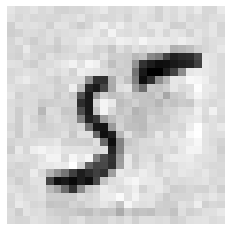

[3829] (예측값)2 (실제값)8


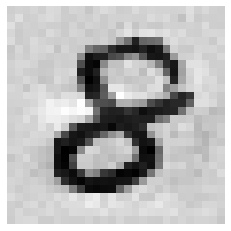

[3830] (예측값)3 (실제값)0


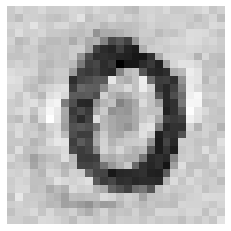

[3831] (예측값)4 (실제값)9


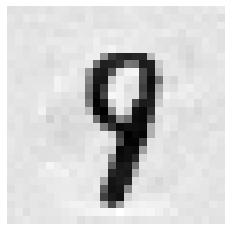

[3836] (예측값)9 (실제값)7


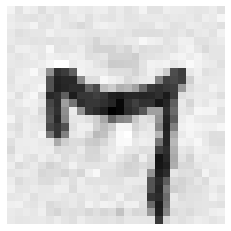

[3838] (예측값)1 (실제값)7


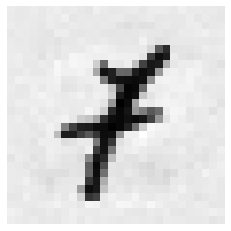

[3842] (예측값)6 (실제값)9


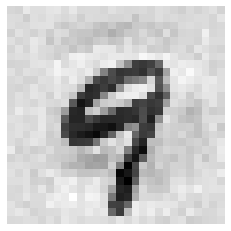

[3843] (예측값)7 (실제값)1


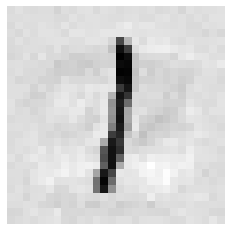

[3846] (예측값)0 (실제값)6


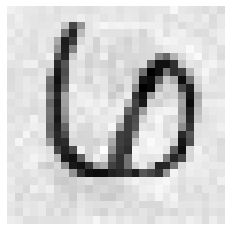

[3847] (예측값)2 (실제값)0


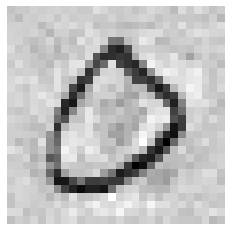

[3848] (예측값)2 (실제값)7


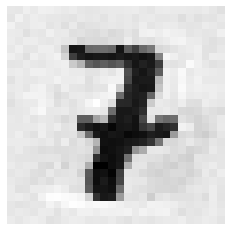

[3850] (예측값)4 (실제값)9


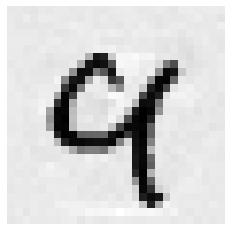

[3851] (예측값)5 (실제값)1


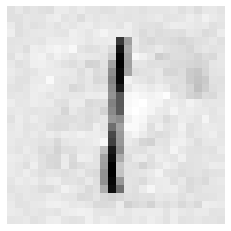

[3852] (예측값)6 (실제값)1


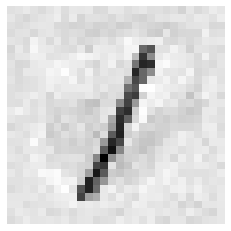

[3853] (예측값)0 (실제값)6


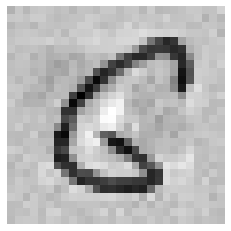

[3854] (예측값)8 (실제값)7


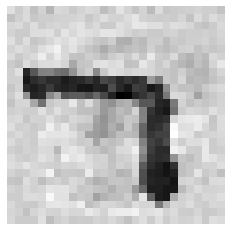

[3856] (예측값)5 (실제값)9


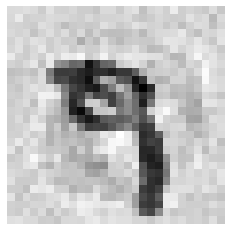

[3858] (예측값)2 (실제값)1


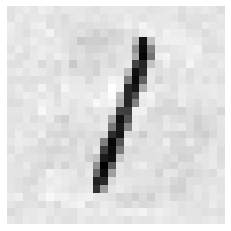

[3860] (예측값)4 (실제값)5


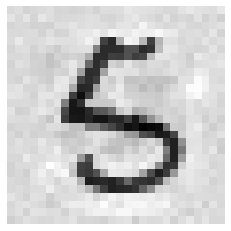

[3865] (예측값)9 (실제값)4


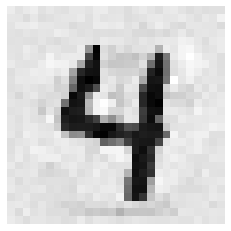

[3866] (예측값)7 (실제값)1


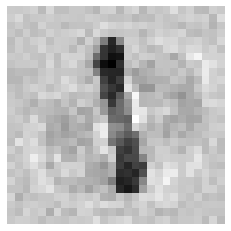

[3869] (예측값)3 (실제값)9


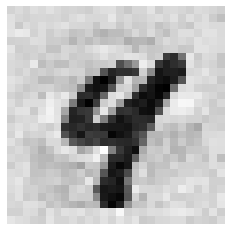

[3870] (예측값)6 (실제값)0


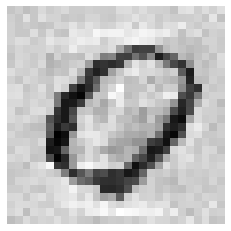

[3871] (예측값)5 (실제값)8


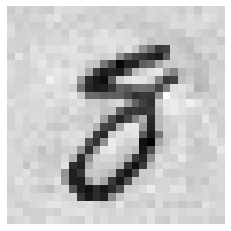

[3872] (예측값)6 (실제값)9


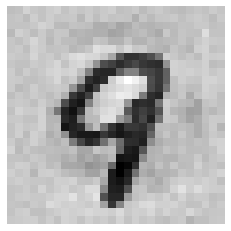

[3874] (예측값)8 (실제값)9


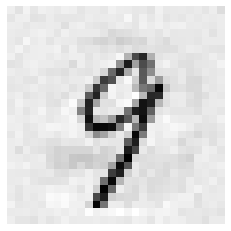

[3876] (예측값)0 (실제값)2


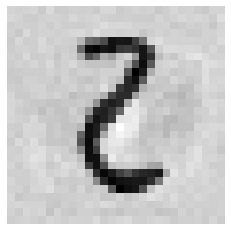

[3878] (예측값)1 (실제값)7


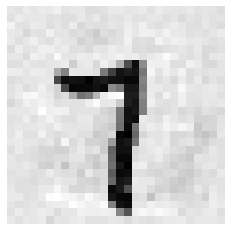

[3884] (예측값)8 (실제값)9


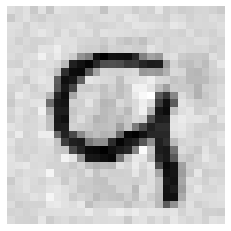

[3889] (예측값)4 (실제값)9


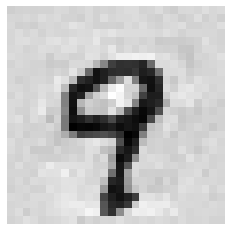

[3891] (예측값)7 (실제값)9


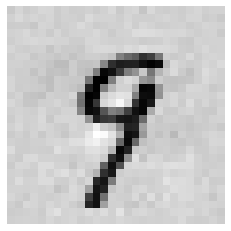

[3892] (예측값)9 (실제값)8


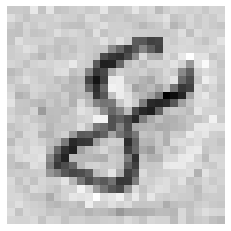

[3894] (예측값)2 (실제값)1


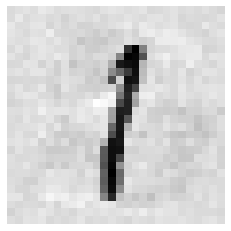

[3895] (예측값)3 (실제값)0


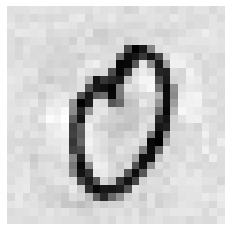

[3896] (예측값)4 (실제값)3


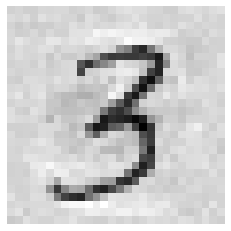

[3897] (예측값)5 (실제값)3


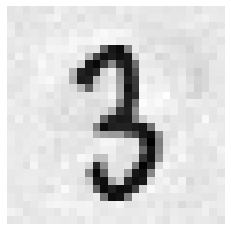

[3906] (예측값)2 (실제값)1


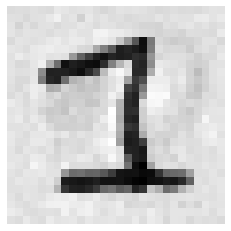

[3915] (예측값)5 (실제값)4


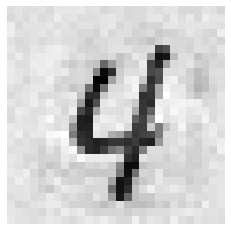

[3919] (예측값)9 (실제값)1


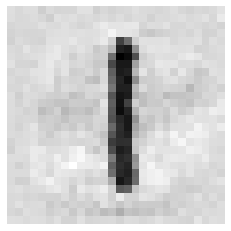

[3920] (예측값)5 (실제값)7


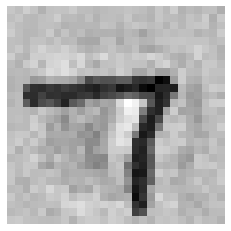

[3923] (예측값)5 (실제값)6


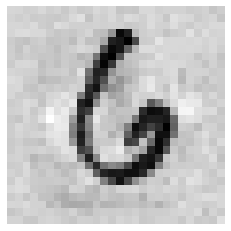

[3924] (예측값)4 (실제값)9


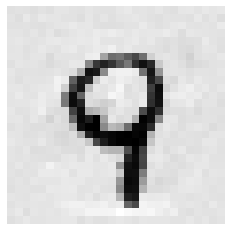

[3926] (예측값)8 (실제값)9


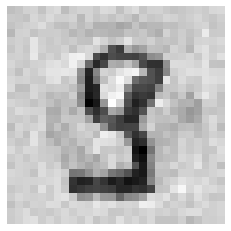

[3927] (예측값)7 (실제값)9


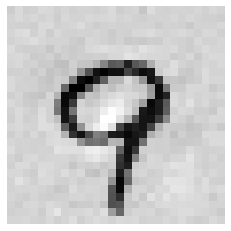

[3928] (예측값)8 (실제값)5


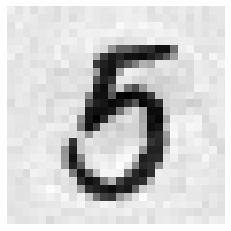

[3929] (예측값)8 (실제값)5


[3930] (예측값)7 (실제값)1


[3934] (예측값)5 (실제값)8


[3936] (예측값)8 (실제값)7


[3937] (예측값)9 (실제값)1


[3941] (예측값)3 (실제값)4


[3942] (예측값)4 (실제값)0


[3943] (예측값)5 (실제값)3


[3944] (예측값)6 (실제값)3


[3946] (예측값)8 (실제값)2


[3948] (예측값)0 (실제값)6


[3950] (예측값)7 (실제값)9


[3951] (예측값)3 (실제값)8


[3954] (예측값)6 (실제값)8


[3955] (예측값)7 (실제값)5


[3961] (예측값)3 (실제값)6


[3962] (예측값)4 (실제값)3


[3963] (예측값)5 (실제값)2


[3966] (예측값)8 (실제값)9


[3967] (예측값)0 (실제값)9


[3968] (예측값)3 (실제값)5


[3969] (예측값)2 (실제값)7


[3970] (예측값)3 (실제값)9


[3974] (예측값)9 (실제값)1


[3976] (예측값)1 (실제값)7


[3977] (예측값)2 (실제값)3


[3978] (예측값)3 (실제값)6


[3979] (예측값)4 (실제값)6


[3980] (예측값)5 (실제값)0


[3983] (예측값)8 (실제값)1


[3984] (예측값)8 (실제값)9


[3985] (예측값)4 (실제값)9


[3986] (예측값)3 (실제값)2


[3988] (예측값)5 (실제값)8


[3990] (예측값)7 (실제값)1


[3997] (예측값)6 (실제값)7


[3998] (예측값)7 (실제값)4


[4000] (예측값)5 (실제값)9


[4007] (예측값)4 (실제값)7


[4011] (예측값)3 (실제값)8


[4013] (예측값)6 (실제값)1


[4015] (예측값)8 (실제값)9


[4016] (예측값)7 (실제값)9


[4017] (예측값)1 (실제값)4


[4019] (예측값)3 (실제값)6


[4021] (예측값)5 (실제값)1


[4023] (예측값)8 (실제값)0


[4024] (예측값)9 (실제값)4


[4025] (예측값)7 (실제값)1


[4027] (예측값)2 (실제값)7


[4030] (예측값)6 (실제값)9


[4032] (예측값)8 (실제값)1


[4036] (예측값)3 (실제값)1


[4039] (예측값)6 (실제값)1


[4042] (예측값)9 (실제값)4


[4047] (예측값)6 (실제값)9


[4050] (예측값)9 (실제값)1


[4051] (예측값)0 (실제값)6


[4052] (예측값)1 (실제값)5


[4053] (예측값)2 (실제값)7


[4058] (예측값)9 (실제값)8


[4061] (예측값)2 (실제값)7


[4065] (예측값)6 (실제값)0


[4069] (예측값)9 (실제값)1


[4071] (예측값)7 (실제값)4


[4072] (예측값)3 (실제값)5


[4075] (예측값)6 (실제값)8


[4078] (예측값)3 (실제값)9


[4081] (예측값)3 (실제값)6


[4088] (예측값)8 (실제값)9


[4090] (예측값)3 (실제값)0


[4093] (예측값)4 (실제값)9


[4094] (예측값)7 (실제값)5


[4096] (예측값)9 (실제값)8


[4107] (예측값)2 (실제값)7


[4110] (예측값)3 (실제값)1


[4111] (예측값)4 (실제값)9


[4118] (예측값)3 (실제값)5


[4123] (예측값)2 (실제값)8


[4124] (예측값)9 (실제값)8


[4125] (예측값)0 (실제값)6


[4128] (예측값)4 (실제값)3


[4130] (예측값)6 (실제값)7


[4131] (예측값)7 (실제값)5


[4134] (예측값)0 (실제값)9


[4135] (예측값)1 (실제값)2


[4138] (예측값)4 (실제값)1


[4141] (예측값)7 (실제값)8


[4143] (예측값)0 (실제값)9


[4148] (예측값)6 (실제값)7


[4151] (예측값)9 (실제값)7


[4152] (예측값)0 (실제값)5


[4160] (예측값)0 (실제값)6


[4163] (예측값)3 (실제값)9


[4165] (예측값)5 (실제값)8


[4166] (예측값)6 (실제값)0


[4169] (예측값)9 (실제값)1


[4170] (예측값)7 (실제값)1


[4173] (예측값)4 (실제값)2


[4174] (예측값)5 (실제값)9


[4176] (예측값)7 (실제값)2


[4178] (예측값)9 (실제값)1


[4179] (예측값)9 (실제값)1


[4180] (예측값)1 (실제값)2


[4183] (예측값)4 (실제값)9


[4184] (예측값)5 (실제값)9


[4188] (예측값)9 (실제값)0


[4191] (예측값)3 (실제값)1


[4193] (예측값)7 (실제값)6


[4195] (예측값)9 (실제값)1


[4197] (예측값)8 (실제값)4


[4198] (예측값)2 (실제값)9


[4199] (예측값)3 (실제값)7


[4200] (예측값)4 (실제값)7


[4201] (예측값)5 (실제값)1


[4205] (예측값)7 (실제값)2


[4210] (예측값)4 (실제값)9


[4211] (예측값)5 (실제값)6


[4212] (예측값)6 (실제값)1


[4214] (예측값)5 (실제값)7


[4215] (예측값)9 (실제값)7


[4216] (예측값)0 (실제값)1


[4218] (예측값)2 (실제값)8


[4220] (예측값)8 (실제값)3


[4224] (예측값)8 (실제값)9


[4228] (예측값)2 (실제값)7


[4229] (예측값)3 (실제값)4


[4231] (예측값)5 (실제값)8


[4232] (예측값)6 (실제값)1


[4233] (예측값)7 (실제값)5


[4237] (예측값)8 (실제값)9


[4238] (예측값)3 (실제값)7


[4239] (예측값)4 (실제값)6


[4245] (예측값)2 (실제값)9


[4248] (예측값)4 (실제값)2


[4249] (예측값)5 (실제값)1


[4255] (예측값)3 (실제값)5


[4258] (예측값)5 (실제값)4


[4259] (예측값)6 (실제값)9


[4261] (예측값)8 (실제값)5


[4265] (예측값)3 (실제값)4


[4267] (예측값)6 (실제값)1


[4268] (예측값)7 (실제값)4


[4270] (예측값)9 (실제값)3


[4272] (예측값)2 (실제값)9


[4276] (예측값)5 (실제값)3


[4283] (예측값)3 (실제값)9


[4284] (예측값)4 (실제값)9


[4285] (예측값)5 (실제값)6


[4289] (예측값)7 (실제값)2


[4294] (예측값)4 (실제값)9


[4298] (예측값)5 (실제값)9


[4299] (예측값)8 (실제값)9


[4300] (예측값)6 (실제값)5


[4301] (예측값)2 (실제값)9


[4303] (예측값)5 (실제값)1


[4306] (예측값)7 (실제값)3


[4307] (예측값)9 (실제값)5


[4308] (예측값)7 (실제값)1


[4311] (예측값)4 (실제값)3


[4313] (예측값)7 (실제값)4


[4314] (예측값)8 (실제값)9


[4316] (예측값)0 (실제값)9


[4318] (예측값)2 (실제값)1


[4322] (예측값)6 (실제값)7


[4323] (예측값)7 (실제값)5


[4327] (예측값)2 (실제값)0


[4330] (예측값)6 (실제값)5


[4331] (예측값)7 (실제값)1


[4332] (예측값)8 (실제값)4


[4333] (예측값)0 (실제값)9


[4335] (예측값)2 (실제값)3


[4340] (예측값)8 (실제값)5


[4341] (예측값)9 (실제값)2


[4343] (예측값)3 (실제값)0


[4344] (예측값)2 (실제값)9


[4347] (예측값)5 (실제값)6


[4350] (예측값)8 (실제값)2


[4353] (예측값)2 (실제값)0


[4354] (예측값)3 (실제값)2


[4355] (예측값)3 (실제값)5


[4357] (예측값)5 (실제값)7


[4360] (예측값)3 (실제값)5


[4363] (예측값)5 (실제값)9


[4369] (예측값)1 (실제값)9


[4370] (예측값)2 (실제값)0


[4373] (예측값)5 (실제값)4


[4374] (예측값)6 (실제값)5


[4375] (예측값)0 (실제값)8


[4377] (예측값)9 (실제값)4


[4379] (예측값)2 (실제값)4


[4382] (예측값)5 (실제값)4


[4390] (예측값)3 (실제값)8


[4392] (예측값)5 (실제값)0


[4393] (예측값)6 (실제값)3


[4394] (예측값)7 (실제값)6


[4396] (예측값)9 (실제값)4


[4399] (예측값)2 (실제값)8


[4400] (예측값)3 (실제값)7


[4403] (예측값)6 (실제값)0


[4405] (예측값)8 (실제값)9


[4407] (예측값)0 (실제값)9


[4408] (예측값)2 (실제값)9


[4409] (예측값)2 (실제값)1


[4410] (예측값)3 (실제값)9


[4413] (예측값)0 (실제값)6


[4415] (예측값)0 (실제값)2


[4417] (예측값)2 (실제값)9


[4424] (예측값)0 (실제값)9


[4425] (예측값)4 (실제값)9


[4427] (예측값)3 (실제값)2


[4428] (예측값)4 (실제값)1


[4429] (예측값)5 (실제값)8


[4432] (예측값)8 (실제값)0


[4435] (예측값)1 (실제값)3


[4437] (예측값)4 (실제값)3


[4439] (예측값)7 (실제값)6


[4443] (예측값)1 (실제값)3


[4449] (예측값)0 (실제값)6


[4452] (예측값)0 (실제값)8


[4453] (예측값)1 (실제값)7


[4455] (예측값)9 (실제값)8


[4463] (예측값)2 (실제값)5


[4468] (예측값)9 (실제값)4


[4475] (예측값)6 (실제값)4


[4477] (예측값)8 (실제값)0


[4479] (예측값)5 (실제값)9


[4480] (예측값)4 (실제값)9


[4481] (예측값)2 (실제값)4


[4483] (예측값)5 (실제값)4


[4486] (예측값)9 (실제값)8


[4490] (예측값)9 (실제값)4


[4493] (예측값)6 (실제값)7


[4497] (예측값)2 (실제값)8


[4498] (예측값)6 (실제값)7


[4499] (예측값)2 (실제값)6


[4504] (예측값)7 (실제값)2


[4507] (예측값)0 (실제값)1


[4511] (예측값)4 (실제값)9


[4513] (예측값)6 (실제값)8


[4515] (예측값)8 (실제값)0


[4516] (예측값)9 (실제값)1


[4522] (예측값)5 (실제값)7


[4524] (예측값)7 (실제값)1


[4534] (예측값)7 (실제값)9


[4536] (예측값)5 (실제값)6


[4547] (예측값)2 (실제값)6


[4548] (예측값)2 (실제값)5


[4549] (예측값)3 (실제값)2


[4551] (예측값)5 (실제값)7


[4552] (예측값)0 (실제값)3


[4556] (예측값)1 (실제값)9


[4558] (예측값)9 (실제값)4


[4561] (예측값)6 (실제값)7


[4564] (예측값)9 (실제값)1


[4565] (예측값)0 (실제값)6


[4567] (예측값)2 (실제값)4


[4568] (예측값)3 (실제값)7


[4572] (예측값)9 (실제값)8


[4575] (예측값)3 (실제값)4


[4576] (예측값)5 (실제값)4


[4577] (예측값)6 (실제값)5


[4578] (예측값)9 (실제값)7


[4579] (예측값)9 (실제값)6


[4580] (예측값)7 (실제값)1


[4585] (예측값)4 (실제값)9


[4587] (예측값)4 (실제값)6


[4588] (예측값)9 (실제값)1


[4589] (예측값)0 (실제값)1


[4597] (예측값)8 (실제값)1


[4598] (예측값)9 (실제값)4


[4599] (예측값)0 (실제값)6


[4601] (예측값)4 (실제값)8


[4602] (예측값)3 (실제값)1


[4605] (예측값)6 (실제값)3


[4606] (예측값)7 (실제값)1


[4608] (예측값)9 (실제값)8


[4609] (예측값)9 (실제값)4


[4610] (예측값)3 (실제값)9


[4612] (예측값)3 (실제값)7


[4614] (예측값)5 (실제값)0


[4616] (예측값)7 (실제값)9


[4617] (예측값)8 (실제값)0


[4619] (예측값)0 (실제값)6


[4620] (예측값)5 (실제값)6


[4626] (예측값)7 (실제값)8


[4627] (예측값)5 (실제값)6


[4629] (예측값)0 (실제값)8


[4632] (예측값)3 (실제값)2


[4633] (예측값)4 (실제값)9


[4635] (예측값)6 (실제값)3


[4639] (예측값)5 (실제값)8


[4641] (예측값)2 (실제값)0


[4642] (예측값)3 (실제값)0


[4643] (예측값)4 (실제값)1


[4644] (예측값)5 (실제값)9


[4646] (예측값)7 (실제값)1


[4648] (예측값)5 (실제값)9


[4651] (예측값)3 (실제값)1


[4653] (예측값)6 (실제값)1


[4655] (예측값)9 (실제값)1


[4656] (예측값)4 (실제값)2


[4658] (예측값)2 (실제값)7


[4660] (예측값)4 (실제값)7


[4664] (예측값)8 (실제값)3


[4665] (예측값)5 (실제값)9


[4669] (예측값)9 (실제값)7


[4670] (예측값)5 (실제값)1


[4673] (예측값)8 (실제값)9


[4674] (예측값)9 (실제값)1


[4677] (예측값)3 (실제값)7


[4679] (예측값)5 (실제값)9


[4680] (예측값)7 (실제값)6


[4682] (예측값)5 (실제값)9


[4683] (예측값)2 (실제값)9


[4687] (예측값)6 (실제값)1


[4691] (예측값)6 (실제값)1


[4692] (예측값)3 (실제값)9


[4693] (예측값)2 (실제값)7


[4695] (예측값)5 (실제값)4


[4698] (예측값)4 (실제값)6


[4699] (예측값)0 (실제값)6


[4700] (예측값)1 (실제값)9


[4702] (예측값)2 (실제값)6


[4711] (예측값)8 (실제값)5


[4713] (예측값)3 (실제값)2


[4719] (예측값)4 (실제값)1


[4720] (예측값)5 (실제값)0


[4721] (예측값)6 (실제값)4


[4722] (예측값)7 (실제값)5


[4724] (예측값)9 (실제값)8


[4731] (예측값)6 (실제값)8


[4732] (예측값)7 (실제값)1


[4733] (예측값)8 (실제값)1


[4735] (예측값)5 (실제값)9


[4739] (예측값)4 (실제값)0


[4740] (예측값)5 (실제값)3


[4741] (예측값)6 (실제값)0


[4743] (예측값)9 (실제값)8


[4744] (예측값)0 (실제값)8


[4746] (예측값)5 (실제값)7


[4750] (예측값)7 (실제값)8


[4752] (예측값)0 (실제값)9


[4755] (예측값)4 (실제값)3


[4759] (예측값)8 (실제값)1


[4761] (예측값)7 (실제값)9


[4764] (예측값)3 (실제값)1


[4768] (예측값)9 (실제값)4


[4769] (예측값)5 (실제값)9


[4772] (예측값)3 (실제값)4


[4774] (예측값)5 (실제값)1


[4777] (예측값)9 (실제값)8


[4778] (예측값)7 (실제값)1


[4780] (예측값)2 (실제값)0


[4781] (예측값)3 (실제값)7


[4782] (예측값)4 (실제값)3


[4784] (예측값)6 (실제값)7


[4785] (예측값)7 (실제값)3


[4786] (예측값)8 (실제값)9


[4794] (예측값)6 (실제값)7


[4796] (예측값)8 (실제값)3


[4798] (예측값)0 (실제값)6


[4799] (예측값)2 (실제값)9


[4806] (예측값)8 (실제값)1


[4807] (예측값)3 (실제값)8


[4808] (예측값)5 (실제값)3


[4812] (예측값)1 (실제값)2


[4814] (예측값)7 (실제값)6


[4815] (예측값)8 (실제값)7


[4816] (예측값)9 (실제값)2


[4817] (예측값)0 (실제값)8


[4820] (예측값)3 (실제값)8


[4822] (예측값)5 (실제값)8


[4823] (예측값)6 (실제값)9


[4825] (예측값)9 (실제값)8


[4826] (예측값)9 (실제값)4


[4828] (예측값)8 (실제값)5


[4829] (예측값)3 (실제값)8


[4830] (예측값)4 (실제값)5


[4835] (예측값)5 (실제값)9


[4837] (예측값)2 (실제값)7


[4838] (예측값)5 (실제값)6


[4840] (예측값)5 (실제값)9


[4842] (예측값)9 (실제값)4


[4843] (예측값)8 (실제값)9


[4846] (예측값)2 (실제값)9


[4850] (예측값)5 (실제값)8


[4851] (예측값)0 (실제값)6


[4852] (예측값)9 (실제값)8


[4860] (예측값)7 (실제값)4


[4861] (예측값)8 (실제값)7


[4862] (예측값)9 (실제값)0


[4863] (예측값)2 (실제값)8


[4864] (예측값)2 (실제값)1


[4866] (예측값)5 (실제값)4


[4869] (예측값)9 (실제값)1


[4872] (예측값)3 (실제값)1


[4874] (예측값)5 (실제값)9


[4876] (예측값)4 (실제값)2


[4878] (예측값)0 (실제값)2


[4880] (예측값)6 (실제값)0


[4883] (예측값)5 (실제값)6


[4884] (예측값)4 (실제값)9


[4885] (예측값)7 (실제값)3


[4886] (예측값)8 (실제값)7


[4890] (예측값)2 (실제값)8


[4891] (예측값)3 (실제값)0


[4893] (예측값)5 (실제값)4


[4894] (예측값)5 (실제값)3


[4897] (예측값)9 (실제값)6


[4898] (예측값)0 (실제값)6


[4900] (예측값)2 (실제값)7


[4901] (예측값)3 (실제값)9


[4902] (예측값)4 (실제값)5


[4904] (예측값)2 (실제값)3


[4917] (예측값)2 (실제값)1


[4920] (예측값)8 (실제값)2


[4921] (예측값)6 (실제값)7


[4929] (예측값)5 (실제값)4


[4936] (예측값)2 (실제값)7


[4937] (예측값)9 (실제값)0


[4938] (예측값)4 (실제값)7


[4940] (예측값)5 (실제값)3


[4942] (예측값)8 (실제값)5


[4943] (예측값)8 (실제값)2


[4944] (예측값)0 (실제값)2


[4945] (예측값)3 (실제값)9


[4946] (예측값)2 (실제값)4


[4948] (예측값)4 (실제값)8


[4951] (예측값)7 (실제값)1


[4952] (예측값)5 (실제값)6


[4953] (예측값)9 (실제값)1


[4956] (예측값)2 (실제값)8


[4963] (예측값)0 (실제값)9


[4966] (예측값)4 (실제값)7


[4967] (예측값)5 (실제값)9


[4968] (예측값)6 (실제값)9


[4972] (예측값)0 (실제값)1


[4974] (예측값)2 (실제값)4


[4975] (예측값)3 (실제값)9


[4976] (예측값)5 (실제값)4


[4978] (예측값)7 (실제값)8


[4980] (예측값)9 (실제값)6


[4984] (예측값)3 (실제값)1


[4986] (예측값)5 (실제값)8


[4987] (예측값)6 (실제값)4


[4990] (예측값)9 (실제값)3


[4991] (예측값)0 (실제값)7


[4992] (예측값)2 (실제값)0


[4993] (예측값)2 (실제값)7


[4997] (예측값)6 (실제값)2


[4998] (예측값)7 (실제값)4


[5002] (예측값)4 (실제값)9


[5005] (예측값)4 (실제값)1


[5009] (예측값)0 (실제값)9


[5011] (예측값)2 (실제값)8


[5014] (예측값)5 (실제값)1


[5015] (예측값)6 (실제값)9


[5017] (예측값)8 (실제값)9


[5022] (예측값)3 (실제값)9


[5023] (예측값)9 (실제값)4


[5024] (예측값)6 (실제값)2


[5027] (예측값)9 (실제값)4


[5029] (예측값)4 (실제값)9


[5031] (예측값)3 (실제값)0


[5035] (예측값)8 (실제값)0


[5036] (예측값)9 (실제값)1


[5037] (예측값)0 (실제값)2


[5039] (예측값)2 (실제값)4


[5040] (예측값)3 (실제값)7


[5042] (예측값)5 (실제값)9


[5047] (예측값)0 (실제값)4


[5048] (예측값)1 (실제값)7


[5052] (예측값)5 (실제값)1


[5057] (예측값)0 (실제값)6


[5058] (예측값)1 (실제값)7


[5062] (예측값)5 (실제값)3


[5063] (예측값)6 (실제값)4


[5065] (예측값)9 (실제값)8


[5066] (예측값)0 (실제값)6


[5067] (예측값)8 (실제값)3


[5070] (예측값)4 (실제값)9


[5073] (예측값)7 (실제값)9


[5075] (예측값)9 (실제값)8


[5076] (예측값)0 (실제값)4


[5077] (예측값)1 (실제값)7


[5078] (예측값)2 (실제값)3


[5080] (예측값)4 (실제값)9


[5081] (예측값)5 (실제값)1


[5085] (예측값)9 (실제값)6


[5086] (예측값)9 (실제값)2


[5089] (예측값)3 (실제값)2


[5091] (예측값)5 (실제값)1


[5092] (예측값)6 (실제값)1


[5093] (예측값)7 (실제값)1


[5099] (예측값)8 (실제값)2


[5100] (예측값)4 (실제값)9


[5103] (예측값)7 (실제값)8


[5106] (예측값)0 (실제값)9


[5110] (예측값)4 (실제값)7


[5114] (예측값)9 (실제값)7


[5115] (예측값)0 (실제값)6


[5121] (예측값)6 (실제값)7


[5129] (예측값)5 (실제값)8


[5130] (예측값)6 (실제값)9


[5131] (예측값)0 (실제값)6


[5135] (예측값)7 (실제값)9


[5137] (예측값)3 (실제값)9


[5138] (예측값)4 (실제값)8


[5140] (예측값)6 (실제값)3


[5142] (예측값)9 (실제값)8


[5144] (예측값)4 (실제값)9


[5148] (예측값)6 (실제값)1


[5150] (예측값)8 (실제값)3


[5151] (예측값)9 (실제값)4


[5154] (예측값)2 (실제값)7


[5156] (예측값)4 (실제값)1


[5159] (예측값)7 (실제값)4


[5164] (예측값)5 (실제값)9


[5165] (예측값)3 (실제값)0


[5171] (예측값)4 (실제값)6


[5176] (예측값)4 (실제값)8


[5177] (예측값)5 (실제값)7


[5180] (예측값)9 (실제값)7


[5182] (예측값)3 (실제값)9


[5183] (예측값)2 (실제값)8


[5186] (예측값)5 (실제값)1


[5191] (예측값)9 (실제값)4


[5193] (예측값)2 (실제값)1


[5202] (예측값)3 (실제값)4


[5204] (예측값)5 (실제값)8


[5208] (예측값)9 (실제값)1


[5209] (예측값)0 (실제값)8


[5210] (예측값)4 (실제값)9


[5211] (예측값)2 (실제값)1


[5213] (예측값)5 (실제값)6


[5214] (예측값)8 (실제값)3


[5217] (예측값)8 (실제값)2


[5218] (예측값)0 (실제값)6


[5219] (예측값)8 (실제값)9


[5225] (예측값)8 (실제값)3


[5226] (예측값)9 (실제값)8


[5231] (예측값)4 (실제값)8


[5232] (예측값)5 (실제값)1


[5233] (예측값)6 (실제값)9


[5236] (예측값)5 (실제값)8


[5238] (예측값)2 (실제값)7


[5239] (예측값)3 (실제값)4


[5240] (예측값)4 (실제값)7


[5242] (예측값)6 (실제값)9


[5244] (예측값)8 (실제값)0


[5246] (예측값)2 (실제값)7


[5249] (예측값)3 (실제값)0


[5250] (예측값)8 (실제값)2


[5258] (예측값)2 (실제값)1


[5261] (예측값)2 (실제값)7


[5262] (예측값)7 (실제값)9


[5269] (예측값)5 (실제값)9


[5271] (예측값)7 (실제값)1


[5273] (예측값)9 (실제값)3


[5277] (예측값)3 (실제값)7


[5280] (예측값)6 (실제값)0


[5281] (예측값)7 (실제값)1


[5288] (예측값)9 (실제값)8


[5289] (예측값)5 (실제값)9


[5291] (예측값)7 (실제값)1


[5292] (예측값)8 (실제값)2


[5293] (예측값)9 (실제값)3


[5310] (예측값)6 (실제값)7


[5311] (예측값)7 (실제값)9


[5314] (예측값)0 (실제값)1


[5316] (예측값)2 (실제값)1


[5323] (예측값)9 (실제값)1


[5327] (예측값)3 (실제값)1


[5329] (예측값)5 (실제값)3


[5331] (예측값)7 (실제값)1


[5333] (예측값)5 (실제값)9


[5360] (예측값)7 (실제값)8


[5361] (예측값)2 (실제값)1


[5363] (예측값)4 (실제값)7


[5366] (예측값)9 (실제값)2


[5367] (예측값)0 (실제값)2


[5370] (예측값)3 (실제값)1


[5371] (예측값)9 (실제값)7


[5373] (예측값)4 (실제값)9


[5376] (예측값)9 (실제값)8


[5380] (예측값)3 (실제값)8


[5382] (예측값)5 (실제값)3


[5394] (예측값)9 (실제값)8


[5395] (예측값)9 (실제값)4


[5401] (예측값)0 (실제값)6


[5403] (예측값)9 (실제값)8


[5404] (예측값)0 (실제값)9


[5406] (예측값)2 (실제값)1


[5407] (예측값)3 (실제값)2


[5409] (예측값)6 (실제값)4


[5413] (예측값)9 (실제값)8


[5414] (예측값)5 (실제값)9


[5415] (예측값)5 (실제값)0


[5416] (예측값)2 (실제값)1


[5417] (예측값)3 (실제값)2


[5422] (예측값)5 (실제값)7


[5423] (예측값)9 (실제값)8


[5424] (예측값)0 (실제값)9


[5426] (예측값)2 (실제값)4


[5427] (예측값)3 (실제값)2


[5431] (예측값)7 (실제값)1


[5434] (예측값)0 (실제값)8


[5436] (예측값)3 (실제값)2


[5438] (예측값)5 (실제값)8


[5440] (예측값)7 (실제값)4


[5446] (예측값)4 (실제값)3


[5447] (예측값)5 (실제값)9


[5450] (예측값)5 (실제값)0


[5456] (예측값)2 (실제값)9


[5457] (예측값)8 (실제값)1


[5460] (예측값)7 (실제값)1


[5465] (예측값)6 (실제값)7


[5468] (예측값)0 (실제값)3


[5471] (예측값)3 (실제값)7


[5473] (예측값)6 (실제값)5


[5476] (예측값)9 (실제값)4


[5477] (예측값)0 (실제값)1


[5482] (예측값)5 (실제값)7


[5490] (예측값)3 (실제값)1


[5491] (예측값)4 (실제값)9


[5495] (예측값)3 (실제값)8


[5499] (예측값)3 (실제값)1


[5502] (예측값)8 (실제값)2


[5512] (예측값)9 (실제값)7


[5528] (예측값)6 (실제값)5


[5530] (예측값)9 (실제값)8


[5532] (예측값)1 (실제값)7


[5535] (예측값)4 (실제값)1


[5540] (예측값)9 (실제값)7


[5543] (예측값)2 (실제값)8


[5544] (예측값)3 (실제값)1


[5545] (예측값)6 (실제값)2


[5546] (예측값)4 (실제값)9


[5547] (예측값)6 (실제값)8


[5548] (예측값)9 (실제값)8


[5550] (예측값)9 (실제값)1


[5553] (예측값)3 (실제값)1


[5555] (예측값)5 (실제값)3


[5559] (예측값)9 (실제값)4


[5560] (예측값)5 (실제값)7


[5562] (예측값)3 (실제값)2


[5566] (예측값)7 (실제값)1


[5572] (예측값)3 (실제값)5


[5573] (예측값)5 (실제값)3


[5575] (예측값)7 (실제값)9


[5577] (예측값)9 (실제값)4


[5578] (예측값)0 (실제값)8


[5580] (예측값)2 (실제값)9


[5581] (예측값)3 (실제값)6


[5583] (예측값)5 (실제값)3


[5586] (예측값)0 (실제값)8


[5590] (예측값)4 (실제값)1


[5592] (예측값)6 (실제값)0


[5594] (예측값)8 (실제값)1


[5595] (예측값)8 (실제값)2


[5600] (예측값)4 (실제값)7


[5601] (예측값)5 (실제값)8


[5605] (예측값)8 (실제값)2


[5608] (예측값)2 (실제값)5


[5610] (예측값)4 (실제값)7


[5611] (예측값)5 (실제값)8


[5612] (예측값)6 (실제값)9


[5614] (예측값)8 (실제값)1


[5620] (예측값)4 (실제값)7


[5621] (예측값)5 (실제값)8


[5622] (예측값)6 (실제값)9


[5623] (예측값)0 (실제값)3


[5627] (예측값)3 (실제값)9


[5634] (예측값)8 (실제값)2


[5636] (예측값)8 (실제값)2


[5639] (예측값)5 (실제값)9


[5640] (예측값)6 (실제값)7


[5641] (예측값)3 (실제값)2


[5642] (예측값)8 (실제값)1


[5645] (예측값)3 (실제값)9


[5653] (예측값)9 (실제값)0


[5662] (예측값)9 (실제값)5


[5663] (예측값)0 (실제값)7


[5666] (예측값)3 (실제값)1


[5670] (예측값)5 (실제값)7


[5671] (예측값)0 (실제값)9


[5672] (예측값)4 (실제값)9


[5676] (예측값)6 (실제값)4


[5677] (예측값)7 (실제값)4


[5679] (예측값)7 (실제값)1


[5687] (예측값)8 (실제값)3


[5688] (예측값)9 (실제값)7


[5689] (예측값)7 (실제값)1


[5692] (예측값)3 (실제값)2


[5695] (예측값)6 (실제값)0


[5698] (예측값)9 (실제값)4


[5699] (예측값)7 (실제값)1


[5705] (예측값)6 (실제값)9


[5706] (예측값)7 (실제값)5


[5707] (예측값)8 (실제값)9


[5714] (예측값)6 (실제값)7


[5719] (예측값)2 (실제값)9


[5720] (예측값)1 (실제값)4


[5726] (예측값)8 (실제값)5


[5728] (예측값)5 (실제값)7


[5731] (예측값)3 (실제값)0


[5734] (예측값)2 (실제값)3


[5735] (예측값)7 (실제값)5


[5736] (예측값)4 (실제값)6


[5737] (예측값)9 (실제값)0


[5738] (예측값)5 (실제값)1


[5744] (예측값)6 (실제값)8


[5747] (예측값)0 (실제값)3


[5749] (예측값)2 (실제값)8


[5750] (예측값)3 (실제값)0


[5757] (예측값)7 (실제값)9


[5759] (예측값)3 (실제값)1


[5762] (예측값)6 (실제값)1


[5764] (예측값)8 (실제값)3


[5769] (예측값)3 (실제값)5


[5772] (예측값)6 (실제값)2


[5774] (예측값)9 (실제값)4


[5782] (예측값)9 (실제값)4


[5784] (예측값)4 (실제값)9


[5787] (예측값)5 (실제값)9


[5790] (예측값)5 (실제값)9


[5801] (예측값)3 (실제값)6


[5802] (예측값)3 (실제값)5


[5805] (예측값)5 (실제값)9


[5806] (예측값)6 (실제값)0


[5809] (예측값)9 (실제값)1


[5810] (예측값)0 (실제값)6


[5811] (예측값)2 (실제값)1


[5812] (예측값)3 (실제값)0


[5815] (예측값)6 (실제값)3


[5819] (예측값)0 (실제값)6


[5832] (예측값)2 (실제값)4


[5835] (예측값)6 (실제값)7


[5839] (예측값)0 (실제값)1


[5842] (예측값)3 (실제값)4


[5845] (예측값)6 (실제값)7


[5848] (예측값)9 (실제값)1


[5854] (예측값)9 (실제값)7


[5855] (예측값)0 (실제값)8


[5856] (예측값)7 (실제값)9


[5857] (예측값)9 (실제값)8


[5858] (예측값)2 (실제값)7


[5866] (예측값)2 (실제값)7


[5868] (예측값)3 (실제값)9


[5869] (예측값)4 (실제값)9


[5870] (예측값)5 (실제값)0


[5871] (예측값)6 (실제값)9


[5872] (예측값)7 (실제값)1


[5874] (예측값)9 (실제값)5


[5875] (예측값)0 (실제값)8


[5881] (예측값)7 (실제값)8


[5885] (예측값)1 (실제값)5


[5887] (예측값)3 (실제값)7


[5888] (예측값)5 (실제값)4


[5891] (예측값)8 (실제값)5


[5893] (예측값)7 (실제값)1


[5894] (예측값)3 (실제값)9


[5901] (예측값)0 (실제값)6


[5903] (예측값)3 (실제값)7


[5904] (예측값)4 (실제값)3


[5906] (예측값)6 (실제값)7


[5908] (예측값)8 (실제값)9


[5909] (예측값)9 (실제값)6


[5913] (예측값)3 (실제값)5


[5914] (예측값)4 (실제값)7


[5916] (예측값)7 (실제값)6


[5918] (예측값)9 (실제값)0


[5921] (예측값)3 (실제값)2


[5927] (예측값)9 (실제값)4


[5928] (예측값)2 (실제값)6


[5929] (예측값)2 (실제값)0


[5934] (예측값)6 (실제값)2


[5935] (예측값)7 (실제값)3


[5936] (예측값)9 (실제값)4


[5937] (예측값)9 (실제값)5


[5939] (예측값)1 (실제값)7


[5940] (예측값)2 (실제값)8


[5944] (예측값)6 (실제값)2


[5949] (예측값)3 (실제값)7


[5951] (예측값)3 (실제값)9


[5955] (예측값)9 (실제값)3


[5956] (예측값)8 (실제값)4


[5958] (예측값)4 (실제값)6


[5959] (예측값)1 (실제값)7


[5961] (예측값)3 (실제값)9


[5964] (예측값)6 (실제값)5


[5971] (예측값)3 (실제값)9


[5972] (예측값)8 (실제값)5


[5973] (예측값)5 (실제값)3


[5975] (예측값)9 (실제값)4


[5982] (예측값)3 (실제값)5


[5984] (예측값)9 (실제값)1


[5985] (예측값)8 (실제값)5


[5988] (예측값)3 (실제값)7


[5990] (예측값)5 (실제값)0


[5992] (예측값)8 (실제값)7


[5995] (예측값)3 (실제값)8


[5997] (예측값)3 (실제값)5


[5998] (예측값)4 (실제값)1


[6000] (예측값)2 (실제값)9


[6005] (예측값)2 (실제값)1


[6006] (예측값)3 (실제값)7


[6009] (예측값)8 (실제값)3


[6012] (예측값)9 (실제값)1


[6013] (예측값)9 (실제값)4


[6015] (예측값)2 (실제값)0


[6016] (예측값)3 (실제값)0


[6019] (예측값)6 (실제값)4


[6020] (예측값)7 (실제값)6


[6021] (예측값)8 (실제값)4


[6023] (예측값)1 (실제값)3


[6024] (예측값)3 (실제값)8


[6025] (예측값)3 (실제값)4


[6026] (예측값)4 (실제값)7


[6027] (예측값)5 (실제값)2


[6028] (예측값)6 (실제값)5


[6030] (예측값)8 (실제값)3


[6031] (예측값)9 (실제값)6


[6033] (예측값)1 (실제값)6


[6034] (예측값)8 (실제값)3


[6035] (예측값)3 (실제값)2


[6037] (예측값)5 (실제값)4


[6038] (예측값)7 (실제값)6


[6039] (예측값)8 (실제값)9


[6042] (예측값)8 (실제값)5


[6043] (예측값)3 (실제값)5


[6044] (예측값)3 (실제값)1


[6045] (예측값)8 (실제값)3


[6046] (예측값)5 (실제값)3


[6048] (예측값)8 (실제값)7


[6049] (예측값)9 (실제값)8


[6050] (예측값)5 (실제값)7


[6053] (예측값)8 (실제값)5


[6054] (예측값)5 (실제값)7


[6056] (예측값)9 (실제값)8


[6057] (예측값)8 (실제값)2


[6059] (예측값)0 (실제값)3


[6063] (예측값)6 (실제값)1


[6065] (예측값)8 (실제값)3


[6066] (예측값)9 (실제값)4


[6071] (예측값)8 (실제값)9


[6073] (예측값)6 (실제값)1


[6075] (예측값)8 (실제값)3


[6076] (예측값)9 (실제값)4


[6081] (예측값)8 (실제값)9


[6083] (예측값)6 (실제값)1


[6086] (예측값)9 (실제값)4


[6091] (예측값)0 (실제값)9


[6092] (예측값)8 (실제값)1


[6103] (예측값)8 (실제값)3


[6107] (예측값)8 (실제값)3


[6108] (예측값)2 (실제값)1


[6112] (예측값)8 (실제값)9


[6115] (예측값)9 (실제값)1


[6118] (예측값)3 (실제값)2


[6124] (예측값)8 (실제값)9


[6139] (예측값)5 (실제값)3


[6141] (예측값)8 (실제값)1


[6157] (예측값)6 (실제값)9


[6159] (예측값)9 (실제값)1


[6160] (예측값)0 (실제값)3


[6163] (예측값)3 (실제값)0


[6166] (예측값)7 (실제값)9


[6167] (예측값)4 (실제값)6


[6168] (예측값)0 (실제값)9


[6173] (예측값)8 (실제값)9


[6174] (예측값)5 (실제값)3


[6178] (예측값)0 (실제값)8


[6180] (예측값)3 (실제값)2


[6182] (예측값)5 (실제값)1


[6185] (예측값)8 (실제값)4


[6192] (예측값)5 (실제값)1


[6197] (예측값)4 (실제값)6


[6202] (예측값)5 (실제값)1


[6212] (예측값)5 (실제값)8


[6214] (예측값)7 (실제값)9


[6221] (예측값)4 (실제값)9


[6222] (예측값)5 (실제값)1


[6223] (예측값)6 (실제값)7


[6224] (예측값)7 (실제값)1


[6225] (예측값)8 (실제값)2


[6228] (예측값)5 (실제값)9


[6232] (예측값)5 (실제값)1


[6233] (예측값)6 (실제값)1


[6235] (예측값)8 (실제값)9


[6236] (예측값)9 (실제값)5


[6237] (예측값)4 (실제값)6


[6239] (예측값)2 (실제값)1


[6242] (예측값)5 (실제값)7


[6243] (예측값)6 (실제값)7


[6245] (예측값)9 (실제값)8


[6246] (예측값)0 (실제값)2


[6249] (예측값)3 (실제값)9


[6252] (예측값)7 (실제값)6


[6254] (예측값)9 (실제값)1


[6263] (예측값)5 (실제값)7


[6267] (예측값)4 (실제값)7


[6269] (예측값)6 (실제값)7


[6273] (예측값)0 (실제값)4


[6276] (예측값)3 (실제값)1


[6278] (예측값)5 (실제값)1


[6281] (예측값)8 (실제값)2


[6289] (예측값)8 (실제값)3


[6292] (예측값)9 (실제값)7


[6294] (예측값)2 (실제값)6


[6300] (예측값)7 (실제값)4


[6303] (예측값)7 (실제값)9


[6306] (예측값)4 (실제값)7


[6310] (예측값)8 (실제값)1


[6318] (예측값)6 (실제값)9


[6324] (예측값)2 (실제값)5


[6328] (예측값)6 (실제값)0


[6330] (예측값)8 (실제값)2


[6342] (예측값)2 (실제값)0


[6346] (예측값)5 (실제값)7


[6347] (예측값)6 (실제값)8


[6348] (예측값)5 (실제값)8


[6349] (예측값)8 (실제값)3


[6353] (예측값)2 (실제값)7


[6355] (예측값)4 (실제값)6


[6359] (예측값)9 (실제값)8


[6366] (예측값)2 (실제값)7


[6369] (예측값)9 (실제값)4


[6370] (예측값)2 (실제값)3


[6376] (예측값)5 (실제값)9


[6379] (예측값)0 (실제값)3


[6390] (예측값)8 (실제값)5


[6392] (예측값)4 (실제값)5


[6393] (예측값)4 (실제값)9


[6394] (예측값)6 (실제값)9


[6396] (예측값)8 (실제값)4


[6397] (예측값)9 (실제값)1


[6400] (예측값)6 (실제값)0


[6401] (예측값)3 (실제값)9


[6404] (예측값)6 (실제값)8


[6408] (예측값)7 (실제값)1


[6409] (예측값)8 (실제값)9


[6411] (예측값)3 (실제값)9


[6416] (예측값)8 (실제값)9


[6417] (예측값)9 (실제값)4


[6418] (예측값)4 (실제값)2


[6420] (예측값)3 (실제값)9


[6426] (예측값)6 (실제값)0


[6427] (예측값)0 (실제값)4


[6428] (예측값)2 (실제값)0


[6429] (예측값)2 (실제값)0


[6430] (예측값)3 (실제값)1


[6432] (예측값)5 (실제값)3


[6433] (예측값)6 (실제값)4


[6435] (예측값)9 (실제값)8


[6438] (예측값)2 (실제값)1


[6441] (예측값)5 (실제값)7


[6443] (예측값)7 (실제값)9


[6445] (예측값)9 (실제값)1


[6448] (예측값)2 (실제값)4


[6449] (예측값)3 (실제값)7


[6452] (예측값)5 (실제값)7


[6456] (예측값)0 (실제값)1


[6468] (예측값)3 (실제값)1


[6471] (예측값)6 (실제값)7


[6474] (예측값)9 (실제값)4


[6478] (예측값)3 (실제값)0


[6481] (예측값)8 (실제값)3


[6487] (예측값)2 (실제값)9


[6490] (예측값)5 (실제값)7


[6493] (예측값)9 (실제값)8


[6504] (예측값)0 (실제값)3


[6505] (예측값)2 (실제값)9


[6508] (예측값)4 (실제값)9


[6514] (예측값)0 (실제값)8


[6515] (예측값)2 (실제값)1


[6520] (예측값)8 (실제값)9


[6521] (예측값)8 (실제값)2


[6527] (예측값)5 (실제값)1


[6528] (예측값)6 (실제값)2


[6529] (예측값)7 (실제값)4


[6532] (예측값)5 (실제값)0


[6534] (예측값)3 (실제값)2


[6535] (예측값)7 (실제값)3


[6538] (예측값)7 (실제값)6


[6539] (예측값)8 (실제값)7


[6540] (예측값)9 (실제값)1


[6541] (예측값)0 (실제값)2


[6543] (예측값)2 (실제값)4


[6544] (예측값)3 (실제값)5


[6546] (예측값)5 (실제값)0


[6550] (예측값)9 (실제값)6


[6553] (예측값)2 (실제값)4


[6555] (예측값)9 (실제값)8


[6556] (예측값)5 (실제값)1


[6560] (예측값)0 (실제값)9


[6561] (예측값)1 (실제값)7


[6563] (예측값)4 (실제값)3


[6564] (예측값)5 (실제값)3


[6565] (예측값)6 (실제값)9


[6568] (예측값)0 (실제값)9


[6571] (예측값)3 (실제값)9


[6572] (예측값)4 (실제값)1


[6577] (예측값)0 (실제값)7


[6578] (예측값)1 (실제값)8


[6579] (예측값)2 (실제값)4


[6580] (예측값)3 (실제값)0


[6586] (예측값)9 (실제값)7


[6589] (예측값)2 (실제값)7


[6590] (예측값)3 (실제값)0


[6591] (예측값)4 (실제값)6


[6592] (예측값)5 (실제값)9


[6595] (예측값)9 (실제값)8


[6596] (예측값)2 (실제값)6


[6597] (예측값)3 (실제값)0


[6598] (예측값)3 (실제값)5


[6599] (예측값)3 (실제값)7


[6601] (예측값)5 (실제값)1


[6603] (예측값)7 (실제값)8


[6606] (예측값)5 (실제값)7


[6608] (예측값)5 (실제값)9


[6609] (예측값)3 (실제값)7


[6610] (예측값)4 (실제값)9


[6612] (예측값)7 (실제값)8


[6618] (예측값)3 (실제값)1


[6622] (예측값)8 (실제값)1


[6623] (예측값)9 (실제값)1


[6624] (예측값)5 (실제값)3


[6625] (예측값)2 (실제값)8


[6626] (예측값)2 (실제값)4


[6631] (예측값)9 (실제값)8


[6632] (예측값)0 (실제값)9


[6635] (예측값)3 (실제값)2


[6636] (예측값)7 (실제값)3


[6640] (예측값)8 (실제값)7


[6642] (예측값)5 (실제값)9


[6643] (예측값)4 (실제값)0


[6644] (예측값)2 (실제값)1


[6645] (예측값)3 (실제값)2


[6648] (예측값)2 (실제값)7


[6649] (예측값)7 (실제값)8


[6650] (예측값)8 (실제값)9


[6651] (예측값)9 (실제값)0


[6654] (예측값)2 (실제값)8


[6655] (예측값)3 (실제값)9


[6656] (예측값)4 (실제값)9


[6658] (예측값)6 (실제값)9


[6667] (예측값)0 (실제값)6


[6668] (예측값)8 (실제값)6


[6669] (예측값)9 (실제값)6


[6676] (예측값)5 (실제값)3


[6677] (예측값)7 (실제값)2


[6680] (예측값)0 (실제값)1


[6681] (예측값)1 (실제값)3


[6682] (예측값)2 (실제값)9


[6683] (예측값)3 (실제값)1


[6687] (예측값)7 (실제값)4


[6688] (예측값)8 (실제값)1


[6689] (예측값)9 (실제값)4


[6692] (예측값)2 (실제값)9


[6696] (예측값)6 (실제값)4


[6699] (예측값)0 (실제값)4


[6702] (예측값)3 (실제값)1


[6705] (예측값)6 (실제값)4


[6706] (예측값)7 (실제값)5


[6710] (예측값)4 (실제값)9


[6712] (예측값)3 (실제값)1


[6716] (예측값)7 (실제값)5


[6720] (예측값)2 (실제값)1


[6724] (예측값)8 (실제값)7


[6725] (예측값)7 (실제값)8


[6729] (예측값)2 (실제값)1


[6730] (예측값)5 (실제값)7


[6731] (예측값)4 (실제값)7


[6739] (예측값)4 (실제값)3


[6741] (예측값)0 (실제값)7


[6742] (예측값)7 (실제값)4


[6744] (예측값)9 (실제값)2


[6755] (예측값)0 (실제값)8


[6756] (예측값)1 (실제값)7


[6761] (예측값)7 (실제값)4


[6778] (예측값)6 (실제값)9


[6780] (예측값)8 (실제값)4


[6782] (예측값)0 (실제값)6


[6783] (예측값)2 (실제값)1


[6785] (예측값)4 (실제값)2


[6787] (예측값)6 (실제값)9


[6793] (예측값)4 (실제값)9


[6796] (예측값)6 (실제값)2


[6799] (예측값)9 (실제값)1


[6809] (예측값)9 (실제값)1


[6819] (예측값)9 (실제값)1


[6827] (예측값)7 (실제값)9


[6845] (예측값)6 (실제값)7


[6846] (예측값)7 (실제값)6


[6847] (예측값)4 (실제값)6


[6848] (예측값)9 (실제값)1


[6852] (예측값)3 (실제값)7


[6855] (예측값)5 (실제값)7


[6864] (예측값)6 (실제값)8


[6867] (예측값)9 (실제값)4


[6873] (예측값)6 (실제값)3


[6877] (예측값)2 (실제값)0


[6887] (예측값)3 (실제값)9


[6889] (예측값)5 (실제값)8


[6890] (예측값)6 (실제값)4


[6893] (예측값)9 (실제값)6


[6902] (예측값)9 (실제값)1


[6903] (예측값)5 (실제값)9


[6905] (예측값)8 (실제값)9


[6909] (예측값)7 (실제값)5


[6910] (예측값)8 (실제값)9


[6912] (예측값)7 (실제값)2


[6926] (예측값)7 (실제값)6


[6928] (예측값)9 (실제값)1


[6938] (예측값)9 (실제값)1


[6939] (예측값)0 (실제값)2


[6942] (예측값)3 (실제값)5


[6944] (예측값)5 (실제값)7


[6946] (예측값)7 (실제값)9


[6948] (예측값)9 (실제값)1


[6954] (예측값)2 (실제값)7


[6956] (예측값)7 (실제값)9


[6963] (예측값)4 (실제값)7


[6965] (예측값)7 (실제값)5


[6967] (예측값)7 (실제값)9


[6969] (예측값)2 (실제값)1


[6976] (예측값)9 (실제값)1


[6980] (예측값)3 (실제값)9


[6987] (예측값)0 (실제값)6


[6990] (예측값)5 (실제값)4


[6996] (예측값)2 (실제값)9


[6998] (예측값)4 (실제값)9


[7000] (예측값)6 (실제값)1


[7001] (예측값)7 (실제값)2


[7003] (예측값)9 (실제값)5


[7004] (예측값)0 (실제값)8


[7008] (예측값)6 (실제값)9


[7010] (예측값)8 (실제값)3


[7021] (예측값)9 (실제값)7


[7022] (예측값)0 (실제값)2


[7023] (예측값)2 (실제값)1


[7025] (예측값)5 (실제값)9


[7030] (예측값)0 (실제값)7


[7032] (예측값)9 (실제값)7


[7039] (예측값)9 (실제값)6


[7044] (예측값)4 (실제값)9


[7047] (예측값)7 (실제값)4


[7049] (예측값)9 (실제값)0


[7050] (예측값)0 (실제값)6


[7053] (예측값)3 (실제값)1


[7054] (예측값)4 (실제값)2


[7056] (예측값)6 (실제값)4


[7060] (예측값)0 (실제값)8


[7061] (예측값)1 (실제값)9


[7063] (예측값)3 (실제값)1


[7066] (예측값)6 (실제값)4


[7070] (예측값)7 (실제값)8


[7071] (예측값)4 (실제값)9


[7073] (예측값)3 (실제값)1


[7083] (예측값)3 (실제값)4


[7087] (예측값)7 (실제값)1


[7089] (예측값)0 (실제값)9


[7091] (예측값)2 (실제값)1


[7095] (예측값)6 (실제값)9


[7097] (예측값)8 (실제값)3


[7099] (예측값)0 (실제값)8


[7106] (예측값)8 (실제값)9


[7107] (예측값)5 (실제값)9


[7115] (예측값)0 (실제값)2


[7118] (예측값)3 (실제값)9


[7120] (예측값)8 (실제값)2


[7121] (예측값)6 (실제값)8


[7123] (예측값)8 (실제값)1


[7125] (예측값)0 (실제값)4


[7128] (예측값)3 (실제값)9


[7130] (예측값)5 (실제값)3


[7132] (예측값)7 (실제값)9


[7134] (예측값)9 (실제값)5


[7135] (예측값)7 (실제값)2


[7136] (예측값)4 (실제값)9


[7138] (예측값)3 (실제값)1


[7148] (예측값)4 (실제값)9


[7153] (예측값)9 (실제값)4


[7156] (예측값)3 (실제값)2


[7160] (예측값)8 (실제값)5


[7165] (예측값)3 (실제값)1


[7167] (예측값)5 (실제값)1


[7170] (예측값)8 (실제값)3


[7173] (예측값)2 (실제값)1


[7174] (예측값)3 (실제값)9


[7177] (예측값)6 (실제값)4


[7178] (예측값)7 (실제값)5


[7179] (예측값)8 (실제값)6


[7181] (예측값)0 (실제값)8


[7182] (예측값)2 (실제값)9


[7183] (예측값)2 (실제값)1


[7186] (예측값)5 (실제값)4


[7196] (예측값)5 (실제값)6


[7197] (예측값)6 (실제값)7


[7198] (예측값)7 (실제값)8


[7200] (예측값)9 (실제값)8


[7203] (예측값)2 (실제값)0


[7204] (예측값)3 (실제값)7


[7205] (예측값)4 (실제값)2


[7208] (예측값)7 (실제값)8


[7210] (예측값)9 (실제값)6


[7213] (예측값)2 (실제값)6


[7217] (예측값)7 (실제값)1


[7218] (예측값)8 (실제값)4


[7219] (예측값)9 (실제값)7


[7220] (예측값)0 (실제값)8


[7223] (예측값)3 (실제값)1


[7224] (예측값)4 (실제값)9


[7225] (예측값)5 (실제값)0


[7227] (예측값)7 (실제값)9


[7228] (예측값)8 (실제값)1


[7229] (예측값)9 (실제값)2


[7231] (예측값)3 (실제값)0


[7232] (예측값)2 (실제값)1


[7233] (예측값)5 (실제값)3


[7236] (예측값)7 (실제값)9


[7242] (예측값)3 (실제값)9


[7243] (예측값)4 (실제값)9


[7245] (예측값)6 (실제값)2


[7247] (예측값)8 (실제값)1


[7249] (예측값)0 (실제값)2


[7251] (예측값)2 (실제값)4


[7254] (예측값)6 (실제값)9


[7257] (예측값)9 (실제값)3


[7260] (예측값)2 (실제값)7


[7267] (예측값)9 (실제값)7


[7279] (예측값)2 (실제값)0


[7284] (예측값)8 (실제값)5


[7285] (예측값)7 (실제값)6


[7287] (예측값)9 (실제값)8


[7288] (예측값)0 (실제값)9


[7297] (예측값)9 (실제값)8


[7298] (예측값)0 (실제값)9


[7300] (예측값)3 (실제값)7


[7302] (예측값)6 (실제값)8


[7313] (예측값)9 (실제값)8


[7316] (예측값)8 (실제값)4


[7317] (예측값)3 (실제값)0


[7319] (예측값)5 (실제값)1


[7322] (예측값)8 (실제값)9


[7323] (예측값)9 (실제값)1


[7332] (예측값)0 (실제값)4


[7333] (예측값)1 (실제값)3


[7334] (예측값)2 (실제값)7


[7336] (예측값)4 (실제값)9


[7338] (예측값)6 (실제값)4


[7339] (예측값)3 (실제값)8


[7341] (예측값)9 (실제값)4


[7345] (예측값)3 (실제값)2


[7347] (예측값)5 (실제값)9


[7351] (예측값)9 (실제값)5


[7354] (예측값)3 (실제값)0


[7360] (예측값)0 (실제값)9


[7362] (예측값)2 (실제값)7


[7364] (예측값)8 (실제값)2


[7366] (예측값)6 (실제값)4


[7369] (예측값)9 (실제값)8


[7370] (예측값)0 (실제값)8


[7373] (예측값)3 (실제값)1


[7376] (예측값)6 (실제값)4


[7378] (예측값)9 (실제값)8


[7379] (예측값)0 (실제값)8


[7382] (예측값)3 (실제값)9


[7384] (예측값)5 (실제값)9


[7388] (예측값)9 (실제값)5


[7389] (예측값)4 (실제값)6


[7390] (예측값)2 (실제값)7


[7395] (예측값)6 (실제값)1


[7401] (예측값)2 (실제값)3


[7402] (예측값)3 (실제값)4


[7403] (예측값)4 (실제값)5


[7405] (예측값)6 (실제값)1


[7408] (예측값)9 (실제값)4


[7411] (예측값)2 (실제값)1


[7418] (예측값)2 (실제값)1


[7423] (예측값)7 (실제값)4


[7424] (예측값)8 (실제값)1


[7425] (예측값)9 (실제값)4


[7426] (예측값)5 (실제값)9


[7427] (예측값)5 (실제값)6


[7432] (예측값)2 (실제값)7


[7434] (예측값)8 (실제값)4


[7436] (예측값)0 (실제값)3


[7439] (예측값)3 (실제값)7


[7441] (예측값)5 (실제값)6


[7443] (예측값)7 (실제값)6


[7446] (예측값)3 (실제값)0


[7447] (예측값)2 (실제값)1


[7451] (예측값)6 (실제값)5


[7453] (예측값)8 (실제값)1


[7454] (예측값)9 (실제값)5


[7455] (예측값)0 (실제값)8


[7457] (예측값)3 (실제값)2


[7459] (예측값)5 (실제값)9


[7460] (예측값)6 (실제값)7


[7462] (예측값)8 (실제값)9


[7464] (예측값)5 (실제값)9


[7469] (예측값)4 (실제값)2


[7471] (예측값)7 (실제값)9


[7472] (예측값)8 (실제값)2


[7473] (예측값)9 (실제값)4


[7476] (예측값)2 (실제값)3


[7477] (예측값)3 (실제값)7


[7479] (예측값)5 (실제값)3


[7480] (예측값)6 (실제값)1


[7481] (예측값)7 (실제값)8


[7482] (예측값)8 (실제값)2


[7486] (예측값)3 (실제값)2


[7487] (예측값)4 (실제값)9


[7489] (예측값)6 (실제값)9


[7491] (예측값)7 (실제값)0


[7492] (예측값)0 (실제값)2


[7494] (예측값)8 (실제값)4


[7496] (예측값)4 (실제값)9


[7499] (예측값)7 (실제값)9


[7500] (예측값)9 (실제값)8


[7503] (예측값)5 (실제값)6


[7510] (예측값)9 (실제값)4


[7513] (예측값)5 (실제값)7


[7515] (예측값)4 (실제값)9


[7517] (예측값)6 (실제값)1


[7519] (예측값)8 (실제값)3


[7524] (예측값)3 (실제값)8


[7525] (예측값)4 (실제값)9


[7527] (예측값)6 (실제값)1


[7534] (예측값)3 (실제값)8


[7535] (예측값)4 (실제값)9


[7538] (예측값)1 (실제값)7


[7540] (예측값)0 (실제값)6


[7545] (예측값)6 (실제값)8


[7548] (예측값)9 (실제값)6


[7549] (예측값)0 (실제값)6


[7552] (예측값)3 (실제값)8


[7553] (예측값)4 (실제값)8


[7557] (예측값)8 (실제값)9


[7561] (예측값)2 (실제값)1


[7565] (예측값)6 (실제값)7


[7568] (예측값)9 (실제값)3


[7569] (예측값)0 (실제값)8


[7572] (예측값)3 (실제값)2


[7576] (예측값)0 (실제값)6


[7579] (예측값)0 (실제값)9


[7580] (예측값)4 (실제값)9


[7582] (예측값)3 (실제값)1


[7584] (예측값)5 (실제값)7


[7586] (예측값)9 (실제값)8


[7588] (예측값)1 (실제값)9


[7589] (예측값)2 (실제값)4


[7591] (예측값)5 (실제값)1


[7592] (예측값)6 (실제값)9


[7595] (예측값)9 (실제값)3


[7599] (예측값)3 (실제값)0


[7603] (예측값)0 (실제값)8


[7620] (예측값)5 (실제값)3


[7624] (예측값)8 (실제값)9


[7626] (예측값)7 (실제값)1


[7628] (예측값)8 (실제값)3


[7629] (예측값)3 (실제값)4


[7630] (예측값)4 (실제값)5


[7631] (예측값)5 (실제값)6


[7632] (예측값)2 (실제값)7


[7634] (예측값)8 (실제값)9


[7636] (예측값)7 (실제값)1


[7637] (예측값)3 (실제값)2


[7640] (예측값)5 (실제값)9


[7641] (예측값)6 (실제값)9


[7643] (예측값)8 (실제값)5


[7647] (예측값)2 (실제값)7


[7649] (예측값)4 (실제값)5


[7651] (예측값)6 (실제값)9


[7652] (예측값)7 (실제값)9


[7653] (예측값)8 (실제값)4


[7657] (예측값)2 (실제값)4


[7658] (예측값)3 (실제값)1


[7660] (예측값)5 (실제값)8


[7664] (예측값)9 (실제값)4


[7666] (예측값)3 (실제값)8


[7676] (예측값)3 (실제값)5


[7680] (예측값)7 (실제값)9


[7681] (예측값)8 (실제값)6


[7682] (예측값)0 (실제값)9


[7687] (예측값)5 (실제값)2


[7689] (예측값)7 (실제값)8


[7690] (예측값)8 (실제값)3


[7691] (예측값)9 (실제값)8


[7692] (예측값)0 (실제값)3


[7694] (예측값)2 (실제값)8


[7695] (예측값)3 (실제값)7


[7697] (예측값)6 (실제값)9


[7698] (예측값)7 (실제값)5


[7700] (예측값)5 (실제값)9


[7703] (예측값)3 (실제값)0


[7712] (예측값)7 (실제값)6


[7713] (예측값)9 (실제값)8


[7714] (예측값)5 (실제값)3


[7722] (예측값)9 (실제값)1


[7726] (예측값)3 (실제값)4


[7728] (예측값)5 (실제값)1


[7731] (예측값)8 (실제값)4


[7733] (예측값)0 (실제값)6


[7738] (예측값)5 (실제값)1


[7745] (예측값)2 (실제값)8


[7748] (예측값)5 (실제값)1


[7759] (예측값)6 (실제값)4


[7761] (예측값)9 (실제값)6


[7769] (예측값)8 (실제값)9


[7783] (예측값)3 (실제값)1


[7785] (예측값)5 (실제값)2


[7790] (예측값)2 (실제값)1


[7795] (예측값)8 (실제값)9


[7801] (예측값)5 (실제값)7


[7802] (예측값)6 (실제값)1


[7803] (예측값)0 (실제값)8


[7806] (예측값)0 (실제값)1


[7807] (예측값)8 (실제값)9


[7808] (예측값)2 (실제값)5


[7811] (예측값)5 (실제값)1


[7812] (예측값)6 (실제값)1


[7813] (예측값)7 (실제값)9


[7815] (예측값)8 (실제값)2


[7828] (예측값)4 (실제값)9


[7830] (예측값)6 (실제값)0


[7832] (예측값)8 (실제값)1


[7833] (예측값)9 (실제값)4


[7834] (예측값)0 (실제값)4


[7835] (예측값)3 (실제값)0


[7836] (예측값)2 (실제값)4


[7837] (예측값)3 (실제값)9


[7839] (예측값)5 (실제값)1


[7847] (예측값)3 (실제값)1


[7849] (예측값)4 (실제값)3


[7853] (예측값)9 (실제값)8


[7854] (예측값)0 (실제값)9


[7856] (예측값)2 (실제값)1


[7858] (예측값)2 (실제값)3


[7859] (예측값)6 (실제값)5


[7861] (예측값)8 (실제값)7


[7862] (예측값)9 (실제값)8


[7864] (예측값)2 (실제값)9


[7867] (예측값)4 (실제값)9


[7869] (예측값)6 (실제값)1


[7870] (예측값)7 (실제값)5


[7872] (예측값)0 (실제값)8


[7877] (예측값)6 (실제값)7


[7880] (예측값)9 (실제값)6


[7884] (예측값)3 (실제값)9


[7886] (예측값)4 (실제값)2


[7890] (예측값)0 (실제값)1


[7895] (예측값)6 (실제값)9


[7896] (예측값)7 (실제값)1


[7898] (예측값)9 (실제값)0


[7899] (예측값)0 (실제값)1


[7900] (예측값)2 (실제값)1


[7902] (예측값)4 (실제값)7


[7905] (예측값)8 (실제값)3


[7906] (예측값)9 (실제값)6


[7911] (예측값)6 (실제값)1


[7912] (예측값)8 (실제값)7


[7915] (예측값)8 (실제값)7


[7916] (예측값)2 (실제값)1


[7920] (예측값)6 (실제값)1


[7921] (예측값)7 (실제값)8


[7928] (예측값)4 (실제값)1


[7933] (예측값)9 (실제값)0


[7934] (예측값)8 (실제값)1


[7942] (예측값)8 (실제값)9


[7944] (예측값)0 (실제값)1


[7950] (예측값)2 (실제값)7


[7954] (예측값)0 (실제값)1


[7959] (예측값)5 (실제값)6


[7964] (예측값)0 (실제값)9


[7967] (예측값)3 (실제값)0


[7969] (예측값)5 (실제값)1


[7971] (예측값)9 (실제값)8


[7972] (예측값)9 (실제값)4


[7973] (예측값)2 (실제값)1


[7985] (예측값)8 (실제값)7


[7988] (예측값)9 (실제값)5


[7990] (예측값)8 (실제값)1


[7991] (예측값)3 (실제값)9


[7994] (예측값)4 (실제값)2


[7999] (예측값)2 (실제값)8


[8002] (예측값)4 (실제값)9


[8004] (예측값)6 (실제값)1


[8005] (예측값)7 (실제값)1


[8014] (예측값)6 (실제값)3


[8020] (예측값)8 (실제값)1


[8022] (예측값)6 (실제값)1


[8032] (예측값)8 (실제값)3


[8041] (예측값)5 (실제값)6


[8044] (예측값)3 (실제값)9


[8045] (예측값)2 (실제값)1


[8047] (예측값)4 (실제값)2


[8048] (예측값)5 (실제값)1


[8054] (예측값)2 (실제값)4


[8058] (예측값)5 (실제값)1


[8062] (예측값)8 (실제값)5


[8066] (예측값)3 (실제값)9


[8068] (예측값)8 (실제값)1


[8072] (예측값)9 (실제값)5


[8073] (예측값)0 (실제값)6


[8076] (예측값)3 (실제값)9


[8078] (예측값)5 (실제값)1


[8084] (예측값)4 (실제값)9


[8086] (예측값)3 (실제값)1


[8088] (예측값)5 (실제값)1


[8091] (예측값)8 (실제값)2


[8093] (예측값)8 (실제값)9


[8094] (예측값)8 (실제값)2


[8095] (예측값)6 (실제값)4


[8098] (예측값)5 (실제값)0


[8101] (예측값)8 (실제값)9


[8102] (예측값)3 (실제값)2


[8106] (예측값)3 (실제값)7


[8110] (예측값)8 (실제값)7


[8115] (예측값)4 (실제값)3


[8119] (예측값)4 (실제값)2


[8126] (예측값)5 (실제값)9


[8131] (예측값)2 (실제값)4


[8134] (예측값)3 (실제값)7


[8138] (예측값)7 (실제값)1


[8146] (예측값)5 (실제값)9


[8150] (예측값)5 (실제값)9


[8156] (예측값)8 (실제값)3


[8159] (예측값)9 (실제값)1


[8160] (예측값)3 (실제값)5


[8165] (예측값)5 (실제값)2


[8166] (예측값)6 (실제값)1


[8173] (예측값)3 (실제값)7


[8179] (예측값)9 (실제값)0


[8181] (예측값)5 (실제값)9


[8182] (예측값)2 (실제값)9


[8183] (예측값)3 (실제값)8


[8184] (예측값)4 (실제값)9


[8194] (예측값)6 (실제값)0


[8196] (예측값)5 (실제값)6


[8197] (예측값)9 (실제값)6


[8198] (예측값)4 (실제값)2


[8203] (예측값)6 (실제값)7


[8207] (예측값)5 (실제값)9


[8210] (예측값)3 (실제값)9


[8213] (예측값)6 (실제값)9


[8215] (예측값)8 (실제값)3


[8219] (예측값)2 (실제값)1


[8225] (예측값)8 (실제값)2


[8227] (예측값)0 (실제값)9


[8228] (예측값)5 (실제값)0


[8235] (예측값)9 (실제값)4


[8239] (예측값)6 (실제값)1


[8241] (예측값)6 (실제값)8


[8245] (예측값)0 (실제값)2


[8246] (예측값)8 (실제값)3


[8250] (예측값)5 (실제값)9


[8252] (예측값)7 (실제값)1


[8254] (예측값)9 (실제값)3


[8255] (예측값)0 (실제값)4


[8258] (예측값)3 (실제값)8


[8259] (예측값)5 (실제값)9


[8261] (예측값)6 (실제값)1


[8263] (예측값)8 (실제값)3


[8264] (예측값)9 (실제값)4


[8272] (예측값)8 (실제값)3


[8273] (예측값)9 (실제값)0


[8277] (예측값)8 (실제값)3


[8279] (예측값)6 (실제값)8


[8281] (예측값)8 (실제값)6


[8285] (예측값)2 (실제값)7


[8286] (예측값)3 (실제값)1


[8288] (예측값)5 (실제값)9


[8293] (예측값)5 (실제값)3


[8296] (예측값)8 (실제값)3


[8297] (예측값)5 (실제값)8


[8298] (예측값)6 (실제값)9


[8303] (예측값)2 (실제값)1


[8308] (예측값)7 (실제값)3


[8310] (예측값)9 (실제값)2


[8313] (예측값)2 (실제값)7


[8315] (예측값)4 (실제값)2


[8318] (예측값)0 (실제값)2


[8319] (예측값)8 (실제값)9


[8322] (예측값)7 (실제값)9


[8325] (예측값)5 (실제값)0


[8326] (예측값)3 (실제값)6


[8334] (예측값)5 (실제값)9


[8338] (예측값)9 (실제값)0


[8339] (예측값)0 (실제값)8


[8340] (예측값)2 (실제값)1


[8344] (예측값)6 (실제값)1


[8347] (예측값)9 (실제값)4


[8348] (예측값)0 (실제값)5


[8353] (예측값)4 (실제값)2


[8354] (예측값)0 (실제값)3


[8357] (예측값)9 (실제값)8


[8358] (예측값)7 (실제값)9


[8360] (예측값)2 (실제값)1


[8367] (예측값)9 (실제값)1


[8372] (예측값)4 (실제값)9


[8375] (예측값)8 (실제값)7


[8376] (예측값)9 (실제값)1


[8377] (예측값)0 (실제값)6


[8381] (예측값)4 (실제값)2


[8382] (예측값)5 (실제값)0


[8383] (예측값)5 (실제값)9


[8390] (예측값)3 (실제값)1


[8391] (예측값)5 (실제값)7


[8392] (예측값)5 (실제값)4


[8396] (예측값)9 (실제값)1


[8401] (예측값)4 (실제값)7


[8403] (예측값)6 (실제값)7


[8404] (예측값)7 (실제값)9


[8406] (예측값)5 (실제값)4


[8408] (예측값)6 (실제값)8


[8410] (예측값)6 (실제값)8


[8413] (예측값)7 (실제값)8


[8416] (예측값)0 (실제값)4


[8417] (예측값)5 (실제값)7


[8419] (예측값)9 (실제값)3


[8421] (예측값)2 (실제값)7


[8422] (예측값)7 (실제값)9


[8426] (예측값)2 (실제값)9


[8427] (예측값)2 (실제값)1


[8430] (예측값)5 (실제값)3


[8431] (예측값)5 (실제값)9


[8434] (예측값)9 (실제값)4


[8436] (예측값)6 (실제값)9


[8439] (예측값)4 (실제값)1


[8441] (예측값)7 (실제값)6


[8443] (예측값)9 (실제값)1


[8444] (예측값)0 (실제값)5


[8449] (예측값)5 (실제값)1


[8450] (예측값)6 (실제값)2


[8453] (예측값)9 (실제값)5


[8457] (예측값)3 (실제값)9


[8459] (예측값)5 (실제값)1


[8460] (예측값)6 (실제값)2


[8465] (예측값)3 (실제값)7


[8469] (예측값)5 (실제값)1


[8470] (예측값)6 (실제값)2


[8477] (예측값)3 (실제값)9


[8482] (예측값)8 (실제값)2


[8484] (예측값)9 (실제값)4


[8489] (예측값)5 (실제값)3


[8491] (예측값)7 (실제값)1


[8493] (예측값)9 (실제값)1


[8497] (예측값)3 (실제값)7


[8502] (예측값)8 (실제값)5


[8503] (예측값)0 (실제값)9


[8504] (예측값)5 (실제값)9


[8508] (예측값)5 (실제값)3


[8509] (예측값)6 (실제값)1


[8519] (예측값)8 (실제값)7


[8520] (예측값)9 (실제값)4


[8521] (예측값)0 (실제값)2


[8522] (예측값)6 (실제값)8


[8523] (예측값)2 (실제값)9


[8527] (예측값)6 (실제값)4


[8537] (예측값)4 (실제값)9


[8540] (예측값)9 (실제값)1


[8541] (예측값)2 (실제값)7


[8564] (예측값)3 (실제값)6


[8572] (예측값)1 (실제값)6


[8574] (예측값)3 (실제값)8


[8580] (예측값)9 (실제값)6


[8583] (예측값)2 (실제값)4


[8584] (예측값)3 (실제값)2


[8592] (예측값)3 (실제값)2


[8593] (예측값)4 (실제값)9


[8594] (예측값)5 (실제값)2


[8597] (예측값)8 (실제값)3


[8599] (예측값)5 (실제값)9


[8601] (예측값)3 (실제값)5


[8607] (예측값)9 (실제값)3


[8610] (예측값)2 (실제값)4


[8611] (예측값)3 (실제값)0


[8613] (예측값)5 (실제값)4


[8617] (예측값)9 (실제값)7


[8621] (예측값)3 (실제값)0


[8622] (예측값)4 (실제값)6


[8628] (예측값)0 (실제값)6


[8631] (예측값)3 (실제값)7


[8633] (예측값)8 (실제값)1


[8634] (예측값)6 (실제값)0


[8638] (예측값)5 (실제값)7


[8641] (예측값)3 (실제값)7


[8642] (예측값)4 (실제값)9


[8645] (예측값)8 (실제값)5


[8650] (예측값)3 (실제값)1


[8651] (예측값)4 (실제값)7


[8654] (예측값)8 (실제값)7


[8655] (예측값)9 (실제값)3


[8659] (예측값)3 (실제값)1


[8664] (예측값)8 (실제값)4


[8666] (예측값)7 (실제값)1


[8669] (예측값)3 (실제값)8


[8672] (예측값)6 (실제값)1


[8674] (예측값)8 (실제값)3


[8675] (예측값)9 (실제값)4


[8684] (예측값)8 (실제값)3


[8695] (예측값)9 (실제값)4


[8700] (예측값)4 (실제값)9


[8704] (예측값)8 (실제값)2


[8705] (예측값)0 (실제값)9


[8717] (예측값)5 (실제값)9


[8718] (예측값)6 (실제값)7


[8723] (예측값)8 (실제값)9


[8724] (예측값)2 (실제값)1


[8731] (예측값)9 (실제값)0


[8737] (예측값)6 (실제값)5


[8740] (예측값)9 (실제값)1


[8743] (예측값)2 (실제값)4


[8749] (예측값)8 (실제값)7


[8750] (예측값)0 (실제값)9


[8751] (예측값)3 (실제값)9


[8755] (예측값)6 (실제값)4


[8767] (예측값)5 (실제값)7


[8772] (예측값)3 (실제값)0


[8799] (예측값)3 (실제값)1


[8807] (예측값)4 (실제값)9


[8809] (예측값)3 (실제값)1


[8817] (예측값)5 (실제값)9


[8819] (예측값)3 (실제값)1


[8826] (예측값)0 (실제값)8


[8827] (예측값)5 (실제값)9


[8845] (예측값)3 (실제값)0


[8846] (예측값)2 (실제값)9


[8848] (예측값)4 (실제값)6


[8849] (예측값)5 (실제값)0


[8850] (예측값)6 (실제값)1


[8865] (예측값)9 (실제값)0


[8874] (예측값)3 (실제값)7


[8878] (예측값)7 (실제값)5


[8882] (예측값)4 (실제값)9


[8890] (예측값)9 (실제값)6


[8892] (예측값)2 (실제값)1


[8898] (예측값)9 (실제값)4


[8899] (예측값)0 (실제값)9


[8904] (예측값)5 (실제값)7


[8906] (예측값)7 (실제값)9


[8908] (예측값)9 (실제값)2


[8911] (예측값)2 (실제값)7


[8914] (예측값)5 (실제값)1


[8919] (예측값)0 (실제값)8


[8920] (예측값)7 (실제값)9


[8928] (예측값)5 (실제값)9


[8930] (예측값)2 (실제값)1


[8933] (예측값)5 (실제값)9


[8935] (예측값)7 (실제값)9


[8947] (예측값)0 (실제값)4


[8950] (예측값)3 (실제값)2


[8953] (예측값)6 (실제값)9


[8954] (예측값)7 (실제값)4


[8963] (예측값)7 (실제값)8


[8974] (예측값)5 (실제값)7


[8981] (예측값)5 (실제값)3


[8988] (예측값)2 (실제값)1


[8990] (예측값)4 (실제값)6


[8993] (예측값)7 (실제값)4


[8999] (예측값)3 (실제값)0


[9009] (예측값)2 (실제값)7


[9017] (예측값)2 (실제값)1


[9019] (예측값)4 (실제값)7


[9021] (예측값)7 (실제값)6


[9022] (예측값)8 (실제값)3


[9023] (예측값)0 (실제값)9


[9024] (예측값)2 (실제값)7


[9025] (예측값)2 (실제값)1


[9028] (예측값)5 (실제값)9


[9029] (예측값)0 (실제값)6


[9038] (예측값)6 (실제값)0


[9041] (예측값)5 (실제값)6


[9044] (예측값)2 (실제값)7


[9045] (예측값)2 (실제값)7


[9051] (예측값)9 (실제값)1


[9057] (예측값)5 (실제값)9


[9061] (예측값)8 (실제값)1


[9067] (예측값)6 (실제값)7


[9068] (예측값)7 (실제값)8


[9071] (예측값)8 (실제값)1


[9077] (예측값)6 (실제값)7


[9079] (예측값)8 (실제값)9


[9081] (예측값)8 (실제값)1


[9086] (예측값)5 (실제값)6


[9087] (예측값)6 (실제값)7


[9090] (예측값)9 (실제값)1


[9096] (예측값)5 (실제값)1


[9103] (예측값)2 (실제값)4


[9108] (예측값)5 (실제값)7


[9110] (예측값)2 (실제값)8


[9112] (예측값)8 (실제값)1


[9115] (예측값)5 (실제값)3


[9124] (예측값)5 (실제값)1


[9136] (예측값)9 (실제값)8


[9140] (예측값)3 (실제값)1


[9143] (예측값)6 (실제값)1


[9146] (예측값)5 (실제값)6


[9147] (예측값)5 (실제값)7


[9153] (예측값)6 (실제값)9


[9155] (예측값)8 (실제값)1


[9163] (예측값)2 (실제값)3


[9165] (예측값)0 (실제값)9


[9168] (예측값)3 (실제값)2


[9170] (예측값)5 (실제값)9


[9171] (예측값)6 (실제값)1


[9181] (예측값)8 (실제값)2


[9182] (예측값)9 (실제값)3


[9186] (예측값)3 (실제값)7


[9188] (예측값)5 (실제값)9


[9191] (예측값)3 (실제값)2


[9197] (예측값)4 (실제값)8


[9202] (예측값)9 (실제값)3


[9203] (예측값)0 (실제값)4


[9208] (예측값)5 (실제값)4


[9209] (예측값)8 (실제값)2


[9210] (예측값)9 (실제값)6


[9211] (예측값)8 (실제값)4


[9214] (예측값)4 (실제값)9


[9215] (예측값)3 (실제값)2


[9216] (예측값)4 (실제값)9


[9225] (예측값)3 (실제값)2


[9230] (예측값)9 (실제값)0


[9233] (예측값)2 (실제값)1


[9240] (예측값)9 (실제값)6


[9244] (예측값)3 (실제값)0


[9250] (예측값)0 (실제값)9


[9252] (예측값)2 (실제값)9


[9255] (예측값)5 (실제값)9


[9264] (예측값)5 (실제값)0


[9267] (예측값)8 (실제값)4


[9272] (예측값)3 (실제값)9


[9274] (예측값)5 (실제값)1


[9278] (예측값)4 (실제값)6


[9279] (예측값)5 (실제값)7


[9281] (예측값)2 (실제값)0


[9282] (예측값)3 (실제값)1


[9284] (예측값)5 (실제값)4


[9287] (예측값)8 (실제값)9


[9292] (예측값)3 (실제값)9


[9295] (예측값)6 (실제값)1


[9297] (예측값)5 (실제값)0


[9299] (예측값)0 (실제값)9


[9304] (예측값)5 (실제값)2


[9305] (예측값)6 (실제값)3


[9308] (예측값)0 (실제값)3


[9311] (예측값)9 (실제값)0


[9312] (예측값)4 (실제값)6


[9313] (예측값)5 (실제값)1


[9315] (예측값)7 (실제값)5


[9317] (예측값)4 (실제값)6


[9320] (예측값)3 (실제값)4


[9322] (예측값)5 (실제값)8


[9323] (예측값)2 (실제값)7


[9325] (예측값)9 (실제값)0


[9326] (예측값)9 (실제값)8


[9330] (예측값)3 (실제값)8


[9336] (예측값)9 (실제값)1


[9339] (예측값)2 (실제값)0


[9340] (예측값)3 (실제값)7


[9342] (예측값)5 (실제값)3


[9344] (예측값)8 (실제값)4


[9345] (예측값)9 (실제값)1


[9346] (예측값)0 (실제값)2


[9353] (예측값)8 (실제값)4


[9355] (예측값)4 (실제값)6


[9357] (예측값)3 (실제값)9


[9362] (예측값)8 (실제값)9


[9364] (예측값)4 (실제값)6


[9366] (예측값)2 (실제값)6


[9372] (예측값)8 (실제값)5


[9376] (예측값)2 (실제값)9


[9381] (예측값)7 (실제값)4


[9382] (예측값)8 (실제값)5


[9397] (예측값)4 (실제값)9


[9399] (예측값)9 (실제값)7


[9401] (예측값)9 (실제값)1


[9404] (예측값)3 (실제값)9


[9408] (예측값)7 (실제값)9


[9409] (예측값)8 (실제값)3


[9411] (예측값)9 (실제값)4


[9417] (예측값)6 (실제값)2


[9418] (예측값)7 (실제값)8


[9421] (예측값)0 (실제값)2


[9422] (예측값)1 (실제값)5


[9423] (예측값)2 (실제값)9


[9426] (예측값)4 (실제값)6


[9429] (예측값)8 (실제값)3


[9431] (예측값)0 (실제값)3


[9432] (예측값)2 (실제값)9


[9433] (예측값)6 (실제값)8


[9434] (예측값)3 (실제값)1


[9436] (예측값)5 (실제값)0


[9439] (예측값)9 (실제값)0


[9441] (예측값)1 (실제값)6


[9446] (예측값)7 (실제값)2


[9447] (예측값)5 (실제값)7


[9448] (예측값)9 (실제값)7


[9449] (예측값)5 (실제값)8


[9451] (예측값)2 (실제값)7


[9456] (예측값)7 (실제값)2


[9463] (예측값)9 (실제값)7


[9464] (예측값)9 (실제값)1


[9466] (예측값)4 (실제값)9


[9467] (예측값)2 (실제값)9


[9470] (예측값)6 (실제값)2


[9471] (예측값)9 (실제값)4


[9472] (예측값)8 (실제값)9


[9473] (예측값)9 (실제값)4


[9477] (예측값)4 (실제값)2


[9484] (예측값)2 (실제값)4


[9490] (예측값)3 (실제값)2


[9491] (예측값)9 (실제값)3


[9492] (예측값)9 (실제값)4


[9495] (예측값)3 (실제값)7


[9497] (예측값)5 (실제값)9


[9500] (예측값)8 (실제값)2


[9501] (예측값)9 (실제값)3


[9502] (예측값)5 (실제값)4


[9506] (예측값)4 (실제값)8


[9507] (예측값)5 (실제값)9


[9511] (예측값)9 (실제값)3


[9512] (예측값)8 (실제값)4


[9513] (예측값)1 (실제값)5


[9515] (예측값)3 (실제값)7


[9517] (예측값)5 (실제값)9


[9520] (예측값)8 (실제값)1


[9530] (예측값)7 (실제값)9


[9534] (예측값)4 (실제값)7


[9537] (예측값)7 (실제값)4


[9538] (예측값)8 (실제값)4


[9540] (예측값)8 (실제값)1


[9541] (예측값)9 (실제값)4


[9545] (예측값)7 (실제값)5


[9546] (예측값)5 (실제값)7


[9551] (예측값)5 (실제값)4


[9552] (예측값)6 (실제값)0


[9554] (예측값)8 (실제값)9


[9556] (예측값)0 (실제값)1


[9570] (예측값)6 (실제값)1


[9572] (예측값)9 (실제값)8


[9576] (예측값)3 (실제값)7


[9580] (예측값)7 (실제값)9


[9586] (예측값)3 (실제값)7


[9587] (예측값)4 (실제값)9


[9592] (예측값)0 (실제값)4


[9593] (예측값)2 (실제값)1


[9594] (예측값)3 (실제값)1


[9595] (예측값)4 (실제값)2


[9596] (예측값)5 (실제값)8


[9599] (예측값)8 (실제값)1


[9600] (예측값)9 (실제값)5


[9602] (예측값)2 (실제값)1


[9607] (예측값)7 (실제값)6


[9610] (예측값)0 (실제값)9


[9612] (예측값)2 (실제값)1


[9617] (예측값)2 (실제값)6


[9624] (예측값)8 (실제값)3


[9625] (예측값)5 (실제값)4


[9626] (예측값)6 (실제값)5


[9627] (예측값)7 (실제값)6


[9629] (예측값)9 (실제값)8


[9630] (예측값)0 (실제값)8


[9633] (예측값)3 (실제값)0


[9634] (예측값)8 (실제값)0


[9636] (예측값)6 (실제값)3


[9638] (예측값)0 (실제값)9


[9640] (예측값)2 (실제값)7


[9641] (예측값)3 (실제값)1


[9644] (예측값)2 (실제값)7


[9645] (예측값)7 (실제값)1


[9646] (예측값)8 (실제값)4


[9647] (예측값)9 (실제값)0


[9654] (예측값)7 (실제값)3


[9655] (예측값)8 (실제값)3


[9657] (예측값)0 (실제값)1


[9664] (예측값)7 (실제값)2


[9666] (예측값)9 (실제값)0


[9667] (예측값)2 (실제값)8


[9668] (예측값)4 (실제값)9


[9669] (예측값)2 (실제값)4


[9676] (예측값)2 (실제값)9


[9677] (예측값)3 (실제값)0


[9679] (예측값)5 (실제값)6


[9680] (예측값)5 (실제값)3


[9683] (예측값)9 (실제값)4


[9684] (예측값)0 (실제값)7


[9686] (예측값)3 (실제값)2


[9692] (예측값)0 (실제값)9


[9694] (예측값)2 (실제값)8


[9695] (예측값)3 (실제값)8


[9697] (예측값)5 (실제값)3


[9698] (예측값)7 (실제값)6


[9700] (예측값)7 (실제값)2


[9701] (예측값)5 (실제값)9


[9705] (예측값)5 (실제값)1


[9706] (예측값)6 (실제값)2


[9709] (예측값)9 (실제값)5


[9711] (예측값)1 (실제값)7


[9712] (예측값)2 (실제값)8


[9713] (예측값)3 (실제값)9


[9719] (예측값)9 (실제값)5


[9720] (예측값)0 (실제값)6


[9721] (예측값)1 (실제값)7


[9731] (예측값)5 (실제값)7


[9733] (예측값)3 (실제값)9


[9735] (예측값)5 (실제값)4


[9738] (예측값)9 (실제값)4


[9740] (예측값)4 (실제값)9


[9742] (예측값)2 (실제값)3


[9743] (예측값)5 (실제값)7


[9744] (예측값)6 (실제값)8


[9745] (예측값)7 (실제값)4


[9746] (예측값)8 (실제값)7


[9747] (예측값)7 (실제값)5


[9749] (예측값)6 (실제값)5


[9752] (예측값)0 (실제값)2


[9755] (예측값)5 (실제값)8


[9757] (예측값)9 (실제값)0


[9760] (예측값)2 (실제값)1


[9764] (예측값)6 (실제값)4


[9765] (예측값)8 (실제값)7


[9766] (예측값)9 (실제값)4


[9767] (예측값)0 (실제값)9


[9768] (예측값)5 (실제값)2


[9769] (예측값)2 (실제값)9


[9770] (예측값)3 (실제값)5


[9773] (예측값)6 (실제값)7


[9776] (예측값)9 (실제값)6


[9777] (예측값)0 (실제값)5


[9780] (예측값)5 (실제값)8


[9785] (예측값)8 (실제값)9


[9788] (예측값)5 (실제값)7


[9789] (예측값)6 (실제값)4


[9792] (예측값)9 (실제값)4


[9793] (예측값)0 (실제값)6


[9795] (예측값)2 (실제값)1


[9797] (예측값)4 (실제값)3


[9800] (예측값)7 (실제값)0


[9802] (예측값)9 (실제값)1


[9806] (예측값)3 (실제값)7


[9808] (예측값)5 (실제값)9


[9810] (예측값)7 (실제값)1


[9811] (예측값)8 (실제값)2


[9816] (예측값)3 (실제값)7


[9821] (예측값)8 (실제값)3


[9822] (예측값)9 (실제값)4


[9828] (예측값)5 (실제값)3


[9829] (예측값)4 (실제값)9


[9830] (예측값)7 (실제값)5


[9831] (예측값)8 (실제값)5


[9833] (예측값)0 (실제값)6


[9835] (예측값)2 (실제값)4


[9836] (예측값)3 (실제값)1


[9838] (예측값)5 (실제값)1


[9839] (예측값)6 (실제값)2


[9841] (예측값)8 (실제값)5


[9842] (예측값)9 (실제값)6


[9843] (예측값)0 (실제값)9


[9844] (예측값)2 (실제값)1


[9845] (예측값)3 (실제값)1


[9846] (예측값)4 (실제값)1


[9851] (예측값)9 (실제값)7


[9855] (예측값)3 (실제값)2


[9856] (예측값)4 (실제값)9


[9857] (예측값)5 (실제값)8


[9858] (예측값)3 (실제값)6


[9860] (예측값)9 (실제값)3


[9864] (예측값)3 (실제값)7


[9867] (예측값)8 (실제값)2


[9868] (예측값)8 (실제값)7


[9873] (예측값)3 (실제값)4


[9874] (예측값)8 (실제값)2


[9875] (예측값)5 (실제값)8


[9877] (예측값)7 (실제값)5


[9879] (예측값)9 (실제값)0


[9883] (예측값)3 (실제값)5


[9886] (예측값)7 (실제값)6


[9887] (예측값)9 (실제값)8


[9888] (예측값)0 (실제값)6


[9890] (예측값)2 (실제값)9


[9891] (예측값)3 (실제값)9


[9892] (예측값)4 (실제값)8


[9893] (예측값)5 (실제값)2


[9896] (예측값)9 (실제값)1


[9898] (예측값)2 (실제값)1


[9899] (예측값)3 (실제값)7


[9901] (예측값)5 (실제값)9


[9903] (예측값)7 (실제값)1


[9904] (예측값)8 (실제값)2


[9905] (예측값)9 (실제값)3


[9915] (예측값)9 (실제값)4


[9918] (예측값)2 (실제값)9


[9919] (예측값)3 (실제값)7


[9924] (예측값)8 (실제값)9


[9925] (예측값)7 (실제값)3


[9929] (예측값)3 (실제값)7


[9931] (예측값)5 (실제값)1


[9937] (예측값)3 (실제값)2


[9941] (예측값)8 (실제값)5


[9944] (예측값)5 (실제값)3


[9945] (예측값)2 (실제값)9


[9946] (예측값)3 (실제값)1


[9947] (예측값)6 (실제값)4


[9954] (예측값)3 (실제값)2


[9957] (예측값)6 (실제값)7


[9959] (예측값)9 (실제값)8


[9962] (예측값)2 (실제값)0


[9963] (예측값)3 (실제값)7


[9967] (예측값)9 (실제값)8


[9969] (예측값)2 (실제값)1


[9970] (예측값)3 (실제값)5


[9973] (예측값)4 (실제값)9


[9975] (예측값)8 (실제값)3


[9976] (예측값)9 (실제값)6


[9978] (예측값)2 (실제값)1


[9981] (예측값)5 (실제값)6


[9982] (예측값)6 (실제값)5


[9984] (예측값)8 (실제값)1


[9986] (예측값)8 (실제값)3


[9992] (예측값)6 (실제값)9


[9994] (예측값)8 (실제값)1


In [21]:
Report_Performance()

In [22]:
# Adversarial Training : 정상샘플로 1차학습 후 적대샘플로 2차학습 수행
def Adversarial_Training():
    # ML MNIST dataset 불러오기
    saved_npz = np.load("./mnist.npz")
    x_train = saved_npz ['x_train']
    x_test = saved_npz ['x_test']
    t_train = saved_npz ['t_train']
    t_test = saved_npz ['t_test']
    
    # Adversarial MNIST dataset 불러오기
    adv_saved_npz = np.load("./adv_mnist.npz")
    adv_x_train = adv_saved_npz ['adv_x_train']
    adv_x_test = adv_saved_npz ['adv_x_test']
    adv_t_train = adv_saved_npz ['adv_t_train']
    adv_t_test = adv_saved_npz ['adv_t_test'] 
    
    print("정상샘플로 학습한 결과: ")
    error_record_train, error_record_test = Training(x_train, x_test, t_train, t_test)
    ShowGraph_ErrorRecord(error_record_train, error_record_test)

    print("적대적샘플로 추가 학습한 결과: ")
    error_record_train, error_record_test = Training(adv_x_train, adv_x_test, adv_t_train, adv_t_test)
    ShowGraph_ErrorRecord(error_record_train, error_record_test)

정상샘플로 학습한 결과: 
Epoch:1/20 Error_train: 0.07475318617446537 Error_test: 0.1116758153807351
Epoch:6/20 Error_train: 0.06944497575326386 Error_test: 0.1116003604514158
Epoch:11/20 Error_train: 0.057870602821109195 Error_test: 0.10429857751323159
Epoch:16/20 Error_train: 0.05235261270598476 Error_test: 0.10255909883701073


적대적샘플로 추가 학습한 결과: 
Epoch:1/20 Error_train: 0.15026912569290515 Error_test: 0.19619469950050306
Epoch:6/20 Error_train: 0.08147759188880738 Error_test: 0.13051808157463907
Epoch:11/20 Error_train: 0.06372993309297345 Error_test: 0.11780489654246067
Epoch:16/20 Error_train: 0.05406788642665632 Error_test: 0.11544655572199124


정상샘플로 측정한 성능결과 : 
Result of Training Data : (total)60000, (hit)58862, (miss)1138, (accuracy)98.10333333333332%
Result of Test Data : (total)10000, (hit)9662, (miss)338, (accuracy)96.61999999999999%
적대적샘플로 측정한 성능결과 : 
Result of Training Data : (total)60000, (hit)59054, (miss)946, (accuracy)98.42333333333333%
Result of Test Data : (total)10000, (hit)9668, (miss)332, (accuracy)96.67999999999999%
[33] (예측값)6 (실제값)4


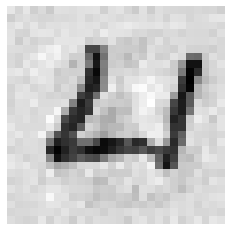

[259] (예측값)0 (실제값)6


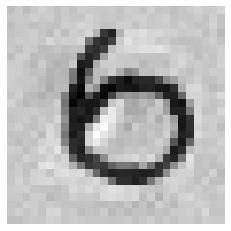

[266] (예측값)0 (실제값)8


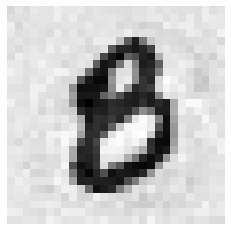

[274] (예측값)3 (실제값)9


[290] (예측값)4 (실제값)8


[321] (예측값)7 (실제값)2


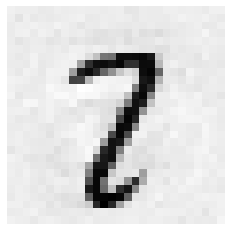

[359] (예측값)4 (실제값)9


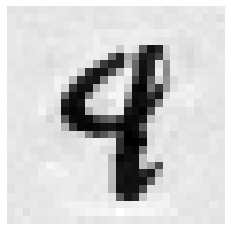

[362] (예측값)7 (실제값)2


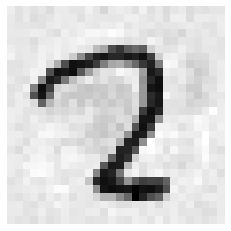

[381] (예측값)7 (실제값)3


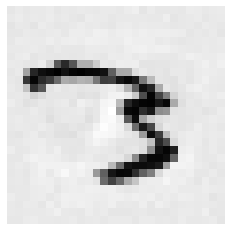

[404] (예측값)3 (실제값)2


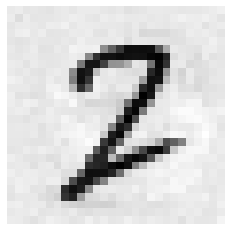

[445] (예측값)0 (실제값)6


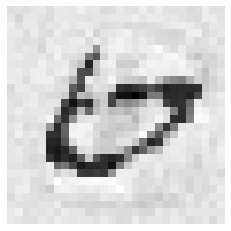

[447] (예측값)9 (실제값)4


[449] (예측값)5 (실제값)3


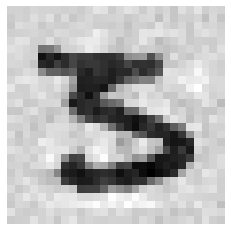

[479] (예측값)8 (실제값)9


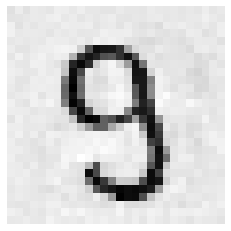

[495] (예측값)0 (실제값)8


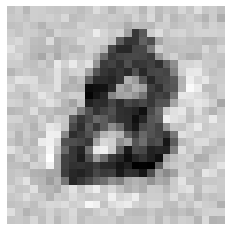

[582] (예측값)3 (실제값)8


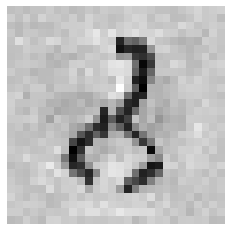

[591] (예측값)3 (실제값)8


[619] (예측값)8 (실제값)1


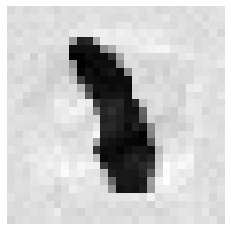

[646] (예측값)6 (실제값)2


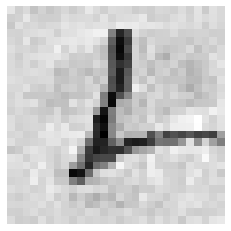

[684] (예측값)3 (실제값)7


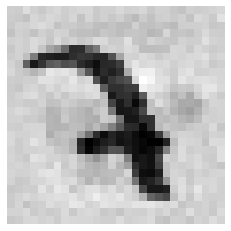

[694] (예측값)8 (실제값)5


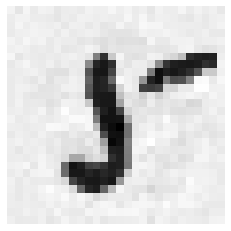

[707] (예측값)9 (실제값)4


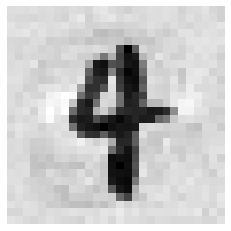

[720] (예측값)8 (실제값)5


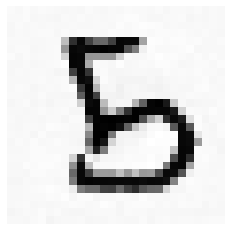

[726] (예측값)9 (실제값)7


[740] (예측값)9 (실제값)4


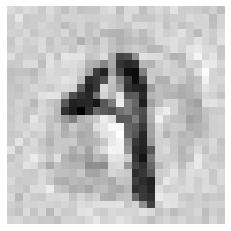

[813] (예측값)8 (실제값)9


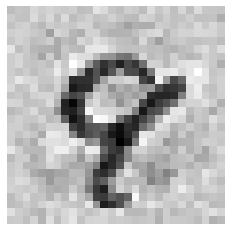

[844] (예측값)6 (실제값)8


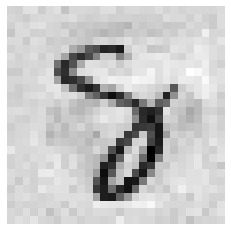

[846] (예측값)0 (실제값)7


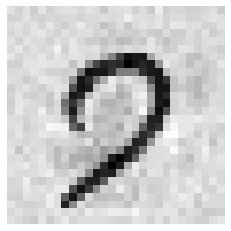

[877] (예측값)6 (실제값)8


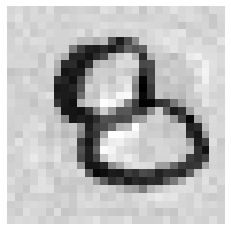

[881] (예측값)9 (실제값)4


[938] (예측값)5 (실제값)3


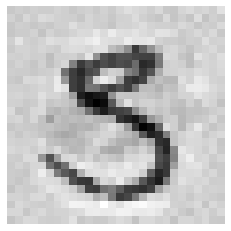

[947] (예측값)9 (실제값)8


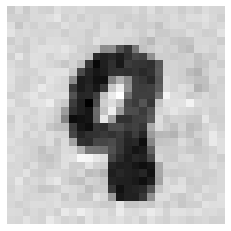

[959] (예측값)9 (실제값)4


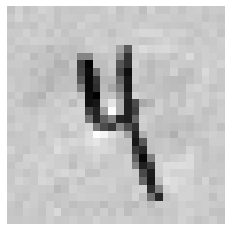

[962] (예측값)7 (실제값)9


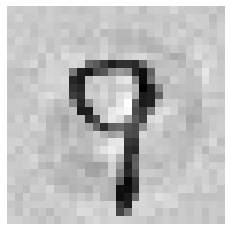

[965] (예측값)0 (실제값)6


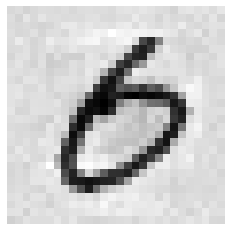

[1003] (예측값)3 (실제값)5


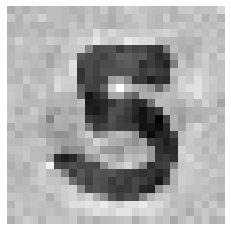

[1014] (예측값)5 (실제값)6


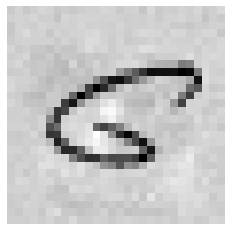

[1044] (예측값)8 (실제값)6


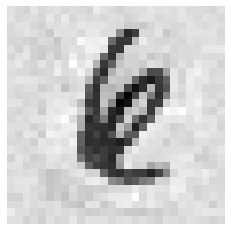

[1050] (예측값)6 (실제값)2


[1101] (예측값)2 (실제값)8


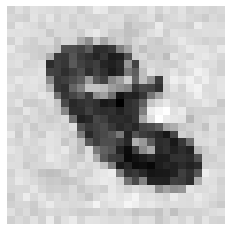

[1112] (예측값)6 (실제값)4


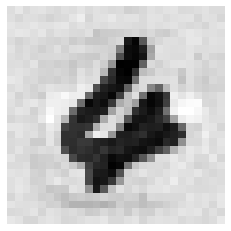

[1125] (예측값)9 (실제값)8


[1128] (예측값)7 (실제값)3


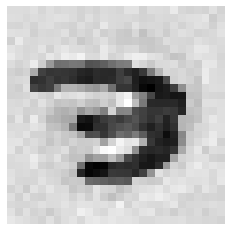

[1166] (예측값)1 (실제값)3


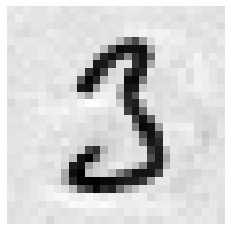

[1178] (예측값)0 (실제값)4


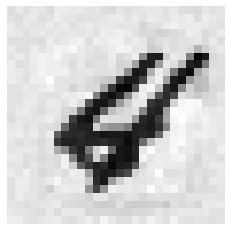

[1181] (예측값)1 (실제값)6


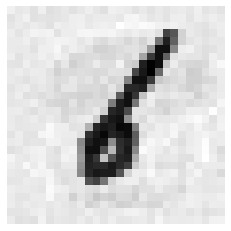

[1194] (예측값)9 (실제값)7


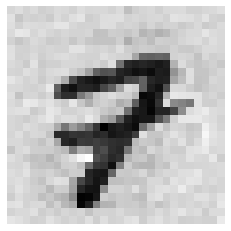

[1198] (예측값)4 (실제값)8


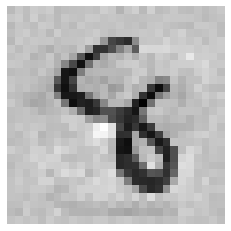

[1224] (예측값)6 (실제값)2


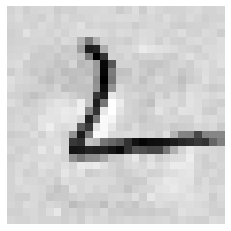

[1226] (예측값)2 (실제값)7


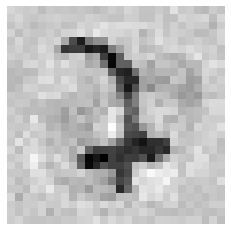

[1232] (예측값)4 (실제값)9


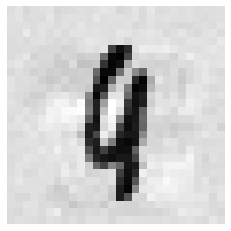

[1242] (예측값)9 (실제값)4


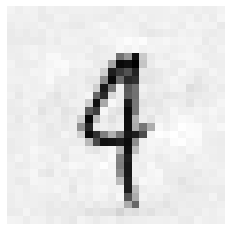

[1247] (예측값)0 (실제값)9


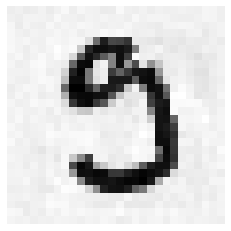

[1260] (예측값)1 (실제값)7


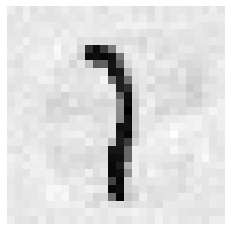

[1299] (예측값)7 (실제값)5


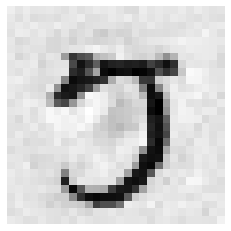

[1315] (예측값)5 (실제값)3


[1319] (예측값)3 (실제값)8


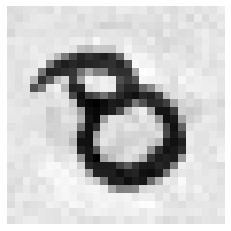

[1326] (예측값)2 (실제값)7


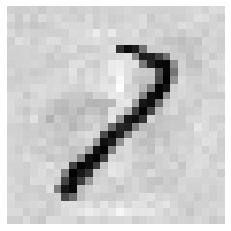

[1328] (예측값)5 (실제값)7


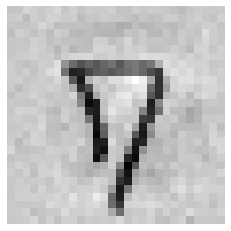

[1364] (예측값)2 (실제값)8


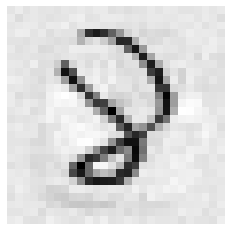

[1378] (예측값)6 (실제값)5


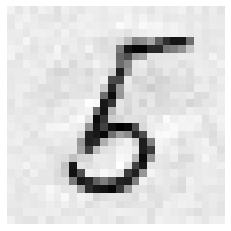

[1391] (예측값)9 (실제값)4


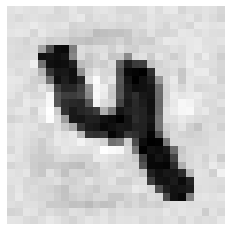

[1433] (예측값)3 (실제값)8


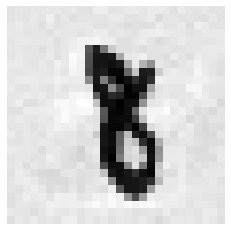

[1453] (예측값)9 (실제값)4


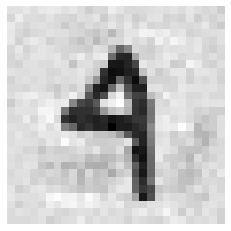

[1464] (예측값)3 (실제값)8


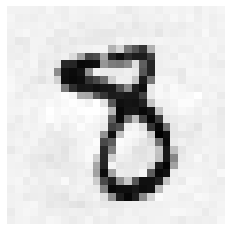

[1494] (예측값)0 (실제값)7


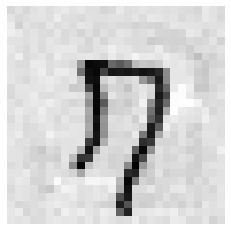

[1500] (예측값)1 (실제값)7


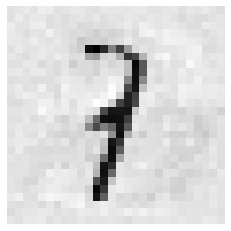

[1527] (예측값)5 (실제값)1


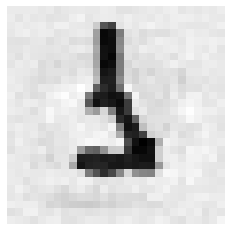

[1530] (예측값)7 (실제값)8


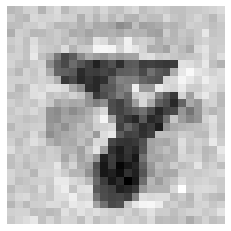

[1549] (예측값)6 (실제값)4


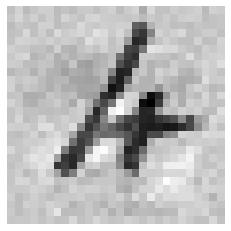

[1553] (예측값)3 (실제값)9


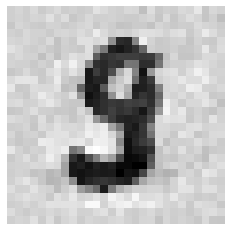

[1554] (예측값)8 (실제값)9


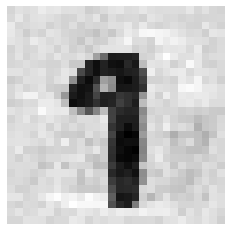

[1571] (예측값)9 (실제값)4


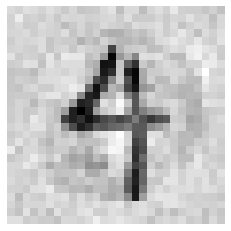

[1609] (예측값)6 (실제값)2


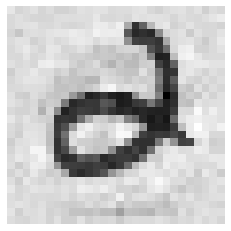

[1621] (예측값)6 (실제값)0


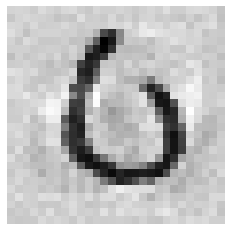

[1669] (예측값)9 (실제값)8


[1671] (예측값)3 (실제값)7


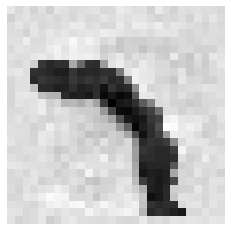

[1681] (예측값)7 (실제값)3


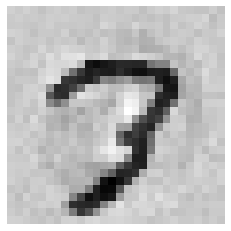

[1717] (예측값)0 (실제값)8


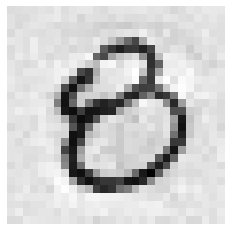

[1737] (예측값)1 (실제값)5


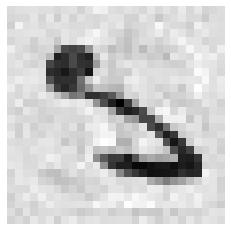

[1751] (예측값)3 (실제값)4


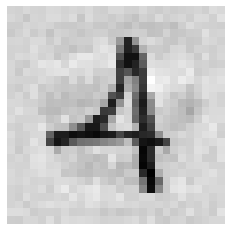

[1754] (예측값)2 (실제값)7


[1800] (예측값)4 (실제값)6


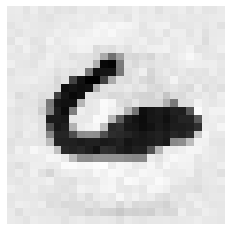

[1850] (예측값)7 (실제값)8


[1878] (예측값)3 (실제값)8


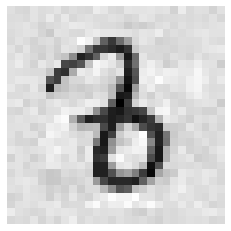

[1901] (예측값)4 (실제값)9


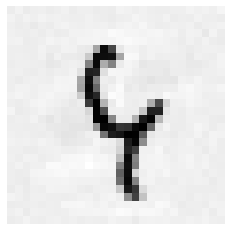

[1938] (예측값)6 (실제값)4


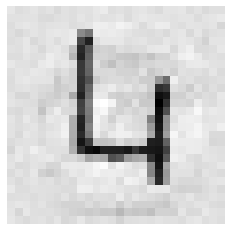

[1940] (예측값)0 (실제값)5


[1941] (예측값)2 (실제값)7


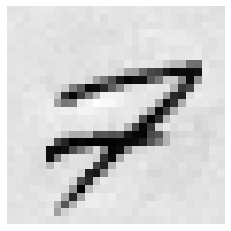

[1952] (예측값)3 (실제값)9


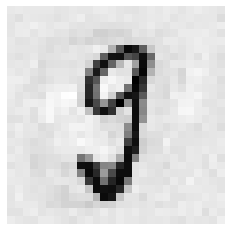

[1970] (예측값)3 (실제값)5


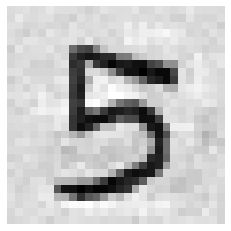

[1984] (예측값)0 (실제값)2


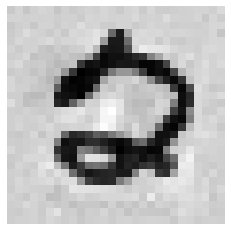

[2016] (예측값)2 (실제값)7


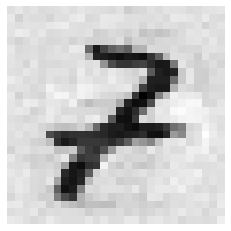

[2035] (예측값)3 (실제값)5


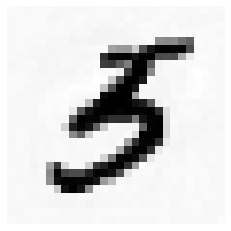

[2044] (예측값)8 (실제값)2


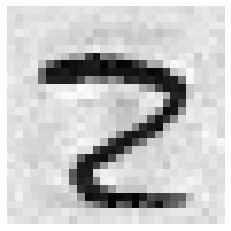

[2053] (예측값)9 (실제값)4


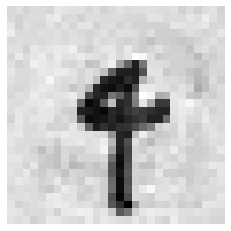

[2070] (예측값)9 (실제값)7


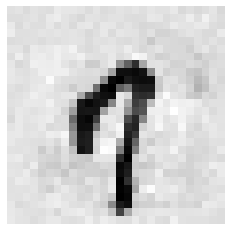

[2073] (예측값)7 (실제값)5


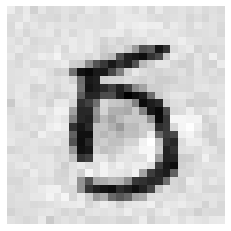

[2098] (예측값)0 (실제값)2


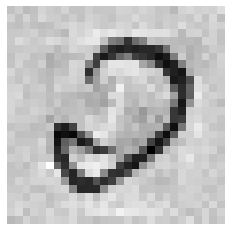

[2107] (예측값)5 (실제값)8


[2109] (예측값)4 (실제값)3


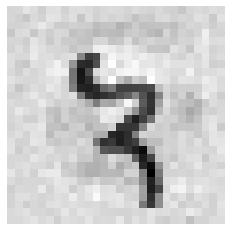

[2118] (예측값)0 (실제값)6


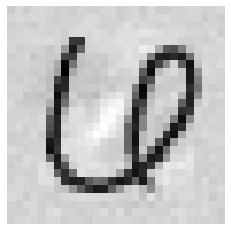

[2129] (예측값)2 (실제값)9


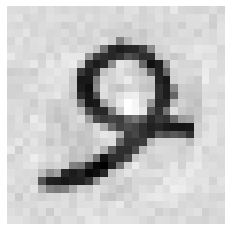

[2130] (예측값)9 (실제값)4


[2135] (예측값)1 (실제값)6


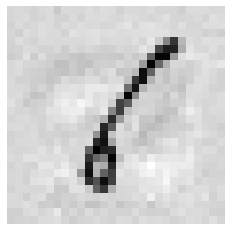

[2148] (예측값)9 (실제값)4


[2179] (예측값)3 (실제값)8


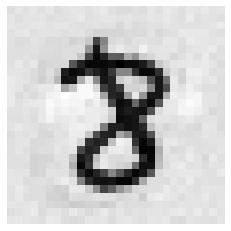

[2182] (예측값)2 (실제값)1


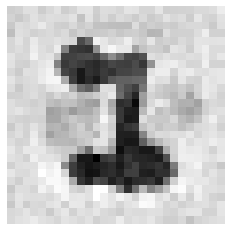

[2185] (예측값)8 (실제값)0


[2189] (예측값)1 (실제값)9


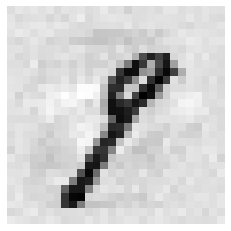

[2266] (예측값)2 (실제값)1


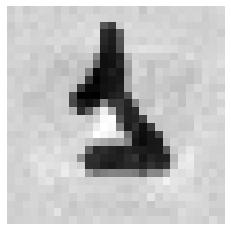

[2293] (예측값)6 (실제값)9


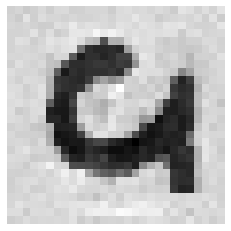

[2299] (예측값)8 (실제값)2


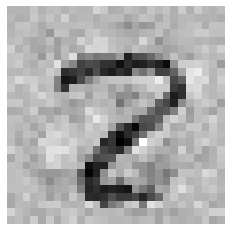

[2308] (예측값)5 (실제값)3


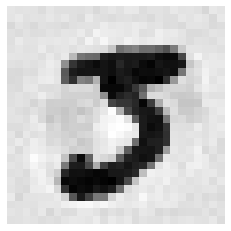

[2374] (예측값)8 (실제값)2


[2387] (예측값)1 (실제값)9


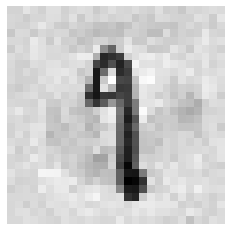

[2395] (예측값)3 (실제값)8


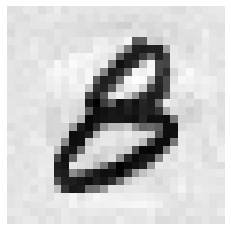

[2414] (예측값)4 (실제값)9


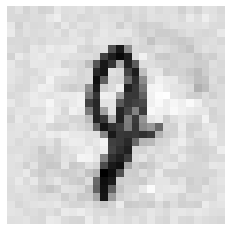

[2425] (예측값)3 (실제값)8


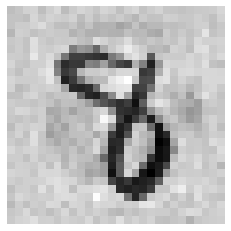

[2433] (예측값)1 (실제값)2


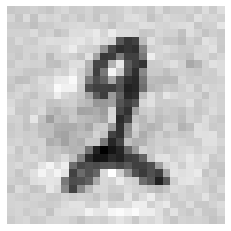

[2447] (예측값)9 (실제값)4


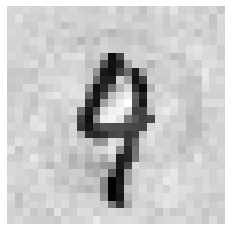

[2488] (예측값)6 (실제값)2


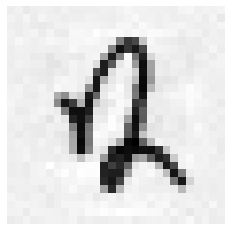

[2534] (예측값)5 (실제값)3


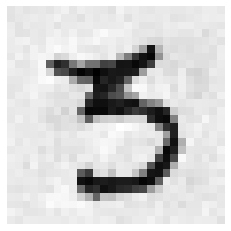

[2607] (예측값)2 (실제값)7


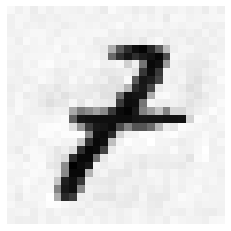

[2648] (예측값)0 (실제값)9


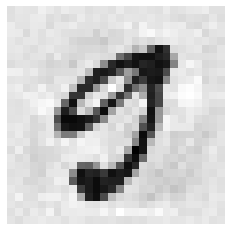

[2654] (예측값)1 (실제값)6


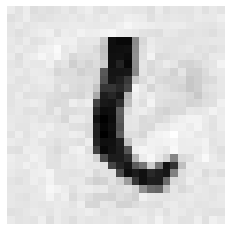

[2751] (예측값)5 (실제값)6


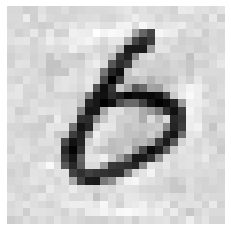

[2769] (예측값)7 (실제값)9


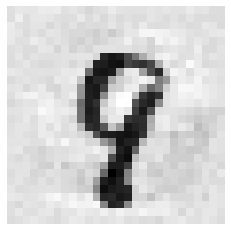

[2778] (예측값)2 (실제값)4


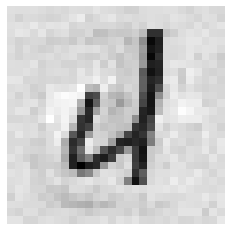

[2810] (예측값)3 (실제값)5


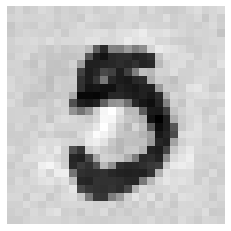

[2877] (예측값)7 (실제값)4


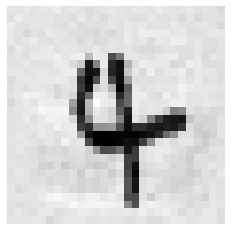

[2896] (예측값)0 (실제값)8


[2907] (예측값)9 (실제값)4


[2927] (예측값)2 (실제값)3


[2939] (예측값)7 (실제값)9


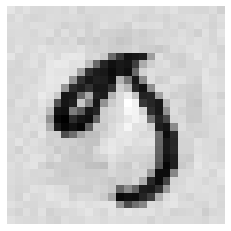

[2961] (예측값)2 (실제값)7


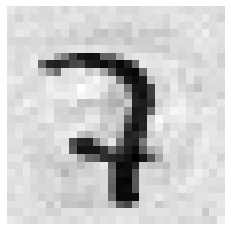

[2995] (예측값)8 (실제값)6


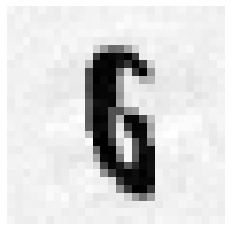

[3005] (예측값)5 (실제값)9


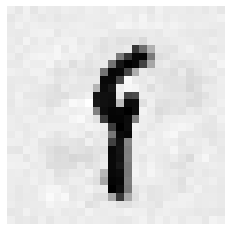

[3030] (예측값)8 (실제값)6


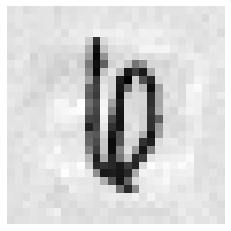

[3062] (예측값)5 (실제값)8


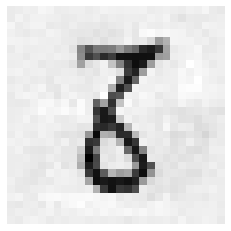

[3073] (예측값)2 (실제값)1


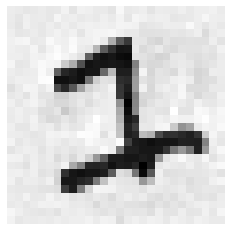

[3109] (예측값)1 (실제값)7


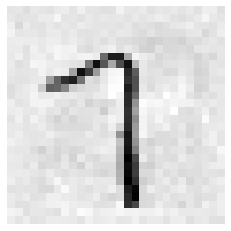

[3114] (예측값)6 (실제값)4


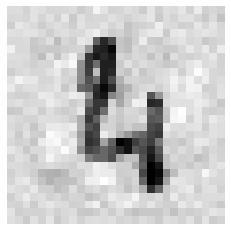

[3117] (예측값)9 (실제값)5


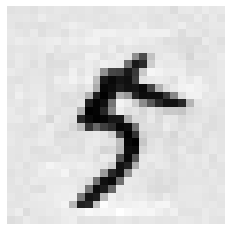

[3225] (예측값)1 (실제값)7


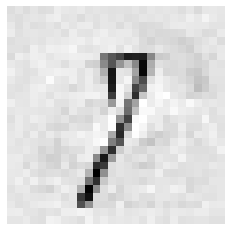

[3269] (예측값)0 (실제값)6


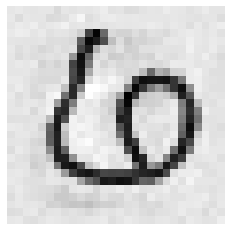

[3323] (예측값)3 (실제값)8


[3343] (예측값)2 (실제값)8


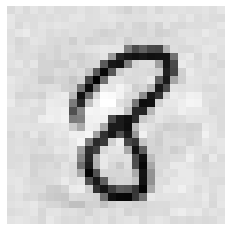

[3384] (예측값)6 (실제값)2


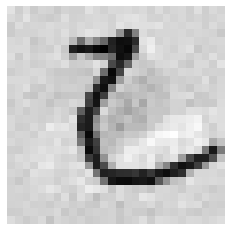

[3405] (예측값)9 (실제값)4


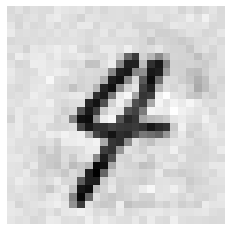

[3422] (예측값)0 (실제값)6


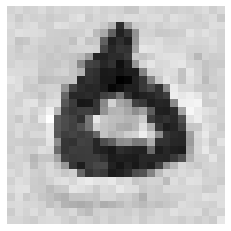

[3451] (예측값)9 (실제값)7


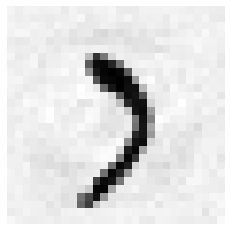

[3474] (예측값)1 (실제값)2


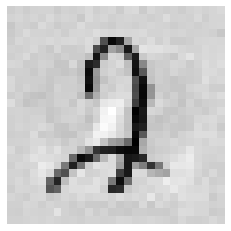

[3475] (예측값)7 (실제값)3


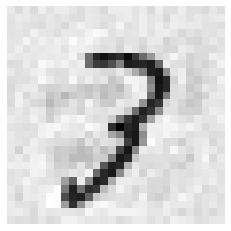

[3490] (예측값)9 (실제값)4


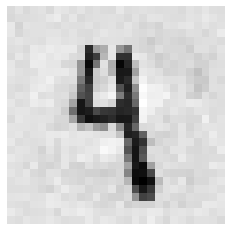

[3503] (예측값)1 (실제값)9


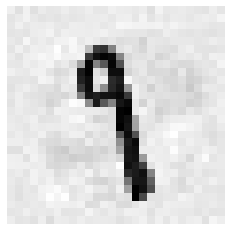

[3520] (예측값)4 (실제값)6


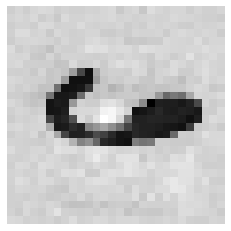

[3533] (예측값)7 (실제값)4


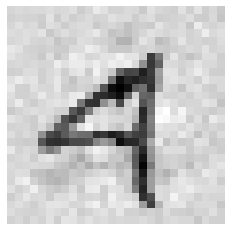

[3549] (예측값)2 (실제값)3


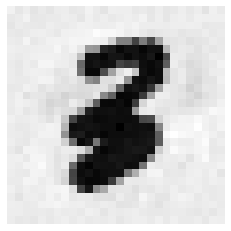

[3558] (예측값)0 (실제값)5


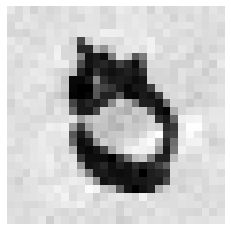

[3559] (예측값)5 (실제값)8


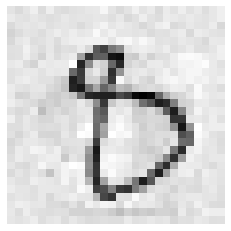

[3567] (예측값)5 (실제값)8


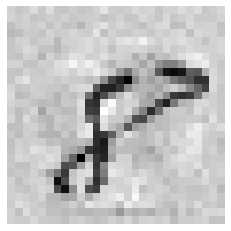

[3597] (예측값)3 (실제값)9


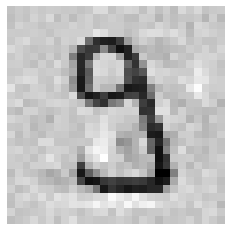

[3702] (예측값)4 (실제값)5


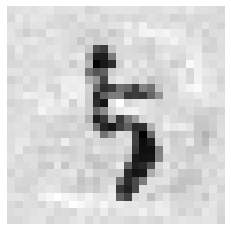

[3705] (예측값)2 (실제값)8


[3757] (예측값)3 (실제값)8


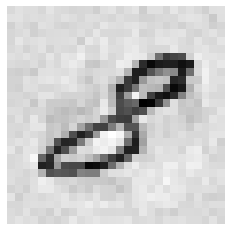

[3767] (예측값)2 (실제값)7


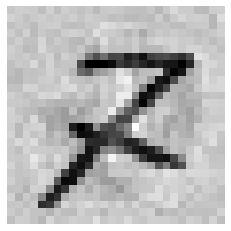

[3780] (예측값)6 (실제값)4


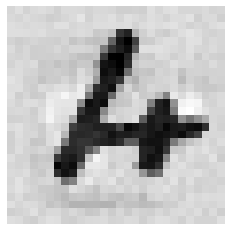

[3782] (예측값)3 (실제값)8


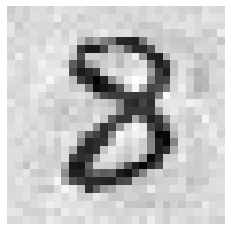

[3785] (예측값)1 (실제값)2


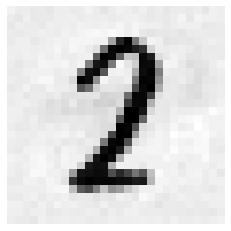

[3806] (예측값)7 (실제값)5


[3808] (예측값)8 (실제값)7


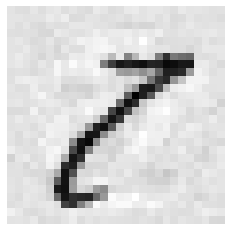

[3818] (예측값)6 (실제값)0


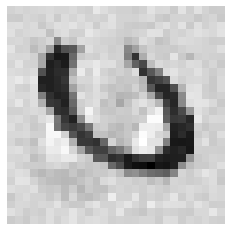

[3838] (예측값)1 (실제값)7


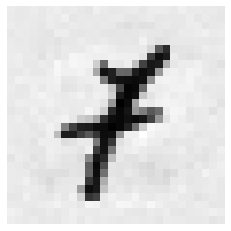

[3853] (예측값)0 (실제값)6


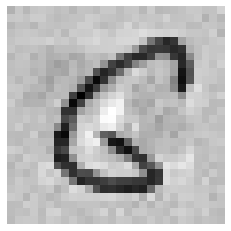

[3906] (예측값)2 (실제값)1


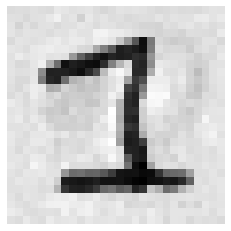

[3941] (예측값)2 (실제값)4


[3951] (예측값)7 (실제값)8


[3976] (예측값)1 (실제값)7


[3995] (예측값)5 (실제값)3


[4027] (예측값)9 (실제값)7


[4065] (예측값)3 (실제값)0


[4075] (예측값)3 (실제값)8


[4078] (예측값)3 (실제값)9


[4163] (예측값)5 (실제값)9


[4176] (예측값)7 (실제값)2


[4180] (예측값)8 (실제값)2


[4197] (예측값)9 (실제값)4


[4199] (예측값)9 (실제값)7


[4212] (예측값)9 (실제값)1


[4224] (예측값)7 (실제값)9


[4248] (예측값)8 (실제값)2


[4255] (예측값)3 (실제값)5


[4265] (예측값)3 (실제값)4


[4289] (예측값)7 (실제값)2


[4314] (예측값)7 (실제값)9


[4350] (예측값)8 (실제값)2


[4360] (예측값)3 (실제값)5


[4415] (예측값)0 (실제값)2


[4425] (예측값)4 (실제값)9


[4497] (예측값)7 (실제값)8


[4500] (예측값)1 (실제값)9


[4536] (예측값)5 (실제값)6


[4547] (예측값)4 (실제값)6


[4567] (예측값)9 (실제값)4


[4571] (예측값)9 (실제값)6


[4575] (예측값)2 (실제값)4


[4601] (예측값)4 (실제값)8


[4635] (예측값)5 (실제값)3


[4639] (예측값)9 (실제값)8


[4690] (예측값)2 (실제값)7


[4724] (예측값)0 (실제값)8


[4751] (예측값)6 (실제값)4


[4761] (예측값)7 (실제값)9


[4807] (예측값)3 (실제값)8


[4823] (예측값)4 (실제값)9


[4839] (예측값)3 (실제값)8


[4860] (예측값)9 (실제값)4


[4879] (예측값)6 (실제값)8


[4880] (예측값)8 (실제값)0


[4886] (예측값)1 (실제값)7


[4911] (예측값)9 (실제값)4


[4966] (예측값)9 (실제값)7


[4978] (예측값)7 (실제값)8


[5067] (예측값)2 (실제값)3


[5159] (예측값)9 (실제값)4


[5165] (예측값)3 (실제값)0


[5176] (예측값)4 (실제값)8


[5201] (예측값)9 (실제값)4


[5331] (예측값)6 (실제값)1


[5457] (예측값)8 (실제값)1


[5493] (예측값)3 (실제값)8


[5600] (예측값)9 (실제값)7


[5642] (예측값)8 (실제값)1


[5677] (예측값)6 (실제값)4


[5734] (예측값)2 (실제값)3


[5749] (예측값)2 (실제값)8


[5842] (예측값)9 (실제값)4


[5888] (예측값)0 (실제값)4


[5926] (예측값)9 (실제값)4


[5936] (예측값)9 (실제값)4


[5937] (예측값)3 (실제값)5


[5973] (예측값)8 (실제값)3


[6024] (예측값)3 (실제값)8


[6059] (예측값)9 (실제값)3


[6166] (예측값)3 (실제값)9


[6400] (예측값)6 (실제값)0


[6403] (예측값)2 (실제값)8


[6418] (예측값)4 (실제값)2


[6505] (예측값)0 (실제값)9


[6532] (예측값)5 (실제값)0


[6555] (예측값)7 (실제값)8


[6558] (예측값)0 (실제값)6


[6572] (예측값)9 (실제값)1


[6576] (예측값)4 (실제값)7


[6597] (예측값)7 (실제값)0


[6598] (예측값)3 (실제값)5


[6612] (예측값)3 (실제값)8


[6625] (예측값)4 (실제값)8


[6641] (예측값)5 (실제값)8


[6651] (예측값)8 (실제값)0


[6765] (예측값)6 (실제값)8


[6783] (예측값)6 (실제값)1


[6847] (예측값)4 (실제값)6


[7208] (예측값)7 (실제값)8


[7249] (예측값)0 (실제값)2


[7370] (예측값)0 (실제값)8


[7401] (예측값)0 (실제값)3


[7432] (예측값)2 (실제값)7


[7434] (예측값)8 (실제값)4


[7451] (예측값)6 (실제값)5


[7492] (예측값)7 (실제값)2


[7637] (예측값)3 (실제값)2


[7797] (예측값)6 (실제값)5


[7821] (예측값)2 (실제값)3


[7849] (예측값)0 (실제값)3


[7899] (예측값)7 (실제값)1


[7915] (예측값)8 (실제값)7


[7921] (예측값)0 (실제값)8


[7928] (예측값)7 (실제값)1


[8062] (예측값)8 (실제값)5


[8094] (예측값)8 (실제값)2


[8095] (예측값)6 (실제값)4


[8097] (예측값)9 (실제값)8


[8160] (예측값)3 (실제값)5


[8183] (예측값)6 (실제값)8


[8255] (예측값)0 (실제값)4


[8258] (예측값)6 (실제값)8


[8279] (예측값)7 (실제값)8


[8325] (예측값)6 (실제값)0


[8339] (예측값)6 (실제값)8


[8353] (예측값)4 (실제값)2


[8383] (예측값)5 (실제값)9


[8406] (예측값)9 (실제값)4


[8408] (예측값)6 (실제값)8


[8410] (예측값)6 (실제값)8


[8452] (예측값)7 (실제값)4


[8520] (예측값)9 (실제값)4


[8527] (예측값)9 (실제값)4


[9009] (예측값)2 (실제값)7


[9015] (예측값)2 (실제값)7


[9019] (예측값)2 (실제값)7


[9024] (예측값)2 (실제값)7


[9036] (예측값)2 (실제값)7


[9045] (예측값)2 (실제값)7


[9046] (예측값)3 (실제값)2


[9280] (예측값)5 (실제값)8


[9471] (예측값)9 (실제값)4


[9490] (예측값)3 (실제값)2


[9513] (예측값)6 (실제값)5


[9540] (예측값)8 (실제값)1


[9587] (예측값)4 (실제값)9


[9664] (예측값)7 (실제값)2


[9679] (예측값)3 (실제값)6


[9729] (예측값)6 (실제값)5


[9742] (예측값)8 (실제값)3


[9745] (예측값)6 (실제값)4


[9749] (예측값)6 (실제값)5


[9752] (예측값)0 (실제값)2


[9768] (예측값)0 (실제값)2


[9770] (예측값)0 (실제값)5


[9783] (예측값)0 (실제값)4


[9792] (예측값)9 (실제값)4


[9808] (예측값)4 (실제값)9


[9811] (예측값)8 (실제값)2


[9839] (예측값)7 (실제값)2


[9888] (예측값)0 (실제값)6


[9892] (예측값)5 (실제값)8


[9904] (예측값)7 (실제값)2


[9922] (예측값)9 (실제값)4


[9975] (예측값)7 (실제값)3


[9982] (예측값)6 (실제값)5


In [23]:
Adversarial_Training()
Report_Performance()